In [ ]:
!pip install deep-translator

In [1]:
import pandas as pd
import pickle
import os

file_mapping = {
    "A": "A - Energy",
    "B": "B - Basic_Materials",
    "C": "C - Industrials",
    "D": "D - Consumer_Noncyclicals",
    "E": "E - Consumer_Cyclicals",
    "F": "F - Healthcare",
    "G": "G - Financials",
    "H": "H - Properties_Real_Estate",
    "I": "I - Technology",
    "J": "J - Infrastructures",
    "K": "K - Transportation_Logistic"
}

folder_path = "/kaggle/input/combined-data-sectoral"
combined_data = {}
for key, filename in file_mapping.items():
    file_path = os.path.join(folder_path, f"{filename}.pkl")
    
    with open(file_path, "rb") as f:
        combined_data[key] = pickle.load(f)
    
    print(f"✅ Loaded {filename}.pkl as {key}")

combined_data["A"].head()


✅ Loaded A - Energy.pkl as A
✅ Loaded B - Basic_Materials.pkl as B
✅ Loaded C - Industrials.pkl as C
✅ Loaded D - Consumer_Noncyclicals.pkl as D
✅ Loaded E - Consumer_Cyclicals.pkl as E
✅ Loaded F - Healthcare.pkl as F
✅ Loaded G - Financials.pkl as G
✅ Loaded H - Properties_Real_Estate.pkl as H
✅ Loaded I - Technology.pkl as I
✅ Loaded J - Infrastructures.pkl as J
✅ Loaded K - Transportation_Logistic.pkl as K


,date,open,high,low,close,stock_num,vol,thought_vector
0,2021-01-25,803.159,803.159,779.961,785.604,66,1376189590,"[[[0.9998206, 0.8593331, -5.0045343e-05, -0.63..."
1,2021-01-26,785.604,794.227,764.018,770.318,66,1946080885,"[[[0.9997831, 0.86558574, -0.00012727233, -0.6..."
2,2021-01-27,770.318,777.526,753.725,770.299,66,2038294143,"[[[0.9996381, 0.83049244, -8.243204e-05, -0.42..."
3,2021-01-28,770.299,779.868,740.080,744.213,66,2247416684,"[[[0.9998016, 0.8742086, -0.000112483474, -0.6..."
4,2021-01-29,744.213,759.522,727.778,740.682,66,3506513290,"[[[0.9998016, 0.8742086, -0.000112483474, -0.6..."


In [2]:
data = combined_data

# Import Library

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import layers, Model
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import random
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, IterableDataset
import numpy as np
from tqdm import tqdm

import torch
from transformers import AutoModel, AutoTokenizer

# Translate

In [9]:
from deep_translator import GoogleTranslator

data_indonesia = [
    "Bank Indonesia Pertahankan Suku Bunga Acuan di Tengah Tekanan Inflasi",
    "Pasar Saham Menguat, Investor Optimis dengan Prospek Ekonomi 2024",
    "Rupiah Menguat terhadap Dolar AS, Didukung Arus Modal Asing",
    "Laba Bersih Bank BUMN Naik Signifikan di Kuartal Pertama 2024",
    "OJK Perketat Regulasi Fintech untuk Lindungi Konsumen"
]


translator = GoogleTranslator(source='id', target='en')

data_english = [translator.translate(text) for text in data_indonesia]

data_english

['Bank Indonesia maintains the benchmark interest rate in the middle of inflationary pressure',
 'Stock Market Strengthens, Investors are optimistic with economic prospects 2024',
 'The rupiah strengthened against the US dollar, supported by the flow of foreign capital',
 'BUMN bank net profit rose significantly in the first quarter of 2024',
 'OJK Turn Fintech Regulation to Protect Consumers']

# FinBERT Tuning

In [11]:
# List untuk menyimpan semua embeddings
all_titles = []
all_embeddings = []

# Load model & tokenizer
model_path = "/kaggle/input/finbert-finetuning/kaggle/working/finbert_finetuned"
tokenizer = AutoTokenizer.from_pretrained(model_path)
model = AutoModel.from_pretrained(model_path)

# Gunakan GPU jika ada
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
model.eval()

# Konfigurasi
MAX_LEN = 25
BATCH_SIZE = 2  
SAVE_PATH = "finbert_embeddings.npz"

# Fungsi untuk mendapatkan embedding per batch
def get_embeddings_batch(texts):
    inputs = tokenizer(
        texts, return_tensors="pt", truncation=True, padding="max_length", max_length=MAX_LEN
    )
    inputs = {k: v.to(device) for k, v in inputs.items()}

    with torch.no_grad():
        outputs = model(**inputs)

    # return outputs.last_hidden_state[:, 0, :].cpu().numpy()  
    return outputs.last_hidden_state.cpu().numpy()  

# Looping dalam batch
for i in range(0, len(data_english), BATCH_SIZE):
    batch_texts = data_english[i : i + BATCH_SIZE]  # Ambil batch dari list

    # Ambil embedding
    batch_embeddings = get_embeddings_batch(batch_texts)

    # Simpan ke list
    all_titles.extend(batch_texts)
    all_embeddings.append(batch_embeddings)  # Simpan sebagai list of arrays

# Gabungkan semua batch jadi satu numpy array
all_embeddings = np.vstack(all_embeddings)

print(f"✅ Embedding selesai! Shape: {all_embeddings.shape}")


Some weights of BertModel were not initialized from the model checkpoint at /kaggle/input/finbert-finetuning/kaggle/working/finbert_finetuned and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


✅ Embedding selesai! Shape: (5, 25, 768)


# Thought Vector

In [12]:
import kagglehub

# Download latest version
path = kagglehub.model_download("anggraininovi/autoencoder-final/pyTorch/default")

print("Path to model files:", path)

Path to model files: /kaggle/input/autoencoder-final/pytorch/default/1


In [16]:
len(all_embeddings)

5

In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, IterableDataset
import numpy as np
from tqdm import tqdm

class Seq2SeqAutoencoder(nn.Module):
    def __init__(self, input_dim=768, hidden_dim=768, num_layers=4, dropout=0.3):
        super(Seq2SeqAutoencoder, self).__init__()
        self.hidden_dim = hidden_dim
        self.num_layers = num_layers

        # Encoder
        self.encoder = nn.LSTM(input_dim, hidden_dim, num_layers, batch_first=True, dropout=dropout)

        # Decoder
        self.decoder = nn.LSTM(hidden_dim, hidden_dim, num_layers, batch_first=True, dropout=dropout)
        self.fc_out = nn.Linear(hidden_dim, input_dim)  # Output layer ke dimensi asli

    def forward(self, x):
        batch_size, seq_len, _ = x.shape

        # Encoder
        _, (hidden, cell) = self.encoder(x)

        # Decoder
        decoder_input = torch.zeros(batch_size, 1, self.hidden_dim).to(x.device)  # Input pertama (zero vector)
        outputs = []

        for _ in range(seq_len):
            out, (hidden, cell) = self.decoder(decoder_input, (hidden, cell))
            pred = self.fc_out(out)
            outputs.append(pred)
            decoder_input = pred

        outputs = torch.cat(outputs, dim=1)  # [batch_size, seq_len, input_dim]
        return outputs, hidden  # Hidden = Thought Vector

# 🔹 Inisialisasi Model, Optimizer, Loss
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = Seq2SeqAutoencoder().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
criterion = nn.MSELoss()

In [14]:
import torch
import numpy as np
import pandas as pd


model.load_state_dict(torch.load("/kaggle/input/autoencoder-final/pytorch/default/1/finbert_autoencoder_lstm (3).pth", map_location=device, weights_only=True))
model.eval()


<ipython-input-14-79a620345139>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/kaggle/input/autoencoder-final/pytorch/default/1/finbert_

Seq2SeqAutoencoder(
  (encoder): LSTM(768, 768, num_layers=4, batch_first=True, dropout=0.3)
  (decoder): LSTM(768, 768, num_layers=4, batch_first=True, dropout=0.3)
  (fc_out): Linear(in_features=768, out_features=768, bias=True)
)

In [17]:
BATCH_SIZE = 256 
thought_vectors_list = []

with torch.no_grad():
    for i in range(0, len(all_embeddings), BATCH_SIZE):
        batch_embeddings = torch.tensor(all_embeddings[i:i+BATCH_SIZE], dtype=torch.float32).to(device)

        # Ambil hanya hidden state dari model
        _, batch_thought_vectors = model(batch_embeddings)  
        # Ubah dimensi jadi (batch_size, 4, 768)
        batch_thought_vectors = batch_thought_vectors.permute(1, 0, 2).cpu().numpy()
        thought_vectors_list.append(batch_thought_vectors)


# 4️⃣ Gabungkan semua batch
thought_vectors = np.concatenate(thought_vectors_list, axis=0)  

In [20]:
thought_vectors.shape

(5, 4, 768)

In [17]:
data["A"]

,date,open,high,low,close,stock_num,vol,thought_vector
0,2021-01-25,803.159,803.159,779.961,785.604,66,1376189590,"[[[0.9998206, 0.8593331, -5.0045343e-05, -0.63..."
1,2021-01-26,785.604,794.227,764.018,770.318,66,1946080885,"[[[0.9997831, 0.86558574, -0.00012727233, -0.6..."
2,2021-01-27,770.318,777.526,753.725,770.299,66,2038294143,"[[[0.9996381, 0.83049244, -8.243204e-05, -0.42..."
3,2021-01-28,770.299,779.868,740.080,744.213,66,2247416684,"[[[0.9998016, 0.8742086, -0.000112483474, -0.6..."
4,2021-01-29,744.213,759.522,727.778,740.682,66,3506513290,"[[[0.9998016, 0.8742086, -0.000112483474, -0.6..."
...,...,...,...,...,...,...,...,...
969,2025-01-22,2871.878,2899.822,2866.377,2886.770,90,2875380333,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
970,2025-01-23,2886.770,2930.040,2884.991,2892.795,90,3436926896,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
971,2025-01-24,2892.795,2897.694,2849.455,2877.795,90,2728825153,"[[[0.99974906, 0.8537995, -8.898266e-05, -0.62..."
972,2025-01-30,2877.795,2894.804,2844.449,2869.013,90,2247141030,"[[[0.99965394, 0.8322163, -8.026808e-05, -0.44..."


# Data Saham Terbaru

In [24]:
import pandas as pd

paths = [
    "/kaggle/input/data-saham-terbaru/IDXENERGY.csv",
    "/kaggle/input/data-saham-terbaru/IDXBASIC.csv",
    "/kaggle/input/data-saham-terbaru/IDXINDUST.csv",
    "/kaggle/input/data-saham-terbaru/IDXNONCYC.csv",
    "/kaggle/input/data-saham-terbaru/IDXCYCLIC.csv",
    "/kaggle/input/data-saham-terbaru/IDXHEALTH.csv",
    "/kaggle/input/data-saham-terbaru/IDXFINANCE.csv",
    "/kaggle/input/data-saham-terbaru/IDXPROPERT.csv",
    "/kaggle/input/data-saham-terbaru/IDXTECHNO.csv", 
    "/kaggle/input/data-saham-terbaru/IDXINFRA.csv",
    "/kaggle/input/data-saham-terbaru/IDXTRANS.csv"
]

variables = ["A", "B", "C", "D", "E", "F", "G", "H", "I", "J", "K"]
df_stock = {var: pd.read_csv(path) for var, path in zip(variables, paths)}

for key in df_stock:
    df_stock[key].rename(columns={'num_stock': 'stock_num', 'volume': 'vol'}, inplace=True)


In [5]:
df_stock["G"]

,Tanggal,open,high,low,close,stock_num,vol
0,2025-02-03,1418.748,1417.186,1394.941,1411.965,105,1663038163
1,2025-02-04,1411.965,1419.000,1401.586,1405.702,105,1208184512
2,2025-02-05,1405.702,1403.256,1384.968,1385.990,105,1120565347
3,2025-02-06,1385.990,1385.334,1349.246,1354.928,105,2103922497
4,2025-02-07,1354.928,1364.633,1339.766,1364.633,105,1517472808
5,2025-02-10,1364.633,1363.854,1339.732,1346.979,105,1821662397
6,2025-02-11,1346.979,1346.801,1325.214,1333.492,105,1948590239
7,2025-02-12,1333.492,1350.947,1331.138,1350.947,105,1390983374
8,2025-02-13,1350.947,1353.547,1342.179,1348.573,105,1417728692
9,2025-02-14,1348.573,1361.657,1347.726,1356.603,105,2613806377


In [6]:
historical_10_data = df_stock["G"].head(10)
historical_10_data

,Tanggal,open,high,low,close,stock_num,vol
0,2025-02-03,1418.748,1417.186,1394.941,1411.965,105,1663038163
1,2025-02-04,1411.965,1419.000,1401.586,1405.702,105,1208184512
2,2025-02-05,1405.702,1403.256,1384.968,1385.990,105,1120565347
3,2025-02-06,1385.990,1385.334,1349.246,1354.928,105,2103922497
4,2025-02-07,1354.928,1364.633,1339.766,1364.633,105,1517472808
5,2025-02-10,1364.633,1363.854,1339.732,1346.979,105,1821662397
6,2025-02-11,1346.979,1346.801,1325.214,1333.492,105,1948590239
7,2025-02-12,1333.492,1350.947,1331.138,1350.947,105,1390983374
8,2025-02-13,1350.947,1353.547,1342.179,1348.573,105,1417728692
9,2025-02-14,1348.573,1361.657,1347.726,1356.603,105,2613806377


In [138]:
thought_vectors.shape

(5, 4, 768)

In [25]:
for key in df_stock.keys():
    # Ambil panjang dataframe stock terbaru
    n_rows = len(df_stock[key])

    # Ambil n_rows terakhir dari thought_vector data lama
    last_thought_vectors = data[key]['thought_vector'].iloc[-n_rows:].values

    # Tambahkan ke df_stock sebagai kolom baru
    df_stock[key]['thought_vector'] = last_thought_vectors

In [18]:
df_stock["K"]

,Tanggal,open,high,low,close,stock_num,vol,thought_vector
0,2025-02-03,1275.558,1277.441,1254.777,1258.244,34,234054800,"[[[0.99927235, 0.86946934, -4.8781683e-05, -0...."
1,2025-02-04,1258.244,1278.147,1258.196,1278.147,34,139683300,"[[[0.9991772, 0.84751636, -6.1630366e-05, -0.5..."
2,2025-02-05,1278.147,1280.758,1255.735,1266.166,34,140002600,"[[[0.9991772, 0.84751636, -6.1630366e-05, -0.5..."
3,2025-02-06,1266.166,1268.071,1235.454,1240.981,34,194843100,"[[[0.9966129, 0.8640607, -8.808387e-05, -0.661..."
4,2025-02-07,1240.981,1268.313,1226.245,1233.936,34,163396200,"[[[0.99976116, 0.8580395, -6.364303e-05, -0.67..."
5,2025-02-10,1233.936,1241.397,1211.682,1226.077,34,165523100,"[[[0.99967915, 0.83899695, -6.9058166e-05, -0...."
6,2025-02-11,1226.077,1231.174,1185.895,1189.726,34,157296500,"[[[0.99967915, 0.83899695, -6.9058166e-05, -0...."
7,2025-02-12,1189.726,1203.691,1188.451,1193.900,34,162125710,"[[[0.88083625, 0.82011575, -0.0004520372, -0.2..."
8,2025-02-13,1193.900,1197.152,1180.379,1186.247,34,117418700,"[[[0.99974364, 0.8382241, -3.3479657e-05, -0.5..."
9,2025-02-14,1186.247,1212.359,1184.682,1206.508,34,135138500,"[[[0.99974364, 0.8382241, -3.3479657e-05, -0.5..."


In [26]:
for key in df_stock.keys():
    # Ambil 10 baris terakhir dari 'data'
    last_10_rows = data[key].tail(10)
    
    # Ubah nama kolom 'date' menjadi 'Tanggal' agar sesuai dengan df_stock
    last_10_rows = last_10_rows.rename(columns={'date': 'Tanggal'})
    
    # Pastikan format tanggal dalam yyyy-mm-dd
    last_10_rows['Tanggal'] = pd.to_datetime(last_10_rows['Tanggal']).dt.strftime('%Y-%m-%d')
    df_stock[key]['Tanggal'] = pd.to_datetime(df_stock[key]['Tanggal']).dt.strftime('%Y-%m-%d')
    
    # Gabungkan dengan df_stock[key]
    df_stock[key] = pd.concat([last_10_rows, df_stock[key]], ignore_index=True)

In [27]:
for key in df_stock.keys():
    df_stock[key] = df_stock[key].iloc[:20]

In [28]:
df_stock["A"]

,Tanggal,open,high,low,close,stock_num,vol,thought_vector
0,2025-01-15,2791.314,2825.657,2786.571,2807.403,90,2356534758,"[[[0.9997161, 0.8453616, -6.503202e-05, -0.605..."
1,2025-01-16,2807.403,2843.113,2798.096,2827.298,90,3123904172,"[[[0.9997161, 0.8453616, -6.503202e-05, -0.605..."
2,2025-01-17,2827.298,2851.528,2824.623,2849.606,90,2456115124,"[[[0.9997981, 0.8727279, -0.000121091085, -0.6..."
3,2025-01-20,2849.606,2879.930,2856.480,2875.505,90,2479769531,"[[[0.9997012, 0.8400362, -9.6287935e-05, -0.49..."
4,2025-01-21,2875.505,2902.322,2864.812,2871.878,90,2617488248,"[[[0.9997012, 0.8400362, -9.6287935e-05, -0.49..."
5,2025-01-22,2871.878,2899.822,2866.377,2886.770,90,2875380333,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
6,2025-01-23,2886.770,2930.040,2884.991,2892.795,90,3436926896,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
7,2025-01-24,2892.795,2897.694,2849.455,2877.795,90,2728825153,"[[[0.99974906, 0.8537995, -8.898266e-05, -0.62..."
8,2025-01-30,2877.795,2894.804,2844.449,2869.013,90,2247141030,"[[[0.99965394, 0.8322163, -8.026808e-05, -0.44..."
9,2025-01-31,2869.013,2893.463,2867.950,2889.727,90,2011277420,"[[[0.99965394, 0.8322163, -8.026808e-05, -0.44..."


# Prediksi New Data

In [11]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import pickle
import joblib

class DataPreprocessor:
    def __init__(self):
        self.scalers = {
            col: MinMaxScaler() for col in ['open', 'high', 'low', 'close', 'stock_num', 'vol']
        }
        self.target_scaler = MinMaxScaler()
    
    def fit_transform_data(self, data):
        stock_data = np.column_stack([
            self.scalers[col].fit_transform(data[[col]]) 
            for col in self.scalers
        ])
        target = self.target_scaler.fit_transform(data[['close']])
        return stock_data, target
    
    def transform_data(self, data):
        stock_data = np.column_stack([
            self.scalers[col].transform(data[[col]]) 
            for col in self.scalers
        ])
        target = self.target_scaler.transform(data[['close']])
        return stock_data, target
    
    def inverse_transform_target(self, scaled_target):
        return self.target_scaler.inverse_transform(scaled_target.reshape(-1, 1))


def prepare_data_with_preprocessor(combined_data, timestep=10, preprocessor=None, is_training=True):
    if is_training:
        if preprocessor is None:
            preprocessor = DataPreprocessor()
        stock_data_scaled, target_scaled = preprocessor.fit_transform_data(combined_data)
    else:
        assert preprocessor is not None, "Preprocessor must be provided for test data"
        stock_data_scaled, target_scaled = preprocessor.transform_data(combined_data)
    X_news, X_stock, y = [], [], []
    
    for i in range(timestep, len(combined_data) - 1):
        try:
            thought_vector = np.transpose(combined_data.iloc[i-1]['thought_vector'], (0, 2, 1))
            thought_vector = np.expand_dims(thought_vector, axis=-1)
            stock_features = stock_data_scaled[i - timestep:i]
            target = target_scaled[i, 0]
            
            X_news.append(thought_vector)
            X_stock.append(stock_features)
            y.append(target)
        except Exception as e:
            print(f"Error processing row {i}: {str(e)}")
            continue
    return (np.array(X_news), np.array(X_stock), np.array(y)), preprocessor


def preprocess_all_data(data_dict, timestep=10, save_dir='preprocessor'):
    os.makedirs(save_dir, exist_ok=True)
    preprocessors = {}
    processed_data = {}
    
    for key, df in data_dict.items():
        print(f"\nMemproses saham sektor: {key}")
        preprocessor = DataPreprocessor()
        (X_news, X_stock, y), preprocessor = prepare_data_with_preprocessor(df, timestep=timestep, is_training=True)
        
        preprocessors[key] = preprocessor
        processed_data[key] = (X_news, X_stock, y)
        
        # Simpan preprocessor
        joblib.dump(preprocessor, os.path.join(save_dir, f'preprocessor_{key}.pkl'))
    
    return processed_data, preprocessors


def load_preprocessed_data(file_path="preprocessed_data.pkl"):
    with open(file_path, "rb") as f:
        data = pickle.load(f)
    print(f"Data berhasil dimuat dari {file_path}")
    return data["processed_data"], data["preprocessors"]

In [139]:
processed_data, preprocessors = preprocess_all_data(data, timestep=10)
save_preprocessed_data(processed_data, preprocessors)


Memproses saham sektor: A

Memproses saham sektor: B

Memproses saham sektor: C

Memproses saham sektor: D

Memproses saham sektor: E

Memproses saham sektor: F

Memproses saham sektor: G

Memproses saham sektor: H

Memproses saham sektor: I

Memproses saham sektor: J

Memproses saham sektor: K
Data berhasil disimpan di preprocessor/preprocessed_data.pkl


In [140]:
historical_10_data = historical_10_data.drop(columns=["Tanggal"], errors="ignore")

In [141]:
new_X_scaled, new_y_scaled = preprocessor_G.fit_transform_data(historical_10_data)  # Pastikan preprocessor belajar dari data

In [142]:
new_X_scaled.shape

(10, 6)

In [143]:
thought_vector = np.transpose(thought_vectors, (0, 2, 1))
thought_vector = np.expand_dims(thought_vector, axis=-1)
thought_vector.shape

(5, 768, 4, 1)

In [132]:
best_model.summary()

Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_24 (Conv3D)        │ (None, 5, 192, 4, 128) │          3,328 │ news_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_24          │ (None, 5, 96, 4, 128)  │              0 │ conv3d_24[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_25 (Conv3D)        │ (None, 5, 24, 4, 128)  │        409,728 │ max_pooling3d_24[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_25          │ (None, 5, 12, 4, 128)  │              0 │ conv3d_25[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_26 (Conv3D)        │ (None, 5, 3, 4, 128)   │        409,728 │ max_pooling3d_25[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_26          │ (None, 5, 2, 4, 128)   │              0 │ conv3d_26[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_27 (Conv3D)        │ (None, 5, 1, 4, 128)   │        409,728 │ max_pooling3d_26[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_12          │ (None, 10, 512)        │        538,624 │ stock_input[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_27          │ (None, 5, 1, 4, 128)   │              0 │ conv3d_27[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_12 (Dropout)      │ (None, 10, 512)        │              0 │ bidirectional_12[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_6 (Flatten)       │ (None, 2560)           │              0 │ max_pooling3d_27[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_13          │ (None, 128)            │        295,424 │ dropout_12[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_42 (Dense)          │ (None, 90)             │        230,490 │ flatten_6[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_13 (Dropout)      │ (None, 128)            │              0 │ bidirectional_13[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cnn_output (Dense)   

 Total params: 6,935,963 (26.46 MB)

 Trainable params: 2,311,987 (8.82 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,623,976 (17.64 MB)

In [144]:
model_path = "/kaggle/working/best_model_STACN_G_full_bi.keras"
best_model = load_model(model_path)

new_X_scaled = np.expand_dims(new_X_scaled, axis=0)  # (1, 10, 6)
thought_vector = np.expand_dims(thought_vector, axis=0)  # (1, 5, 768, 4, 1)

predictions_new_scaled = best_model.predict([thought_vector, new_X_scaled])
predictions_new = preprocessor_G.inverse_transform_target(predictions_new_scaled)
predictions_new

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 397ms/step


array([[1355.1417]], dtype=float32)

In [133]:
model_path = "/kaggle/working/best_model_STACN_G_full_bi.keras"
best_model = load_model(model_path)

new_X_scaled = np.expand_dims(new_X_scaled, axis=0)  # (1, 10, 6)
thought_vector = np.expand_dims(thought_vector, axis=0)  # (1, 5, 768, 4, 1)

predictions_new_scaled = best_model.predict([thought_vector, new_X_scaled])
predictions_new = preprocessor_G.inverse_transform_target(predictions_new_scaled)
predictions_new

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406ms/step


array([[1357.2112]], dtype=float32)

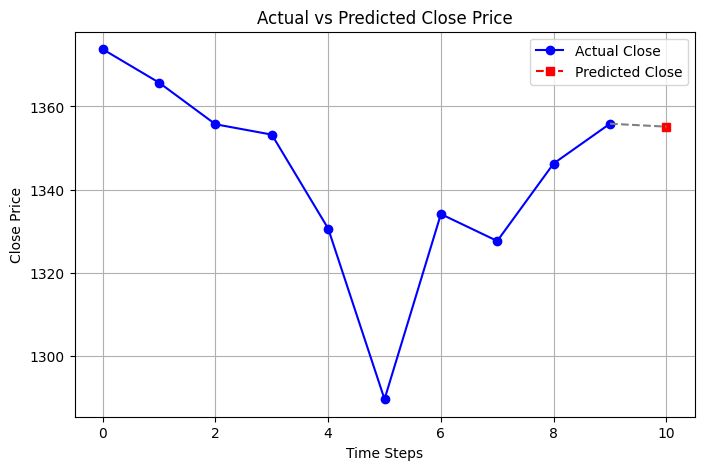

In [145]:
import numpy as np
import matplotlib.pyplot as plt

# Pastikan data dalam bentuk array numpy
actual_close = last_10_data["close"].values
predicted_close = predictions_new.flatten()  # Pastikan 1D

# Buat indeks untuk sumbu x
actual_indices = np.arange(len(actual_close))
predicted_indices = np.arange(len(actual_close), len(actual_close) + len(predicted_close))

plt.figure(figsize=(8, 5))

# Plot harga aktual dengan garis biru
plt.plot(actual_indices, actual_close, label="Actual Close", marker="o", linestyle="-", color="blue")

# Plot harga prediksi dengan garis merah putus-putus
plt.plot(predicted_indices, predicted_close, label="Predicted Close", marker="s", linestyle="dashed", color="red")

# Hubungkan titik terakhir data aktual ke titik pertama prediksi
plt.plot([actual_indices[-1], predicted_indices[0]], 
         [actual_close[-1], predicted_close[0]], 
         linestyle="dashed", color="gray")

plt.xlabel("Time Steps")
plt.ylabel("Close Price")
plt.title("Actual vs Predicted Close Price")
plt.legend()
plt.grid(True)
plt.show()


In [146]:
df_stock["G"].head(11)

,Tanggal,open,high,low,close,stock_num,vol
0,2025-02-03,1418.748,1417.186,1394.941,1411.965,105,1663038163
1,2025-02-04,1411.965,1419.000,1401.586,1405.702,105,1208184512
2,2025-02-05,1405.702,1403.256,1384.968,1385.990,105,1120565347
3,2025-02-06,1385.990,1385.334,1349.246,1354.928,105,2103922497
4,2025-02-07,1354.928,1364.633,1339.766,1364.633,105,1517472808
5,2025-02-10,1364.633,1363.854,1339.732,1346.979,105,1821662397
6,2025-02-11,1346.979,1346.801,1325.214,1333.492,105,1948590239
7,2025-02-12,1333.492,1350.947,1331.138,1350.947,105,1390983374
8,2025-02-13,1350.947,1353.547,1342.179,1348.573,105,1417728692
9,2025-02-14,1348.573,1361.657,1347.726,1356.603,105,2613806377


# Set Random Seed

In [5]:
num = 42
os.environ['PYTHONHASHSEED'] = str(num)

def set_random_seed(seed):
    random.seed(seed)  
    np.random.seed(seed)     
    tf.random.set_seed(seed)
    print(f"Random seed set to {seed} for all libraries.")

set_random_seed(num)

Random seed set to 42 for all libraries.


# Data Preparation for Modeling

In [30]:
class DataPreprocessor:
    def __init__(self):
        self.scalers = {
            col: MinMaxScaler() for col in ['open', 'high', 'low', 'close', 'stock_num', 'vol']
        }
        self.target_scaler = MinMaxScaler()
    
    def fit_transform_data(self, data):
        stock_data = np.column_stack([
            self.scalers[col].fit_transform(data[[col]]) 
            for col in self.scalers
        ])
        target = self.target_scaler.fit_transform(data[['close']])
        return stock_data, target
    
    def transform_data(self, data):
        stock_data = np.column_stack([
            self.scalers[col].transform(data[[col]]) 
            for col in self.scalers
        ])
        target = self.target_scaler.transform(data[['close']])
        return stock_data, target
    
    def inverse_transform_target(self, scaled_target):
        return self.target_scaler.inverse_transform(scaled_target.reshape(-1, 1))


def prepare_data_with_preprocessor(combined_data, timestep=10, preprocessor=None, is_training=True):
    if is_training:
        if preprocessor is None:
            preprocessor = DataPreprocessor()
        stock_data_scaled, target_scaled = preprocessor.fit_transform_data(combined_data)
    else:
        assert preprocessor is not None, "Preprocessor must be provided for test data"
        stock_data_scaled, target_scaled = preprocessor.transform_data(combined_data)
    X_news, X_stock, y = [], [], []
    
    for i in range(timestep, len(combined_data) - 1):
        try:
            thought_vector = np.transpose(combined_data.iloc[i-1]['thought_vector'], (0, 2, 1))
            thought_vector = np.expand_dims(thought_vector, axis=-1)
            stock_features = stock_data_scaled[i - timestep:i]
            target = target_scaled[i, 0]
            
            X_news.append(thought_vector)
            X_stock.append(stock_features)
            y.append(target)
        except Exception as e:
            print(f"Error processing row {i}: {str(e)}")
            continue
    return (np.array(X_news), np.array(X_stock), np.array(y)), preprocessor

def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Build Model STACN with Ablation

In [4]:
class STACN_Ablation:
    def __init__(self, time_steps=10, num_features=6, cnn_input_shape=(5, 768, 4, 1), ablation_mode='full', use_bidirectional=True):
        self.time_steps = time_steps
        self.num_features = num_features
        self.cnn_input_shape = cnn_input_shape
        self.ablation_mode = ablation_mode  # 'full', 'no_attention', 'lstm_only'
        self.use_bidirectional = use_bidirectional  # True untuk bidirectional, False untuk LSTM konvensional

    def build_cnn(self, inputs):
        if self.ablation_mode in ['no_cnn', 'lstm_only']:
            # Skip CNN, langsung flatten input
            x = layers.Flatten()(inputs)
            x = layers.Dense(32, activation='relu')(x) 
            return x
        
        # Layer Conv3D pertama
        x = layers.Conv3D(128, (5, 5, 1), strides=(1, 4, 1), padding='same', activation='relu')(inputs)
        x = layers.MaxPool3D((3, 3, 1), strides=(1, 2, 1), padding='same')(x)

        for _ in range(3):
            x = layers.Conv3D(128, (5, 5, 1), strides=(1, 4, 1), padding='same', activation='relu')(x)
            x = layers.MaxPool3D((3, 3, 1), strides=(1, 2, 1), padding='same')(x)
        
        # Flatten dan Fully Connected Layers
        x = layers.Flatten()(x)
        x = layers.Dense(90, activation='relu')(x)
        cnn_output = layers.Dense(5, activation='relu', name='cnn_output')(x)  # Output shape: (None, 5)
        
        return cnn_output

    def build_lstm(self, inputs):
        if self.use_bidirectional:
            # LSTM bidirectional
            x = layers.Bidirectional(layers.LSTM(256, return_sequences=True))(inputs)
            x = layers.Dropout(0.01)(x)
            x = layers.Bidirectional(layers.LSTM(64, return_sequences=False))(x)
        else:
            # LSTM konvensional
            x = layers.LSTM(256, return_sequences=True)(inputs)
            x = layers.Dropout(0.01)(x)
            x = layers.LSTM(64, return_sequences=False)(x)
        
        x = layers.Dropout(0.01)(x)
        lstm_output = layers.Dense(32, activation='relu')(x)  
        return lstm_output

    def build_attention(self, cnn_features, lstm_states):
        if self.ablation_mode in ['no_attention', 'lstm_only']:
            return cnn_features  # Skip Attention
        if len(cnn_features.shape) > 2:
            cnn_features = layers.Flatten()(cnn_features)
        if len(lstm_states.shape) > 2:
            lstm_states = layers.Flatten()(lstm_states)
        
        concat = layers.Concatenate()([cnn_features, lstm_states])
        x = layers.Dense(100, activation='relu')(concat)
        x = layers.Dense(50, activation='relu')(x)
        attention_weights = layers.Dense(cnn_features.shape[-1], activation='softmax')(x)
        return attention_weights

    def build_model(self, use_precomputed_cnn=False, cnn_output_shape=5):
        news_input = layers.Input(shape=self.cnn_input_shape, name='news_input')
        stock_input = layers.Input(shape=(self.time_steps, self.num_features), name='stock_input')
        cnn_features = self.build_cnn(news_input)
        lstm_output = self.build_lstm(stock_input)
        attention_weights = self.build_attention(cnn_features, lstm_output)
        
        if self.ablation_mode == 'no_attention':
            concat = layers.Concatenate()([cnn_features, lstm_output])
        elif self.ablation_mode == 'lstm_only':
            concat = lstm_output
        else:  # full model
            weighted_features = layers.Multiply()([cnn_features, attention_weights])
            concat = layers.Concatenate()([weighted_features, lstm_output])
        
        x = layers.Dense(32, activation='relu')(concat)
        output = layers.Dense(1, activation='linear')(x)
        
        model = Model(inputs=[news_input, stock_input], outputs=output)
        model.compile(optimizer='adam', loss='mse', metrics=['mae'])
        return model

# Arsitektur Ablasi

In [5]:
# Inisialisasi model
stacn_model_full_bi = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='full',
    use_bidirectional=True
)

model_full_bi = stacn_model_full_bi.build_model()
model_full_bi.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d (Conv3D)           │ (None, 5, 192, 4, 128) │          3,328 │ news_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d             │ (None, 5, 96, 4, 128)  │              0 │ conv3d[0][0]           │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_1 (Conv3D)         │ (None, 5, 24, 4, 128)  │        409,728 │ max_pooling3d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_1           │ (None, 5, 12, 4, 128)  │              0 │ conv3d_1[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_2 (Conv3D)         │ (None, 5, 3, 4, 128)   │        409,728 │ max_pooling3d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_2           │ (None, 5, 2, 4, 128)   │              0 │ conv3d_2[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_3 (Conv3D)         │ (None, 5, 1, 4, 128)   │        409,728 │ max_pooling3d_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional             │ (None, 10, 512)        │        538,624 │ stock_input[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_3           │ (None, 5, 1, 4, 128)   │              0 │ conv3d_3[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 10, 512)        │              0 │ bidirectional[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 2560)           │              0 │ max_pooling3d_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_1           │ (None, 128)            │        295,424 │ dropout[0][0]          │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 90)             │        230,490 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 128)            │              0 │ bidirectional_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cnn_output (Dense)   

 Total params: 2,311,987 (8.82 MB)

 Trainable params: 2,311,987 (8.82 MB)

 Non-trainable params: 0 (0.00 B)

In [6]:
# Tentukan path folder yang ingin dibuat
folder_path = '/kaggle/working/visualisasi'

# Buat folder jika belum ada
if not os.path.exists(folder_path):
    os.makedirs(folder_path)
    print(f"Folder '{folder_path}' berhasil dibuat.")
else:
    print(f"Folder '{folder_path}' sudah ada.")


Folder '/kaggle/working/visualisasi' berhasil dibuat.


In [30]:
plot_model(model_full_bi, show_shapes=True, show_layer_names=True, expand_nested=True, dpi=500, to_file='model_full_bi.png')

In [15]:
# Inisialisasi model
stacn_model_full_conv = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='full',
    use_bidirectional=False
)

model_full_conv = stacn_model_full_conv.build_model()
model_full_conv.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_4 (Conv3D)         │ (None, 5, 192, 4, 128) │          3,328 │ news_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_4           │ (None, 5, 96, 4, 128)  │              0 │ conv3d_4[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_5 (Conv3D)         │ (None, 5, 24, 4, 128)  │        409,728 │ max_pooling3d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_5           │ (None, 5, 12, 4, 128)  │              0 │ conv3d_5[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_6 (Conv3D)         │ (None, 5, 3, 4, 128)   │        409,728 │ max_pooling3d_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_6           │ (None, 5, 2, 4, 128)   │              0 │ conv3d_6[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_7 (Conv3D)         │ (None, 5, 1, 4, 128)   │        409,728 │ max_pooling3d_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_2 (LSTM)             │ (None, 10, 256)        │        269,312 │ stock_input[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_7           │ (None, 5, 1, 4, 128)   │              0 │ conv3d_7[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 10, 256)        │              0 │ lstm_2[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_1 (Flatten)       │ (None, 2560)           │              0 │ max_pooling3d_7[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_3 (LSTM)             │ (None, 64)             │         82,176 │ dropout_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_7 (Dense)           │ (None, 90)             │        230,490 │ flatten_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_3 (Dropout)       │ (None, 64)             │              0 │ lstm_3[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cnn_output (Dense)        │ (None, 5)              │            455 │ dense_7[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_8 (Dense)      

 Total params: 1,827,379 (6.97 MB)

 Trainable params: 1,827,379 (6.97 MB)

 Non-trainable params: 0 (0.00 B)

In [17]:
# Inisialisasi model
stacn_model_no_attention_bi = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='no_attention',
    use_bidirectional=True
)

model_no_attention_bi = stacn_model_no_attention_bi.build_model()
model_no_attention_bi.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_8 (Conv3D)         │ (None, 5, 192, 4, 128) │          3,328 │ news_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_8           │ (None, 5, 96, 4, 128)  │              0 │ conv3d_8[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_9 (Conv3D)         │ (None, 5, 24, 4, 128)  │        409,728 │ max_pooling3d_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_9           │ (None, 5, 12, 4, 128)  │              0 │ conv3d_9[0][0]         │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_10 (Conv3D)        │ (None, 5, 3, 4, 128)   │        409,728 │ max_pooling3d_9[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_10          │ (None, 5, 2, 4, 128)   │              0 │ conv3d_10[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_11 (Conv3D)        │ (None, 5, 1, 4, 128)   │        409,728 │ max_pooling3d_10[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_2           │ (None, 10, 512)        │        538,624 │ stock_input[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_11          │ (None, 5, 1, 4, 128)   │              0 │ conv3d_11[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_4 (Dropout)       │ (None, 10, 512)        │              0 │ bidirectional_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_2 (Flatten)       │ (None, 2560)           │              0 │ max_pooling3d_11[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_3           │ (None, 128)            │        295,424 │ dropout_4[0][0]        │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_14 (Dense)          │ (None, 90)             │        230,490 │ flatten_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_5 (Dropout)       │ (None, 128)            │              0 │ bidirectional_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cnn_output (Dense)   

 Total params: 2,302,882 (8.78 MB)

 Trainable params: 2,302,882 (8.78 MB)

 Non-trainable params: 0 (0.00 B)

In [19]:
# Inisialisasi model
stacn_model_no_attention_conv = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='no_attention',
    use_bidirectional=False
)

model_no_attention_conv = stacn_model_no_attention_conv.build_model()
model_no_attention_conv.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_12 (Conv3D)        │ (None, 5, 192, 4, 128) │          3,328 │ news_input[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_12          │ (None, 5, 96, 4, 128)  │              0 │ conv3d_12[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_13 (Conv3D)        │ (None, 5, 24, 4, 128)  │        409,728 │ max_pooling3d_12[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_13          │ (None, 5, 12, 4, 128)  │              0 │ conv3d_13[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_14 (Conv3D)        │ (None, 5, 3, 4, 128)   │        409,728 │ max_pooling3d_13[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_14          │ (None, 5, 2, 4, 128)   │              0 │ conv3d_14[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_15 (Conv3D)        │ (None, 5, 1, 4, 128)   │        409,728 │ max_pooling3d_14[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_6 (LSTM)             │ (None, 10, 256)        │        269,312 │ stock_input[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_15          │ (None, 5, 1, 4, 128)   │              0 │ conv3d_15[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_6 (Dropout)       │ (None, 10, 256)        │              0 │ lstm_6[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_3 (Flatten)       │ (None, 2560)           │              0 │ max_pooling3d_15[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_7 (LSTM)             │ (None, 64)             │         82,176 │ dropout_6[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_18 (Dense)          │ (None, 90)             │        230,490 │ flatten_3[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_7 (Dropout)       │ (None, 64)             │              0 │ lstm_7[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ cnn_output (Dense)        │ (None, 5)              │            455 │ dense_18[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_19 (Dense)     

 Total params: 1,818,274 (6.94 MB)

 Trainable params: 1,818,274 (6.94 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
# Inisialisasi model
stacn_model_lstm_only_bi = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='lstm_only',
    use_bidirectional=True
)

model_lstm_only_bi = stacn_model_lstm_only_bi.build_model()
model_lstm_only_bi.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_4           │ (None, 10, 512)        │        538,624 │ stock_input[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_8 (Dropout)       │ (None, 10, 512)        │              0 │ bidirectional_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_5           │ (None, 128)            │        295,424 │ dropout_8[0][0]        │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_9 (Dropout)       │ (None, 128)            │              0 │ bidirectional_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_23 (Dense)          │ (None, 32)             │          4,128 │ dropout_9[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_24 (Dense)          │ (None, 32)             │          1,056 │ dense_23[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_25 (Dense)          │ (None, 1)              │             33 │ dense_24[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 839,265 (3.20 MB)

 Trainable params: 839,265 (3.20 MB)

 Non-trainable params: 0 (0.00 B)

In [23]:
# Inisialisasi model
stacn_model_lstm_only_conv = STACN_Ablation(
    time_steps=10,
    num_features=6,
    cnn_input_shape=(5, 768, 4, 1),
    ablation_mode='lstm_only',
    use_bidirectional=False
)

model_lstm_only_conv = stacn_model_lstm_only_conv.build_model()
model_lstm_only_conv.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ stock_input (InputLayer)  │ (None, 10, 6)          │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_10 (LSTM)            │ (None, 10, 256)        │        269,312 │ stock_input[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_10 (Dropout)      │ (None, 10, 256)        │              0 │ lstm_10[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_11 (LSTM)            │ (None, 64)             │         82,176 │ dropout_10[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_11 (Dropout)      │ (None, 64)             │              0 │ lstm_11[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_27 (Dense)          │ (None, 32)             │          2,080 │ dropout_11[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_28 (Dense)          │ (None, 32)             │          1,056 │ dense_27[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ news_input (InputLayer)   │ (None, 5, 768, 4, 1)   │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_29 (Dense)          │ (None, 1)              │             33 │ dense_28[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 354,657 (1.35 MB)

 Trainable params: 354,657 (1.35 MB)

 Non-trainable params: 0 (0.00 B)

# Train Model STACN with Ablation

**Parameter:**
*    data_dict: Input data dictionary
*    key: Dataset key
*    timestep: Number of timesteps for LSTM
*    batch_size: Batch size for training
*    epochs: Number of training epochs (default increased to 100)
*    ablation_mode: Model ablation mode
*    use_bidirectional: Whether to use bidirectional LSTM
    
**Returns:**
*    results: Dictionary of evaluation metrics

In [29]:
def train_and_evaluate(num, data_dict, key, timestep=10, batch_size=32, epochs=100, ablation_mode='full', use_bidirectional=True):
    results = {}
    df = data_dict
    
    print(f"\nMemproses saham sektor: {key} dengan mode ablasi: {ablation_mode} dan tipe LSTM: {'Bidirectional' if use_bidirectional else 'Conventional'}")
    
    # Prepare data
    preprocessor = DataPreprocessor()
    (X_news, X_stock, y), preprocessor = prepare_data_with_preprocessor(df, timestep=timestep, is_training=True)
    split_index = int(len(X_news) * 0.80)
    X_news_train, X_news_test = X_news[:split_index], X_news[split_index:]
    X_stock_train, X_stock_test = X_stock[:split_index], X_stock[split_index:]
    y_train, y_test = y[:split_index], y[split_index:]

    # Simpan preprocessor setelah training
    output_dir = f'/kaggle/working/best-model-ablasi'
    import os
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    preprocessor_path = os.path.join(output_dir, f'preprocessor_{key}.pkl')
    import pickle
    with open(preprocessor_path, "wb") as f:
        pickle.dump(preprocessor, f)

    print(f"Preprocessor saved successfully for {key} at {preprocessor_path}")
        
    # Inisialisasi model
    stacn_model = STACN_Ablation(
        time_steps=timestep,
        num_features=6,
        cnn_input_shape=(5, 768, 4, 1),
        ablation_mode=ablation_mode,
        use_bidirectional=use_bidirectional
    )
    
    model = stacn_model.build_model()

    train_input = [X_news_train, X_stock_train]
    test_input = [X_news_test, X_stock_test]
    
    model_filename = f'best_model_STACN_{key}_{ablation_mode}_{"bi" if use_bidirectional else "conv"}.keras'
    model_path = os.path.join(output_dir, model_filename)
    
    
    early_stopping = EarlyStopping(
        monitor='val_mae',
        patience=20,
        mode='min',
        restore_best_weights=True,
        verbose=1
    )
    
    checkpoint_callback = ModelCheckpoint(
        filepath=model_path,
        monitor='val_mae',
        save_best_only=True,
        mode='min',
        verbose=0
    )
    
    history = model.fit(
        train_input, y_train,
        epochs=epochs, 
        batch_size=batch_size,
        validation_split=0.20,
        callbacks=[checkpoint_callback, early_stopping],  
        verbose=0
    )

    history_df = pd.DataFrame({
        'loss': history.history['loss'],
        'mae': history.history['mae'],
        'val_loss': history.history['val_loss'],
        'val_mae': history.history['val_mae']
    })
    history_path = os.path.join(output_dir, f'history_STACN_{key}_{ablation_mode}_{"bi" if use_bidirectional else "conv"}.csv')
    history_df.to_csv(history_path, index=False)
    print(f"Training history disimpan di: {history_path}")
    
    # Test Best Model
    best_model = load_model(model_path)
    
    predictions_train_scaled = best_model.predict(train_input, verbose=0)
    predictions_test_scaled = best_model.predict(test_input, verbose=0)
    predictions_train = preprocessor.inverse_transform_target(predictions_train_scaled)
    predictions_test = preprocessor.inverse_transform_target(predictions_test_scaled)
    
    y_train_actual = preprocessor.inverse_transform_target(y_train)
    y_test_actual = preprocessor.inverse_transform_target(y_test)
    
    # Evaluation Metrics
    metrics = {
        "mae_train": mean_absolute_error(y_train_actual, predictions_train),
        "rmse_train": np.sqrt(mean_squared_error(y_train_actual, predictions_train)),
        "mse_train": mean_squared_error(y_train_actual, predictions_train),
        "r2_train": r2_score(y_train_actual, predictions_train),
        "mape_train": mean_absolute_percentage_error(y_train_actual, predictions_train), 
        "mae_test": mean_absolute_error(y_test_actual, predictions_test),
        "rmse_test": np.sqrt(mean_squared_error(y_test_actual, predictions_test)),
        "mse_test": mean_squared_error(y_test_actual, predictions_test),
        "r2_test": r2_score(y_test_actual, predictions_test),
        "mape_test": mean_absolute_percentage_error(y_test_actual, predictions_test) 
    }
    
    results[key] = metrics
    
    print()
    print("Evaluation Metrics:")
    for metric_name, value in metrics.items():
        print(f"{metric_name:<12}: {value:.5f}")

    # Plot Results dan simpan gambar
    import matplotlib.pyplot as plt
    plt.figure(figsize=(12, 6))
    plt.plot(y_train_actual, label='Actual Prices (Training)', color='blue')
    plt.plot(predictions_train, label='Predicted Prices (Training)', color='red', linestyle='--')
    plt.plot(range(len(y_train_actual), len(y_train_actual) + len(y_test_actual)), y_test_actual, label='Actual Prices (Testing)', color='green')
    plt.plot(range(len(predictions_train), len(predictions_train) + len(predictions_test)), predictions_test, label='Predicted Prices (Testing)', color='orange', linestyle='--')
    plt.title(f'Actual vs Predicted Stock Prices for {key} ({ablation_mode}, {"Bidirectional" if use_bidirectional else "Conventional"} LSTM)')
    plt.xlabel('Time Steps')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    
    plot_path = os.path.join(output_dir, f'plot_STACN_{key}_{ablation_mode}_{"bi" if use_bidirectional else "conv"}.png')
    plt.savefig(plot_path, dpi=300)
    print(f"Plot saved to: {plot_path}")
    print("___________________________________")
    plt.close()
    
    return results

In [28]:
data = combined_data.copy()

In [ ]:
# Data keys dan ablation modes
data_keys = ["A", "B", "C", "D", "E", "F", "G", "H", "I", "J", "K"]
ablation_modes = ['full', 'no_attention', 'lstm_only']

# Dictionary untuk menyimpan hasil
if 'result_b' not in globals():
    result_b = {}
if 'result_k' not in globals():
    result_k = {}

# Bidirectional True
for mode in ablation_modes:
    print(f"Running ablation study for mode: {mode}")
    result_b[mode] = {}
    
    for key in data_keys:
        print(f"  Processing data: {key}")
        
        result_b[mode][key] = train_and_evaluate(
            num,
            data[key], 
            key=key, 
            ablation_mode=mode, 
            use_bidirectional=True, 
        )

# Bidirectional False
for mode in ablation_modes:
    print(f"Running ablation study for mode: {mode}")
    result_k[mode] = {}
    
    for key in data_keys:
        print(f"  Processing data: {key}")
        result_k[mode][key] = train_and_evaluate(
            num,
            data[key], 
            key=key, 
            ablation_mode=mode, 
            use_bidirectional=False, 
        )

# Testing

In [31]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import layers, Model
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import random

In [32]:
def evaluate_only(data_dict, key, model_paths, timestep=10):
    results = {}
    df = data_dict
    
    # Prepare data
    preprocessor = DataPreprocessor()
    (X_news, X_stock, y), preprocessor = prepare_data_with_preprocessor(df, timestep=timestep, is_training=True)
    
    split_index = int(len(X_news) * 0.80)
    X_news_train, X_news_test = X_news[:split_index], X_news[split_index:]
    X_stock_train, X_stock_test = X_stock[:split_index], X_stock[split_index:]
    y_train, y_test = y[:split_index], y[split_index:]
    
    # Dictionary to store predictions for each ablation mode
    all_predictions_test = {}
    
    for ablation_mode, (model_path, use_stock) in model_paths.items():
        print(f"\nProcessing dataset: {key} with ablation mode: {ablation_mode}")
        
        # Load the corresponding model
        try:
            best_model = load_model(model_path)
        except FileNotFoundError:
            print(f"Model file {model_path} not found. Skipping this ablation mode.")
            continue
        
        # Check if the model is bidirectional
        is_bidirectional = any('bidirectional' in layer.name.lower() for layer in best_model.layers)
        print(f"Model {model_path} is {'bidirectional' if is_bidirectional else 'conventional'}.")
        
        # Prepare input data based on whether the model uses stock data or not
        if use_stock:
            inputs_test = [X_news_test, X_stock_test]
        else:
            inputs_test = [X_news_test]  # Only use news data
        
        # Predictions on test data
        predictions_test_scaled = best_model.predict(inputs_test)
        predictions_test = preprocessor.inverse_transform_target(predictions_test_scaled)
        
        # Store predictions
        all_predictions_test[ablation_mode] = predictions_test
        
        # Evaluation Metrics
        y_test_actual = preprocessor.inverse_transform_target(y_test)
        metrics = {
            "mae_test": mean_absolute_error(y_test_actual, predictions_test),
            "rmse_test": np.sqrt(mean_squared_error(y_test_actual, predictions_test)),
            "mse_test": mean_squared_error(y_test_actual, predictions_test),
            "r2_test": r2_score(y_test_actual, predictions_test),
            "mape_test": mean_absolute_percentage_error(y_test_actual, predictions_test)
        }
        
        results[ablation_mode] = metrics
        print(f"Evaluation Metrics for {ablation_mode}:")
        for metric_name, value in metrics.items():
            print(f"{metric_name:<12}: {value:.4f}")
    
    # Plot combined testing results
    plt.figure(figsize=(12, 6))
    plt.plot(y_test_actual, label='Actual Prices (Testing)', color='blue')
    
    # Plot predictions for each ablation mode
    for ablation_mode, predictions_test in all_predictions_test.items():
        plt.plot(predictions_test, label=f'Predicted Prices ({ablation_mode})', linestyle='--')
    
    plt.title(f'Actual vs Predicted Stock Prices for {key} (Testing)')
    plt.xlabel('Time Steps')
    plt.ylabel('Stock Price')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    return results

In [37]:
# def plot metrics

import matplotlib.pyplot as plt
import numpy as np

def plot_metrics(results):
    # Daftar model
    models = list(results.keys())
    
    # Daftar metrik
    metrics = ['mae_test', 'rmse_test', 'mse_test', 'mape_test', 'r2_test']
    metric_names = ['MAE', 'RMSE', 'MSE','MAPE', 'R2']
    
    # Warna untuk setiap model (gunakan palet warna dari matplotlib)
    colors = plt.cm.tab10(np.linspace(0, 1, len(models)))  # 10 warna berbeda
    
    # Buat subplot untuk setiap metrik
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
    axes = axes.flatten()  # Ubah menjadi array 1D untuk memudahkan iterasi
    
    for i, (metric, metric_name) in enumerate(zip(metrics, metric_names)):
        # Ambil nilai metrik untuk setiap model
        values = [results[model][metric] for model in models]
        
        # Plot bar chart dengan warna-warni
        bars = axes[i].bar(models, values, color=colors)
        axes[i].set_title(metric_name)
        axes[i].set_ylabel(metric_name)
        axes[i].set_xlabel('Model')
        axes[i].tick_params(axis='x', rotation=45)  # Rotasi label sumbu x
        
        # Tambahkan nilai di atas bar
        for bar, value in zip(bars, values):
            height = bar.get_height()
            axes[i].text(bar.get_x() + bar.get_width() / 2, height, f'{value:.4f}', ha='center', va='bottom')
    
    # Sembunyikan subplot yang tidak digunakan
    for i in range(len(metrics), len(axes)):
        fig.delaxes(axes[i])
    
    # Atur layout
    plt.tight_layout()
    plt.show()

# Rolling Test

### Sektor A

In [10]:
df_stock["A"]

,Tanggal,open,high,low,close,stock_num,vol,thought_vector
0,2025-01-15,2791.314,2825.657,2786.571,2807.403,90,2356534758,"[[[0.9997161, 0.8453616, -6.503202e-05, -0.605..."
1,2025-01-16,2807.403,2843.113,2798.096,2827.298,90,3123904172,"[[[0.9997161, 0.8453616, -6.503202e-05, -0.605..."
2,2025-01-17,2827.298,2851.528,2824.623,2849.606,90,2456115124,"[[[0.9997981, 0.8727279, -0.000121091085, -0.6..."
3,2025-01-20,2849.606,2879.930,2856.480,2875.505,90,2479769531,"[[[0.9997012, 0.8400362, -9.6287935e-05, -0.49..."
4,2025-01-21,2875.505,2902.322,2864.812,2871.878,90,2617488248,"[[[0.9997012, 0.8400362, -9.6287935e-05, -0.49..."
5,2025-01-22,2871.878,2899.822,2866.377,2886.770,90,2875380333,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
6,2025-01-23,2886.770,2930.040,2884.991,2892.795,90,3436926896,"[[[0.9997792, 0.86137736, -0.000104378174, -0...."
7,2025-01-24,2892.795,2897.694,2849.455,2877.795,90,2728825153,"[[[0.99974906, 0.8537995, -8.898266e-05, -0.62..."
8,2025-01-30,2877.795,2894.804,2844.449,2869.013,90,2247141030,"[[[0.99965394, 0.8322163, -8.026808e-05, -0.44..."
9,2025-01-31,2869.013,2893.463,2867.950,2889.727,90,2011277420,"[[[0.99965394, 0.8322163, -8.026808e-05, -0.44..."


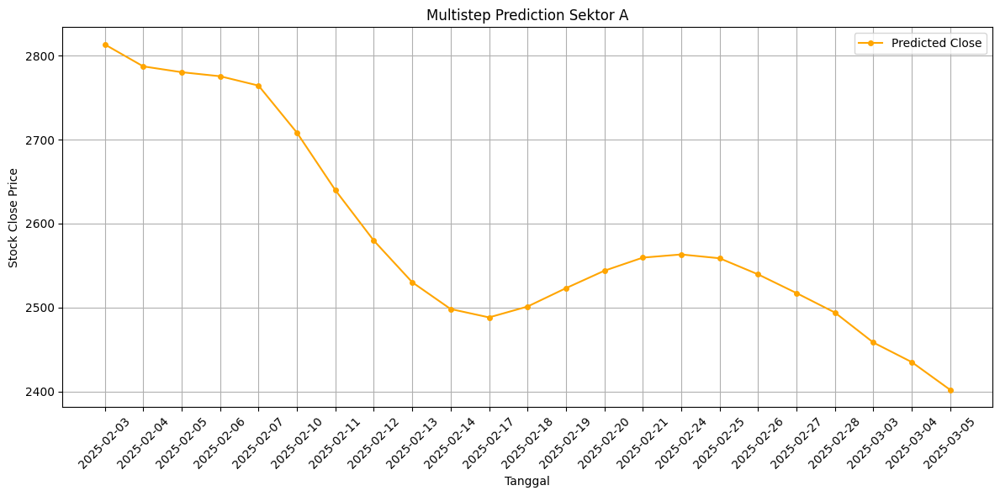

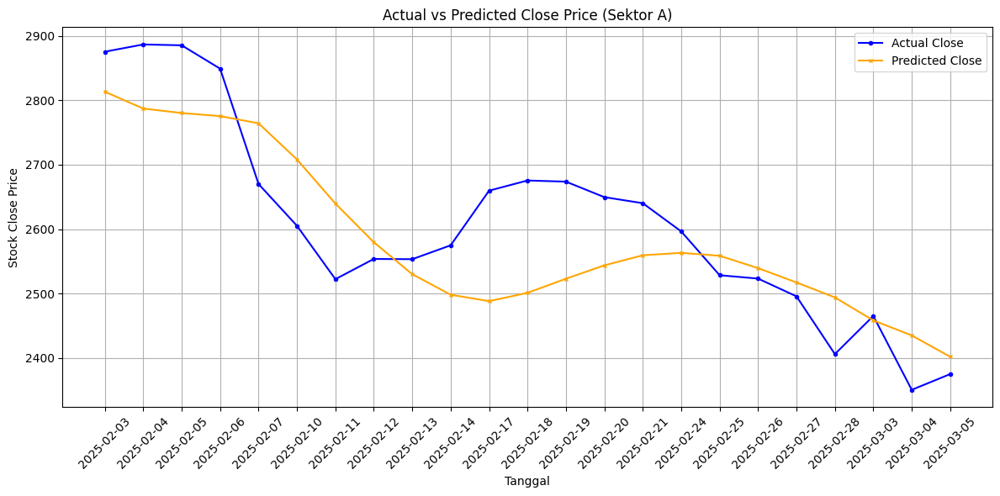

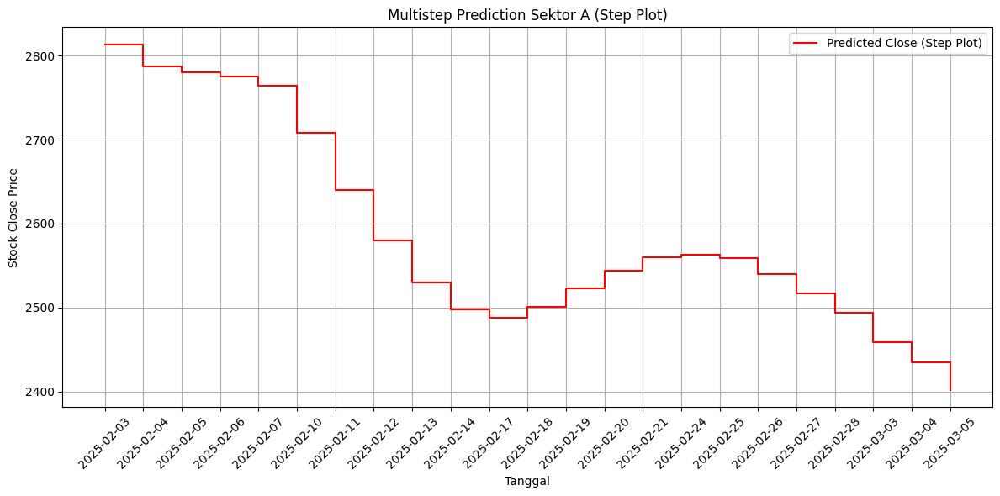

      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     2813.400879      2875.545
1  2025-02-04     2787.263672      2886.815
2  2025-02-05     2780.335938      2885.488
3  2025-02-06     2775.517090      2849.183
4  2025-02-07     2764.376953      2670.111
Evaluasi Model:
MAE: 77.07
RMSE: 90.75
MAPE: 5.96%


In [48]:
# Step 1: Siapkan preprocessor dan data lengkap
import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model

timestep = 10
# Load preprocessor untuk sektor A
preprocessor_A = joblib.load('/kaggle/working/preprocessor/preprocessor_A.pkl')
# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['A']  # ambil data sektor A
# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_A.transform_data(df)
# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_A, is_training=False)

# Step 2: Load model terbaik
model_path = '/kaggle/working/best_model_STACN_A_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)
predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]
    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)
    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_A.inverse_transform_target(np.array(predictions_scaled))

# Step 6: Plot hasil - REVISI
# Dapatkan tanggal yang sesuai
dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values

# Dapatkan data aktual untuk perbandingan
actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values

# Plot 1: Dengan marker untuk menunjukkan sudut/titik data
plt.figure(figsize=(12, 6))
plt.plot(dates, predictions_close, label='Predicted Close', color='orange', 
         linestyle='-', marker='o', markersize=4)
plt.title('Multistep Prediction Sektor A')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot 2: Plot perbandingan aktual vs prediksi
plt.figure(figsize=(12, 6))
plt.plot(dates, actual_close, label='Actual Close', color='blue', marker='o', markersize=3)
plt.plot(dates, predictions_close, label='Predicted Close', color='orange', 
         linestyle='-', marker='x', markersize=3)
plt.title('Actual vs Predicted Close Price (Sektor A)')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot 3: Plot dengan gaya step untuk melihat perubahan yang jelas
plt.figure(figsize=(12, 6))
plt.step(dates, predictions_close, label='Predicted Close (Step Plot)', 
         color='red', where='post', linewidth=1.5)
plt.title('Multistep Prediction Sektor A (Step Plot)')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Simpan nilai prediksi dalam DataFrame
prediction_df = pd.DataFrame()
prediction_df['Tanggal'] = dates
prediction_df['Nilai_Prediksi'] = predictions_close
prediction_df['Nilai_Aktual'] = actual_close
print(prediction_df.head())

# Hitung metrik evaluasi
from sklearn.metrics import mean_absolute_error, mean_squared_error
mae = mean_absolute_error(actual_close, predictions_close)
rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100

print(f"Evaluasi Model:")
print(f"MAE: {mae:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"MAPE: {mape:.2f}%")

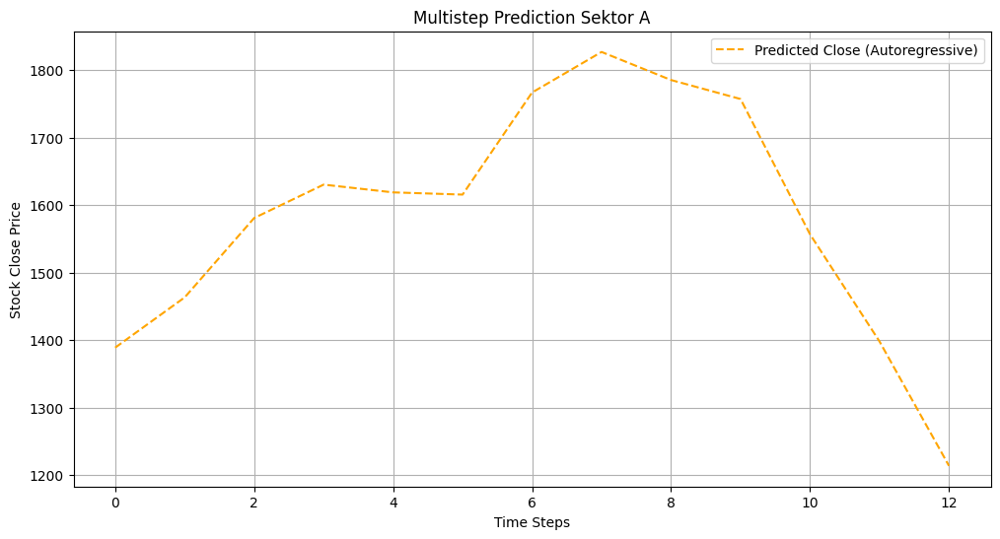

In [41]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor A
preprocessor_A = joblib.load('/kaggle/working/preprocessor/preprocessor_A.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['A']  # ambil data sektor A

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_A.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_A, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_A_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_A.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_A.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction Sektor A')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


# Bidirectional


PROCESSING SEKTOR A


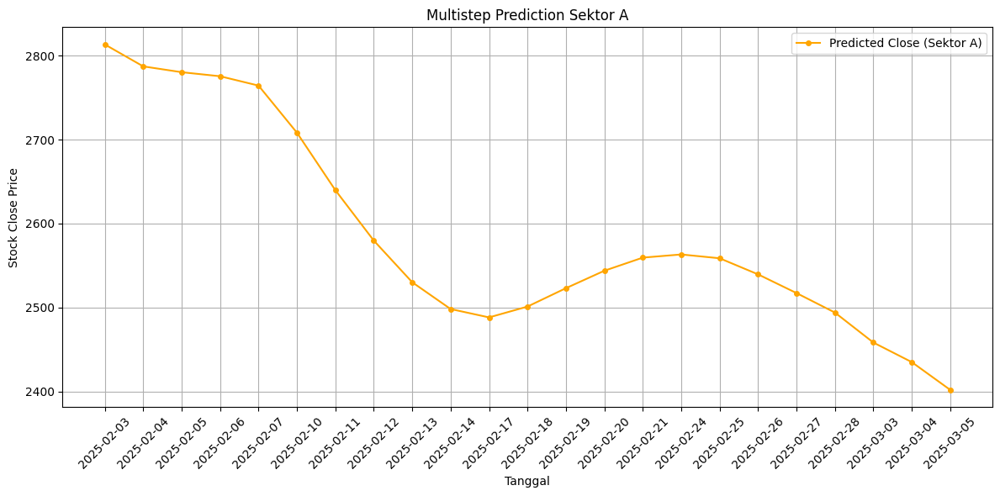

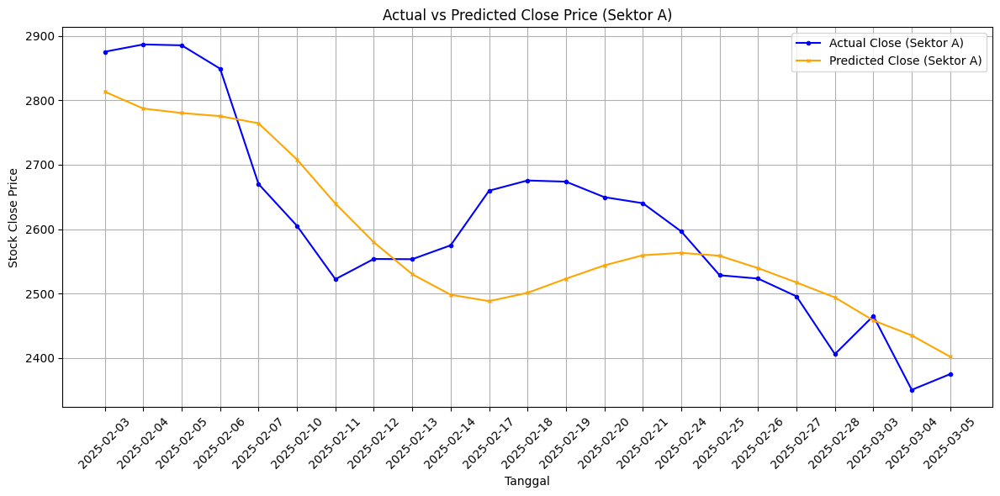

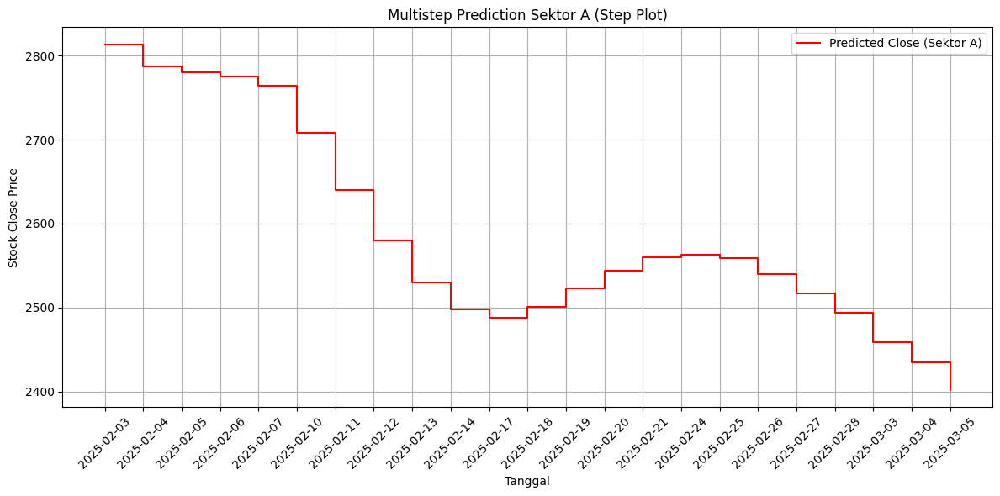

Head data prediksi Sektor A:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     2813.400879      2875.545
1   2025-02-04     2787.263672      2886.815
2   2025-02-05     2780.335938      2885.488
3   2025-02-06     2775.517090      2849.183
4   2025-02-07     2764.376953      2670.111
5   2025-02-10     2708.238281      2605.239
6   2025-02-11     2639.742676      2522.332
7   2025-02-12     2579.723633      2553.726
8   2025-02-13     2530.067139      2553.363
9   2025-02-14     2498.163086      2574.895
10  2025-02-17     2488.199707      2659.762
11  2025-02-18     2501.104736      2675.566
12  2025-02-19     2523.015869      2673.765
13  2025-02-20     2543.788574      2649.705
14  2025-02-21     2559.421143      2640.302
15  2025-02-24     2563.197754      2596.529
16  2025-02-25     2558.656250      2528.448
17  2025-02-26     2539.489258      2523.244
18  2025-02-27     2517.210449      2495.665
19  2025-02-28     2493.984619      2405.982
20  2025-03-03     2458.29

<ipython-input-12-a49c26744ec0>:128: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


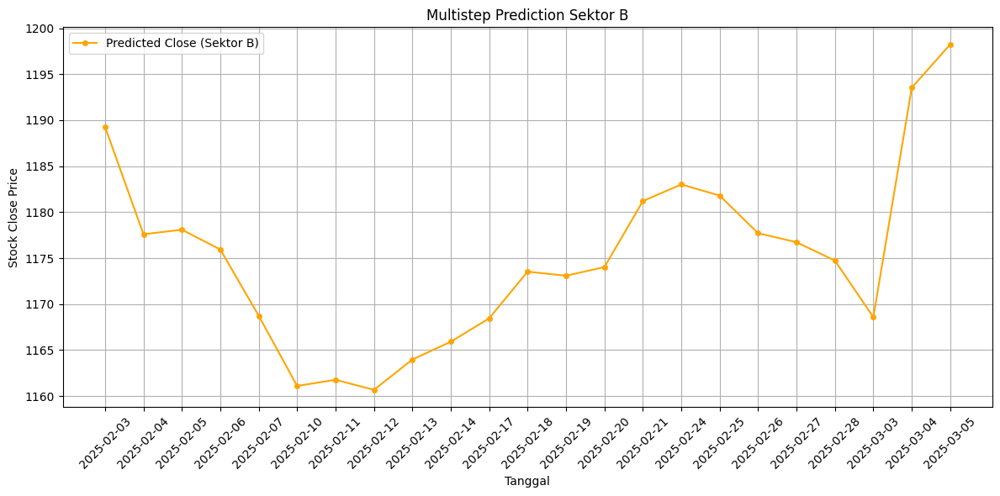

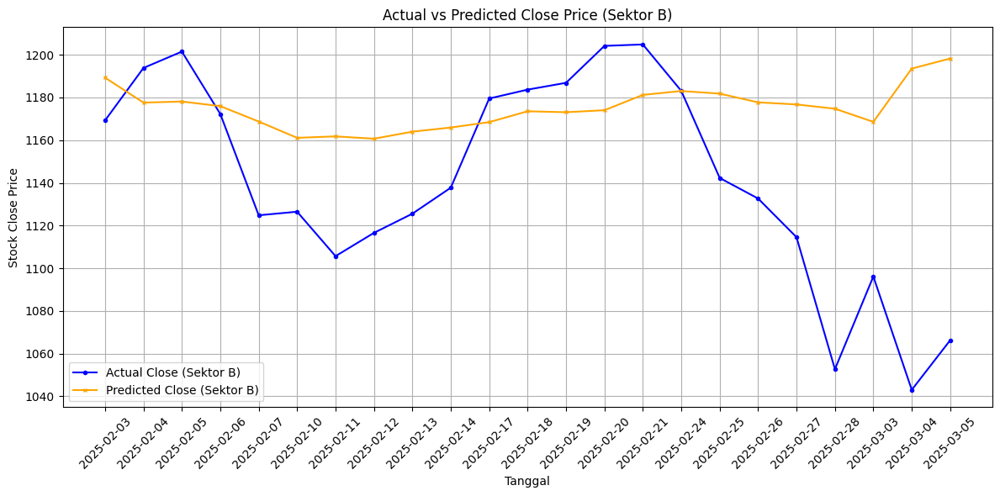

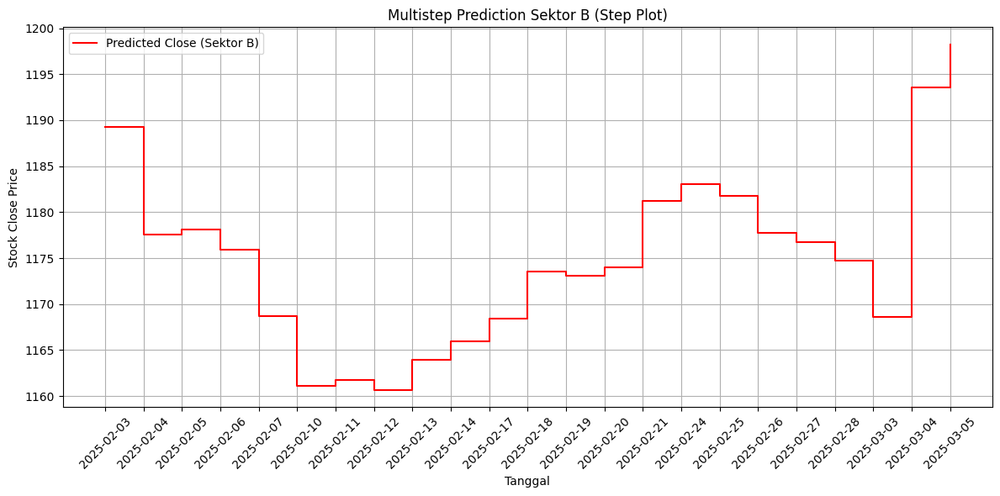

Head data prediksi Sektor B:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1189.279053      1169.232
1   2025-02-04     1177.593872      1193.817
2   2025-02-05     1178.090088      1201.485
3   2025-02-06     1175.937256      1172.273
4   2025-02-07     1168.732300      1124.812
5   2025-02-10     1161.096680      1126.481
6   2025-02-11     1161.769897      1105.669
7   2025-02-12     1160.674072      1116.570
8   2025-02-13     1163.969360      1125.552
9   2025-02-14     1165.905884      1137.731
10  2025-02-17     1168.450684      1179.500
11  2025-02-18     1173.528198      1183.668
12  2025-02-19     1173.083496      1186.856
13  2025-02-20     1174.024780      1204.159
14  2025-02-21     1181.196777      1204.832
15  2025-02-24     1183.013306      1183.083
16  2025-02-25     1181.798828      1142.301
17  2025-02-26     1177.708130      1132.661
18  2025-02-27     1176.731567      1114.539
19  2025-02-28     1174.727051      1052.718
20  2025-03-03     1168.57

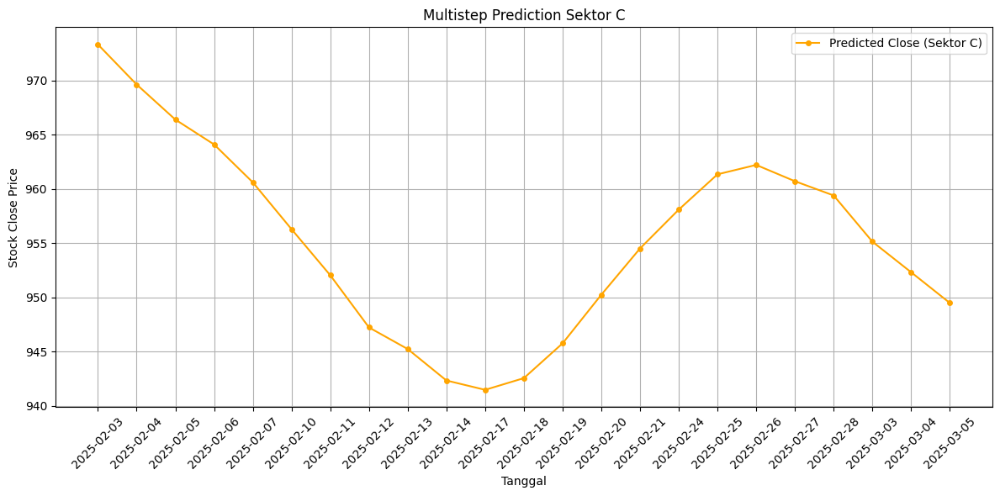

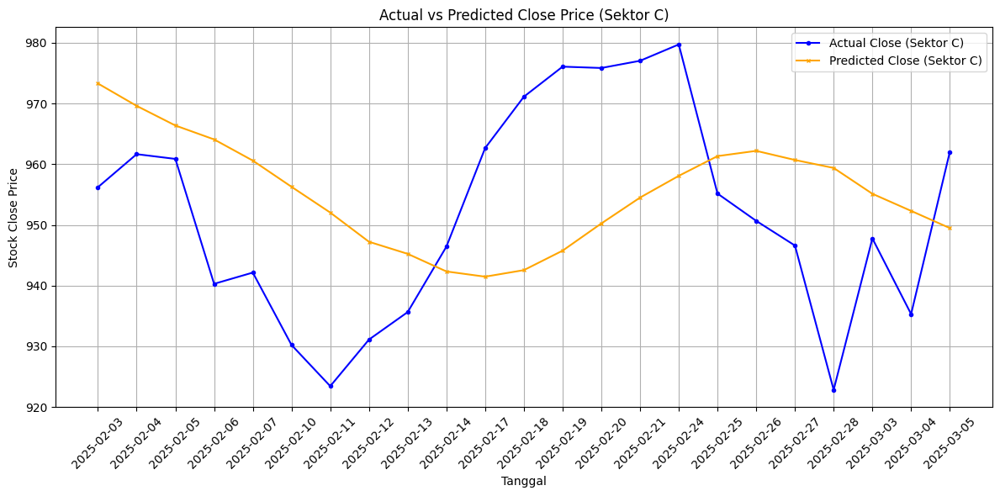

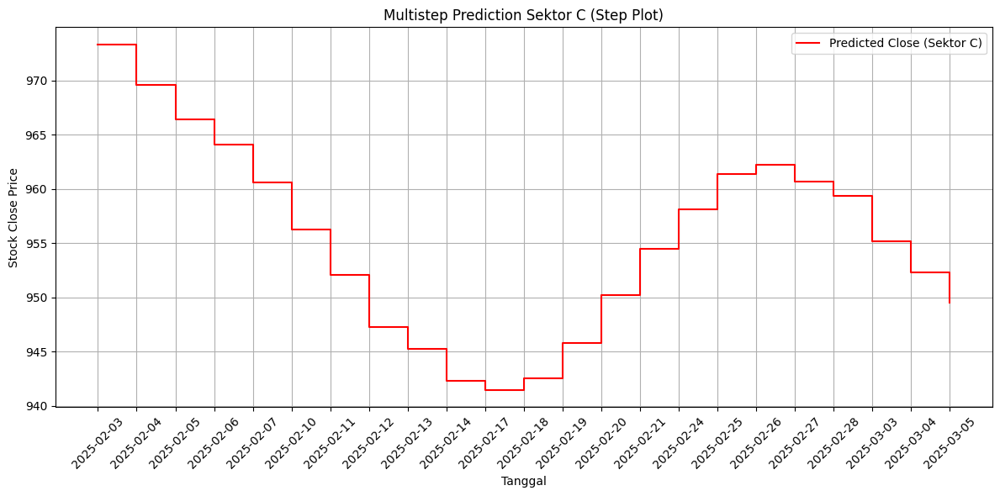

Head data prediksi Sektor C:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      973.311279       956.215
1   2025-02-04      969.620117       961.663
2   2025-02-05      966.385437       960.880
3   2025-02-06      964.092834       940.296
4   2025-02-07      960.601318       942.151
5   2025-02-10      956.282959       930.218
6   2025-02-11      952.037170       923.437
7   2025-02-12      947.226624       931.112
8   2025-02-13      945.236389       935.644
9   2025-02-14      942.336853       946.430
10  2025-02-17      941.475769       962.671
11  2025-02-18      942.554932       971.127
12  2025-02-19      945.762695       976.081
13  2025-02-20      950.243713       975.861
14  2025-02-21      954.507263       977.048
15  2025-02-24      958.089417       979.739
16  2025-02-25      961.340271       955.173
17  2025-02-26      962.206909       950.672
18  2025-02-27      960.704651       946.607
19  2025-02-28      959.390564       922.831
20  2025-03-03      955.13

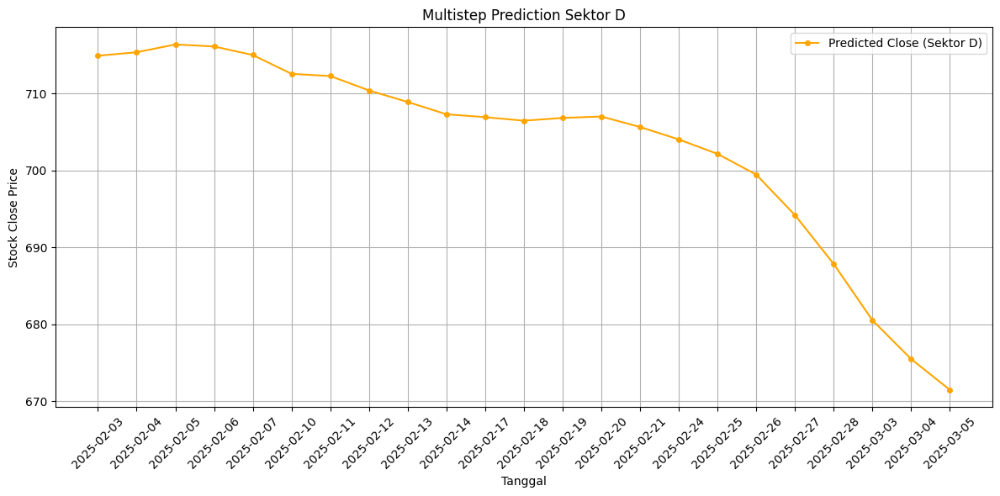

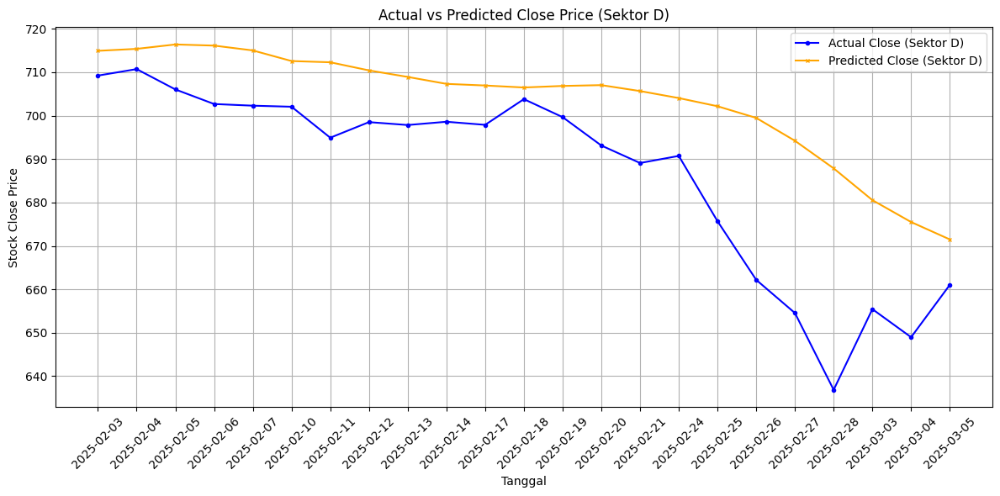

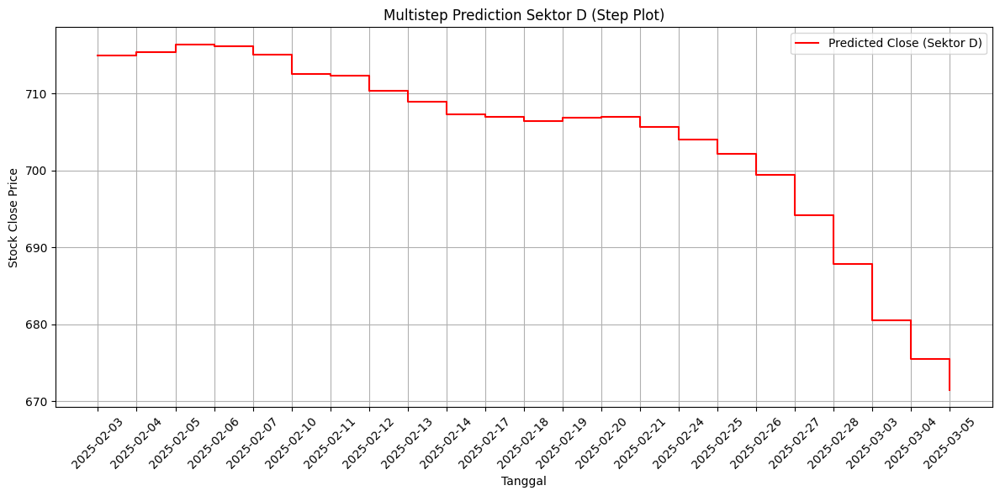

Head data prediksi Sektor D:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      714.934387       709.229
1   2025-02-04      715.386658       710.725
2   2025-02-05      716.401306       706.041
3   2025-02-06      716.137268       702.683
4   2025-02-07      715.025818       702.301
5   2025-02-10      712.580200       702.059
6   2025-02-11      712.295837       694.922
7   2025-02-12      710.423828       698.513
8   2025-02-13      708.921997       697.845
9   2025-02-14      707.323059       698.598
10  2025-02-17      706.947266       697.886
11  2025-02-18      706.489441       703.805
12  2025-02-19      706.846802       699.667
13  2025-02-20      707.033203       693.125
14  2025-02-21      705.668335       689.096
15  2025-02-24      704.051880       690.731
16  2025-02-25      702.173218       675.698
17  2025-02-26      699.482788       662.187
18  2025-02-27      694.215759       654.545
19  2025-02-28      687.866028       636.855
20  2025-03-03      680.54

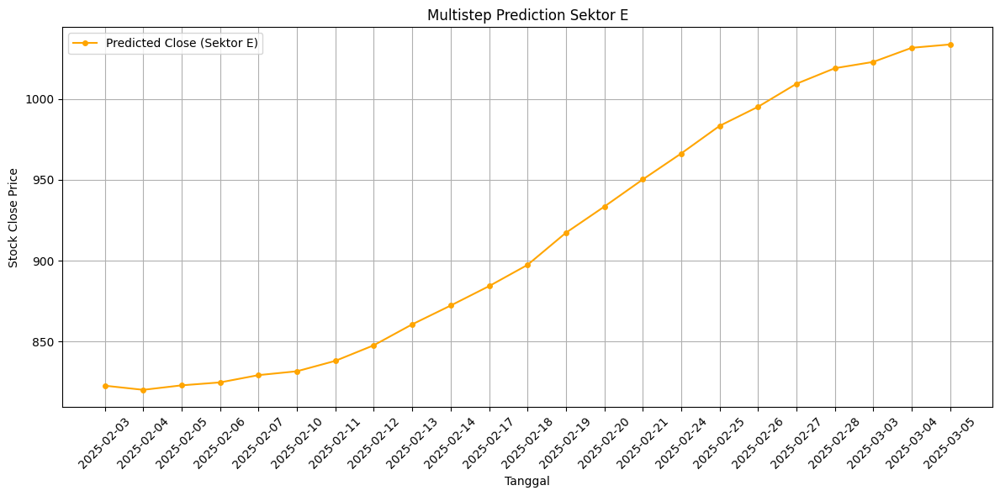

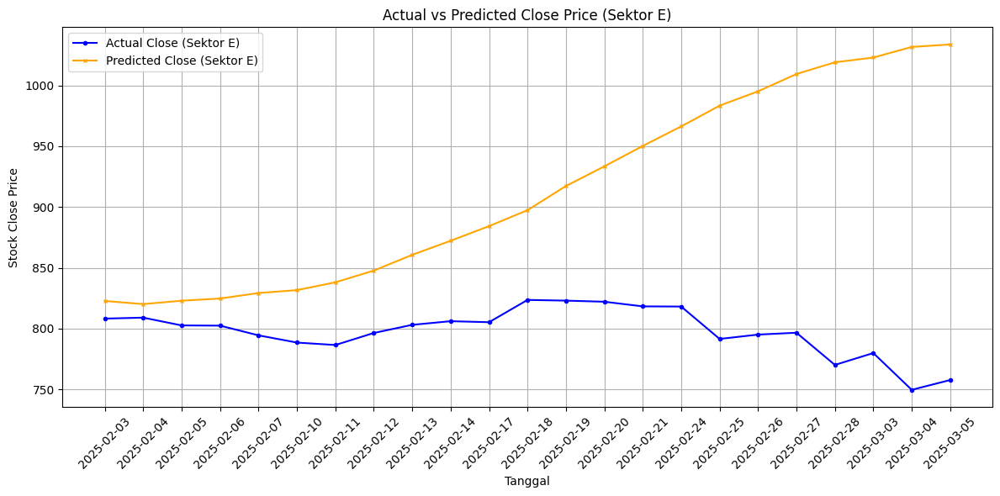

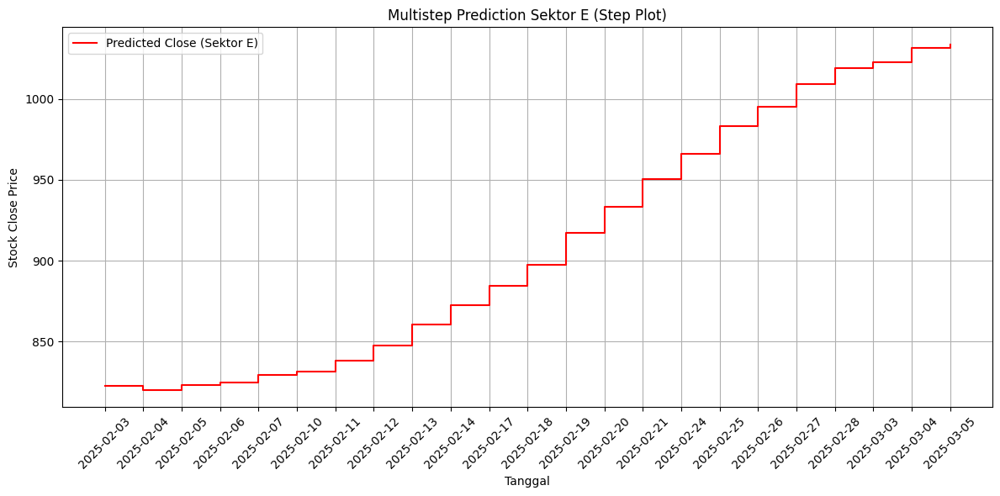

Head data prediksi Sektor E:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      822.675842       808.191
1   2025-02-04      820.113831       808.971
2   2025-02-05      822.892639       802.576
3   2025-02-06      824.709106       802.384
4   2025-02-07      829.217651       794.398
5   2025-02-10      831.597595       788.472
6   2025-02-11      838.032104       786.462
7   2025-02-12      847.670654       796.363
8   2025-02-13      860.617249       803.057
9   2025-02-14      872.222046       806.050
10  2025-02-17      884.233765       805.224
11  2025-02-18      897.362854       823.553
12  2025-02-19      917.223022       822.968
13  2025-02-20      933.420593       822.061
14  2025-02-21      950.190613       818.243
15  2025-02-24      966.259705       818.105
16  2025-02-25      983.327332       791.461
17  2025-02-26      995.116760       795.031
18  2025-02-27     1009.353027       796.564
19  2025-02-28     1018.981628       770.086
20  2025-03-03     1022.88

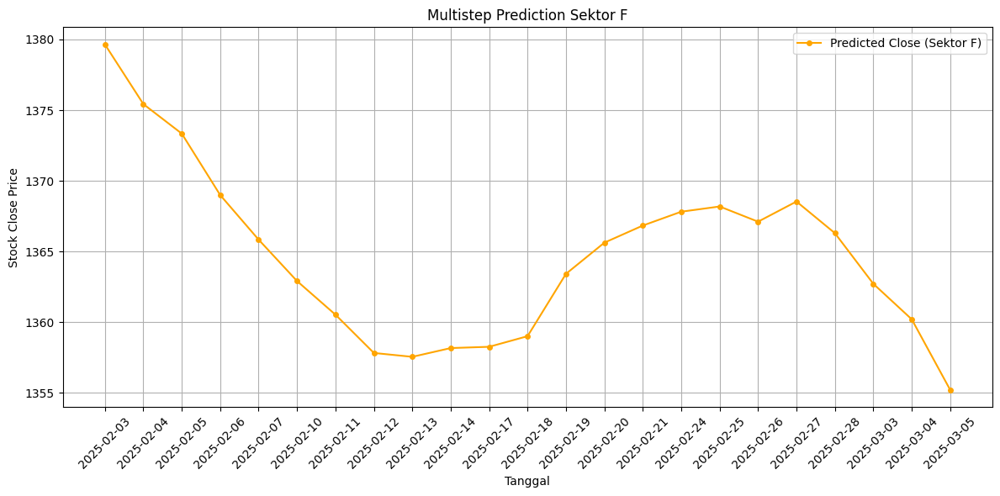

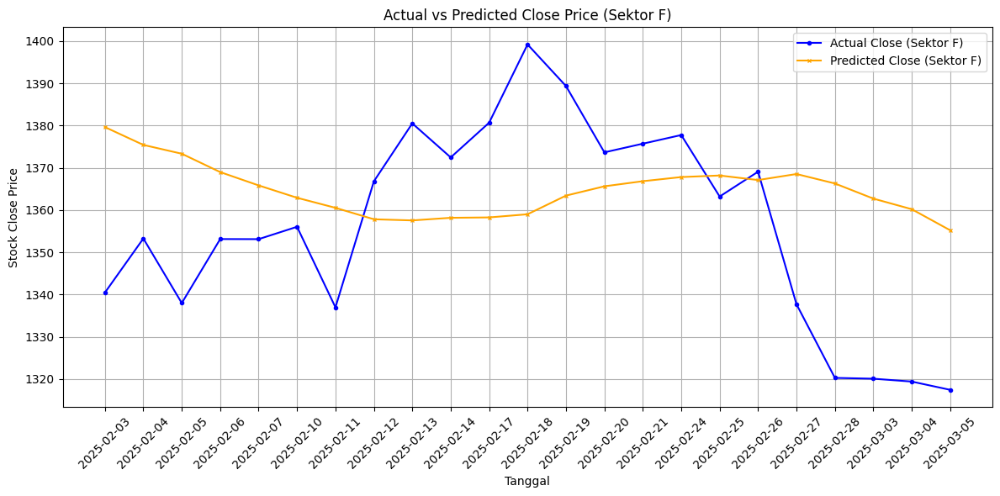

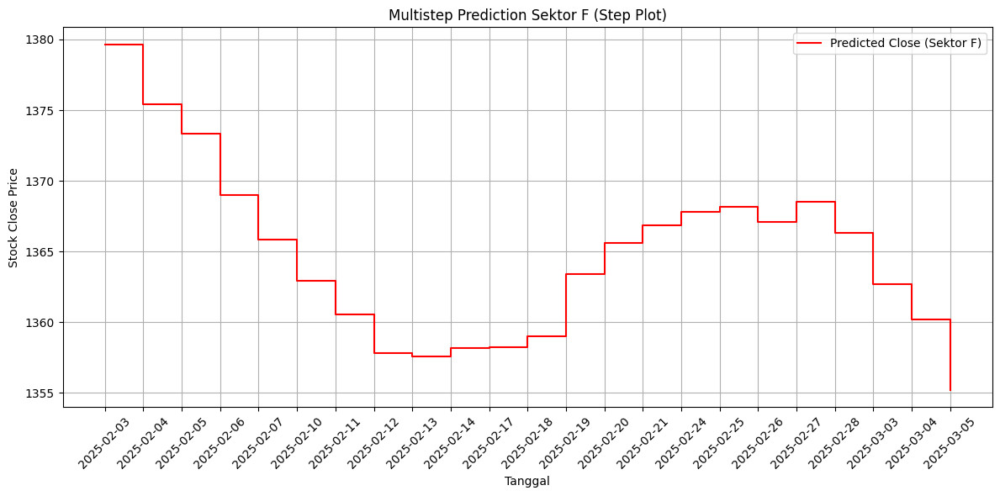

Head data prediksi Sektor F:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1379.648926      1340.464
1   2025-02-04     1375.430176      1353.266
2   2025-02-05     1373.341431      1337.978
3   2025-02-06     1368.994507      1353.134
4   2025-02-07     1365.841309      1353.114
5   2025-02-10     1362.912231      1356.040
6   2025-02-11     1360.531860      1336.965
7   2025-02-12     1357.823486      1366.806
8   2025-02-13     1357.550415      1380.525
9   2025-02-14     1358.169922      1372.470
10  2025-02-17     1358.260010      1380.690
11  2025-02-18     1359.010254      1399.220
12  2025-02-19     1363.420898      1389.374
13  2025-02-20     1365.627319      1373.668
14  2025-02-21     1366.837036      1375.719
15  2025-02-24     1367.816528      1377.770
16  2025-02-25     1368.186523      1363.206
17  2025-02-26     1367.110840      1369.086
18  2025-02-27     1368.537354      1337.693
19  2025-02-28     1366.297974      1320.260
20  2025-03-03     1362.71

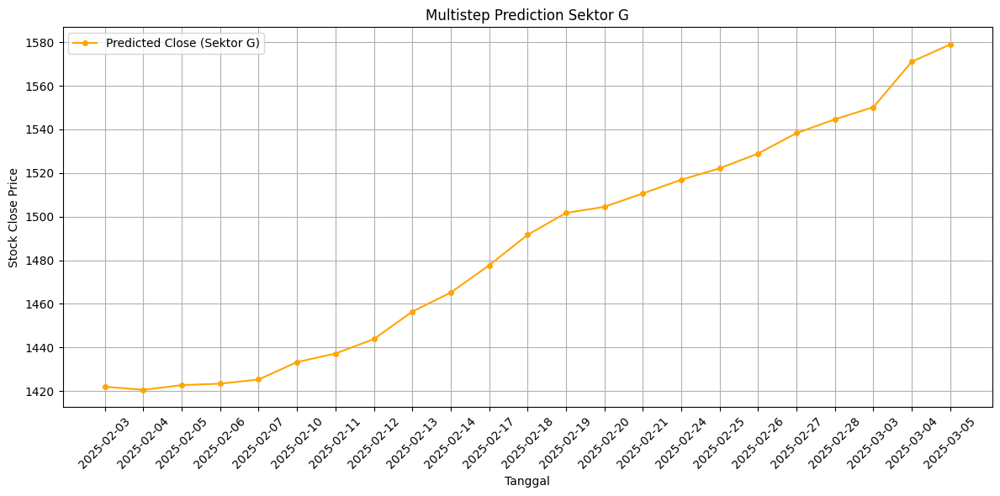

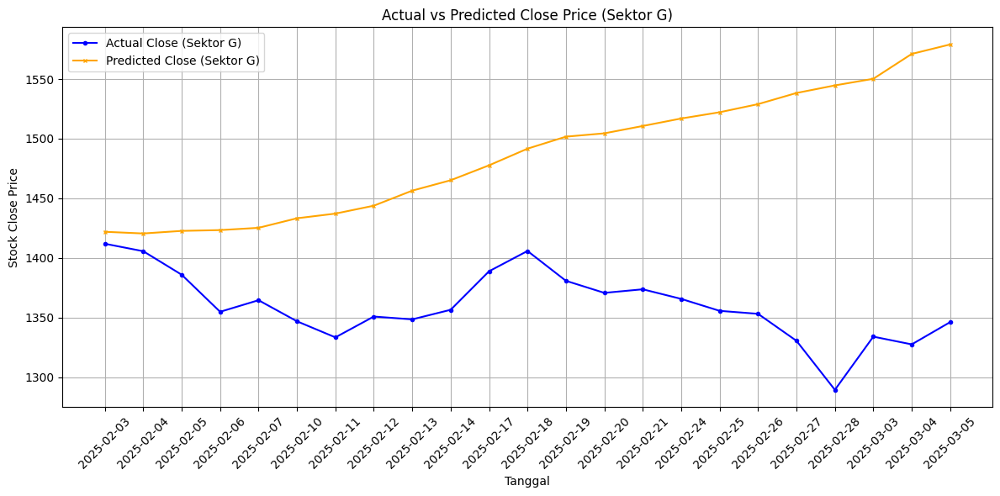

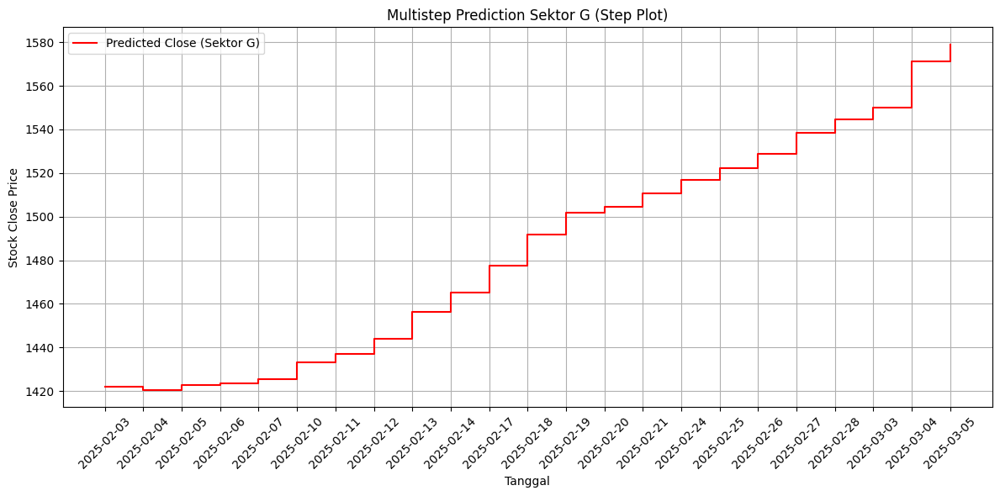

Head data prediksi Sektor G:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1421.982544      1411.965
1   2025-02-04     1420.567627      1405.702
2   2025-02-05     1422.735352      1385.990
3   2025-02-06     1423.401001      1354.928
4   2025-02-07     1425.305298      1364.633
5   2025-02-10     1433.307129      1346.979
6   2025-02-11     1437.218140      1333.492
7   2025-02-12     1443.849243      1350.947
8   2025-02-13     1456.460449      1348.573
9   2025-02-14     1465.170898      1356.603
10  2025-02-17     1477.696777      1388.900
11  2025-02-18     1491.644165      1405.896
12  2025-02-19     1501.709717      1380.898
13  2025-02-20     1504.498413      1370.790
14  2025-02-21     1510.658691      1373.788
15  2025-02-24     1516.933838      1365.745
16  2025-02-25     1522.168457      1355.722
17  2025-02-26     1528.963135      1353.224
18  2025-02-27     1538.308838      1330.618
19  2025-02-28     1544.663452      1289.518
20  2025-03-03     1550.21

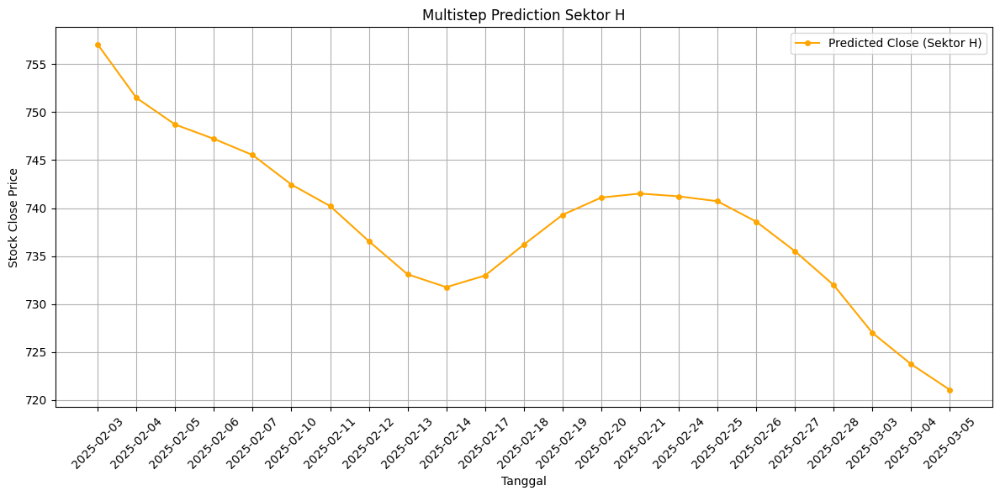

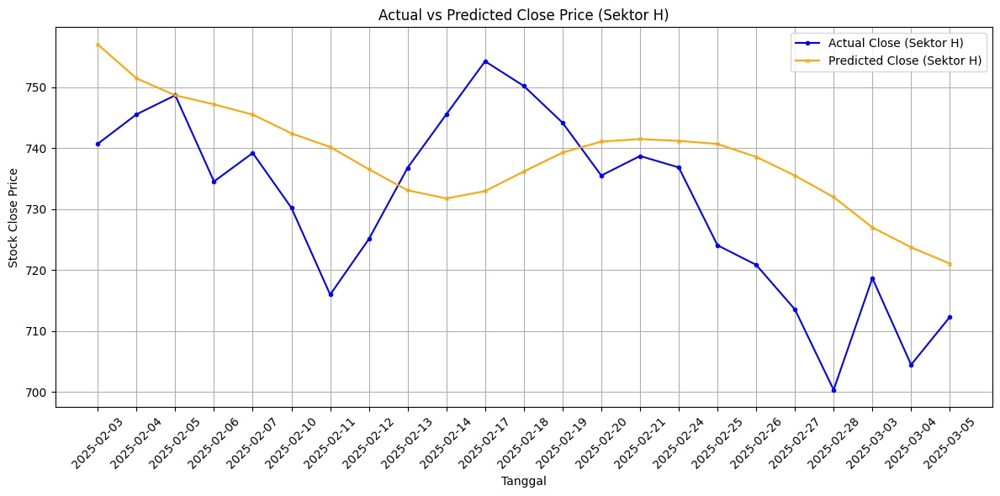

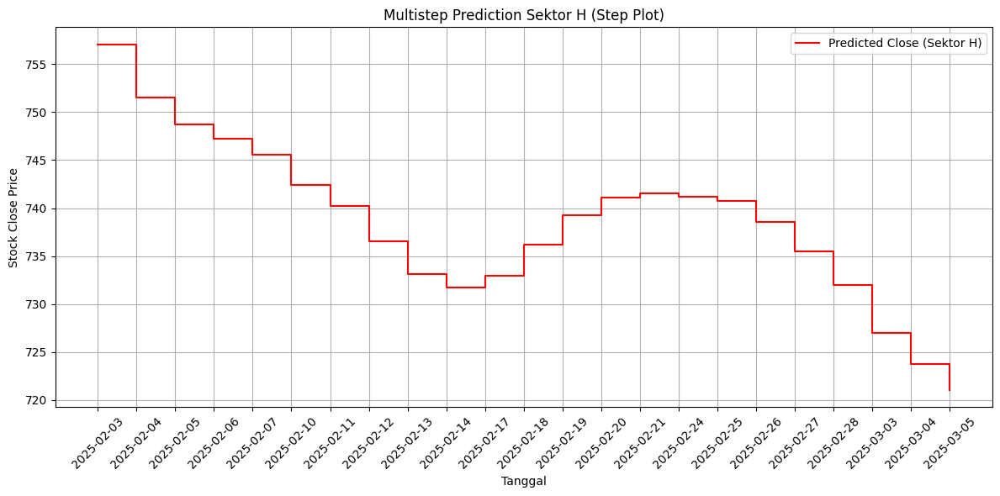

Head data prediksi Sektor H:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      757.040710       740.733
1   2025-02-04      751.475586       745.577
2   2025-02-05      748.698669       748.702
3   2025-02-06      747.211060       734.554
4   2025-02-07      745.523132       739.227
5   2025-02-10      742.452148       730.220
6   2025-02-11      740.209290       715.981
7   2025-02-12      736.554871       725.116
8   2025-02-13      733.102539       736.806
9   2025-02-14      731.765808       745.577
10  2025-02-17      732.972656       754.284
11  2025-02-18      736.189209       750.223
12  2025-02-19      739.294617       744.195
13  2025-02-20      741.093750       735.526
14  2025-02-21      741.512634       738.733
15  2025-02-24      741.223267       736.862
16  2025-02-25      740.714172       724.090
17  2025-02-26      738.593628       720.868
18  2025-02-27      735.513306       713.554
19  2025-02-28      731.985596       700.356
20  2025-03-03      727.01

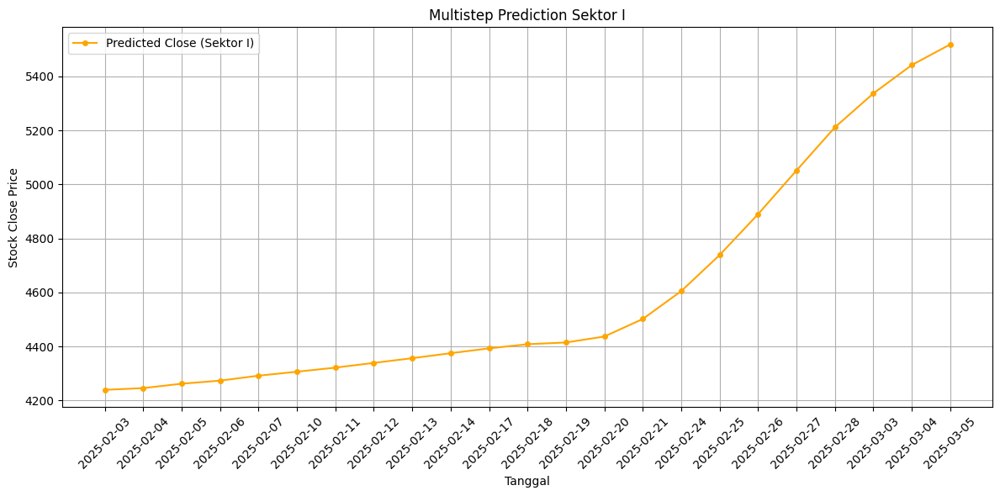

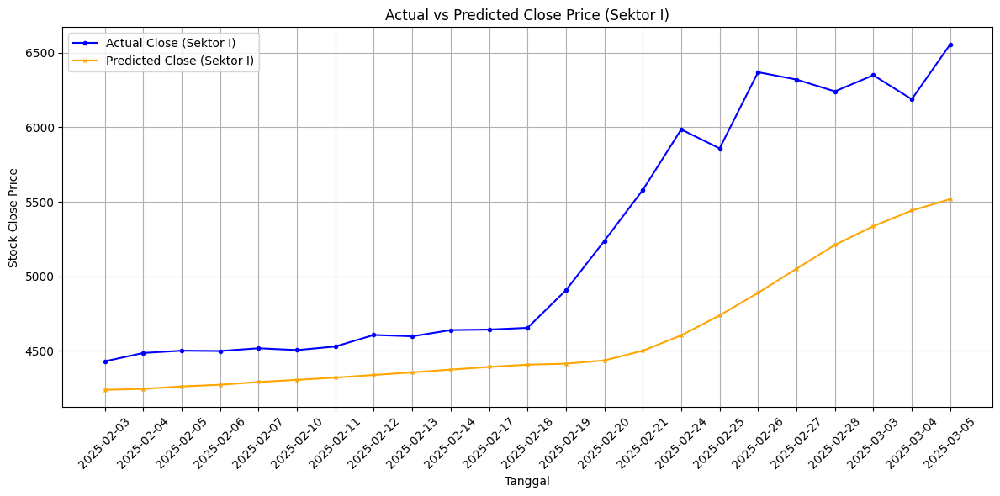

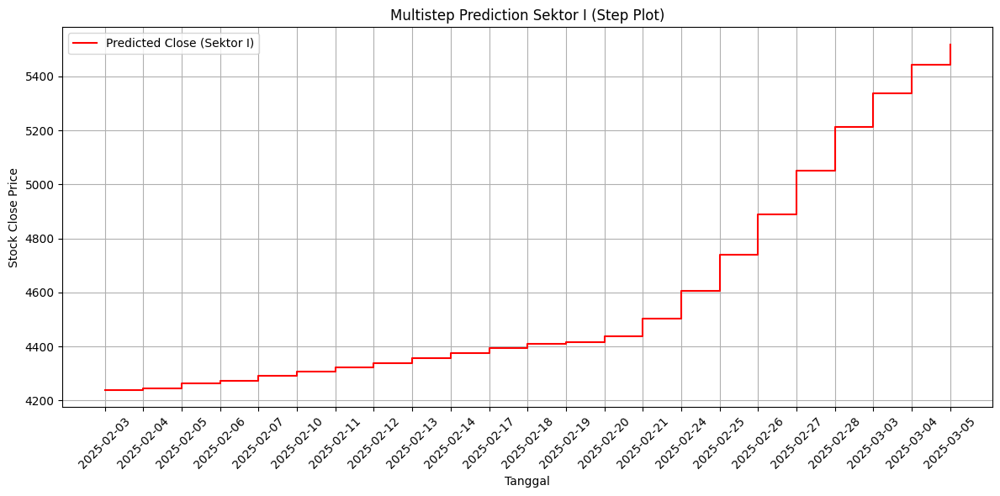

Head data prediksi Sektor I:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     4239.375000      4430.545
1   2025-02-04     4245.740234      4486.468
2   2025-02-05     4262.089844      4501.871
3   2025-02-06     4273.417969      4499.804
4   2025-02-07     4291.757812      4518.117
5   2025-02-10     4306.436035      4505.906
6   2025-02-11     4321.522461      4529.791
7   2025-02-12     4339.031738      4607.295
8   2025-02-13     4356.495605      4598.270
9   2025-02-14     4374.980957      4639.788
10  2025-02-17     4392.860352      4643.386
11  2025-02-18     4408.224609      4654.914
12  2025-02-19     4414.638184      4907.013
13  2025-02-20     4436.680176      5238.179
14  2025-02-21     4501.655273      5579.057
15  2025-02-24     4604.760742      5985.232
16  2025-02-25     4738.364258      5858.077
17  2025-02-26     4889.490234      6369.119
18  2025-02-27     5051.247559      6319.917
19  2025-02-28     5211.079102      6240.565
20  2025-03-03     5336.38

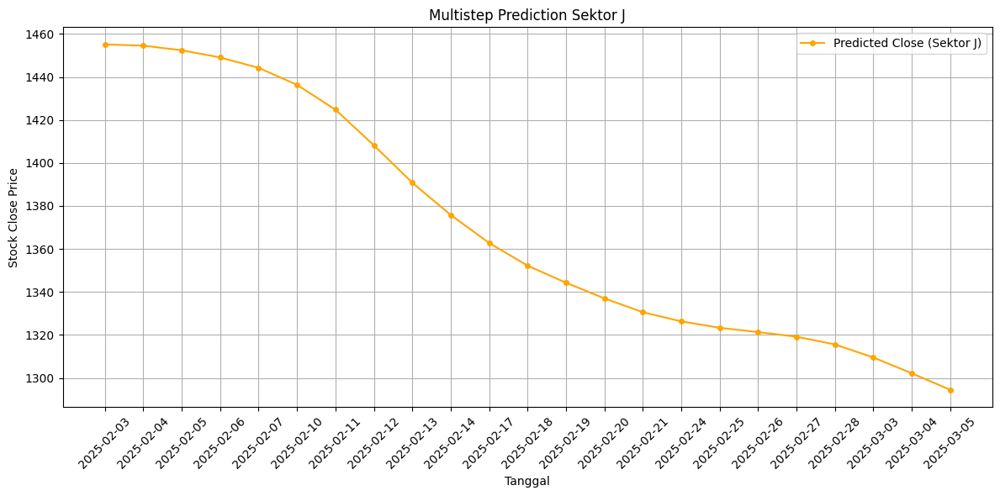

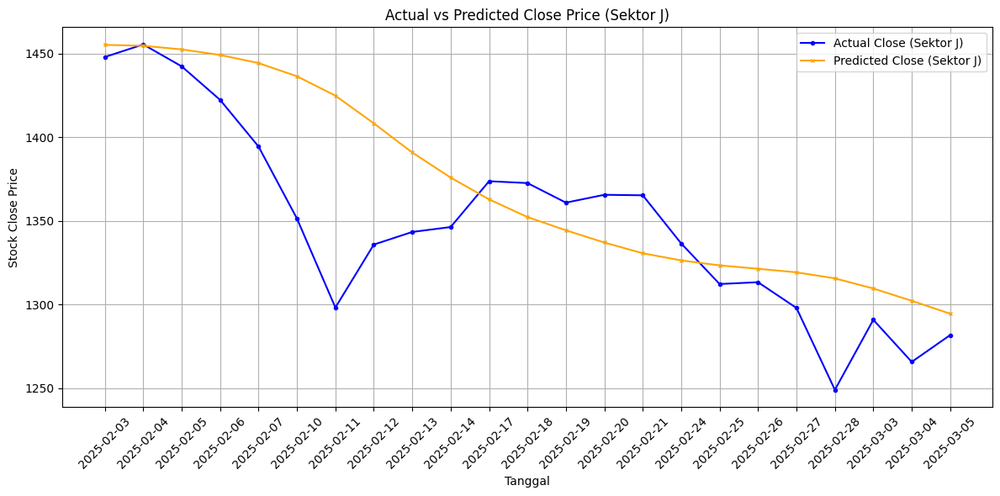

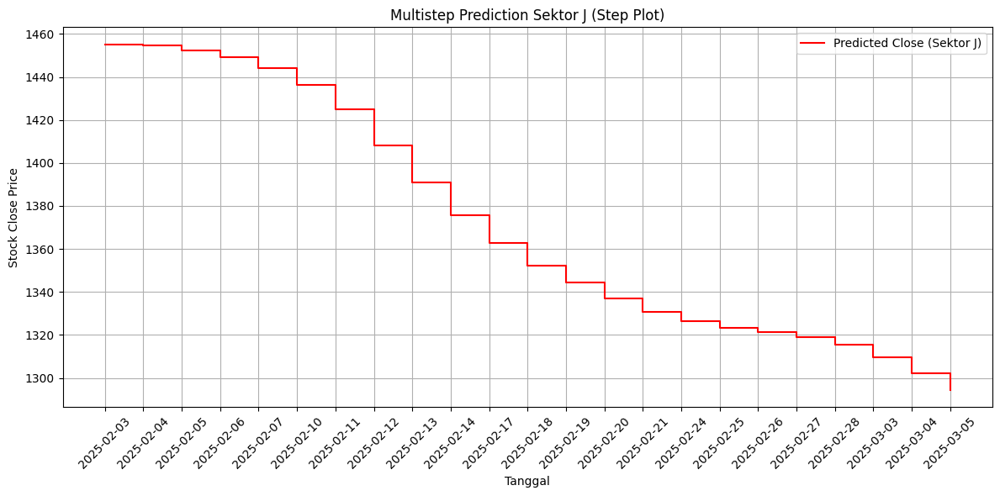

Head data prediksi Sektor J:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1455.120728      1447.861
1   2025-02-04     1454.558838      1455.366
2   2025-02-05     1452.410278      1442.265
3   2025-02-06     1449.075562      1422.231
4   2025-02-07     1444.239624      1394.348
5   2025-02-10     1436.335449      1351.312
6   2025-02-11     1424.765991      1298.132
7   2025-02-12     1408.217407      1335.760
8   2025-02-13     1390.804443      1343.301
9   2025-02-14     1375.796509      1346.242
10  2025-02-17     1362.774048      1373.634
11  2025-02-18     1352.213501      1372.521
12  2025-02-19     1344.284790      1360.822
13  2025-02-20     1336.984375      1365.518
14  2025-02-21     1330.566040      1365.212
15  2025-02-24     1326.290161      1336.422
16  2025-02-25     1323.327759      1312.190
17  2025-02-26     1321.302002      1313.262
18  2025-02-27     1319.172119      1297.882
19  2025-02-28     1315.578003      1248.948
20  2025-03-03     1309.50

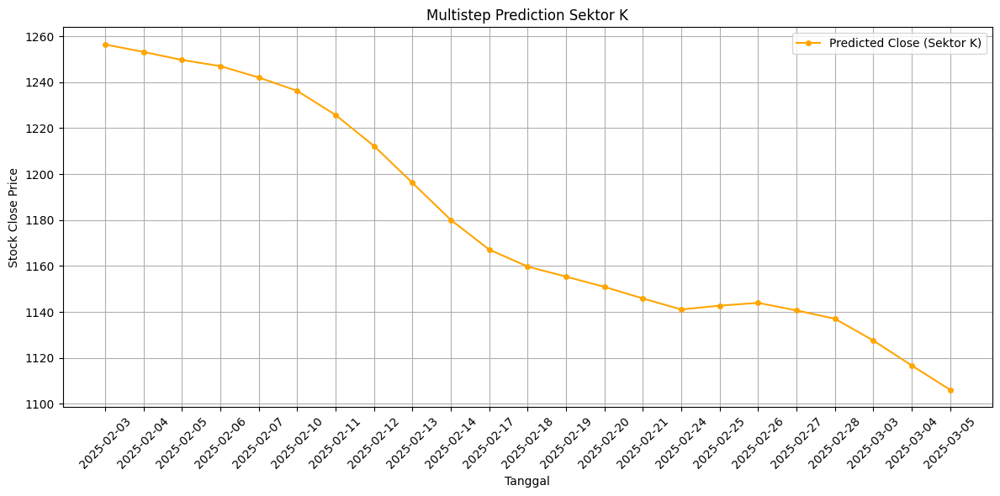

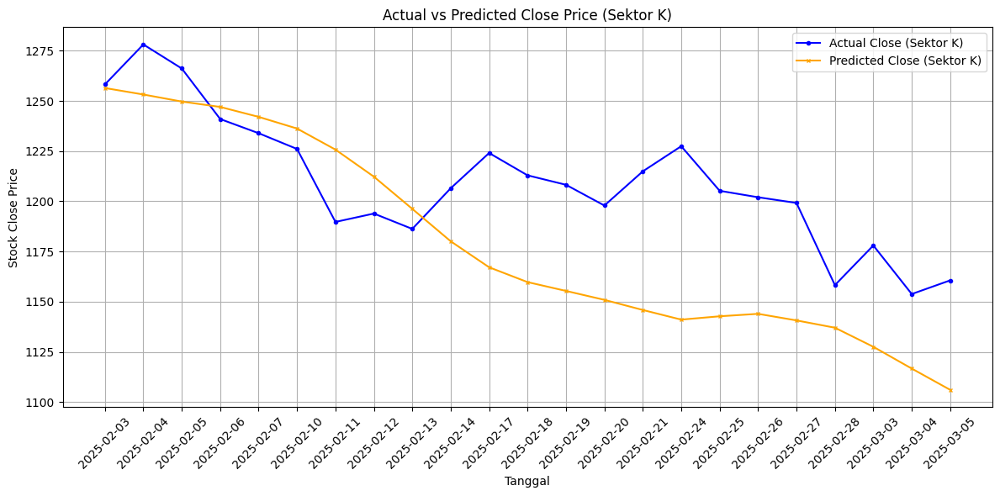

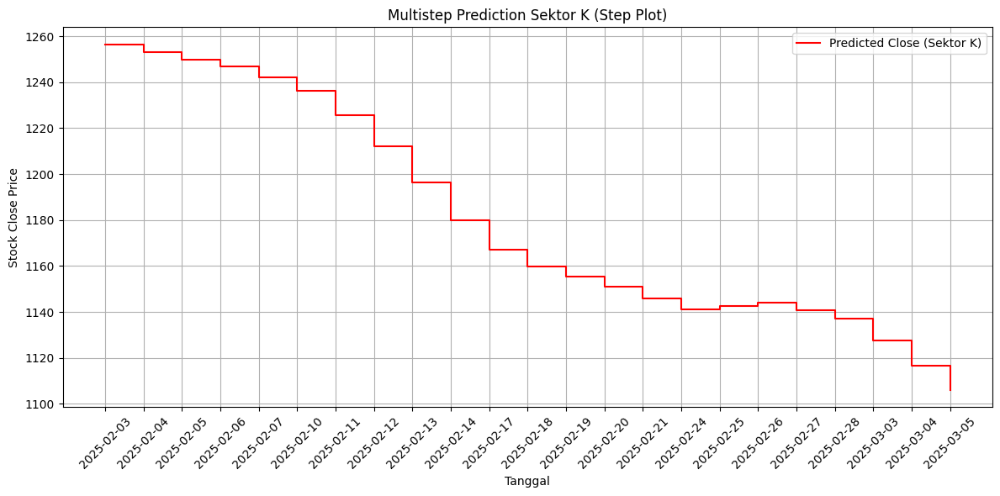

Head data prediksi Sektor K:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1256.442627      1258.244
1   2025-02-04     1253.207275      1278.147
2   2025-02-05     1249.698608      1266.166
3   2025-02-06     1247.020752      1240.981
4   2025-02-07     1242.072266      1233.936
5   2025-02-10     1236.255493      1226.077
6   2025-02-11     1225.757080      1189.726
7   2025-02-12     1212.275635      1193.900
8   2025-02-13     1196.232910      1186.247
9   2025-02-14     1180.081177      1206.508
10  2025-02-17     1167.130859      1224.061
11  2025-02-18     1159.750488      1212.942
12  2025-02-19     1155.360962      1208.235
13  2025-02-20     1150.906494      1197.896
14  2025-02-21     1145.860352      1214.936
15  2025-02-24     1141.061401      1227.452
16  2025-02-25     1142.721436      1205.242
17  2025-02-26     1143.945190      1202.027
18  2025-02-27     1140.666138      1199.188
19  2025-02-28     1137.029785      1158.248
20  2025-03-03     1127.52

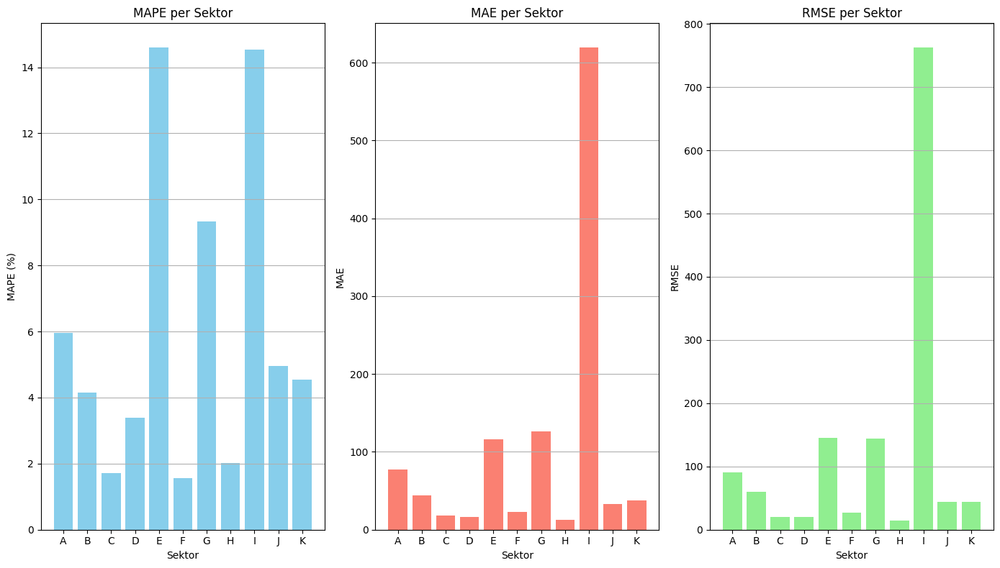

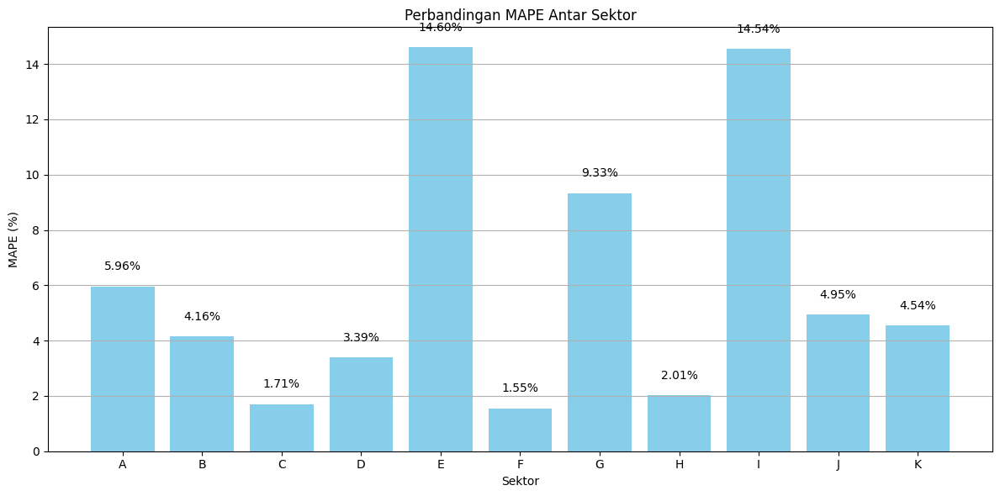

In [12]:
# BIDIRECT

import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_bi.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()


PROCESSING SEKTOR A


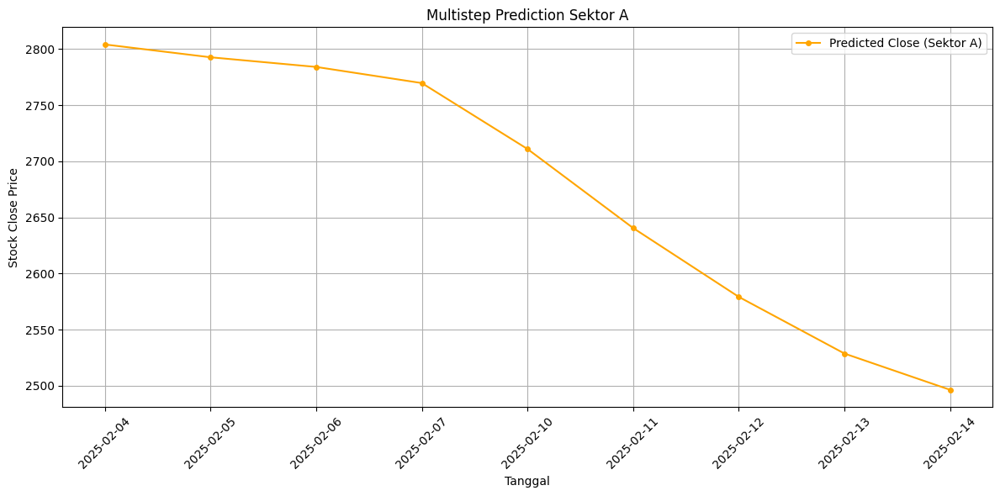

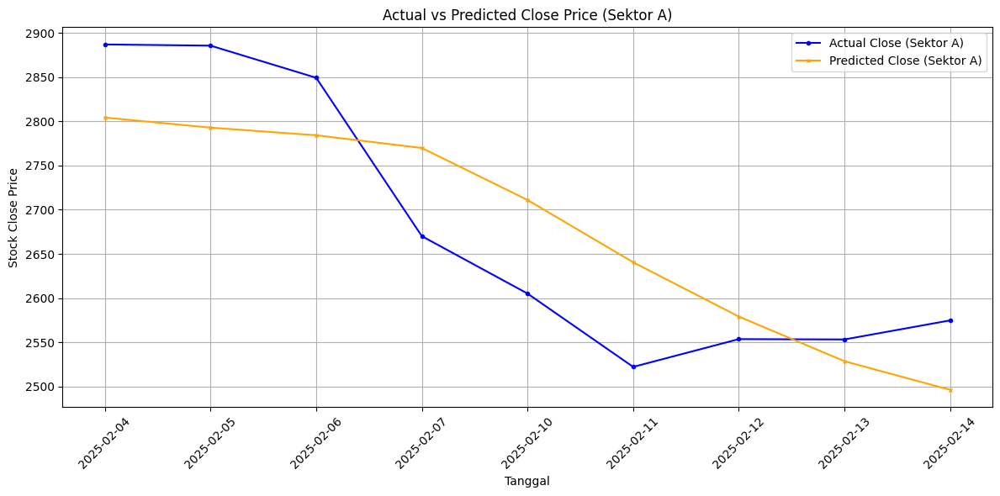

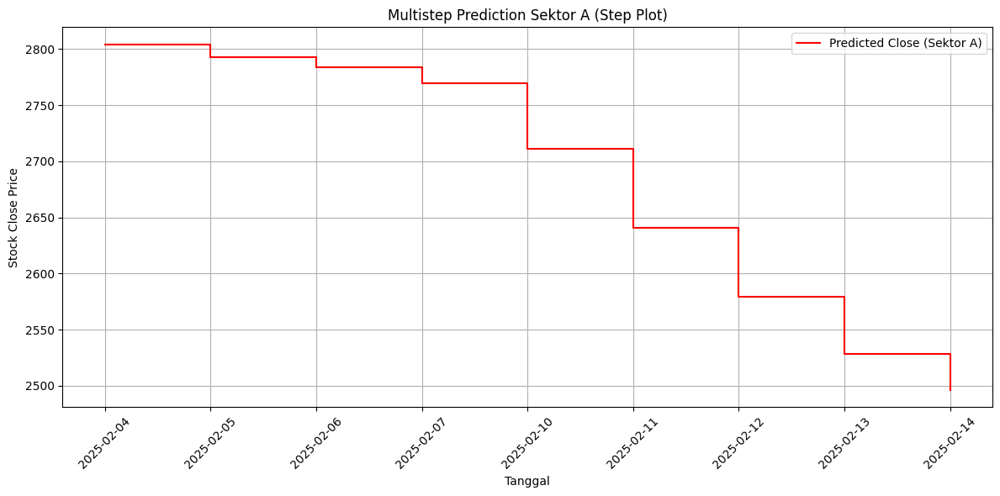

Head data prediksi Sektor A:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     2804.205078      2886.815
1  2025-02-05     2792.777100      2885.488
2  2025-02-06     2784.170410      2849.183
3  2025-02-07     2769.784912      2670.111
4  2025-02-10     2711.030762      2605.239
5  2025-02-11     2640.585693      2522.332
6  2025-02-12     2579.223877      2553.726
7  2025-02-13     2528.729004      2553.363
8  2025-02-14     2496.396973      2574.895
Evaluasi Model Sektor A:
MAE: 76.96
RMSE: 83.12
MAPE: 5.74%

PROCESSING SEKTOR B


<ipython-input-21-a49c26744ec0>:128: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


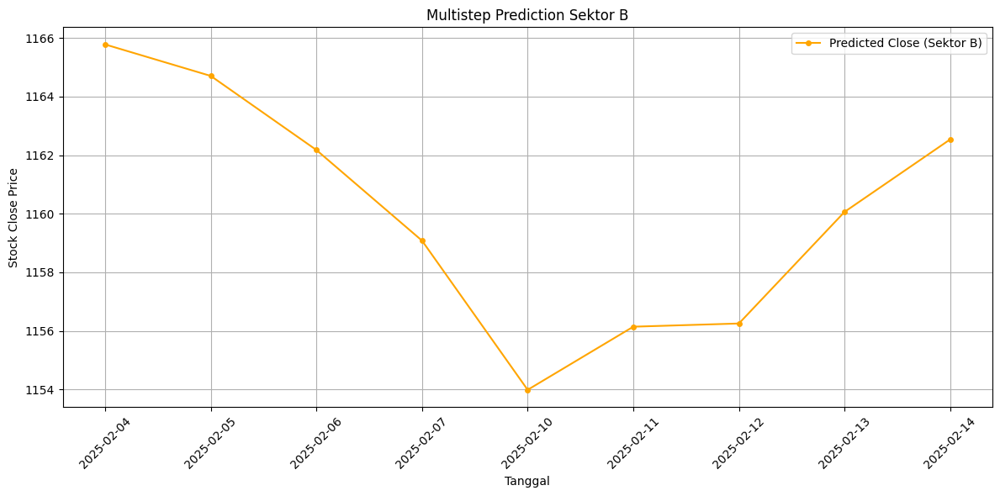

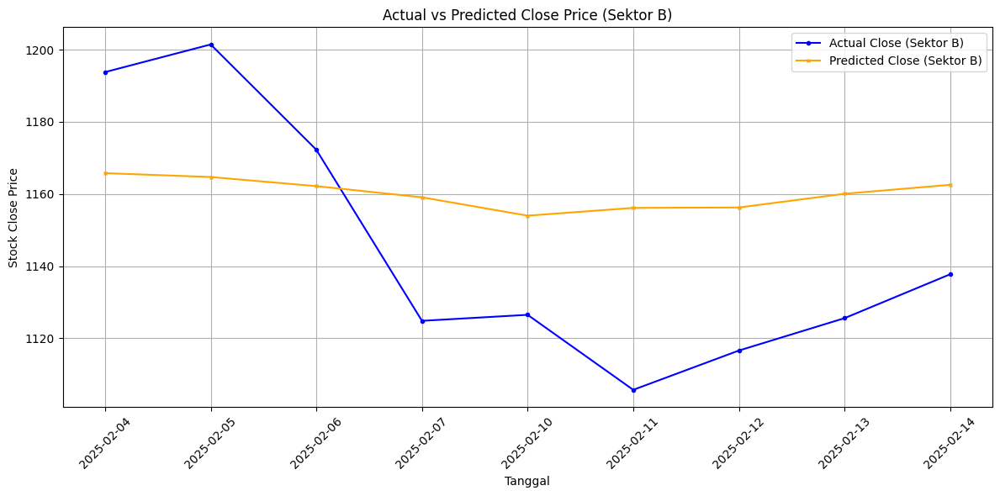

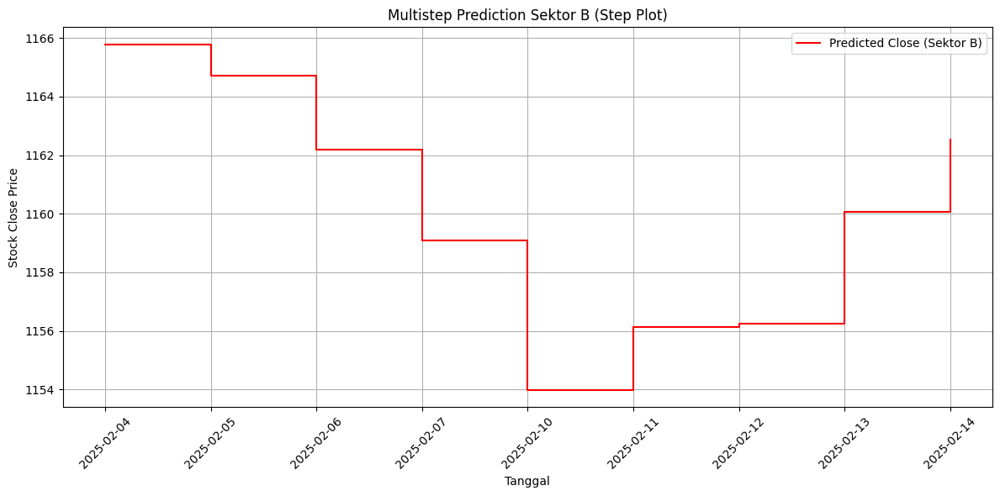

Head data prediksi Sektor B:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1165.783081      1193.817
1  2025-02-05     1164.708008      1201.485
2  2025-02-06     1162.178223      1172.273
3  2025-02-07     1159.081421      1124.812
4  2025-02-10     1153.985962      1126.481
5  2025-02-11     1156.142334      1105.669
6  2025-02-12     1156.251953      1116.570
7  2025-02-13     1160.064087      1125.552
8  2025-02-14     1162.539917      1137.731
Evaluasi Model Sektor B:
MAE: 31.80
RMSE: 33.50
MAPE: 3.03%

PROCESSING SEKTOR C


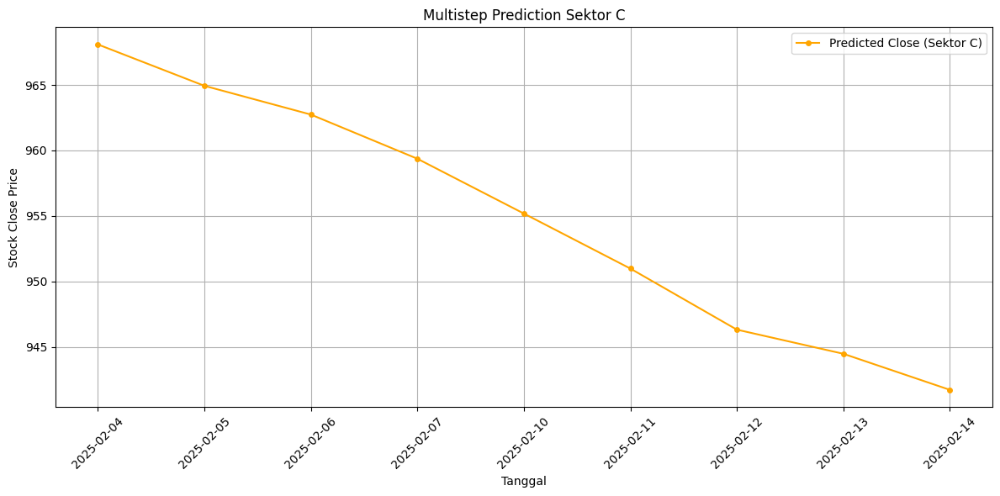

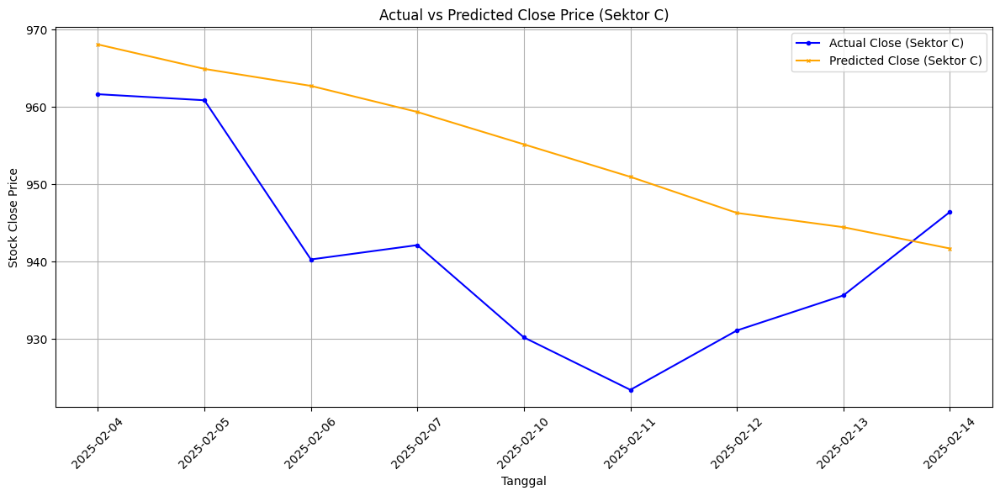

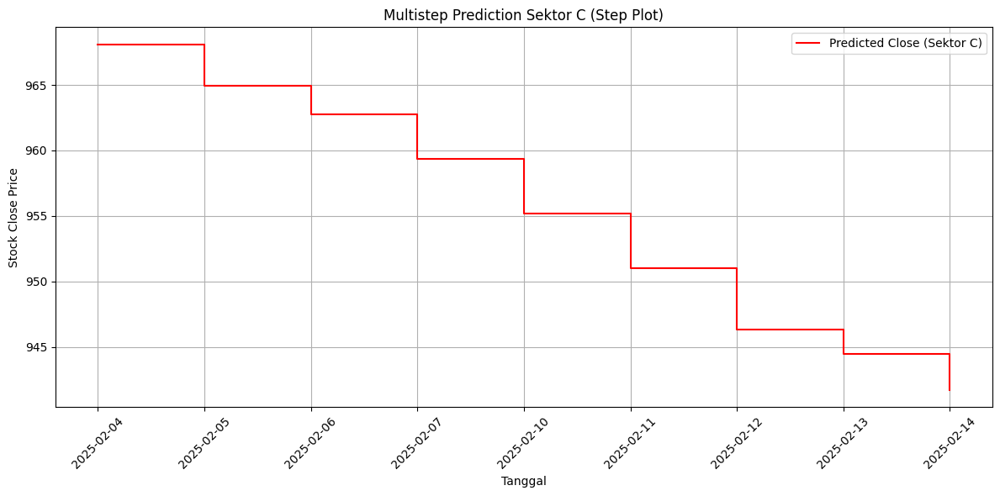

Head data prediksi Sektor C:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      968.096191       961.663
1  2025-02-05      964.936829       960.880
2  2025-02-06      962.740234       940.296
3  2025-02-07      959.367188       942.151
4  2025-02-10      955.181030       930.218
5  2025-02-11      950.978821       923.437
6  2025-02-12      946.313293       931.112
7  2025-02-13      944.469849       935.644
8  2025-02-14      941.716003       946.430
Evaluasi Model Sektor C:
MAE: 14.60
RMSE: 16.90
MAPE: 1.83%

PROCESSING SEKTOR D


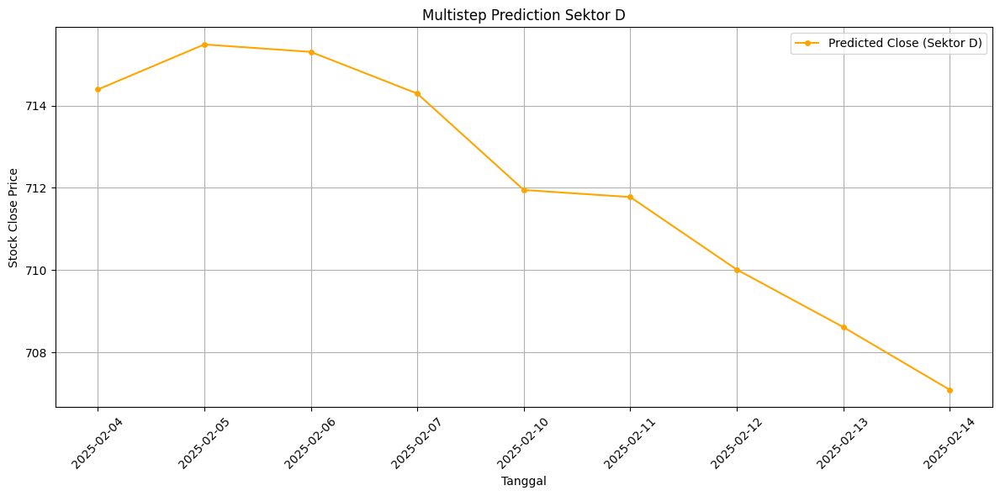

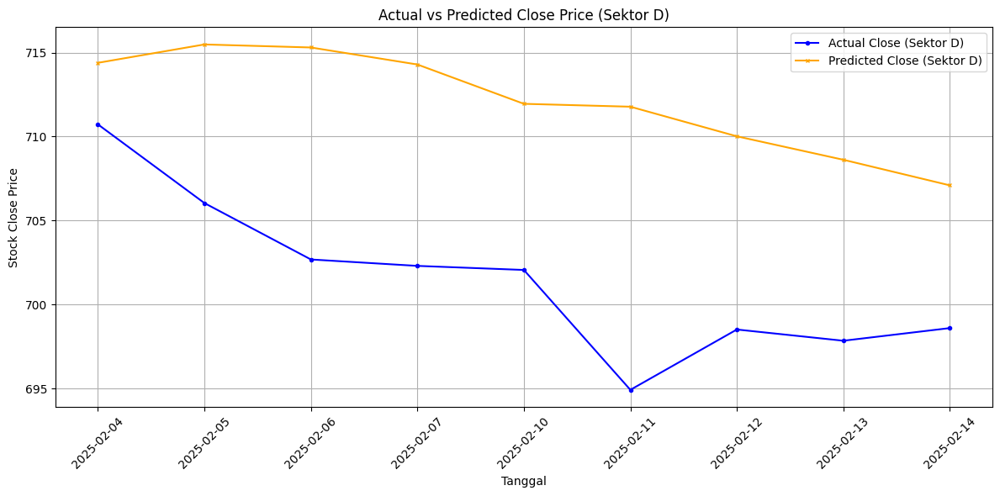

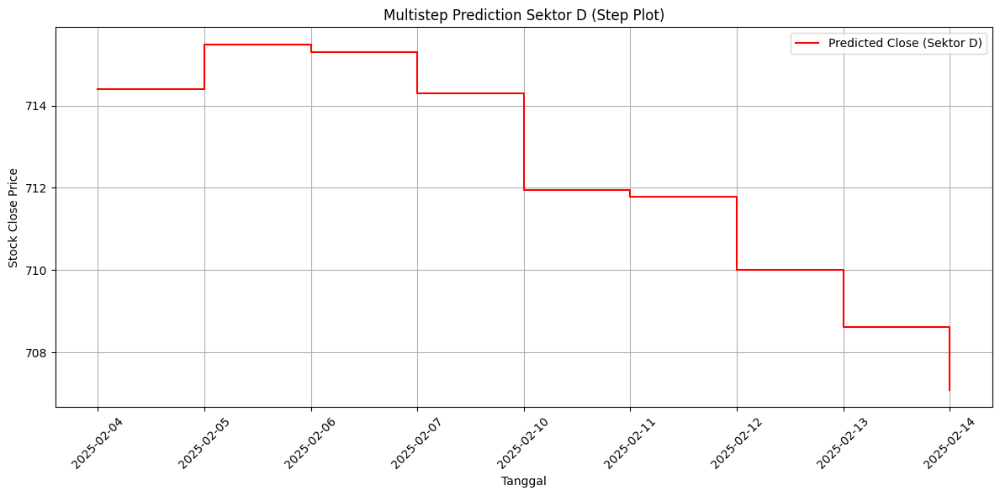

Head data prediksi Sektor D:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      714.388855       710.725
1  2025-02-05      715.482971       706.041
2  2025-02-06      715.302795       702.683
3  2025-02-07      714.289612       702.301
4  2025-02-10      711.948914       702.059
5  2025-02-11      711.777222       694.922
6  2025-02-12      710.014709       698.513
7  2025-02-13      708.618164       697.845
8  2025-02-14      707.095215       698.598
Evaluasi Model Sektor D:
MAE: 10.58
RMSE: 11.10
MAPE: 1.53%

PROCESSING SEKTOR E


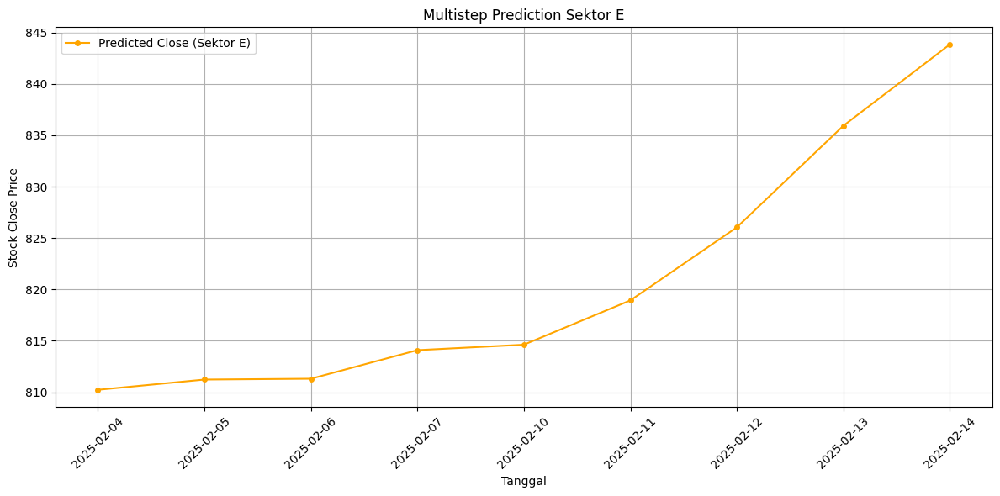

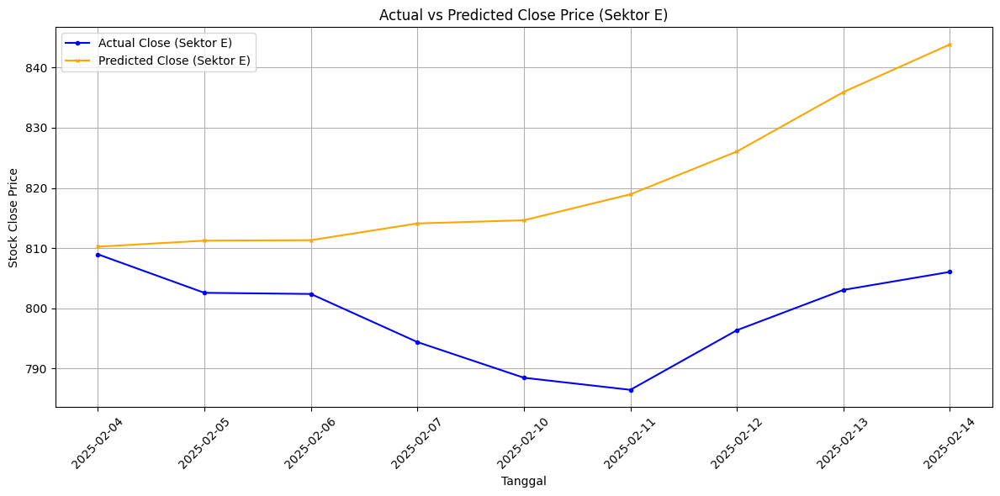

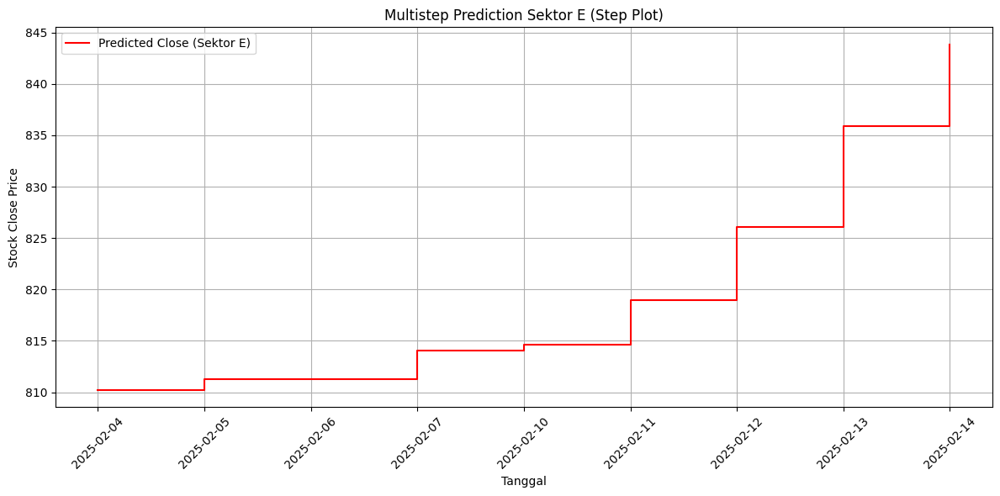

Head data prediksi Sektor E:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      810.238525       808.971
1  2025-02-05      811.237915       802.576
2  2025-02-06      811.318420       802.384
3  2025-02-07      814.096497       794.398
4  2025-02-10      814.628296       788.472
5  2025-02-11      818.937866       786.462
6  2025-02-12      826.045166       796.363
7  2025-02-13      835.919434       803.057
8  2025-02-14      843.827271       806.050
Evaluasi Model Sektor E:
MAE: 21.95
RMSE: 25.10
MAPE: 2.76%

PROCESSING SEKTOR F


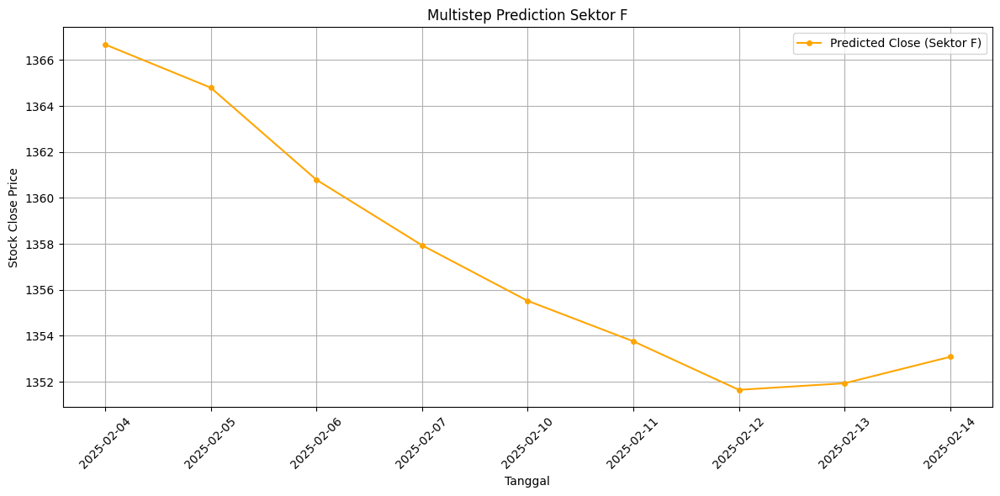

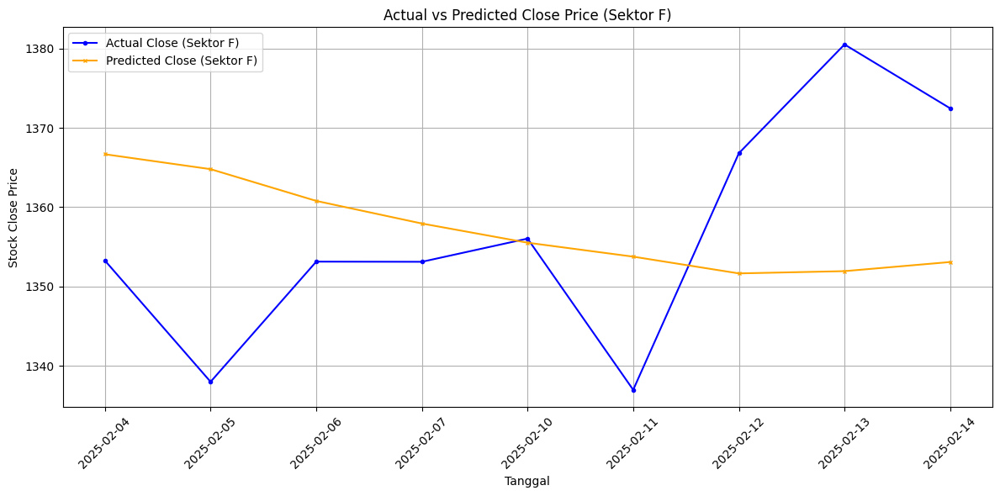

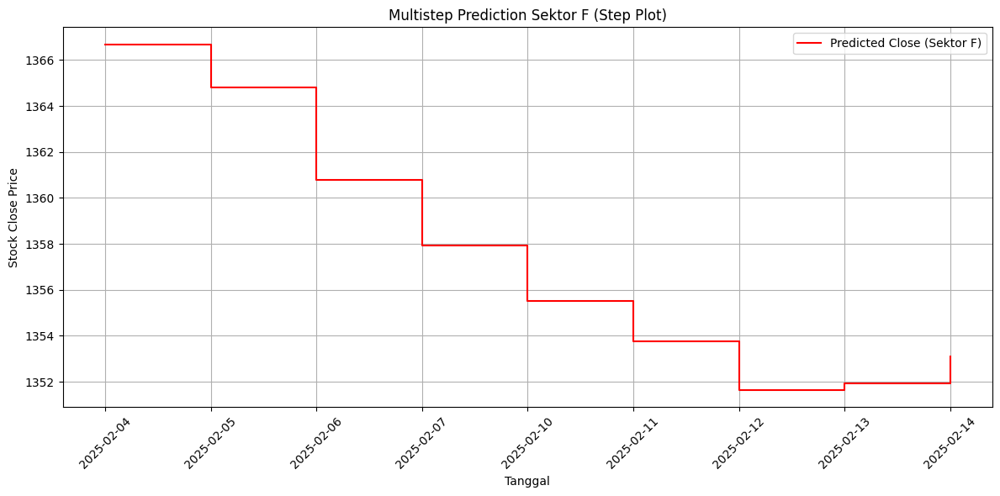

Head data prediksi Sektor F:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1366.677368      1353.266
1  2025-02-05     1364.797485      1337.978
2  2025-02-06     1360.791992      1353.134
3  2025-02-07     1357.940186      1353.114
4  2025-02-10     1355.522583      1356.040
5  2025-02-11     1353.762207      1336.965
6  2025-02-12     1351.649048      1366.806
7  2025-02-13     1351.934448      1380.525
8  2025-02-14     1353.084961      1372.470
Evaluasi Model Sektor F:
MAE: 14.80
RMSE: 17.28
MAPE: 0.87%

PROCESSING SEKTOR G


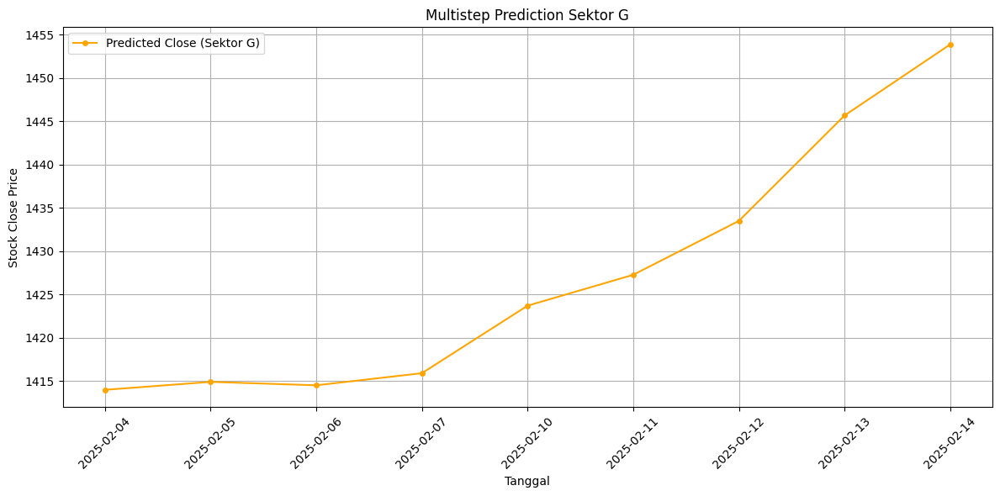

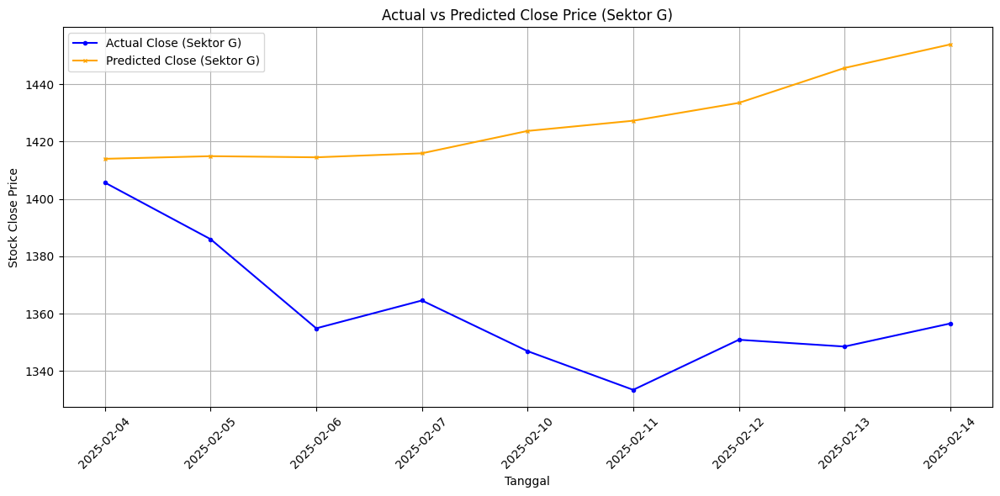

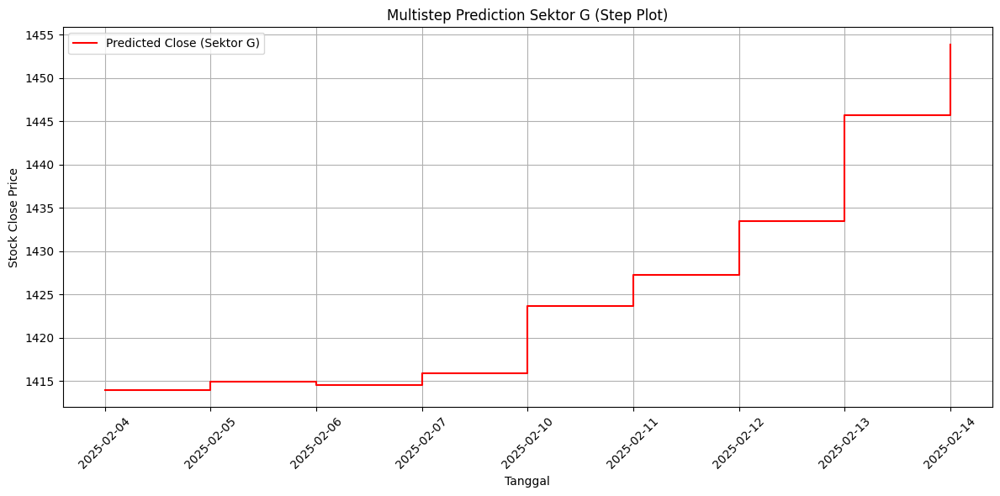

Head data prediksi Sektor G:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1414.001709      1405.702
1  2025-02-05     1414.919434      1385.990
2  2025-02-06     1414.526367      1354.928
3  2025-02-07     1415.922363      1364.633
4  2025-02-10     1423.710327      1346.979
5  2025-02-11     1427.273315      1333.492
6  2025-02-12     1433.491455      1350.947
7  2025-02-13     1445.652954      1348.573
8  2025-02-14     1453.854370      1356.603
Evaluasi Model Sektor G:
MAE: 66.17
RMSE: 72.62
MAPE: 4.89%

PROCESSING SEKTOR H


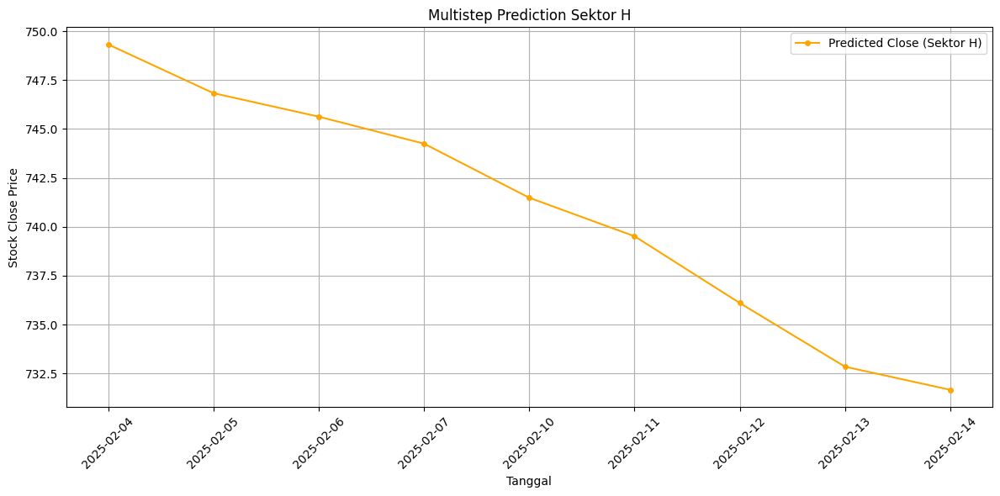

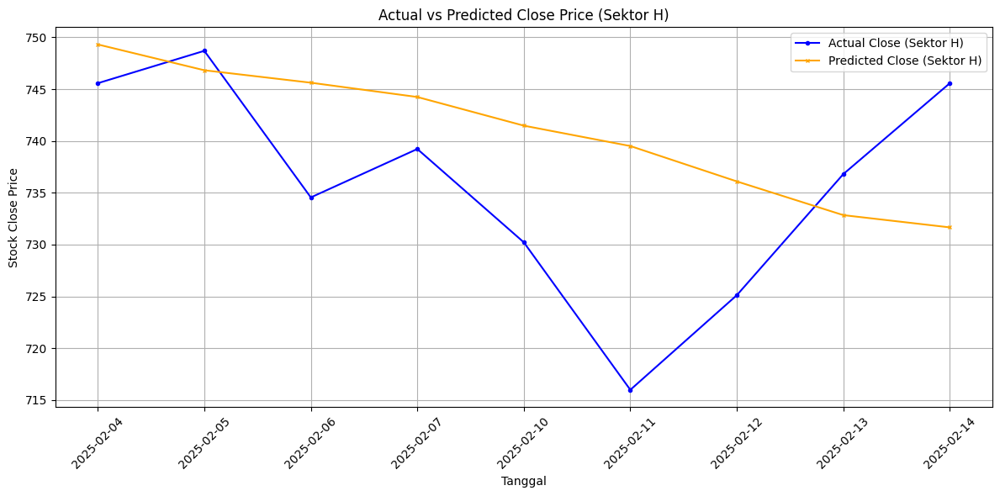

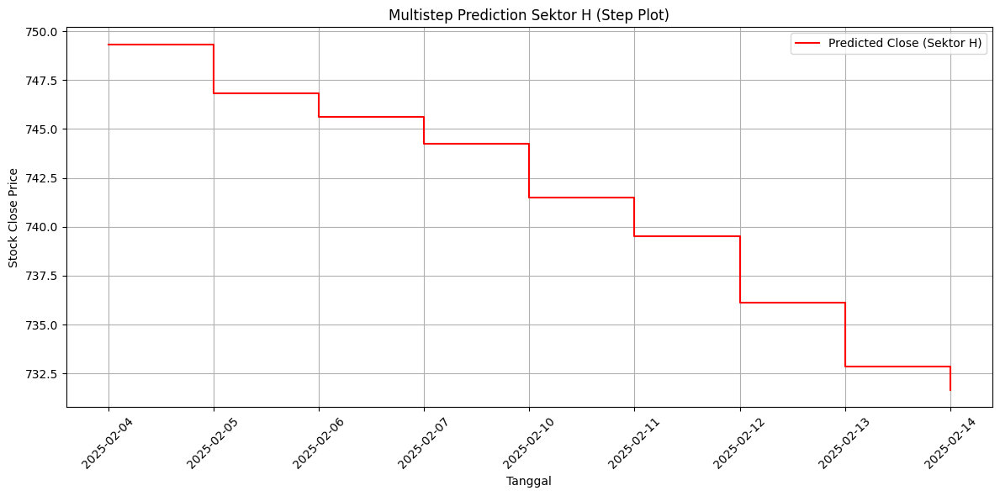

Head data prediksi Sektor H:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      749.317993       745.577
1  2025-02-05      746.827698       748.702
2  2025-02-06      745.626282       734.554
3  2025-02-07      744.246338       739.227
4  2025-02-10      741.480042       730.220
5  2025-02-11      739.512939       715.981
6  2025-02-12      736.098267       725.116
7  2025-02-13      732.843689       736.806
8  2025-02-14      731.661377       745.577
Evaluasi Model Sektor H:
MAE: 9.48
RMSE: 11.43
MAPE: 1.37%

PROCESSING SEKTOR I


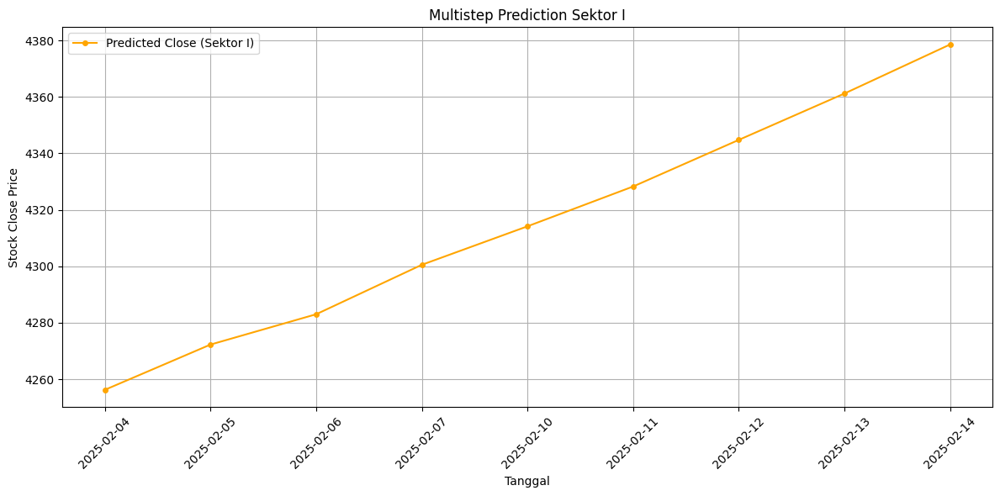

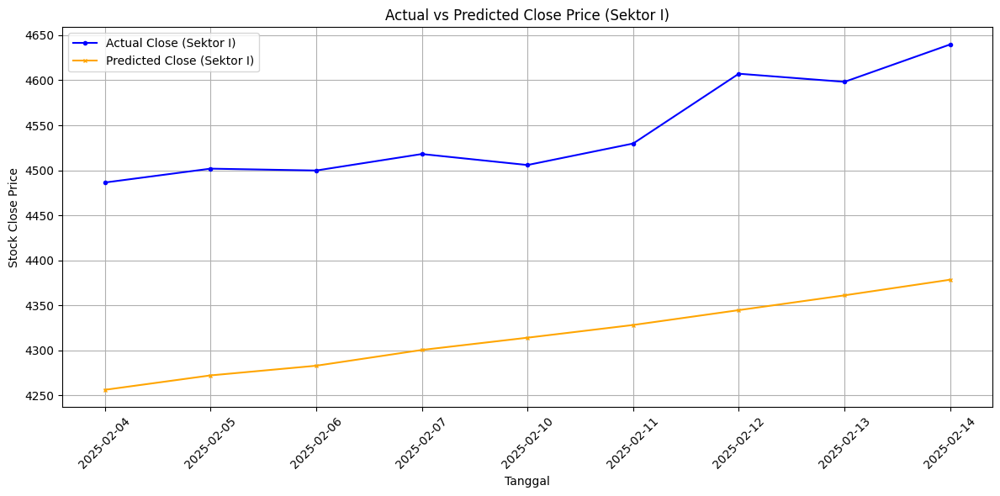

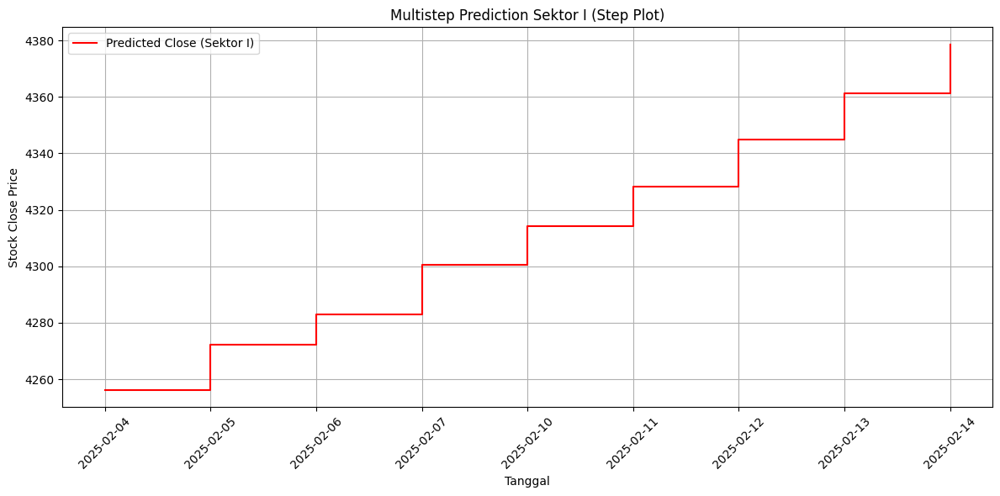

Head data prediksi Sektor I:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     4256.262207      4486.468
1  2025-02-05     4272.290527      4501.871
2  2025-02-06     4283.027344      4499.804
3  2025-02-07     4300.537598      4518.117
4  2025-02-10     4314.165527      4505.906
5  2025-02-11     4328.266602      4529.791
6  2025-02-12     4344.770996      4607.295
7  2025-02-13     4361.193848      4598.270
8  2025-02-14     4378.558594      4639.788
Evaluasi Model Sektor I:
MAE: 227.58
RMSE: 228.71
MAPE: 5.00%

PROCESSING SEKTOR J


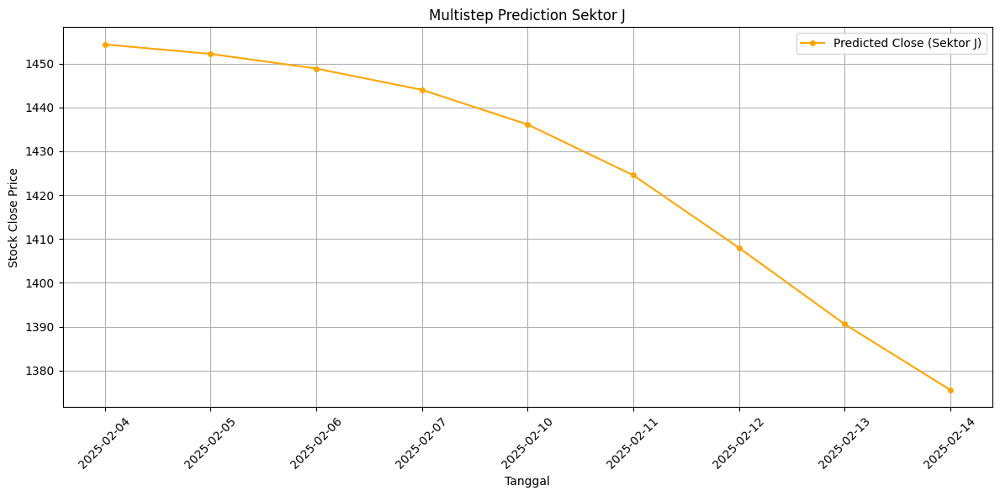

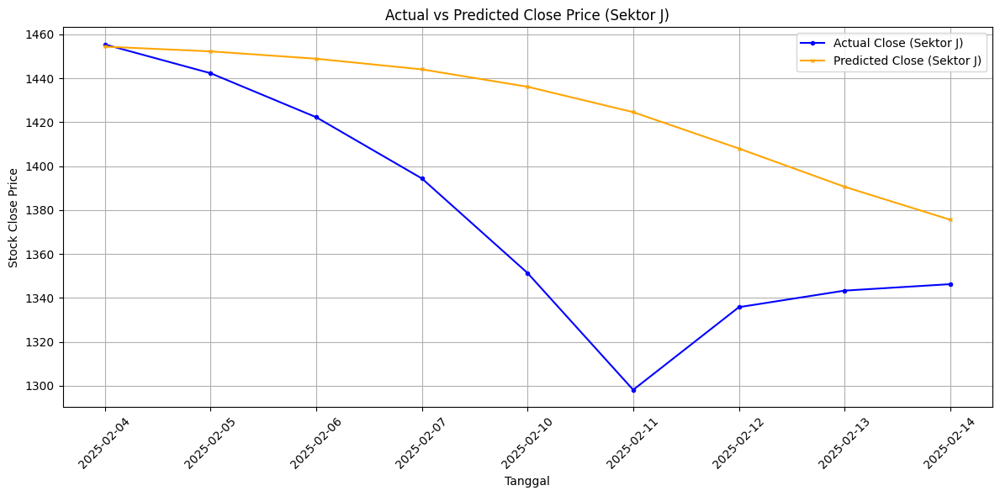

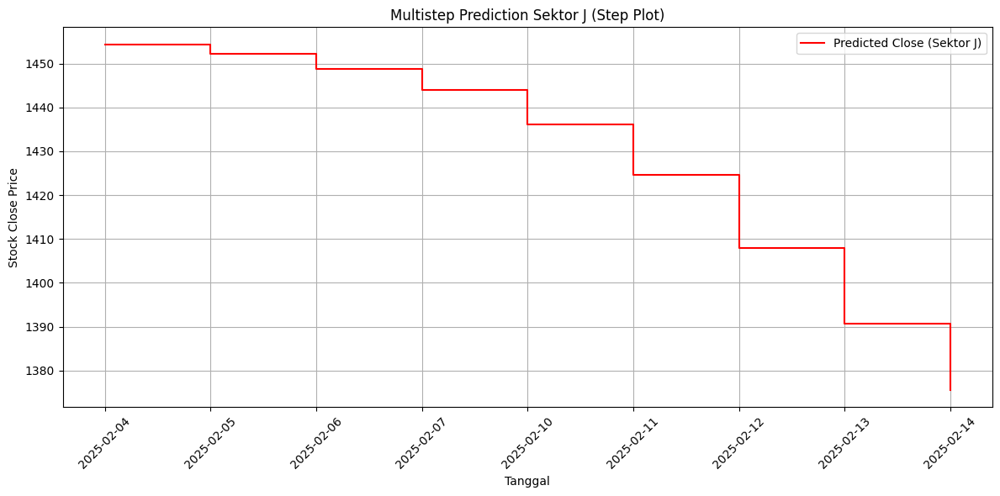

Head data prediksi Sektor J:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1454.374878      1455.366
1  2025-02-05     1452.218384      1442.265
2  2025-02-06     1448.873901      1422.231
3  2025-02-07     1444.029541      1394.348
4  2025-02-10     1436.118286      1351.312
5  2025-02-11     1424.543945      1298.132
6  2025-02-12     1407.992920      1335.760
7  2025-02-13     1390.580811      1343.301
8  2025-02-14     1375.577637      1346.242
Evaluasi Model Sektor J:
MAE: 49.70
RMSE: 62.15
MAPE: 4.69%

PROCESSING SEKTOR K


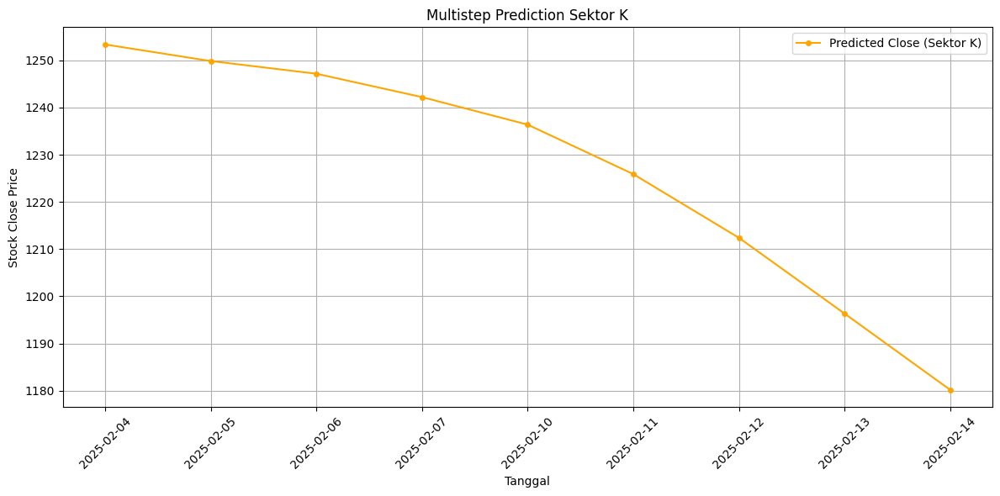

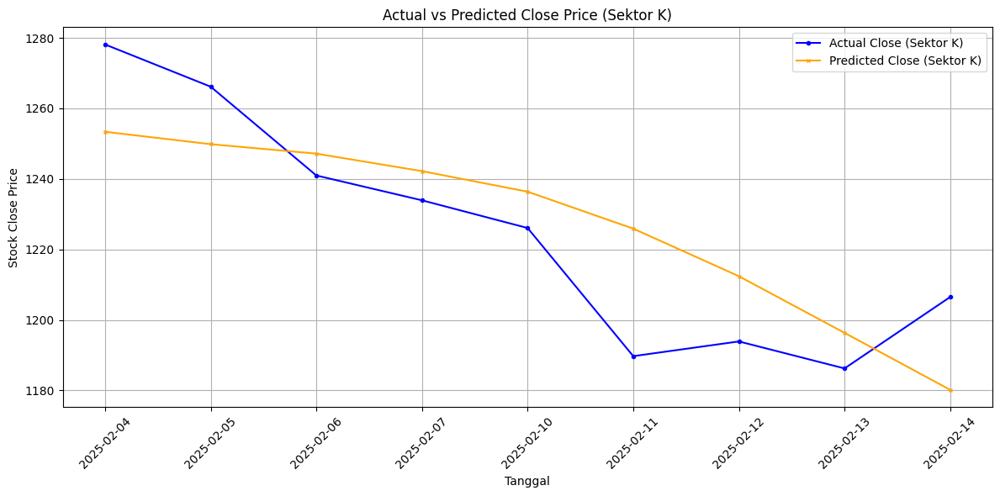

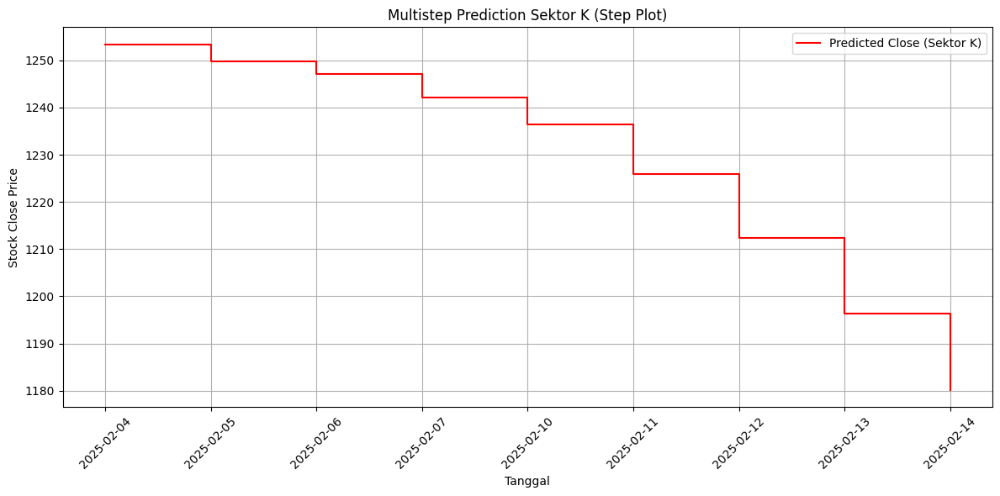

Head data prediksi Sektor K:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1253.373901      1278.147
1  2025-02-05     1249.858643      1266.166
2  2025-02-06     1247.173218      1240.981
3  2025-02-07     1242.215088      1233.936
4  2025-02-10     1236.383423      1226.077
5  2025-02-11     1225.898560      1189.726
6  2025-02-12     1212.400024      1193.900
7  2025-02-13     1196.340332      1186.247
8  2025-02-14     1180.172852      1206.508
Evaluasi Model Sektor K:
MAE: 17.44
RMSE: 19.83
MAPE: 2.70%

Hasil Evaluasi Semua Sektor:
   Sektor         MAE        RMSE      MAPE
0       A   76.964742   83.117042  5.741381
1       B   31.795151   33.499668  3.031186
2       C   14.599604   16.901302  1.833869
3       D   10.581273   11.095658  1.534887
4       E   21.946266   25.102936  2.756302
5       F   14.795800   17.276937  0.871303
6       G   66.167255   72.623020  4.886312
7       H    9.484344   11.429944  1.367451
8       I  227.581862  228.710410  4.996541
9

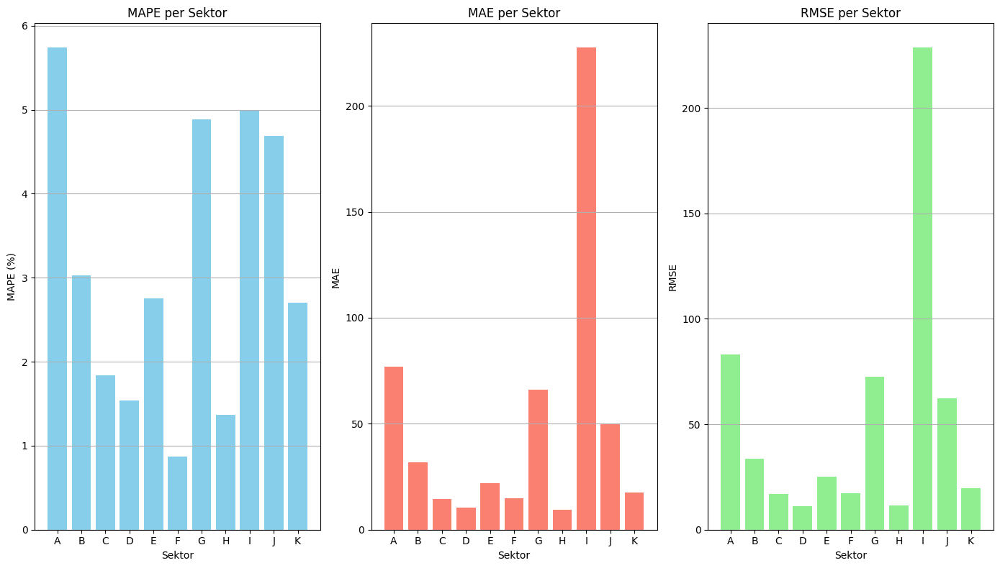

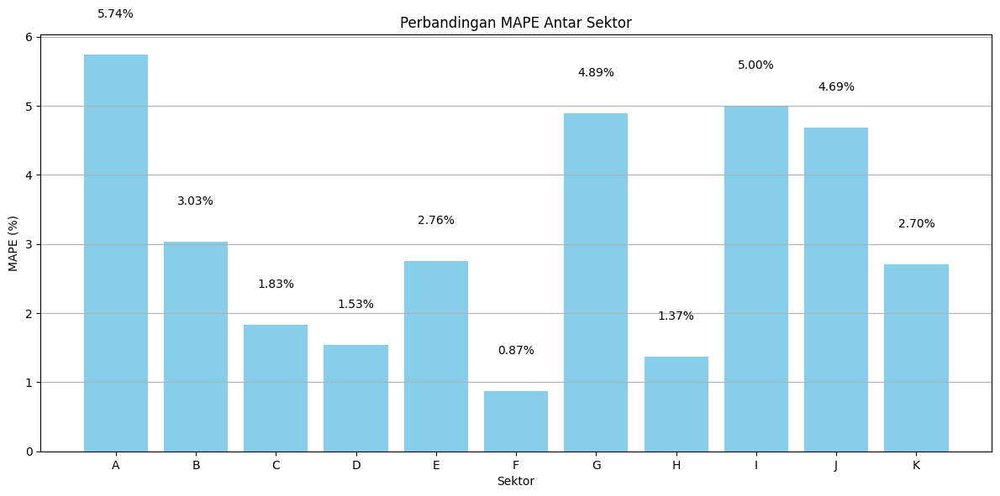

In [21]:
# BIDIRECT

import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_bi.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()


PROCESSING SEKTOR A


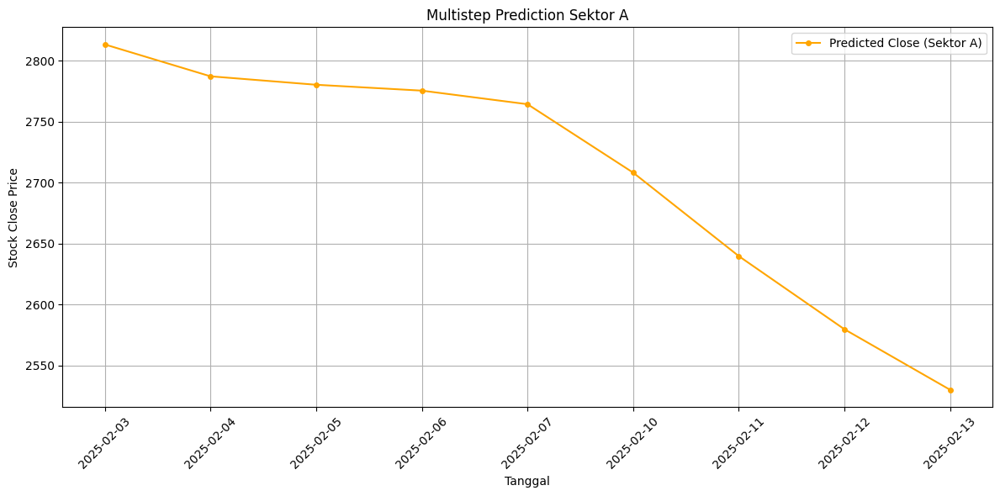

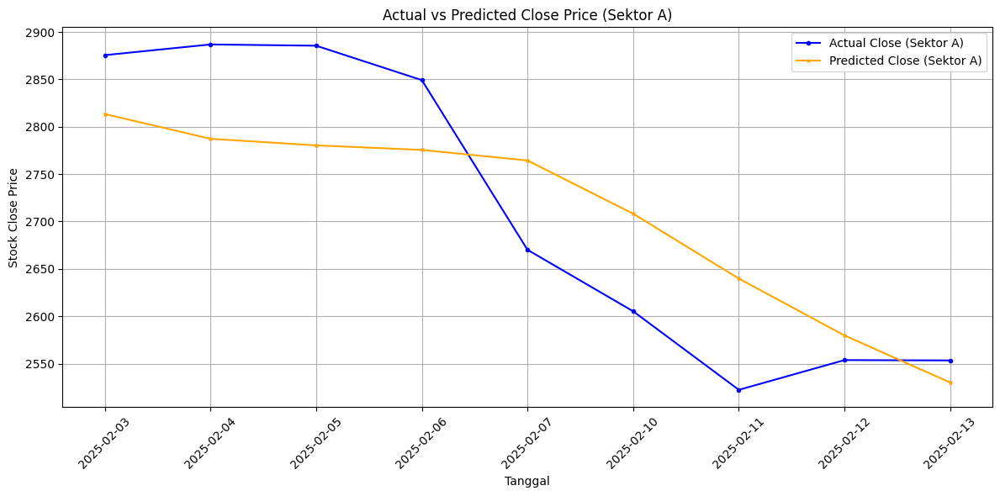

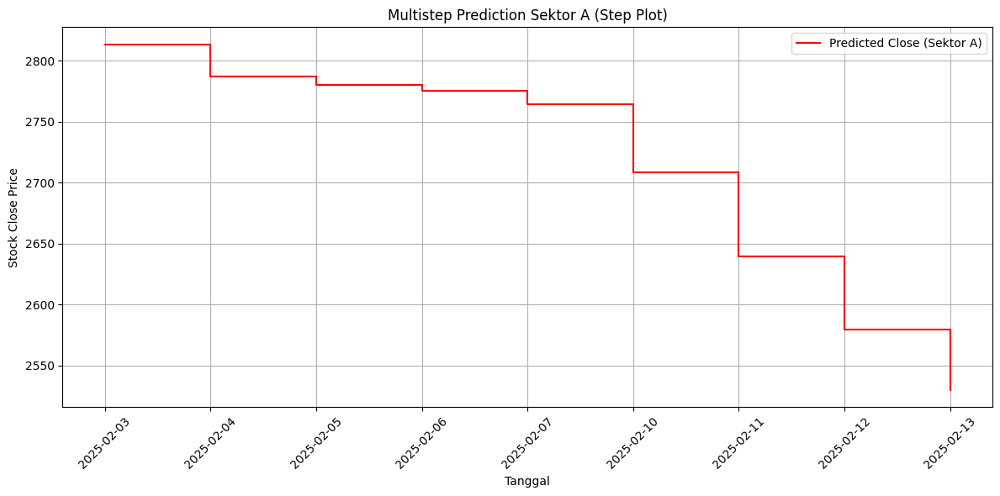

Head data prediksi Sektor A:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     2813.400879      2875.545
1  2025-02-04     2787.263672      2886.815
2  2025-02-05     2780.335938      2885.488
3  2025-02-06     2775.517090      2849.183
4  2025-02-07     2764.376953      2670.111
5  2025-02-10     2708.238281      2605.239
6  2025-02-11     2639.742676      2522.332
7  2025-02-12     2579.723633      2553.726
8  2025-02-13     2530.067139      2553.363
Evaluasi Model Sektor A:
MAE: 78.28
RMSE: 84.82
MAPE: 5.71%

PROCESSING SEKTOR B


<ipython-input-29-a49c26744ec0>:128: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


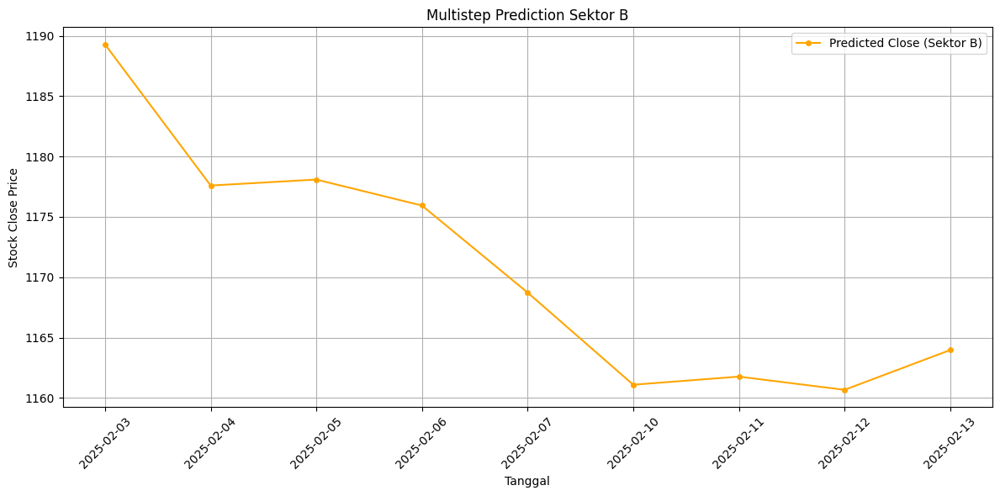

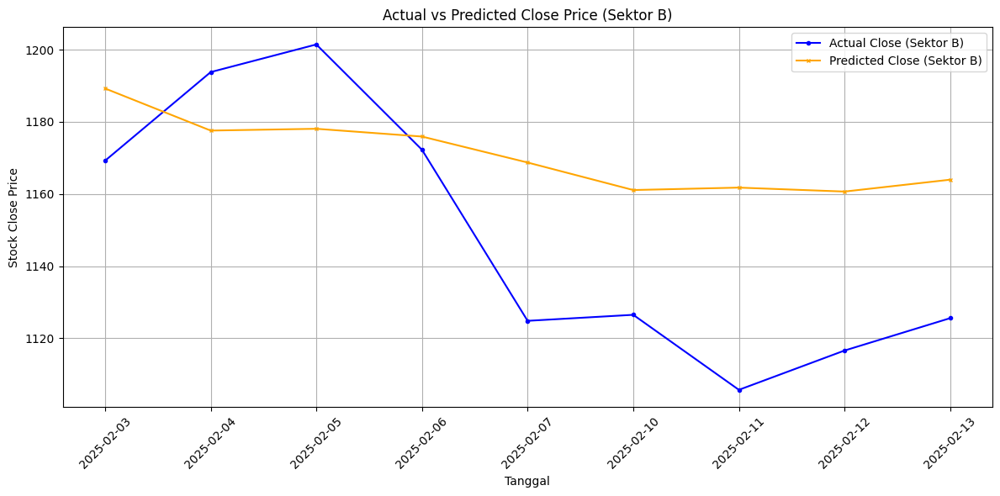

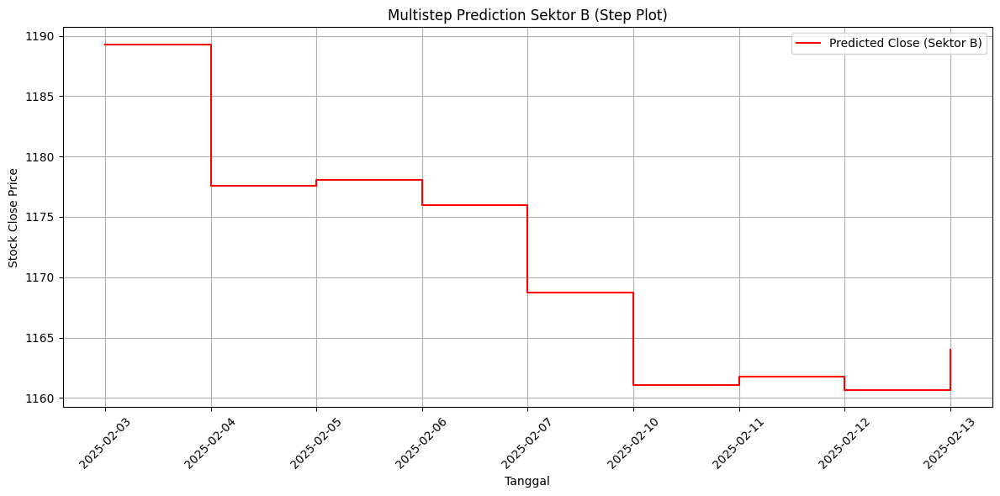

Head data prediksi Sektor B:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1189.279053      1169.232
1  2025-02-04     1177.593872      1193.817
2  2025-02-05     1178.090088      1201.485
3  2025-02-06     1175.937256      1172.273
4  2025-02-07     1168.732300      1124.812
5  2025-02-10     1161.096680      1126.481
6  2025-02-11     1161.769897      1105.669
7  2025-02-12     1160.674072      1116.570
8  2025-02-13     1163.969360      1125.552
Evaluasi Model Sektor B:
MAE: 31.17
RMSE: 34.84
MAPE: 3.19%

PROCESSING SEKTOR C


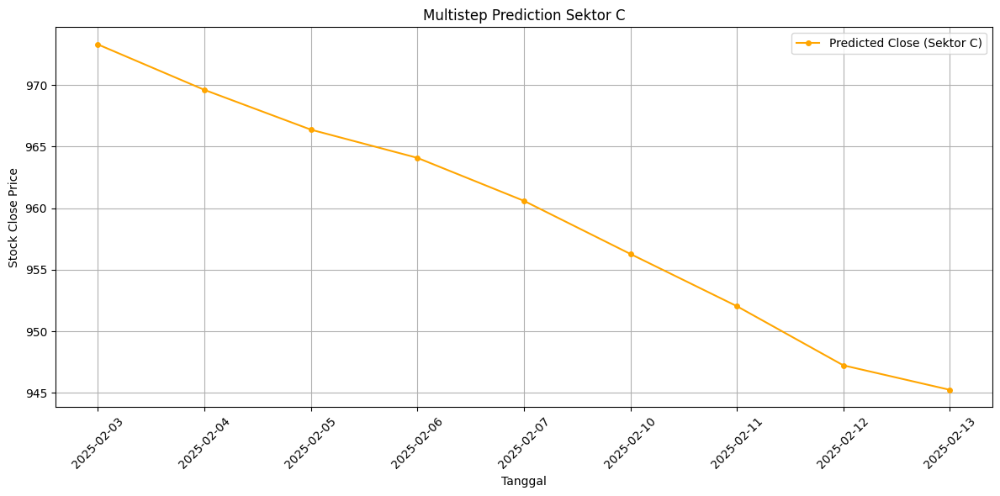

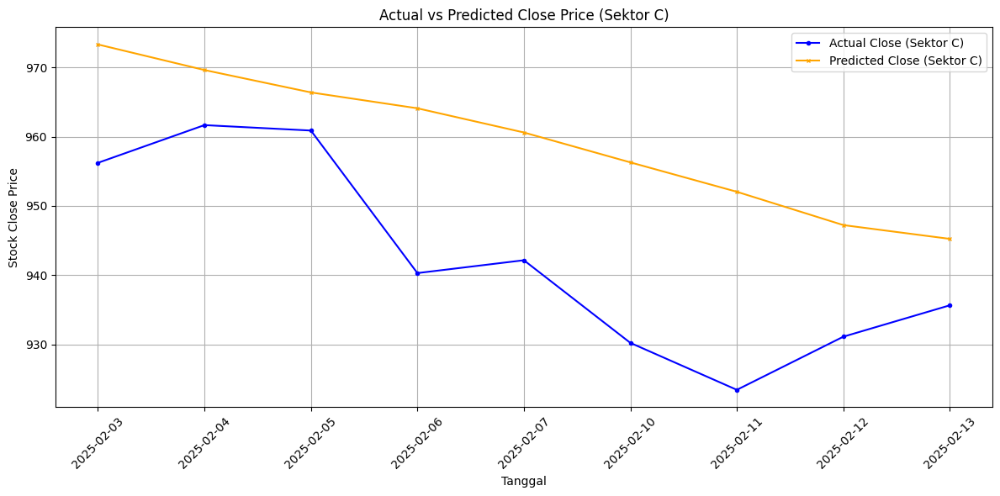

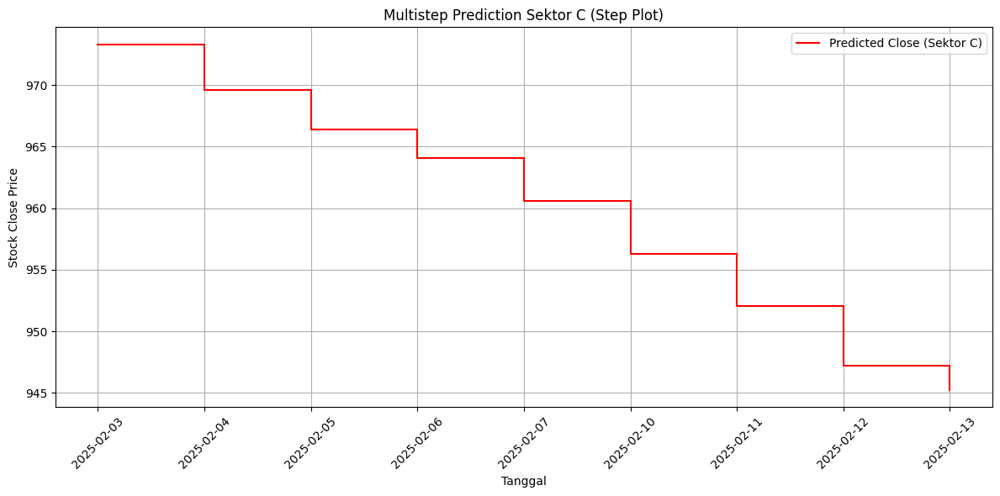

Head data prediksi Sektor C:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      973.311279       956.215
1  2025-02-04      969.620117       961.663
2  2025-02-05      966.385437       960.880
3  2025-02-06      964.092834       940.296
4  2025-02-07      960.601318       942.151
5  2025-02-10      956.282959       930.218
6  2025-02-11      952.037170       923.437
7  2025-02-12      947.226624       931.112
8  2025-02-13      945.236389       935.644
Evaluasi Model Sektor C:
MAE: 17.02
RMSE: 18.68
MAPE: 2.12%

PROCESSING SEKTOR D


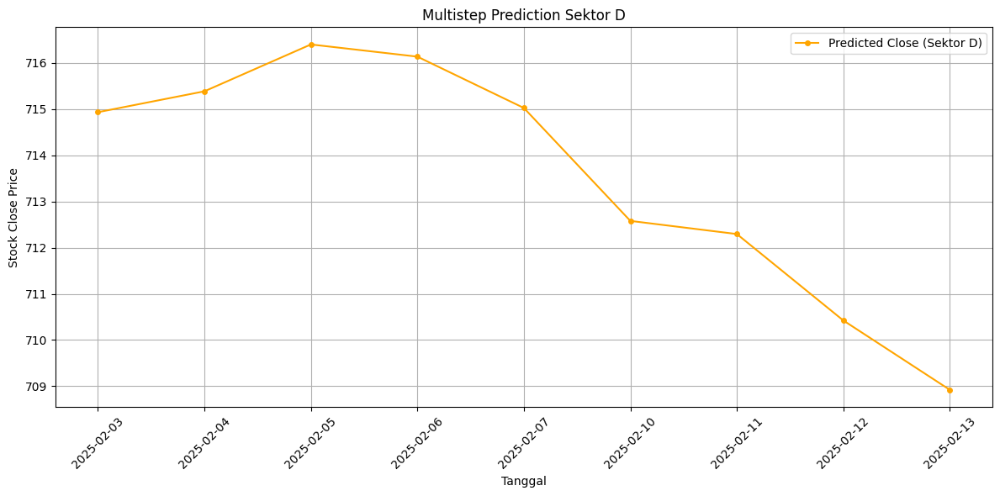

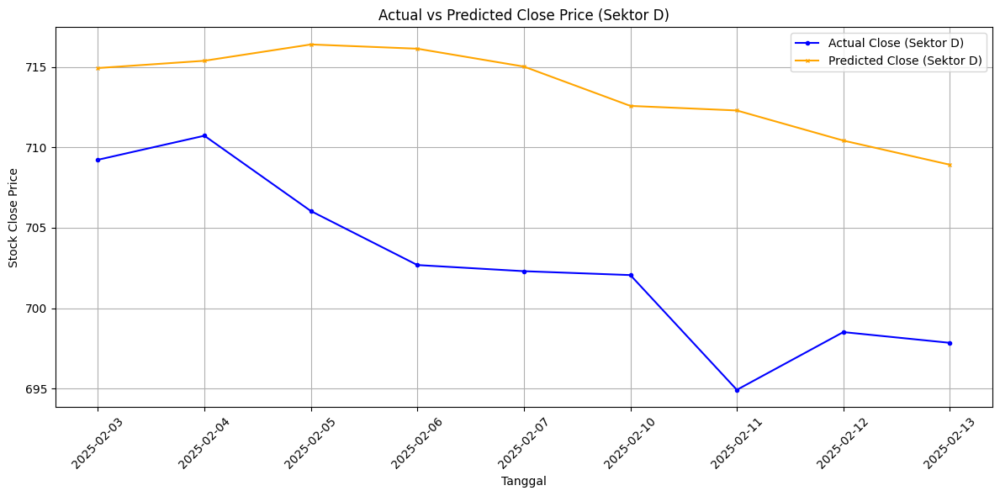

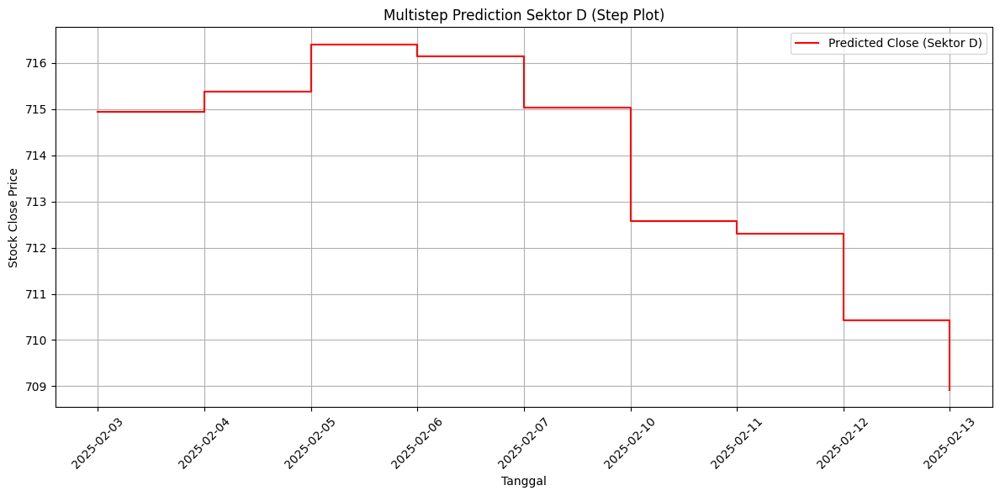

Head data prediksi Sektor D:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      714.934387       709.229
1  2025-02-04      715.386658       710.725
2  2025-02-05      716.401306       706.041
3  2025-02-06      716.137268       702.683
4  2025-02-07      715.025818       702.301
5  2025-02-10      712.580200       702.059
6  2025-02-11      712.295837       694.922
7  2025-02-12      710.423828       698.513
8  2025-02-13      708.921997       697.845
Evaluasi Model Sektor D:
MAE: 10.87
RMSE: 11.46
MAPE: 1.56%

PROCESSING SEKTOR E


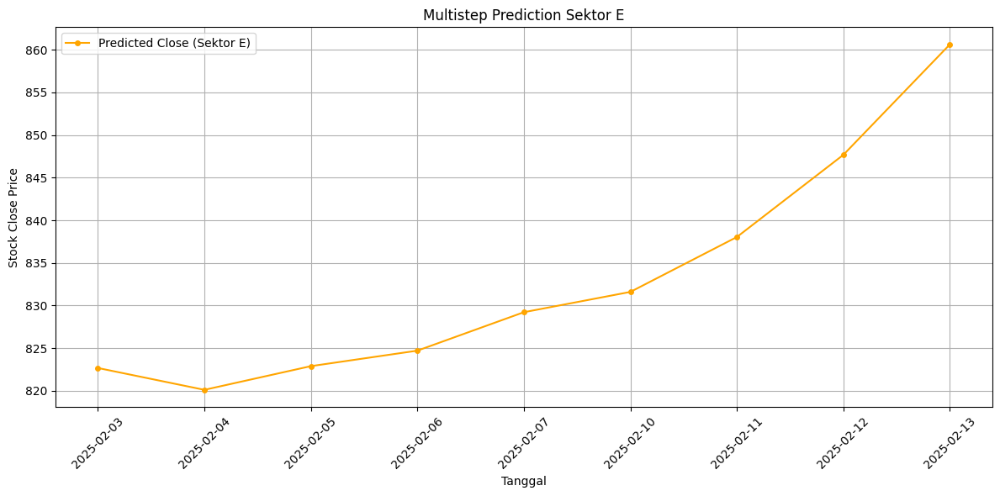

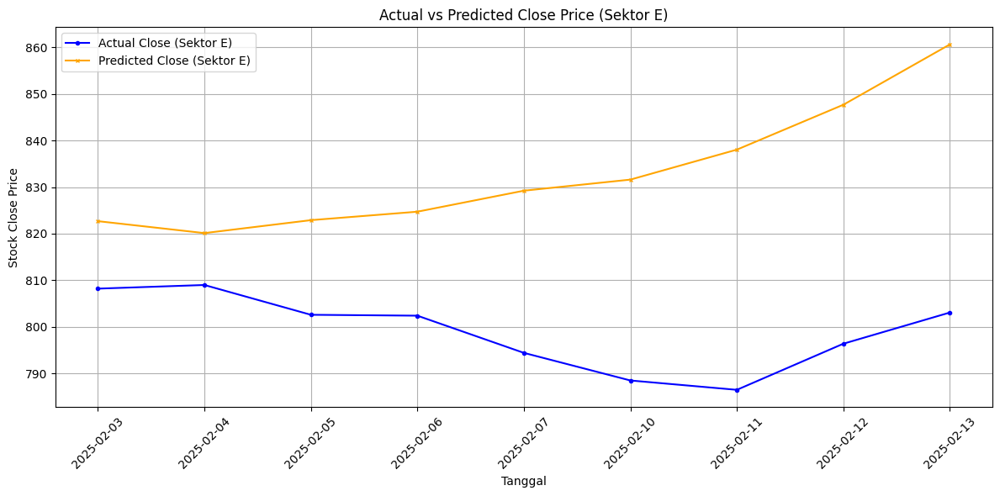

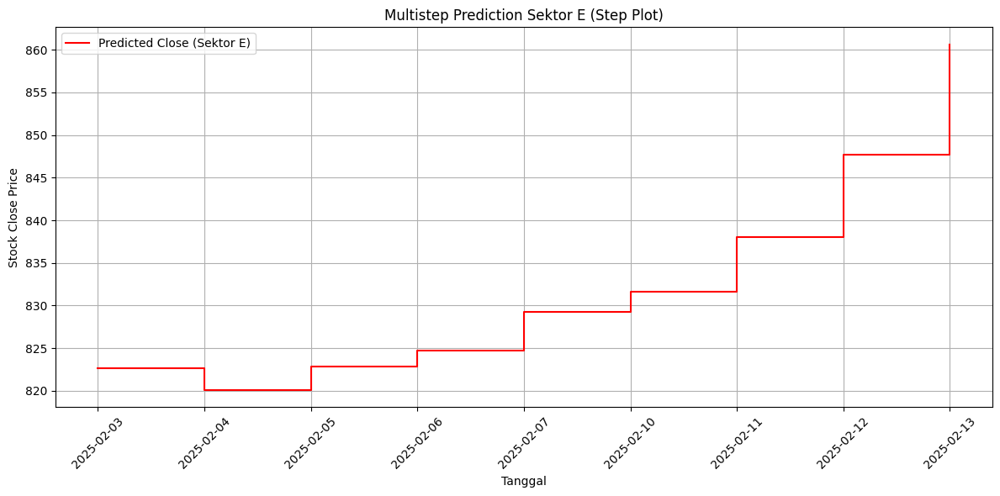

Head data prediksi Sektor E:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      822.675842       808.191
1  2025-02-04      820.113831       808.971
2  2025-02-05      822.892639       802.576
3  2025-02-06      824.709106       802.384
4  2025-02-07      829.217651       794.398
5  2025-02-10      831.597595       788.472
6  2025-02-11      838.032104       786.462
7  2025-02-12      847.670654       796.363
8  2025-02-13      860.617249       803.057
Evaluasi Model Sektor E:
MAE: 34.07
RMSE: 37.89
MAPE: 4.27%

PROCESSING SEKTOR F


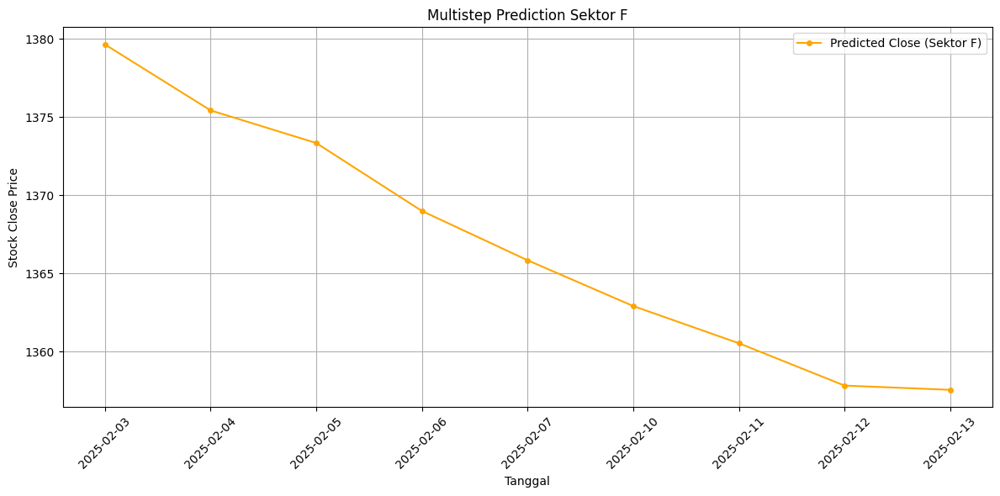

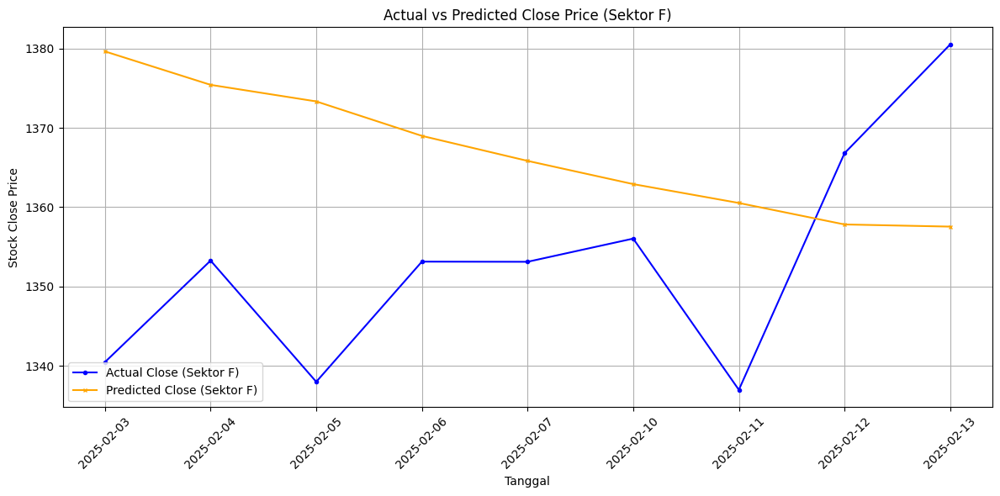

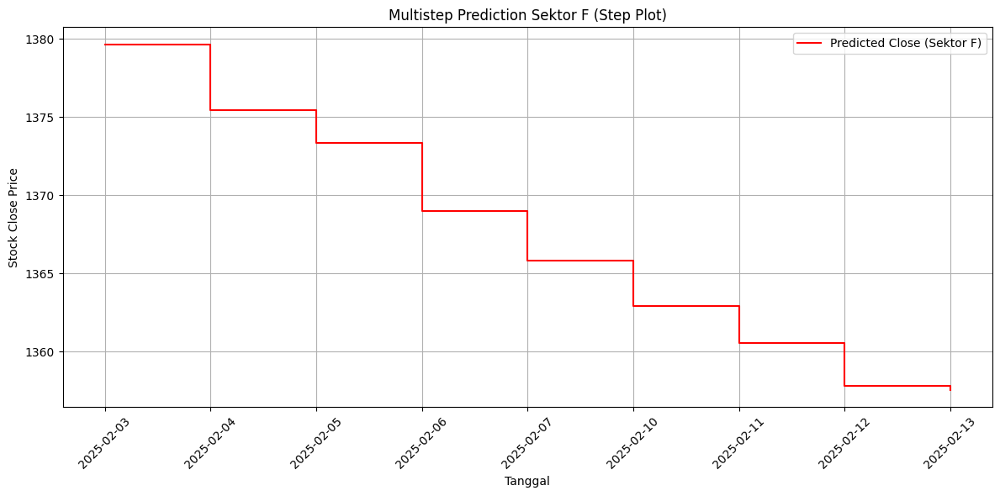

Head data prediksi Sektor F:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1379.648926      1340.464
1  2025-02-04     1375.430176      1353.266
2  2025-02-05     1373.341431      1337.978
3  2025-02-06     1368.994507      1353.134
4  2025-02-07     1365.841309      1353.114
5  2025-02-10     1362.912231      1356.040
6  2025-02-11     1360.531860      1336.965
7  2025-02-12     1357.823486      1366.806
8  2025-02-13     1357.550415      1380.525
Evaluasi Model Sektor F:
MAE: 20.86
RMSE: 23.34
MAPE: 1.30%

PROCESSING SEKTOR G


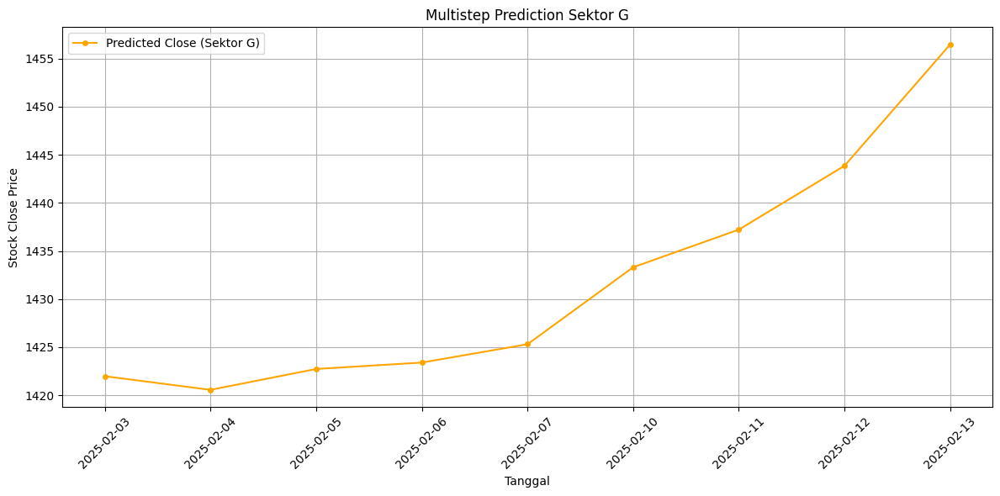

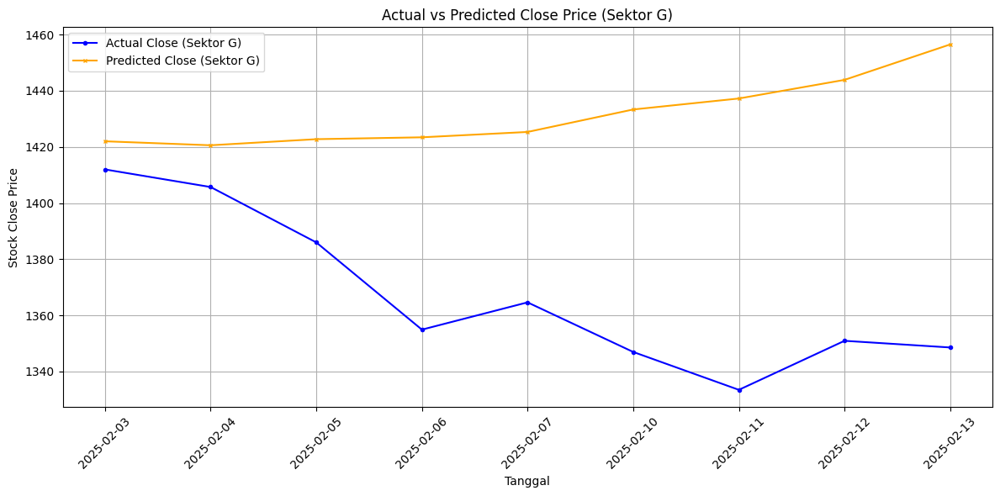

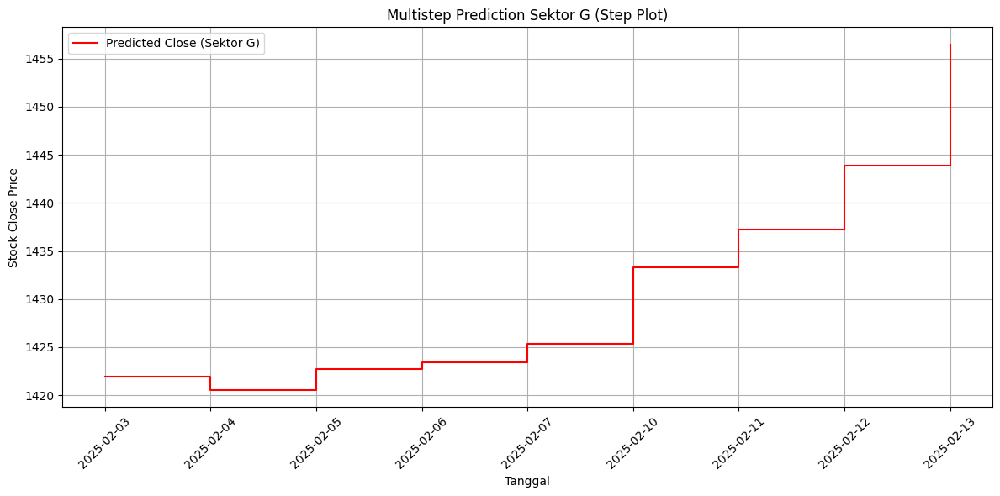

Head data prediksi Sektor G:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1421.982544      1411.965
1  2025-02-04     1420.567627      1405.702
2  2025-02-05     1422.735352      1385.990
3  2025-02-06     1423.401001      1354.928
4  2025-02-07     1425.305298      1364.633
5  2025-02-10     1433.307129      1346.979
6  2025-02-11     1437.218140      1333.492
7  2025-02-12     1443.849243      1350.947
8  2025-02-13     1456.460449      1348.573
Evaluasi Model Sektor G:
MAE: 64.62
RMSE: 73.43
MAPE: 4.77%

PROCESSING SEKTOR H


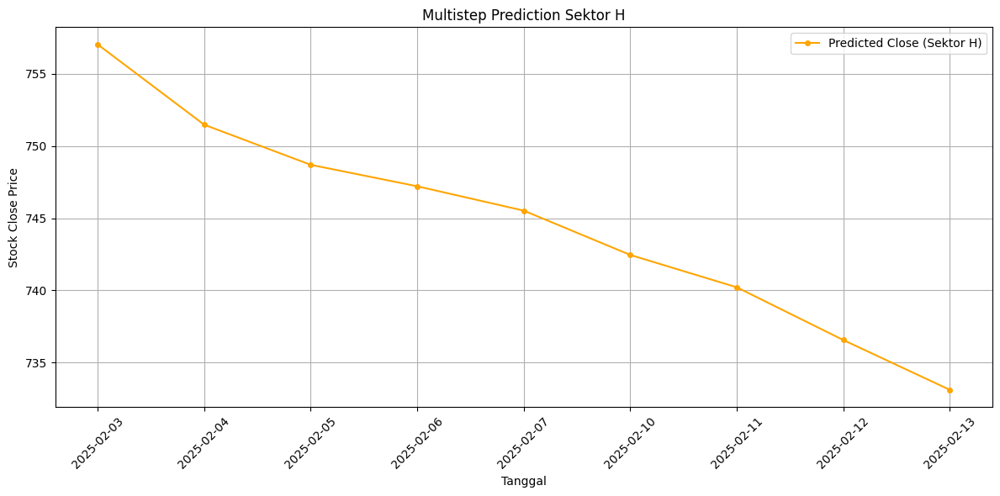

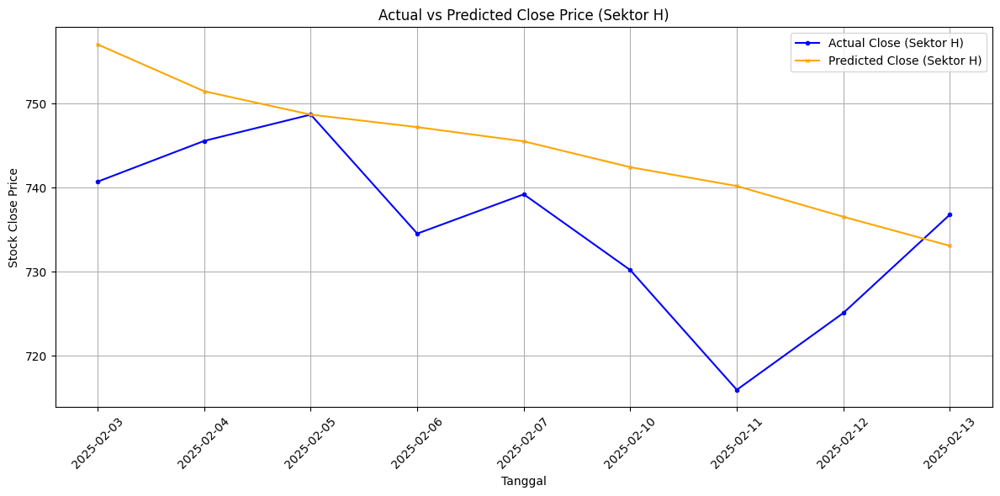

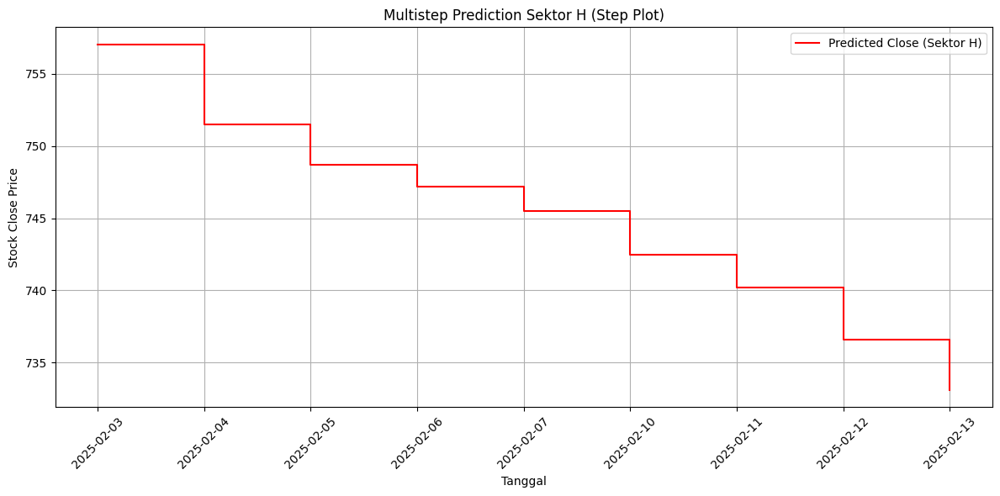

Head data prediksi Sektor H:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      757.040710       740.733
1  2025-02-04      751.475586       745.577
2  2025-02-05      748.698669       748.702
3  2025-02-06      747.211060       734.554
4  2025-02-07      745.523132       739.227
5  2025-02-10      742.452148       730.220
6  2025-02-11      740.209290       715.981
7  2025-02-12      736.554871       725.116
8  2025-02-13      733.102539       736.806
Evaluasi Model Sektor H:
MAE: 10.31
RMSE: 12.39
MAPE: 1.65%

PROCESSING SEKTOR I


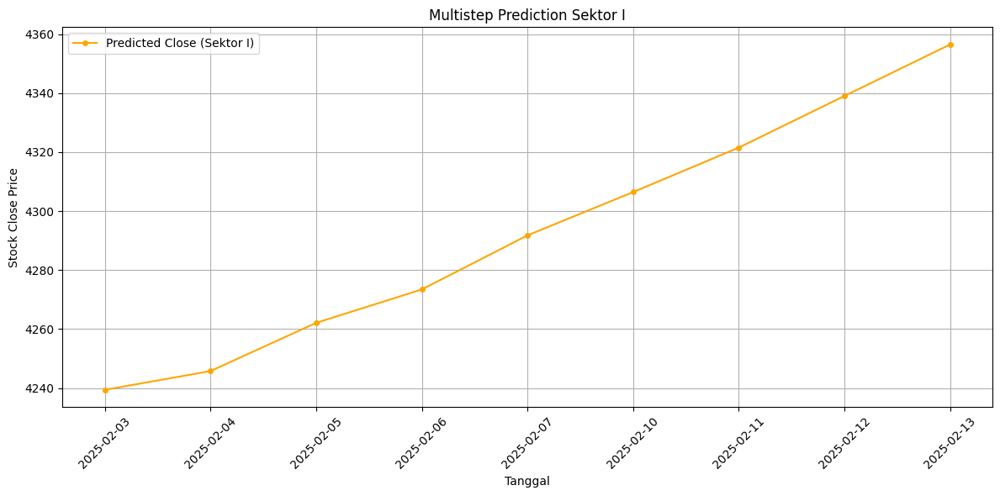

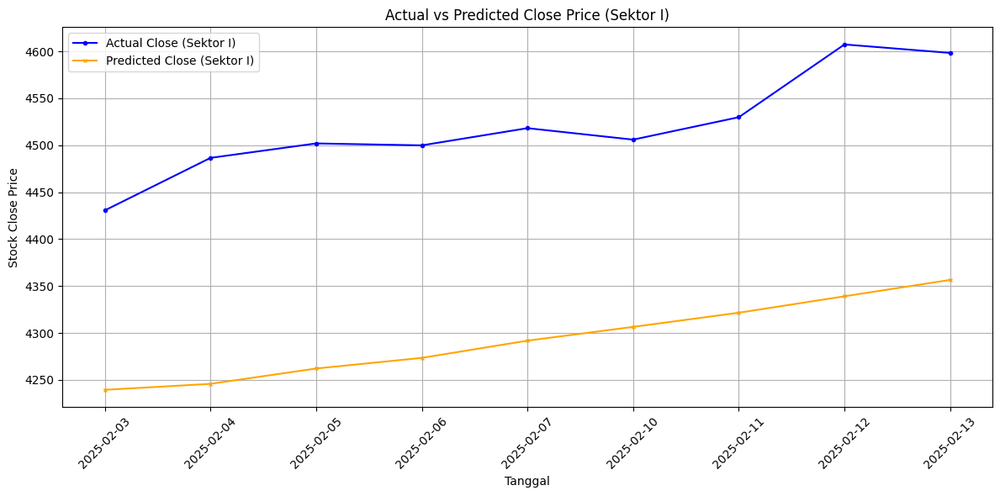

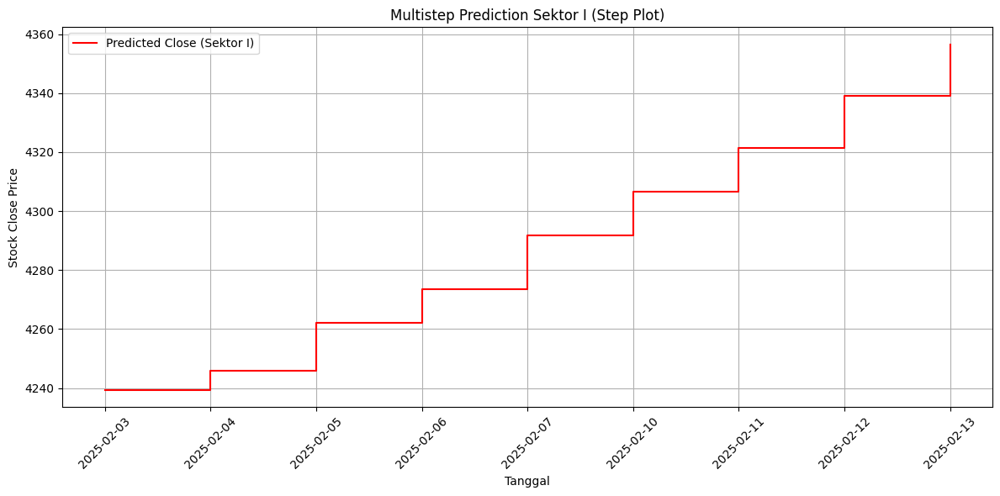

Head data prediksi Sektor I:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     4239.375000      4430.545
1  2025-02-04     4245.740234      4486.468
2  2025-02-05     4262.089844      4501.871
3  2025-02-06     4273.417969      4499.804
4  2025-02-07     4291.757812      4518.117
5  2025-02-10     4306.436035      4505.906
6  2025-02-11     4321.522461      4529.791
7  2025-02-12     4339.031738      4607.295
8  2025-02-13     4356.495605      4598.270
Evaluasi Model Sektor I:
MAE: 226.91
RMSE: 228.05
MAPE: 5.01%

PROCESSING SEKTOR J


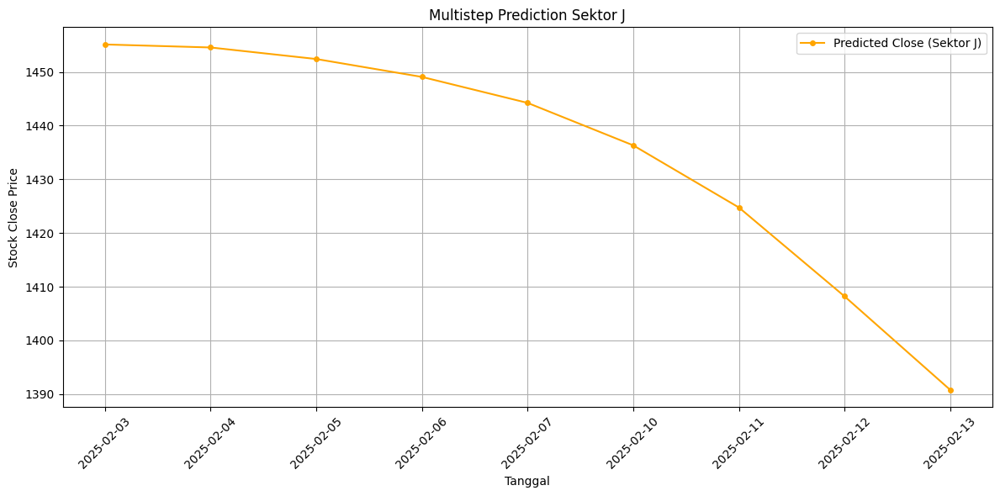

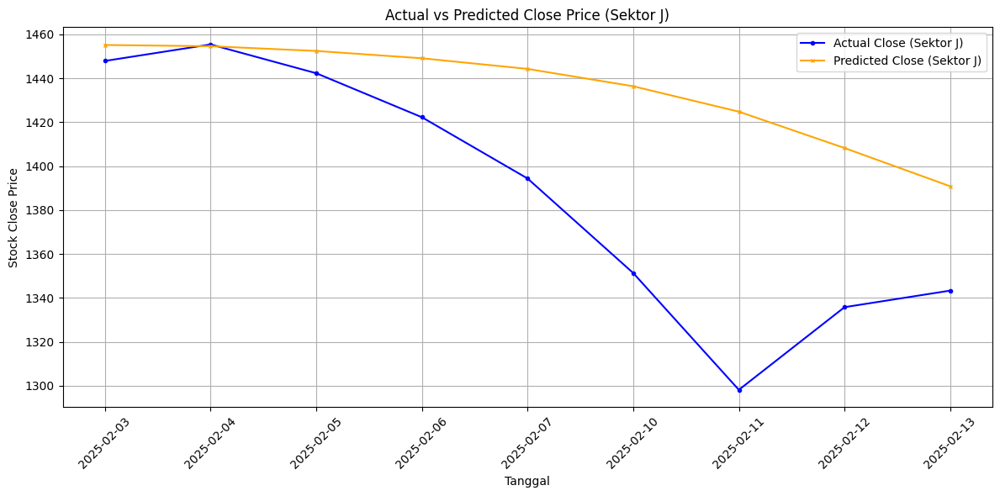

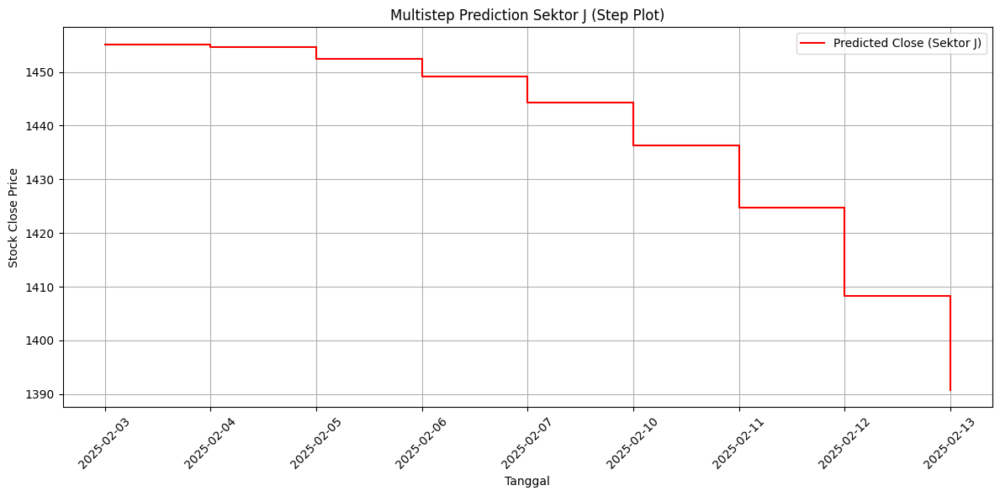

Head data prediksi Sektor J:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1455.120728      1447.861
1  2025-02-04     1454.558838      1455.366
2  2025-02-05     1452.410278      1442.265
3  2025-02-06     1449.075562      1422.231
4  2025-02-07     1444.239624      1394.348
5  2025-02-10     1436.335449      1351.312
6  2025-02-11     1424.765991      1298.132
7  2025-02-12     1408.217407      1335.760
8  2025-02-13     1390.804443      1343.301
Evaluasi Model Sektor J:
MAE: 47.40
RMSE: 61.59
MAPE: 4.37%

PROCESSING SEKTOR K


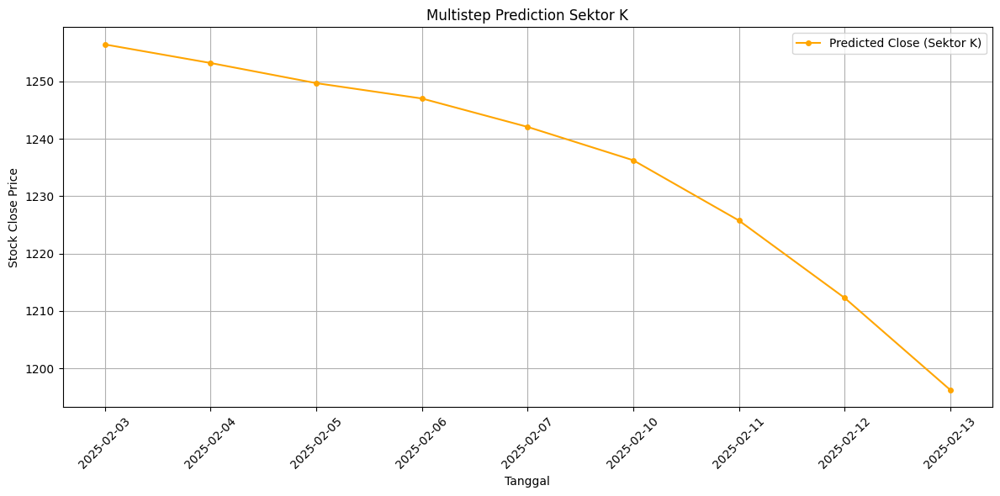

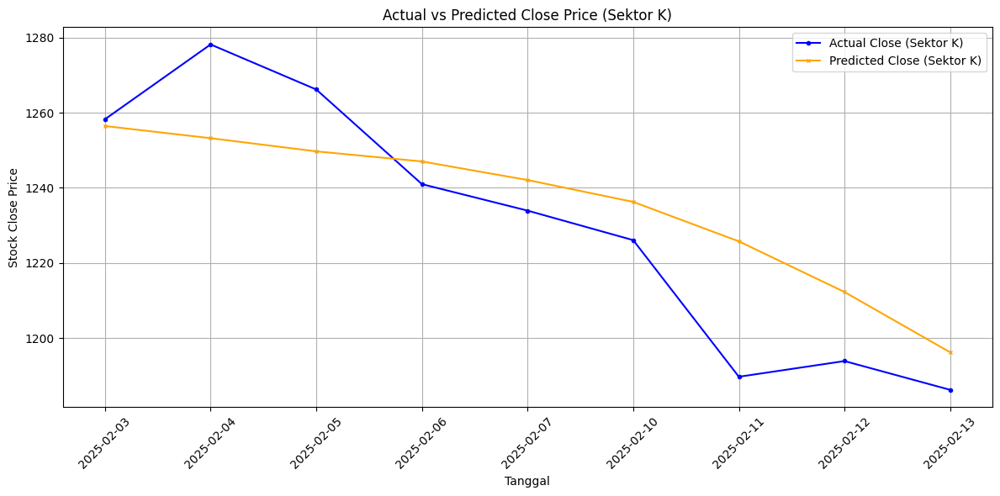

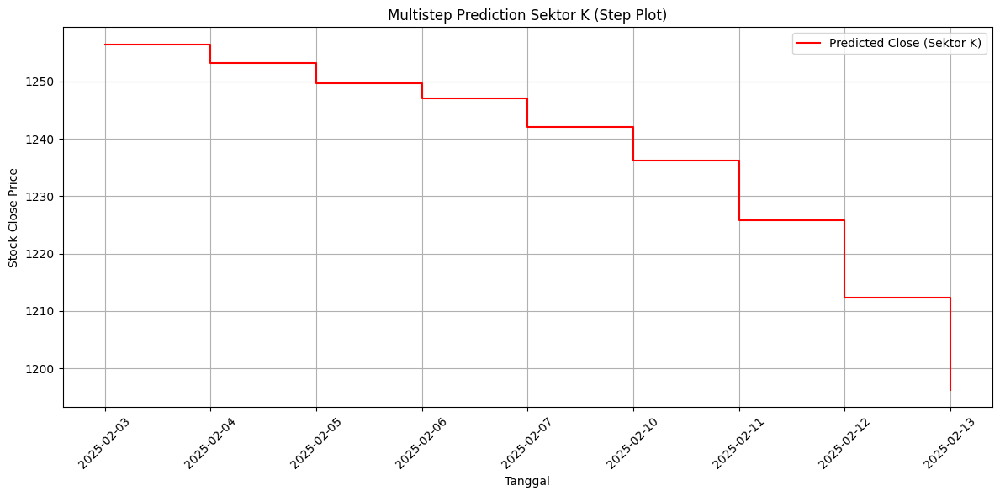

Head data prediksi Sektor K:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1256.442627      1258.244
1  2025-02-04     1253.207275      1278.147
2  2025-02-05     1249.698608      1266.166
3  2025-02-06     1247.020752      1240.981
4  2025-02-07     1242.072266      1233.936
5  2025-02-10     1236.255493      1226.077
6  2025-02-11     1225.757080      1189.726
7  2025-02-12     1212.275635      1193.900
8  2025-02-13     1196.232910      1186.247
Evaluasi Model Sektor K:
MAE: 14.66
RMSE: 17.76
MAPE: 2.57%

Hasil Evaluasi Semua Sektor:
   Sektor         MAE        RMSE      MAPE
0       A   78.275870   84.823178  5.714131
1       B   31.165295   34.835222  3.189094
2       C   17.019792   18.683501  2.119549
3       D   10.865478   11.458477  1.559652
4       E   34.072519   37.892403  4.273952
5       F   20.855171   23.338007  1.298576
6       G   64.624198   73.426777  4.765259
7       H   10.307288   12.390749  1.651091
8       I  226.911145  228.050685  5.008087
9

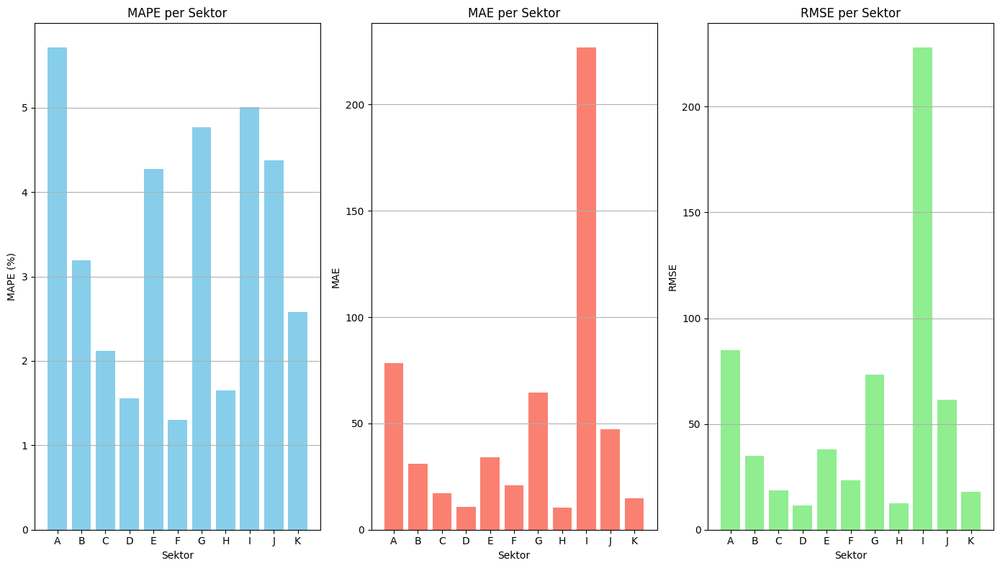

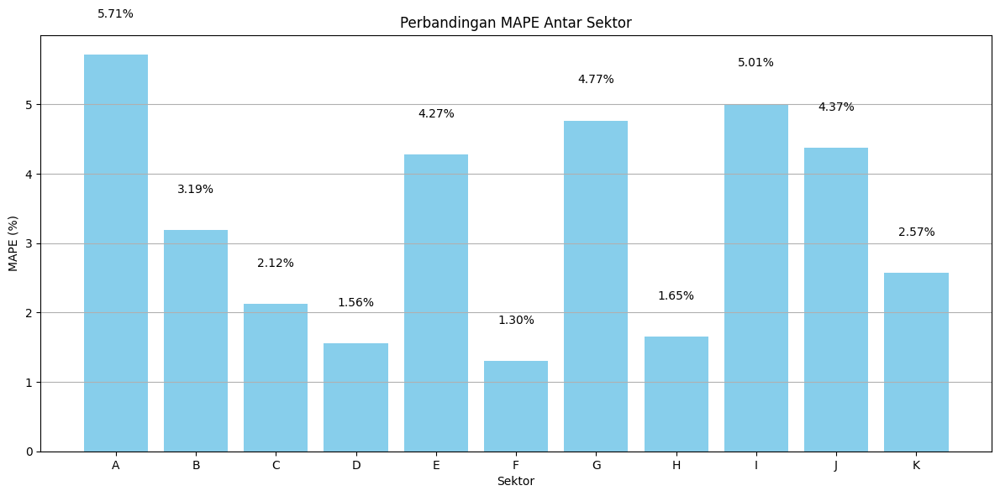

In [29]:
# BIDIRECT

import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_bi.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

# CONVO


PROCESSING SEKTOR A


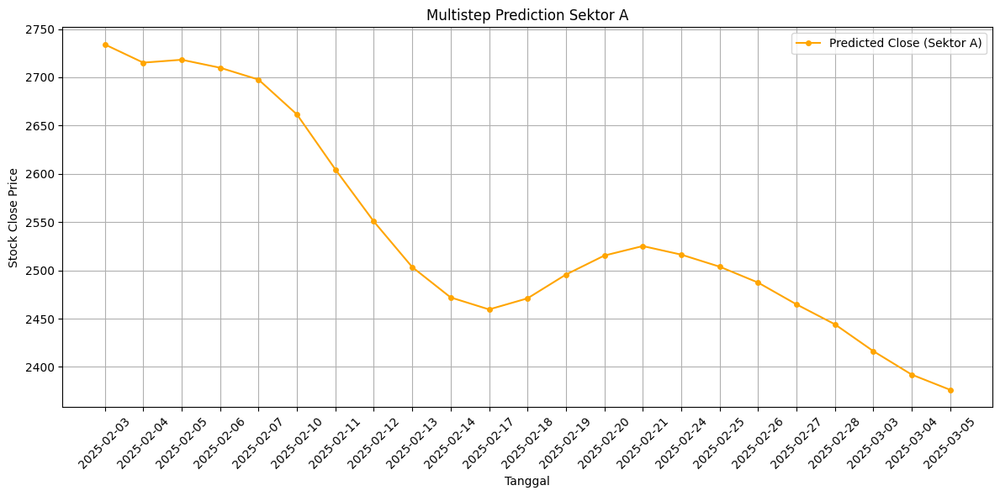

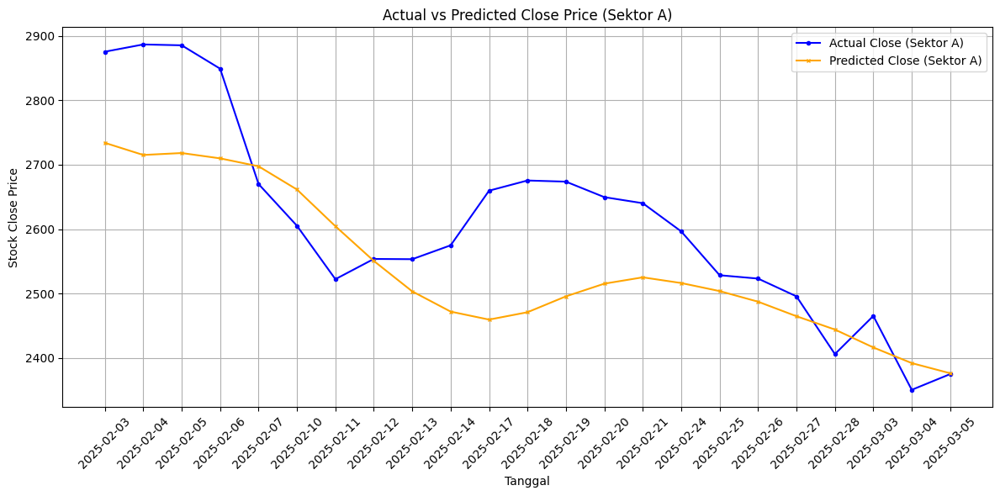

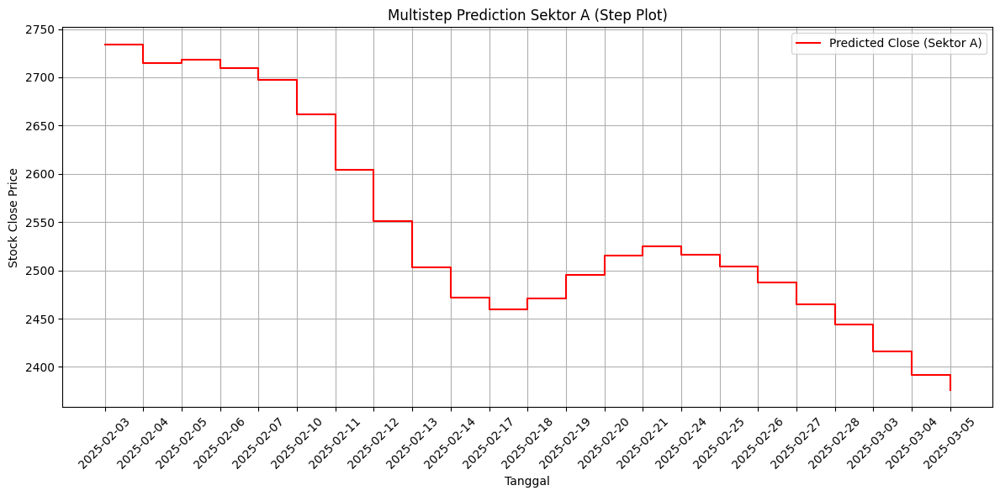

Head data prediksi Sektor A:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     2734.047852      2875.545
1   2025-02-04     2715.201172      2886.815
2   2025-02-05     2718.199219      2885.488
3   2025-02-06     2709.924561      2849.183
4   2025-02-07     2697.635742      2670.111
5   2025-02-10     2661.531494      2605.239
6   2025-02-11     2604.583008      2522.332
7   2025-02-12     2550.673096      2553.726
8   2025-02-13     2503.400635      2553.363
9   2025-02-14     2471.960693      2574.895
10  2025-02-17     2459.545410      2659.762
11  2025-02-18     2471.001465      2675.566
12  2025-02-19     2495.644043      2673.765
13  2025-02-20     2515.349854      2649.705
14  2025-02-21     2525.185791      2640.302
15  2025-02-24     2516.323486      2596.529
16  2025-02-25     2503.830811      2528.448
17  2025-02-26     2487.374268      2523.244
18  2025-02-27     2464.793213      2495.665
19  2025-02-28     2444.124023      2405.982
20  2025-03-03     2416.32

<ipython-input-53-215fa0946125>:127: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


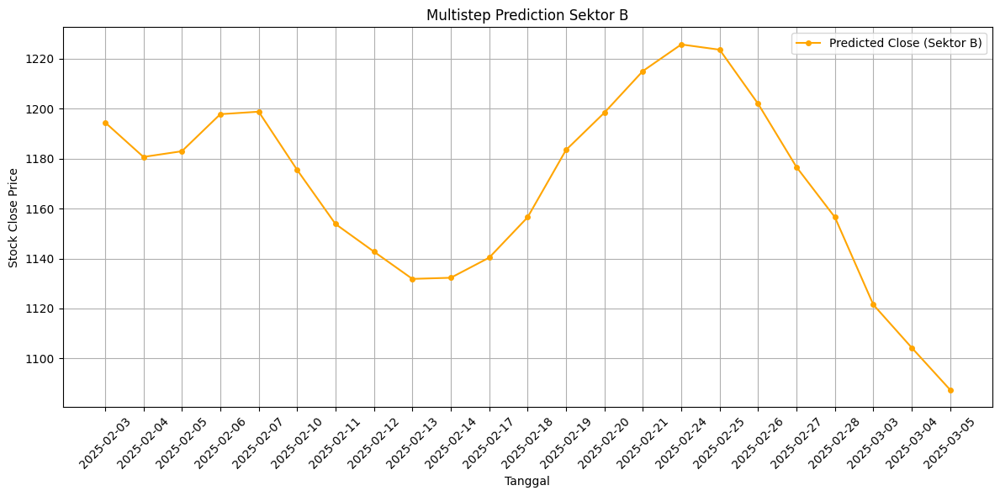

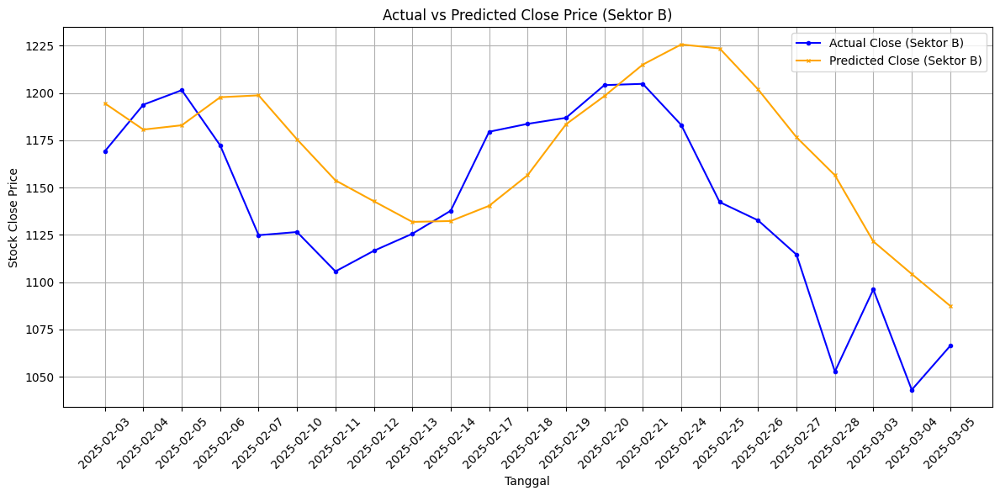

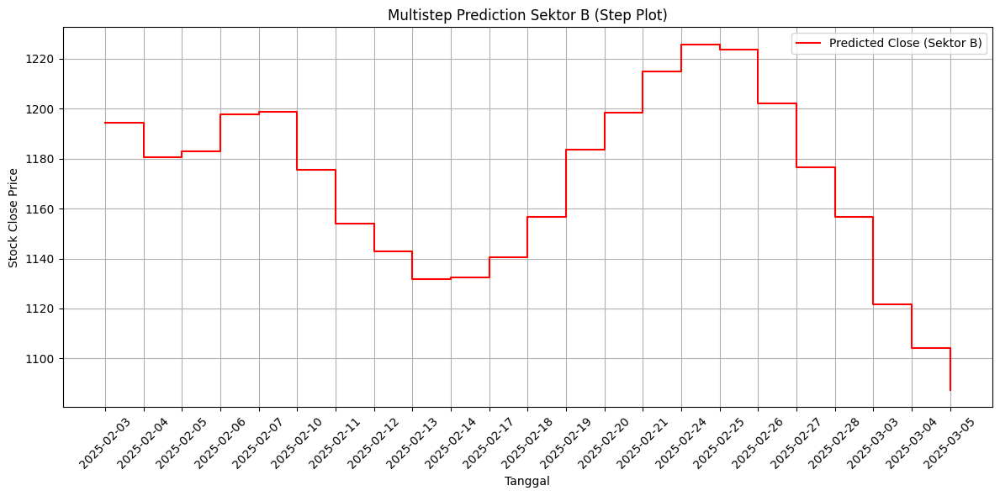

Head data prediksi Sektor B:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1194.475952      1169.232
1   2025-02-04     1180.648071      1193.817
2   2025-02-05     1182.929810      1201.485
3   2025-02-06     1197.755127      1172.273
4   2025-02-07     1198.751709      1124.812
5   2025-02-10     1175.475586      1126.481
6   2025-02-11     1153.795044      1105.669
7   2025-02-12     1142.748535      1116.570
8   2025-02-13     1131.841919      1125.552
9   2025-02-14     1132.294800      1137.731
10  2025-02-17     1140.350952      1179.500
11  2025-02-18     1156.500610      1183.668
12  2025-02-19     1183.437866      1186.856
13  2025-02-20     1198.371948      1204.159
14  2025-02-21     1215.006592      1204.832
15  2025-02-24     1225.656128      1183.083
16  2025-02-25     1223.550537      1142.301
17  2025-02-26     1201.915894      1132.661
18  2025-02-27     1176.586182      1114.539
19  2025-02-28     1156.502319      1052.718
20  2025-03-03     1121.51

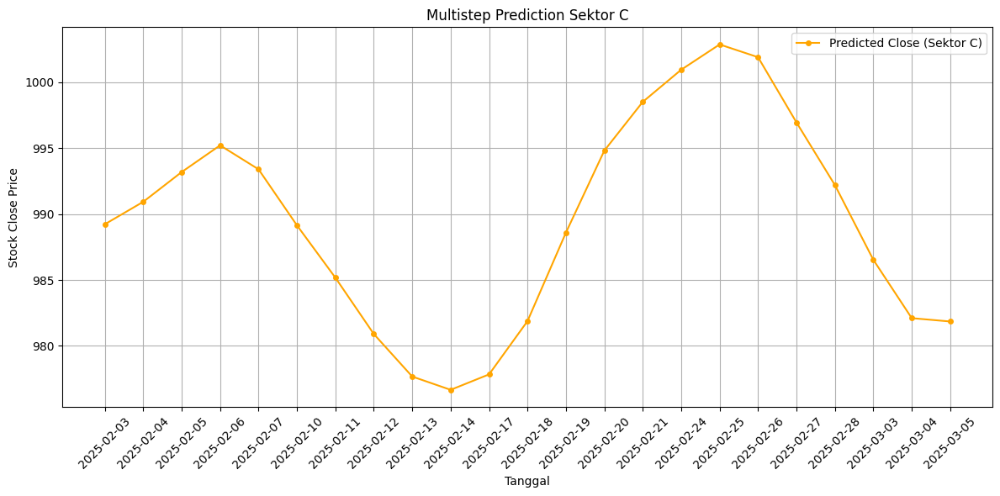

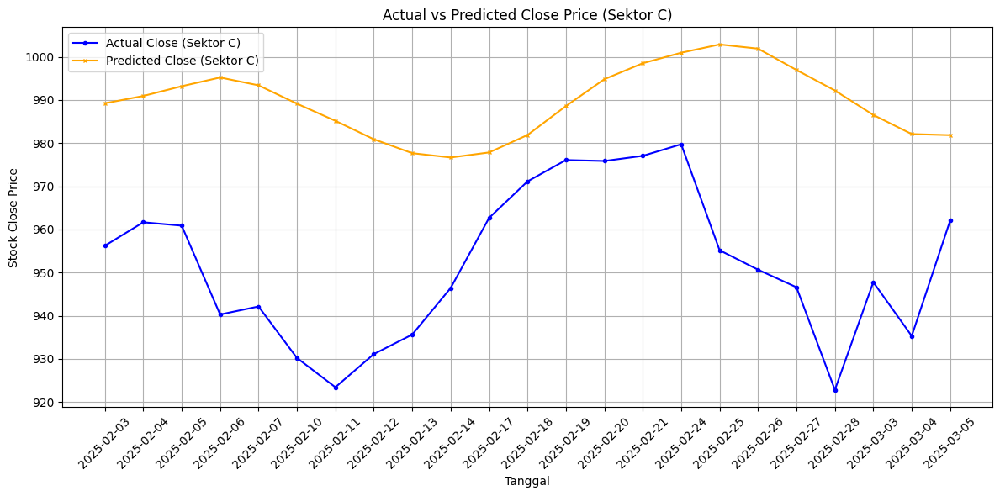

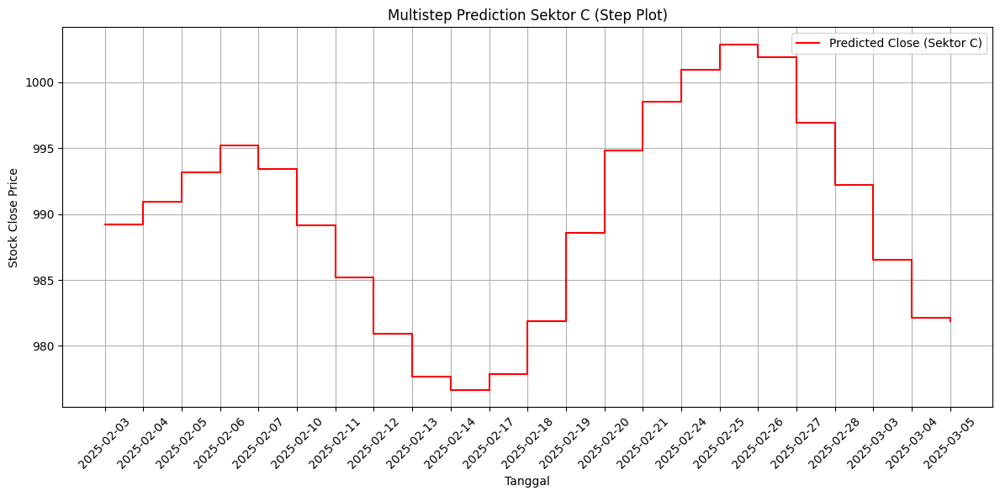

Head data prediksi Sektor C:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      989.226868       956.215
1   2025-02-04      990.929749       961.663
2   2025-02-05      993.188232       960.880
3   2025-02-06      995.211731       940.296
4   2025-02-07      993.394775       942.151
5   2025-02-10      989.142029       930.218
6   2025-02-11      985.171265       923.437
7   2025-02-12      980.899231       931.112
8   2025-02-13      977.671875       935.644
9   2025-02-14      976.663757       946.430
10  2025-02-17      977.837158       962.671
11  2025-02-18      981.877991       971.127
12  2025-02-19      988.588806       976.081
13  2025-02-20      994.814941       975.861
14  2025-02-21      998.510864       977.048
15  2025-02-24     1000.948364       979.739
16  2025-02-25     1002.866333       955.173
17  2025-02-26     1001.899353       950.672
18  2025-02-27      996.951233       946.607
19  2025-02-28      992.197815       922.831
20  2025-03-03      986.53

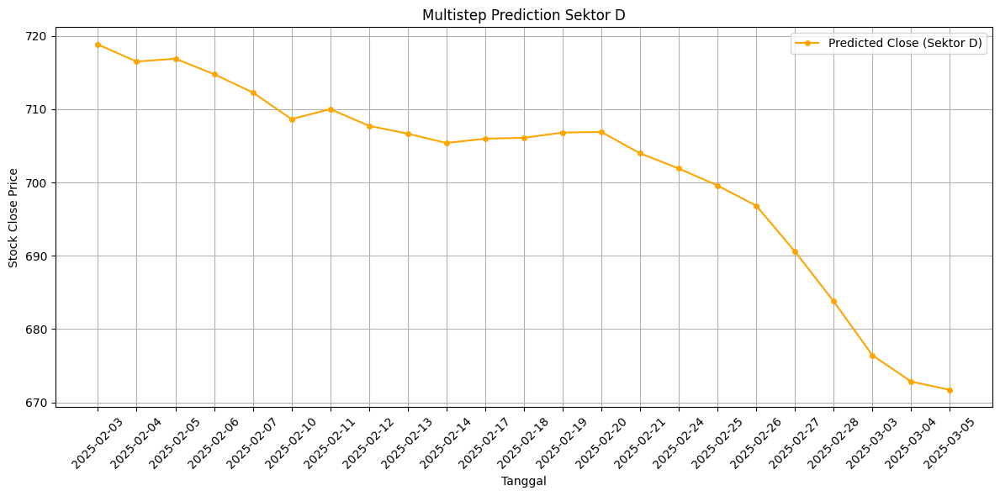

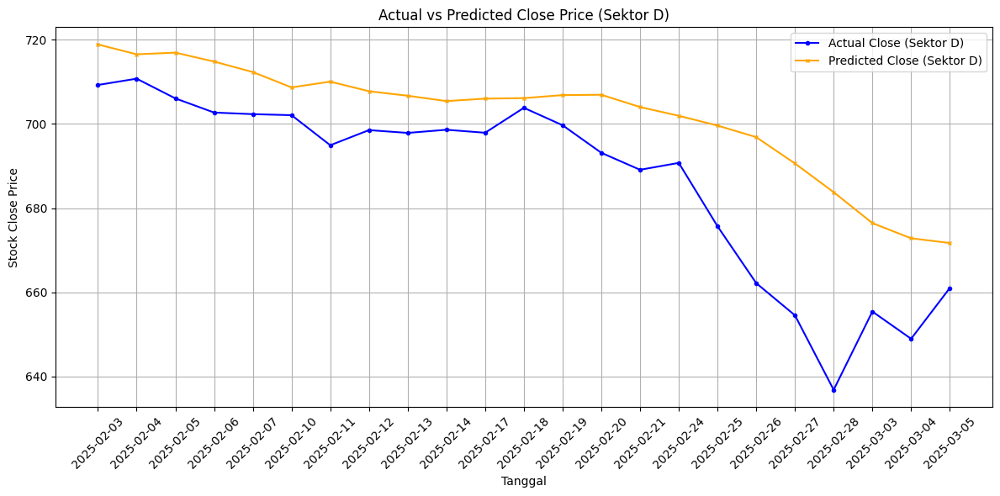

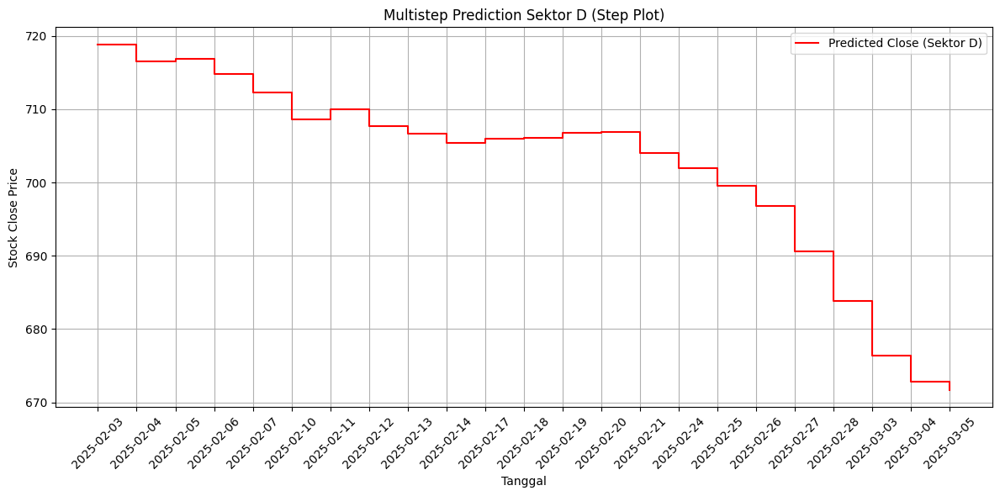

Head data prediksi Sektor D:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      718.847046       709.229
1   2025-02-04      716.508179       710.725
2   2025-02-05      716.904785       706.041
3   2025-02-06      714.788452       702.683
4   2025-02-07      712.290833       702.301
5   2025-02-10      708.653015       702.059
6   2025-02-11      710.020142       694.922
7   2025-02-12      707.743469       698.513
8   2025-02-13      706.673340       697.845
9   2025-02-14      705.402832       698.598
10  2025-02-17      705.984558       697.886
11  2025-02-18      706.104187       703.805
12  2025-02-19      706.822571       699.667
13  2025-02-20      706.904663       693.125
14  2025-02-21      703.989319       689.096
15  2025-02-24      701.912415       690.731
16  2025-02-25      699.596497       675.698
17  2025-02-26      696.844177       662.187
18  2025-02-27      690.589539       654.545
19  2025-02-28      683.784668       636.855
20  2025-03-03      676.43

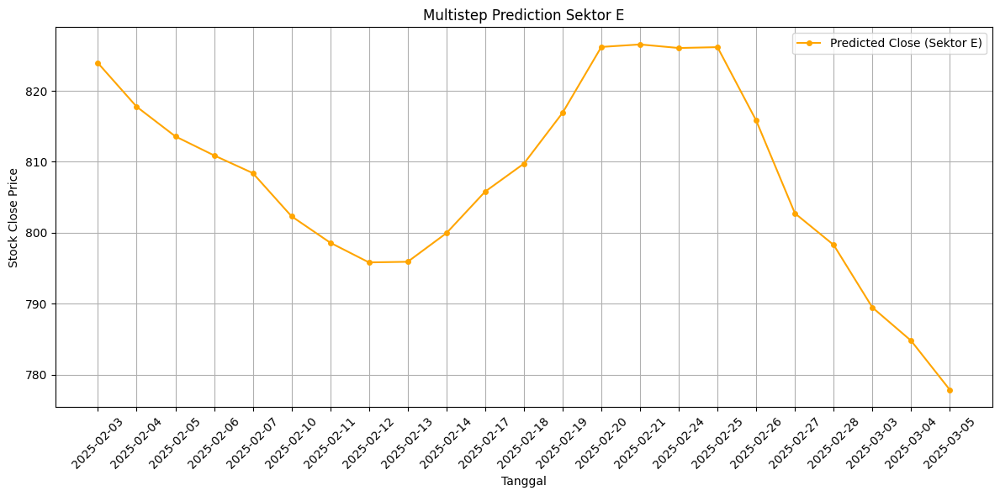

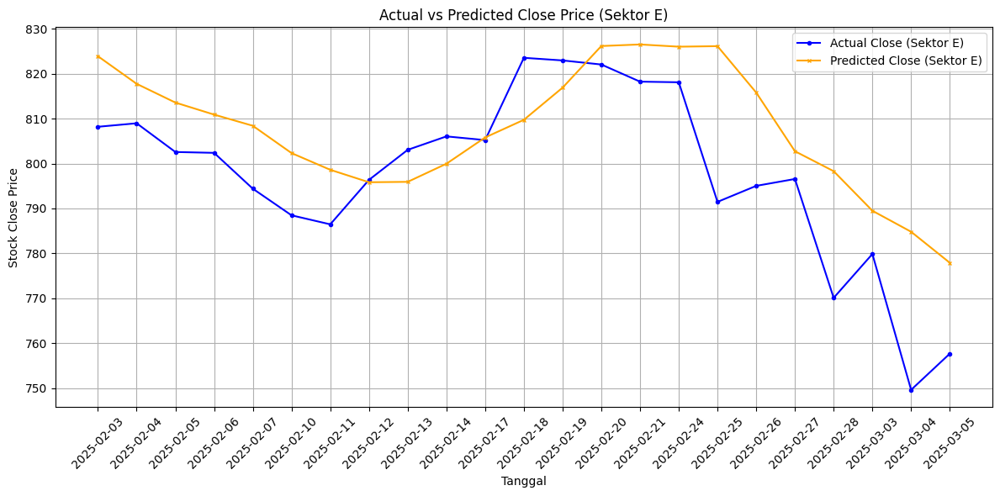

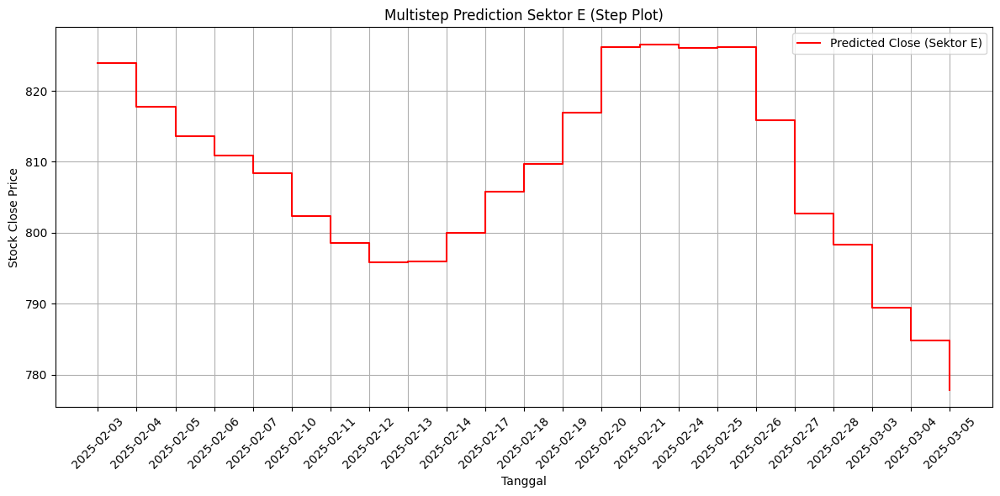

Head data prediksi Sektor E:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      823.912537       808.191
1   2025-02-04      817.762024       808.971
2   2025-02-05      813.584290       802.576
3   2025-02-06      810.904907       802.384
4   2025-02-07      808.415161       794.398
5   2025-02-10      802.332153       788.472
6   2025-02-11      798.611328       786.462
7   2025-02-12      795.837219       796.363
8   2025-02-13      795.924255       803.057
9   2025-02-14      799.959229       806.050
10  2025-02-17      805.808899       805.224
11  2025-02-18      809.742310       823.553
12  2025-02-19      816.909058       822.968
13  2025-02-20      826.177246       822.061
14  2025-02-21      826.527771       818.243
15  2025-02-24      826.028748       818.105
16  2025-02-25      826.147583       791.461
17  2025-02-26      815.806641       795.031
18  2025-02-27      802.745728       796.564
19  2025-02-28      798.301086       770.086
20  2025-03-03      789.48

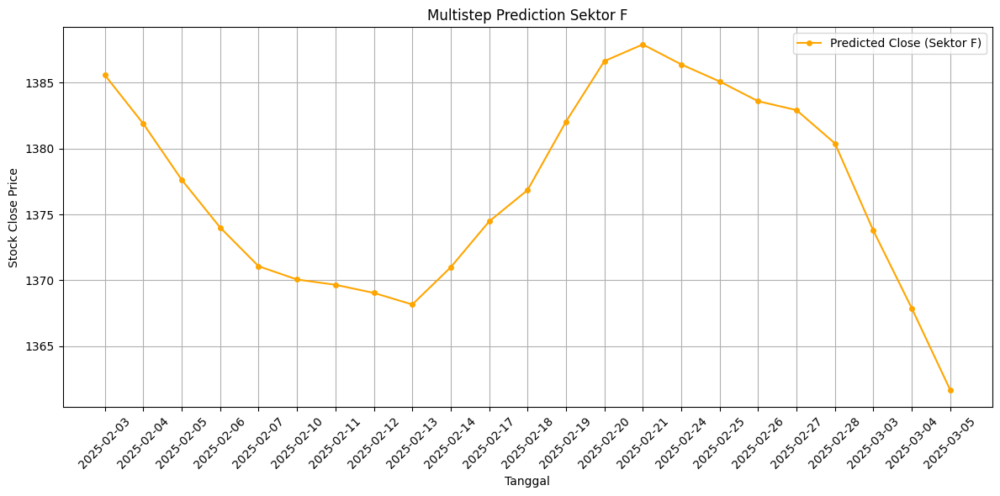

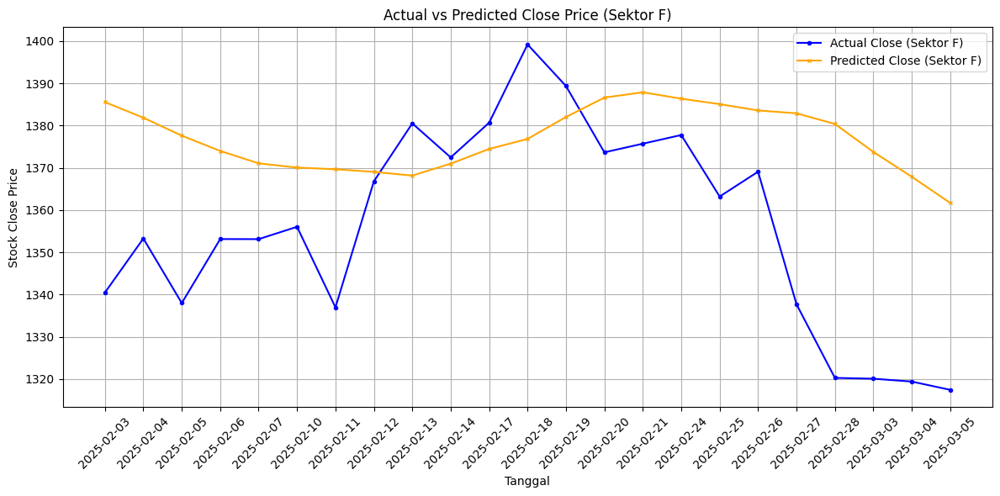

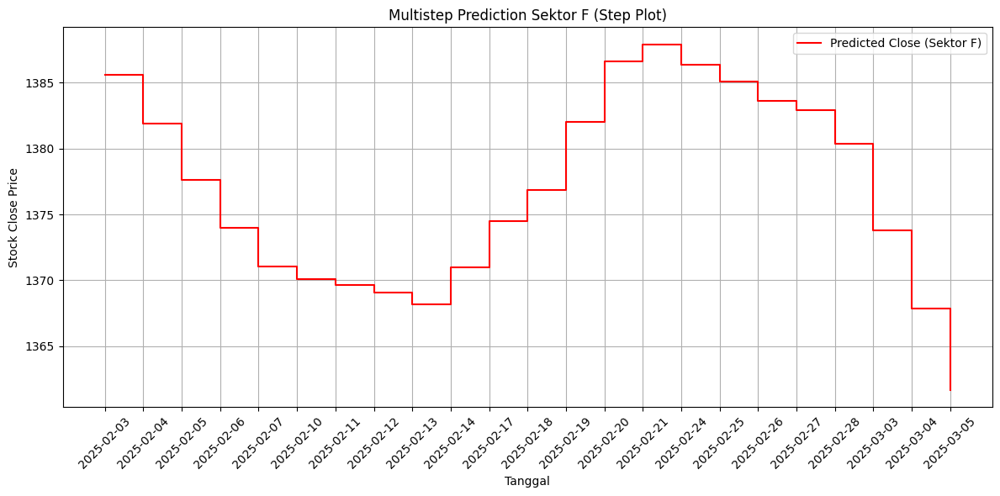

Head data prediksi Sektor F:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1385.562622      1340.464
1   2025-02-04     1381.873413      1353.266
2   2025-02-05     1377.621948      1337.978
3   2025-02-06     1374.003540      1353.134
4   2025-02-07     1371.068237      1353.114
5   2025-02-10     1370.063110      1356.040
6   2025-02-11     1369.663208      1336.965
7   2025-02-12     1369.045898      1366.806
8   2025-02-13     1368.168579      1380.525
9   2025-02-14     1370.990845      1372.470
10  2025-02-17     1374.470093      1380.690
11  2025-02-18     1376.847290      1399.220
12  2025-02-19     1382.038696      1389.374
13  2025-02-20     1386.633179      1373.668
14  2025-02-21     1387.893799      1375.719
15  2025-02-24     1386.380615      1377.770
16  2025-02-25     1385.085815      1363.206
17  2025-02-26     1383.589966      1369.086
18  2025-02-27     1382.913818      1337.693
19  2025-02-28     1380.391968      1320.260
20  2025-03-03     1373.77

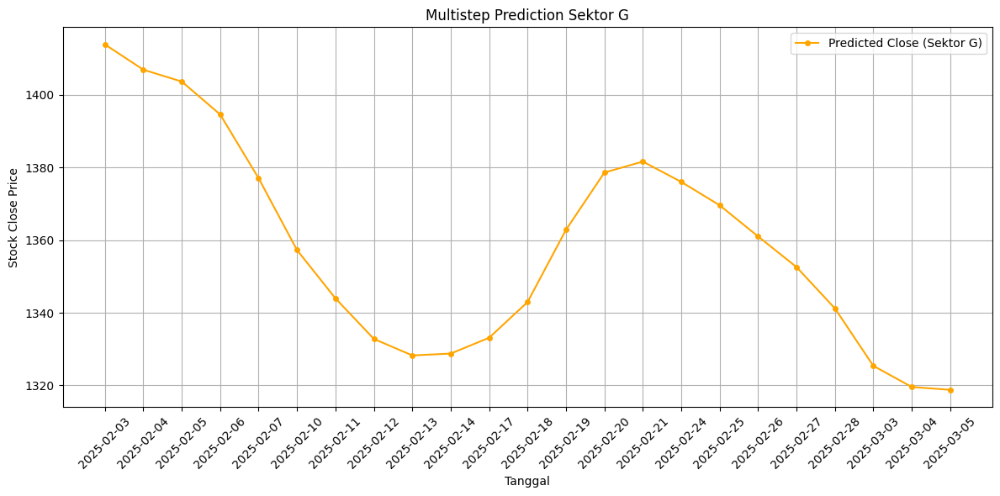

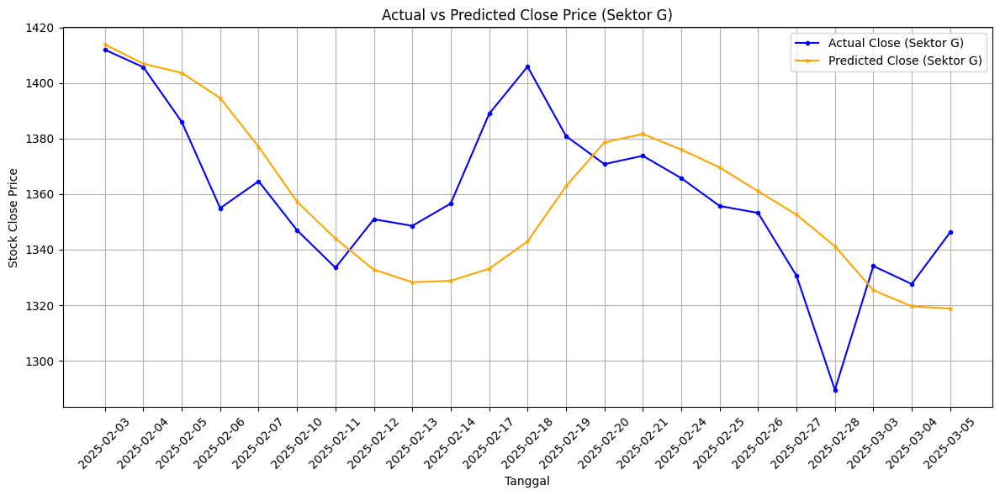

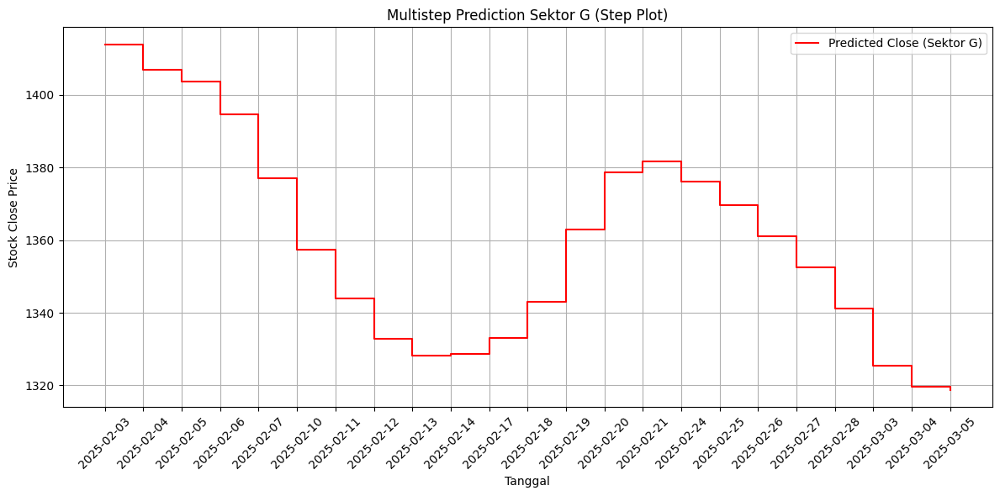

Head data prediksi Sektor G:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1413.878296      1411.965
1   2025-02-04     1406.920532      1405.702
2   2025-02-05     1403.659912      1385.990
3   2025-02-06     1394.588135      1354.928
4   2025-02-07     1377.040894      1364.633
5   2025-02-10     1357.260010      1346.979
6   2025-02-11     1343.975952      1333.492
7   2025-02-12     1332.802002      1350.947
8   2025-02-13     1328.263794      1348.573
9   2025-02-14     1328.773682      1356.603
10  2025-02-17     1333.127441      1388.900
11  2025-02-18     1342.959961      1405.896
12  2025-02-19     1362.846802      1380.898
13  2025-02-20     1378.602173      1370.790
14  2025-02-21     1381.637817      1373.788
15  2025-02-24     1376.042847      1365.745
16  2025-02-25     1369.598755      1355.722
17  2025-02-26     1361.033325      1353.224
18  2025-02-27     1352.601807      1330.618
19  2025-02-28     1341.209229      1289.518
20  2025-03-03     1325.39

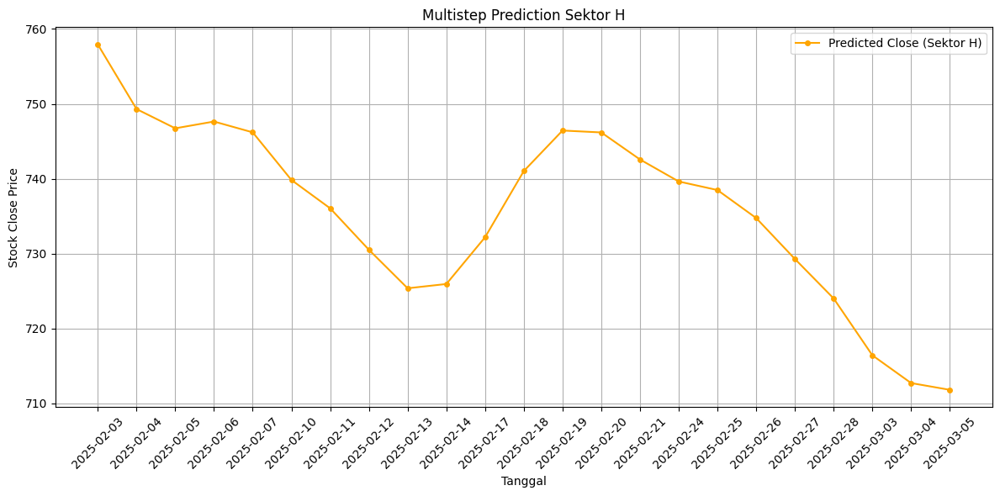

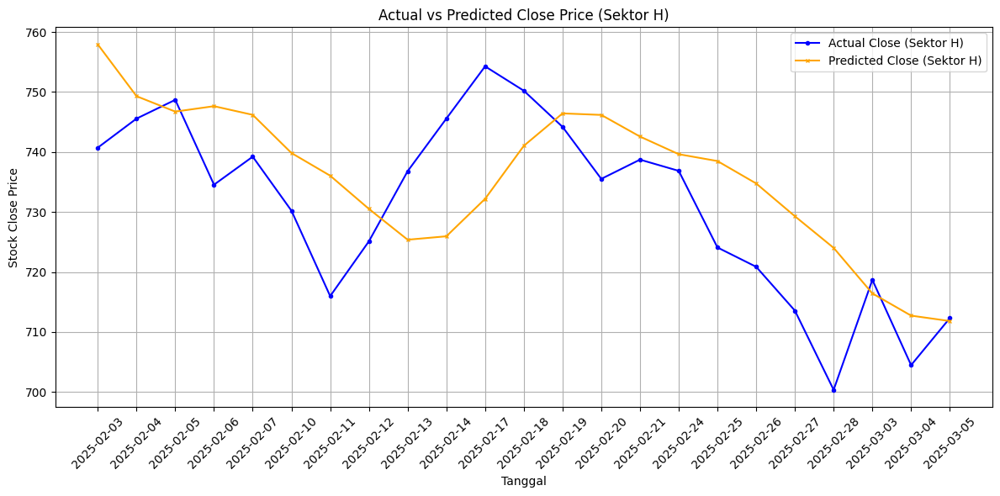

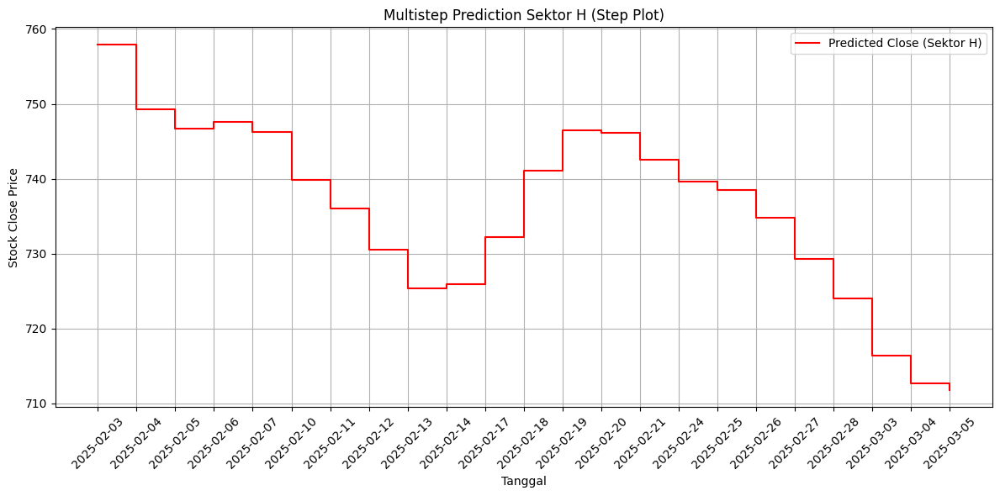

Head data prediksi Sektor H:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03      757.936096       740.733
1   2025-02-04      749.309998       745.577
2   2025-02-05      746.739929       748.702
3   2025-02-06      747.645752       734.554
4   2025-02-07      746.199585       739.227
5   2025-02-10      739.838379       730.220
6   2025-02-11      736.056335       715.981
7   2025-02-12      730.521973       725.116
8   2025-02-13      725.381653       736.806
9   2025-02-14      725.954041       745.577
10  2025-02-17      732.198792       754.284
11  2025-02-18      741.036377       750.223
12  2025-02-19      746.443542       744.195
13  2025-02-20      746.187988       735.526
14  2025-02-21      742.578796       738.733
15  2025-02-24      739.640015       736.862
16  2025-02-25      738.497070       724.090
17  2025-02-26      734.758850       720.868
18  2025-02-27      729.293274       713.554
19  2025-02-28      724.025513       700.356
20  2025-03-03      716.43

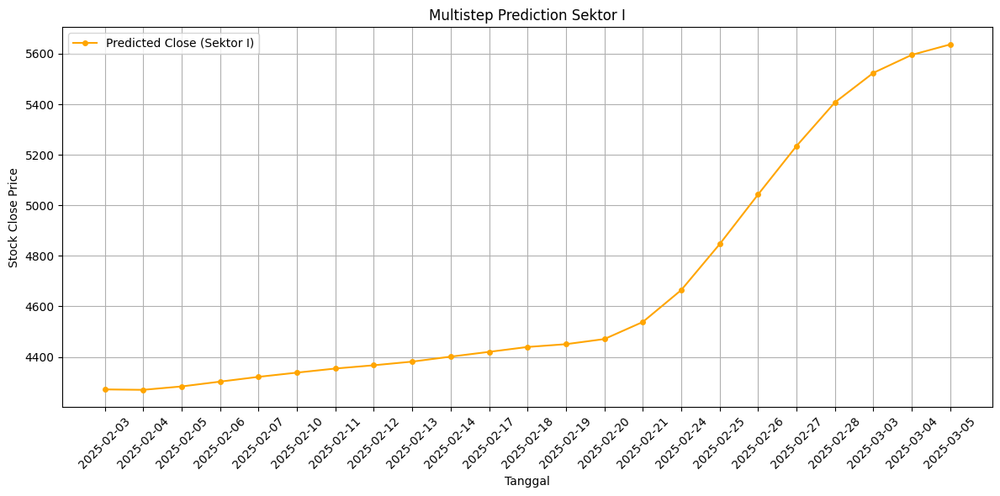

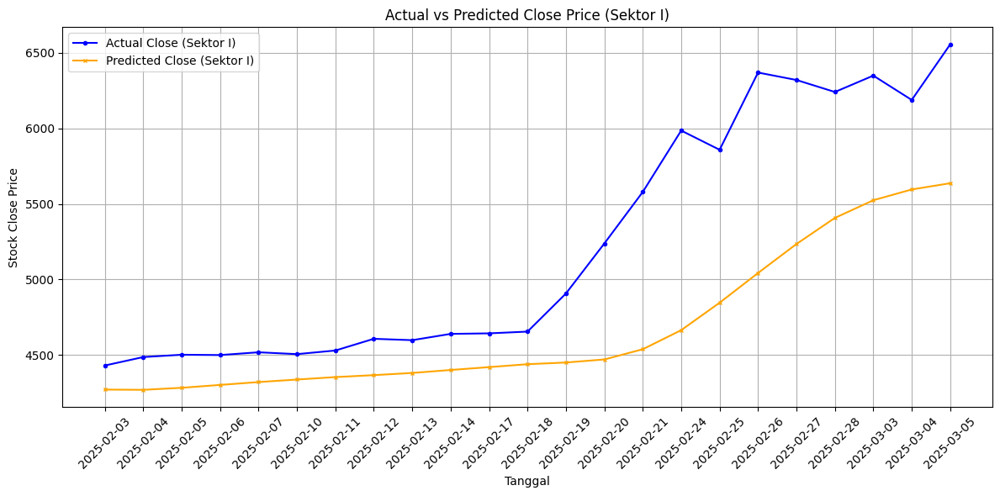

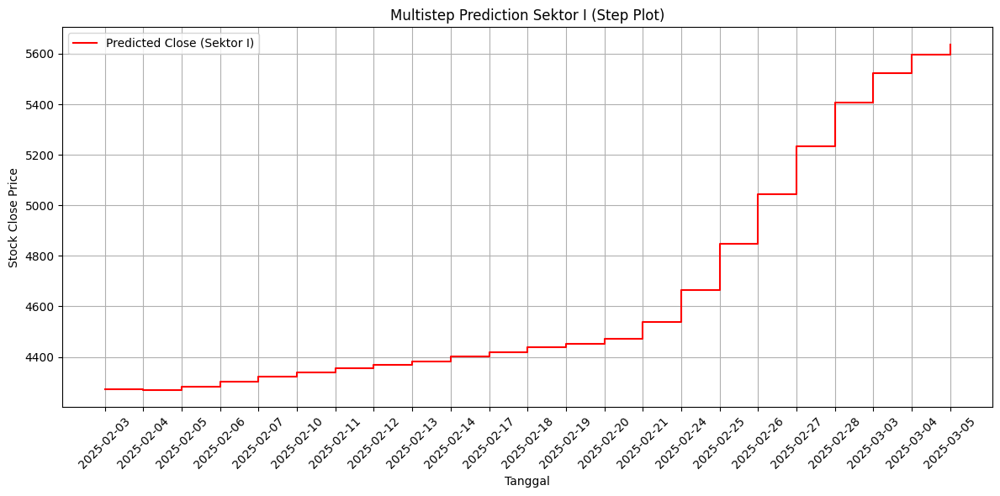

Head data prediksi Sektor I:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     4271.288086      4430.545
1   2025-02-04     4269.613770      4486.468
2   2025-02-05     4283.088867      4501.871
3   2025-02-06     4302.112793      4499.804
4   2025-02-07     4321.003906      4518.117
5   2025-02-10     4337.720703      4505.906
6   2025-02-11     4353.923340      4529.791
7   2025-02-12     4366.849609      4607.295
8   2025-02-13     4381.277344      4598.270
9   2025-02-14     4401.000488      4639.788
10  2025-02-17     4419.903809      4643.386
11  2025-02-18     4439.227051      4654.914
12  2025-02-19     4450.336914      4907.013
13  2025-02-20     4470.604980      5238.179
14  2025-02-21     4538.166016      5579.057
15  2025-02-24     4664.407715      5985.232
16  2025-02-25     4846.124512      5858.077
17  2025-02-26     5042.683594      6369.119
18  2025-02-27     5234.587402      6319.917
19  2025-02-28     5407.258301      6240.565
20  2025-03-03     5524.16

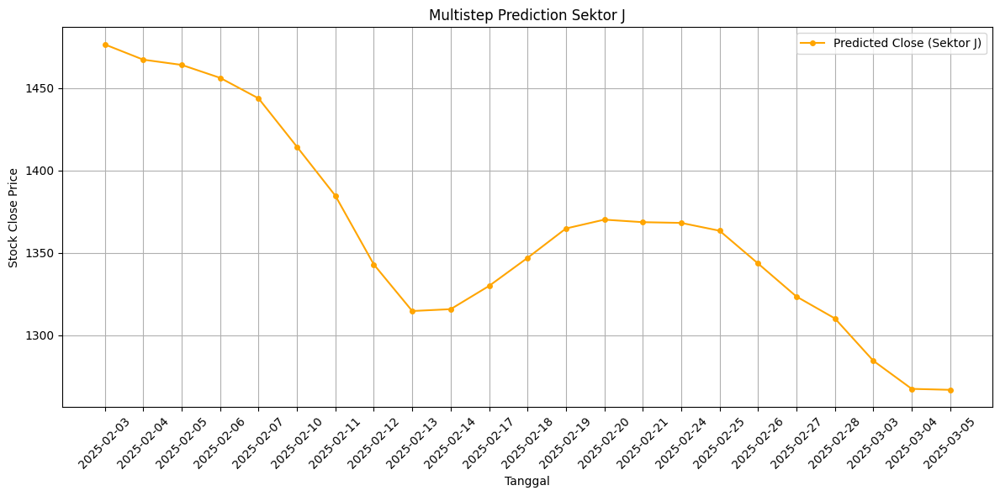

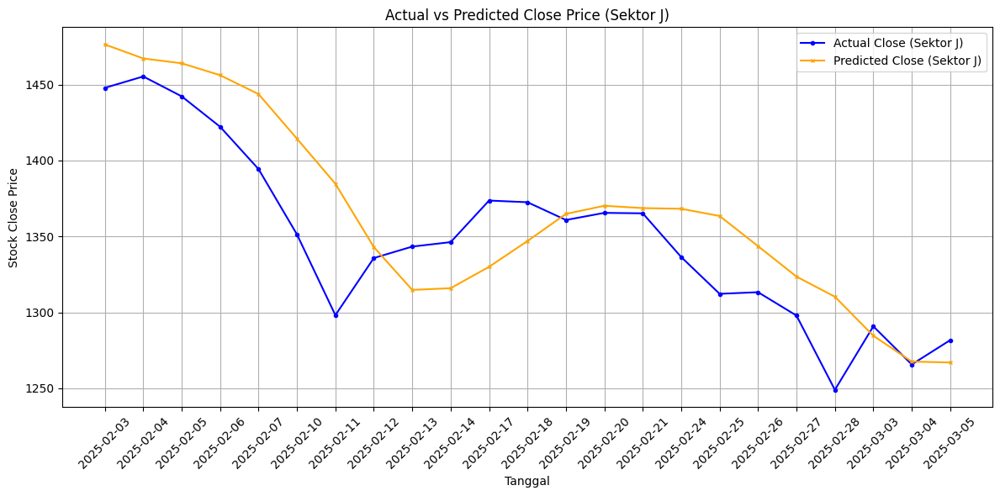

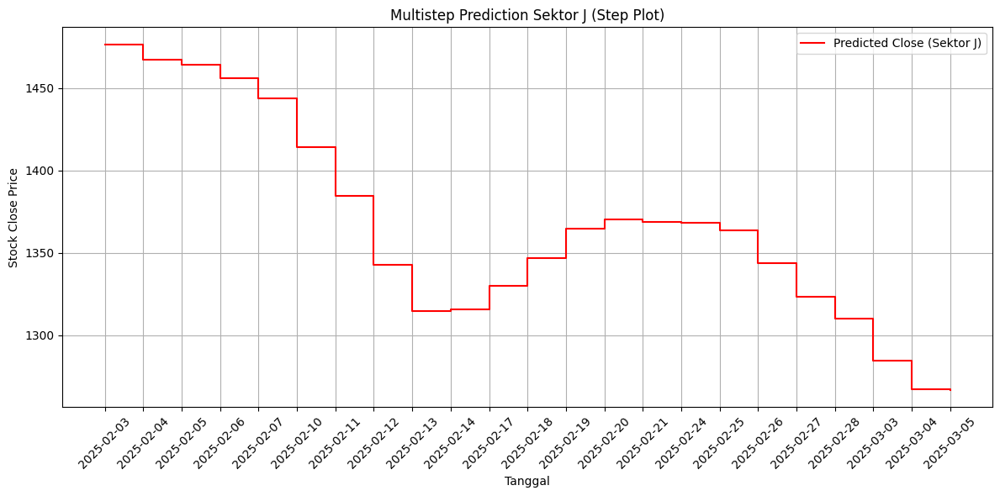

Head data prediksi Sektor J:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1476.449097      1447.861
1   2025-02-04     1467.217163      1455.366
2   2025-02-05     1464.044312      1442.265
3   2025-02-06     1456.194580      1422.231
4   2025-02-07     1443.748047      1394.348
5   2025-02-10     1414.388672      1351.312
6   2025-02-11     1384.679443      1298.132
7   2025-02-12     1343.022827      1335.760
8   2025-02-13     1314.764038      1343.301
9   2025-02-14     1315.890869      1346.242
10  2025-02-17     1329.986938      1373.634
11  2025-02-18     1346.987427      1372.521
12  2025-02-19     1364.822754      1360.822
13  2025-02-20     1370.187744      1365.518
14  2025-02-21     1368.657593      1365.212
15  2025-02-24     1368.210571      1336.422
16  2025-02-25     1363.453369      1312.190
17  2025-02-26     1343.593506      1313.262
18  2025-02-27     1323.538940      1297.882
19  2025-02-28     1310.277100      1248.948
20  2025-03-03     1284.59

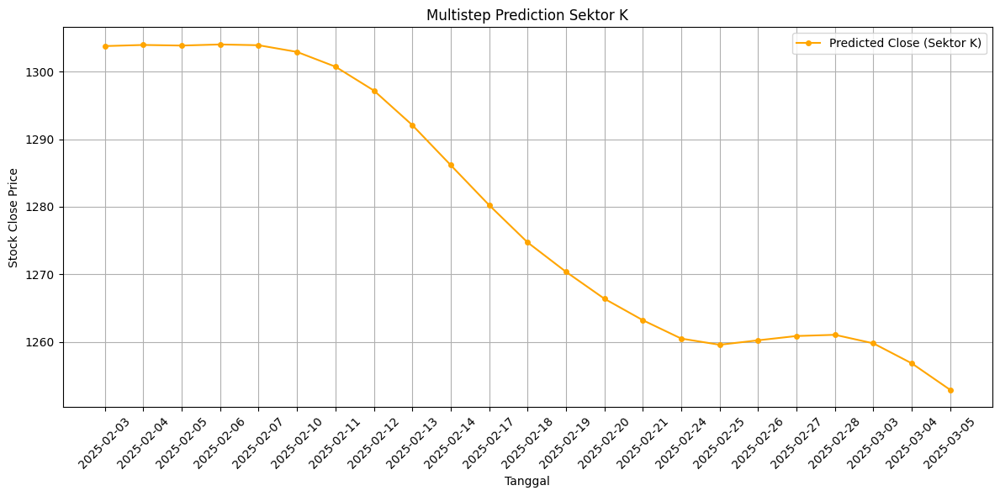

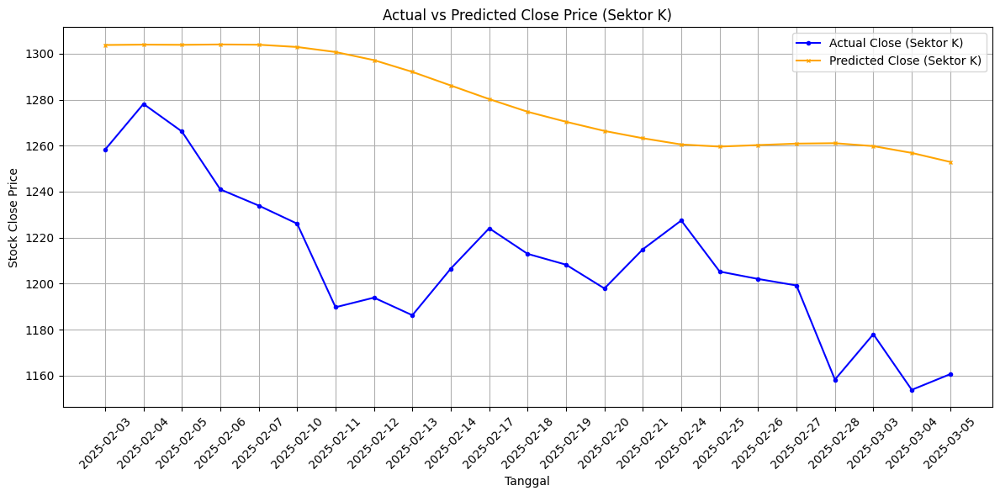

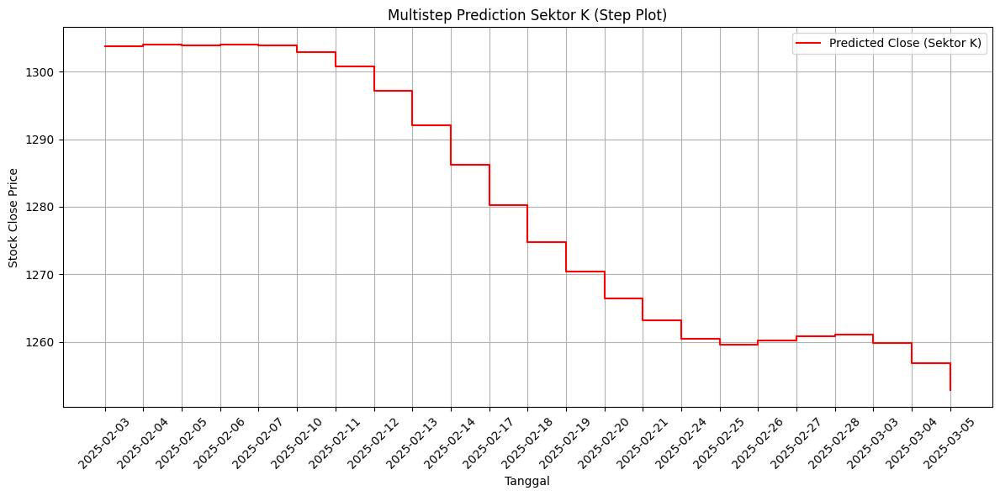

Head data prediksi Sektor K:
       Tanggal  Nilai_Prediksi  Nilai_Aktual
0   2025-02-03     1303.764893      1258.244
1   2025-02-04     1303.931396      1278.147
2   2025-02-05     1303.841919      1266.166
3   2025-02-06     1304.005005      1240.981
4   2025-02-07     1303.889282      1233.936
5   2025-02-10     1302.901123      1226.077
6   2025-02-11     1300.716919      1189.726
7   2025-02-12     1297.187622      1193.900
8   2025-02-13     1292.080688      1186.247
9   2025-02-14     1286.158081      1206.508
10  2025-02-17     1280.239380      1224.061
11  2025-02-18     1274.732788      1212.942
12  2025-02-19     1270.379028      1208.235
13  2025-02-20     1266.396973      1197.896
14  2025-02-21     1263.221436      1214.936
15  2025-02-24     1260.502075      1227.452
16  2025-02-25     1259.586060      1205.242
17  2025-02-26     1260.246094      1202.027
18  2025-02-27     1260.879883      1199.188
19  2025-02-28     1261.059448      1158.248
20  2025-03-03     1259.79

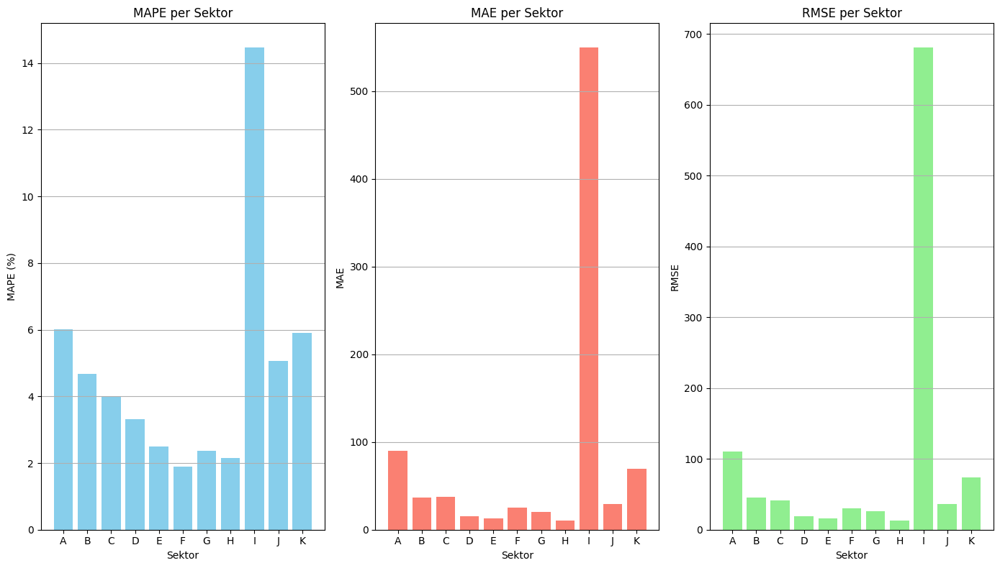

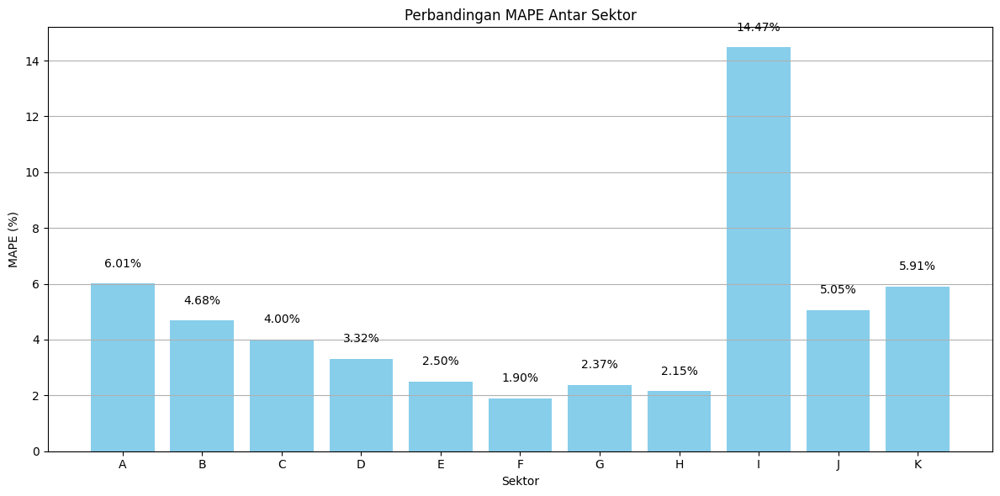

In [53]:
# CONVO
import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_conv.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()


PROCESSING SEKTOR A


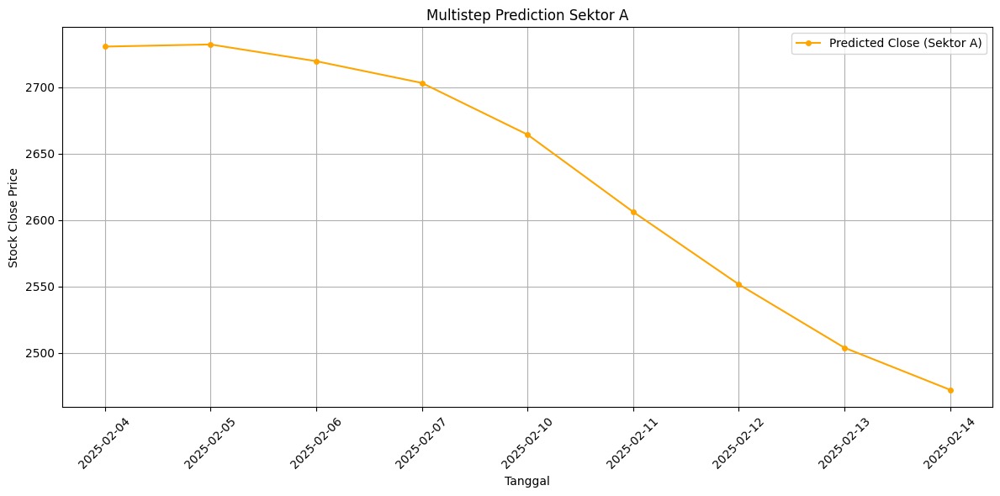

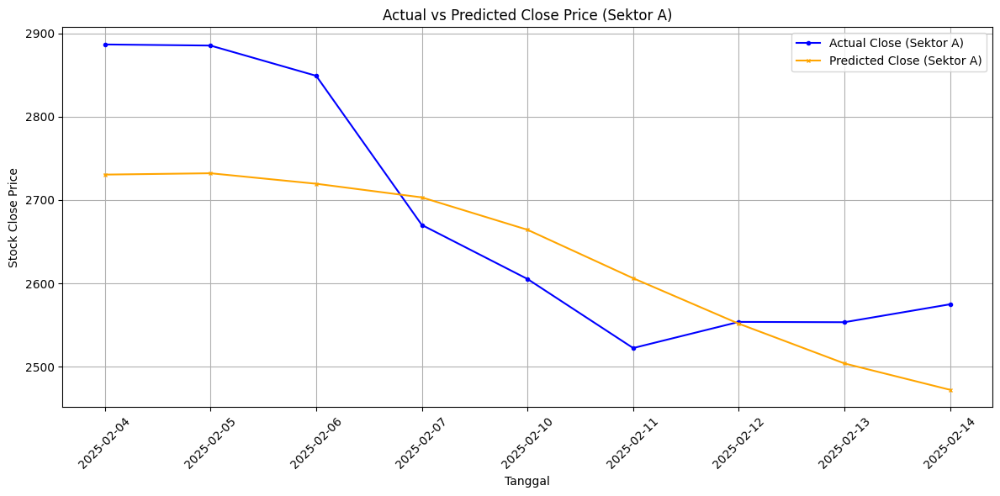

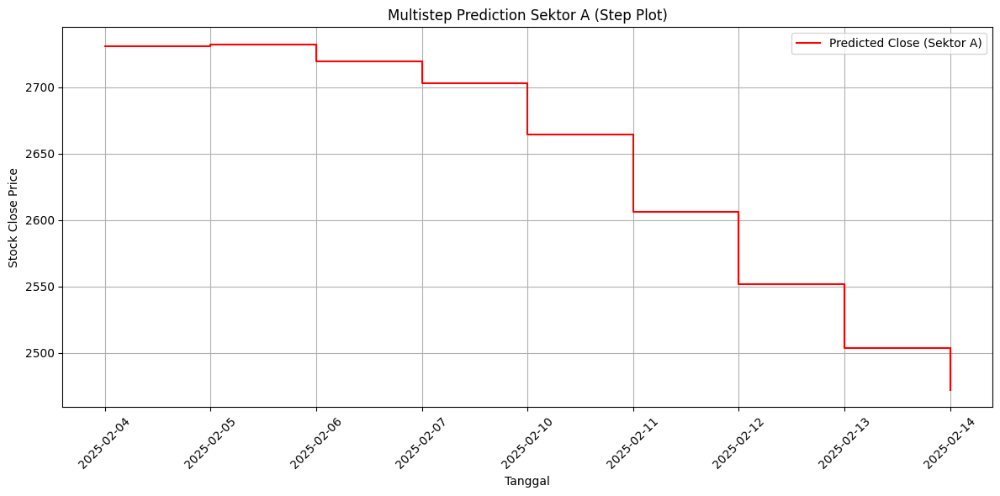

Head data prediksi Sektor A:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     2730.577637      2886.815
1  2025-02-05     2732.181885      2885.488
2  2025-02-06     2719.592041      2849.183
3  2025-02-07     2703.210938      2670.111
4  2025-02-10     2664.327637      2605.239
5  2025-02-11     2606.151123      2522.332
6  2025-02-12     2551.548584      2553.726
7  2025-02-13     2503.836426      2553.363
8  2025-02-14     2472.169922      2574.895
Evaluasi Model Sektor A:
MAE: 85.51
RMSE: 99.63
MAPE: 5.46%

PROCESSING SEKTOR B


<ipython-input-22-37f7d47e1be6>:127: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


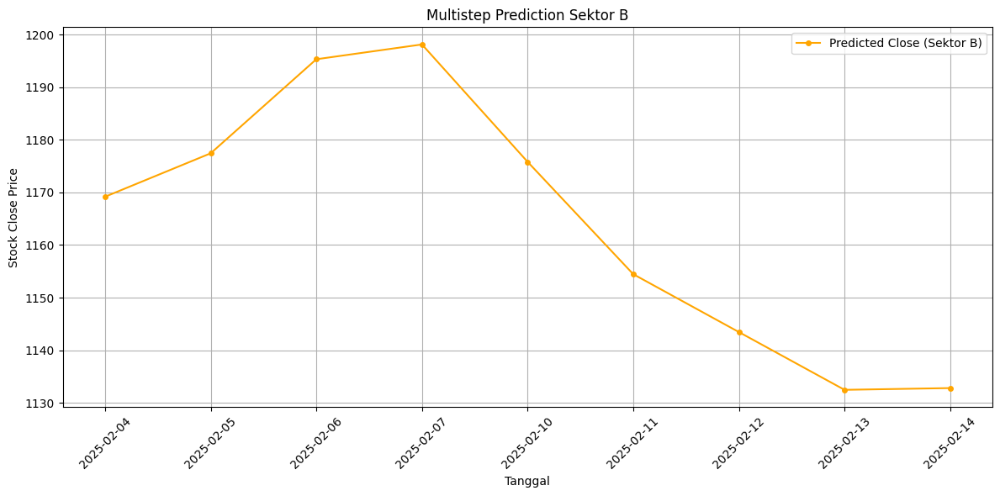

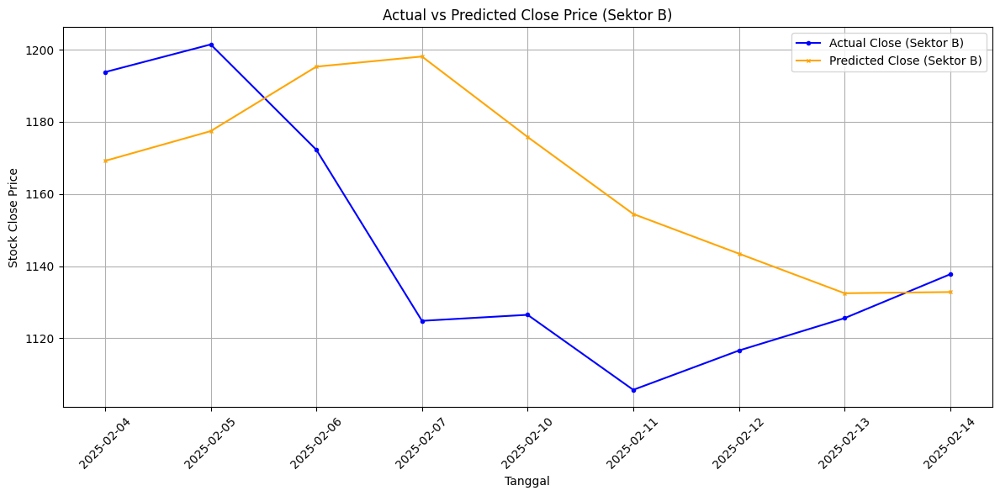

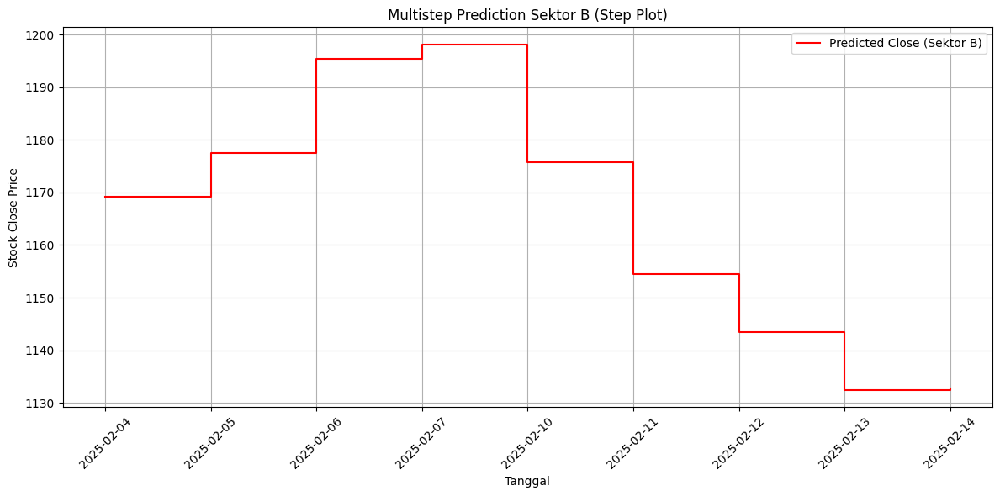

Head data prediksi Sektor B:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1169.181885      1193.817
1  2025-02-05     1177.442871      1201.485
2  2025-02-06     1195.327271      1172.273
3  2025-02-07     1198.140015      1124.812
4  2025-02-10     1175.820312      1126.481
5  2025-02-11     1154.458008      1105.669
6  2025-02-12     1143.453491      1116.570
7  2025-02-13     1132.466431      1125.552
8  2025-02-14     1132.800293      1137.731
Evaluasi Model Sektor B:
MAE: 31.32
RMSE: 37.57
MAPE: 3.32%

PROCESSING SEKTOR C


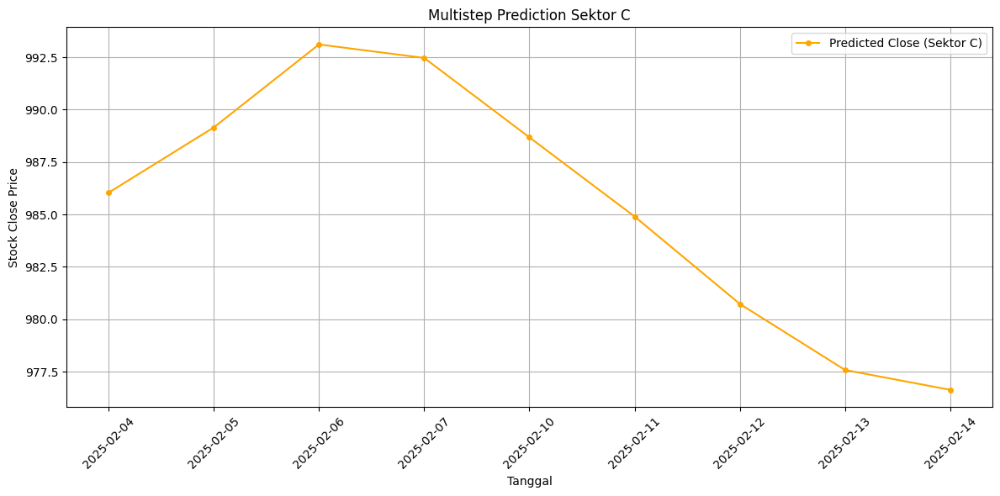

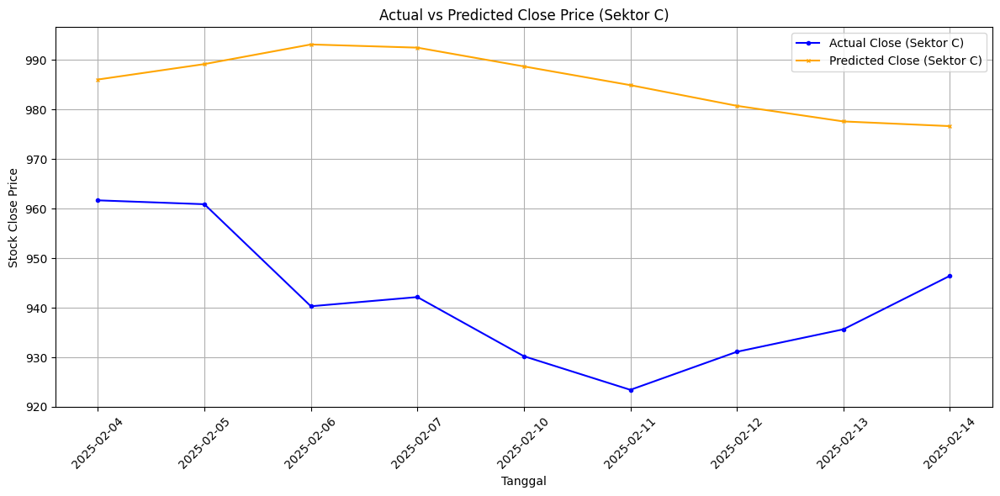

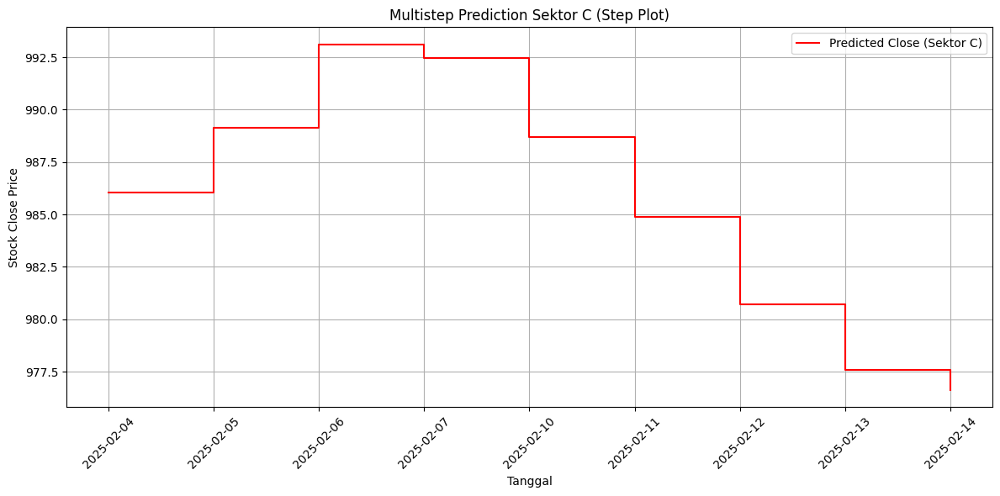

Head data prediksi Sektor C:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      986.035583       961.663
1  2025-02-05      989.148743       960.880
2  2025-02-06      993.109436       940.296
3  2025-02-07      992.467041       942.151
4  2025-02-10      988.679565       930.218
5  2025-02-11      984.900696       923.437
6  2025-02-12      980.732910       931.112
7  2025-02-13      977.581543       935.644
8  2025-02-14      976.635437       946.430
Evaluasi Model Sektor C:
MAE: 44.16
RMSE: 46.00
MAPE: 4.71%

PROCESSING SEKTOR D


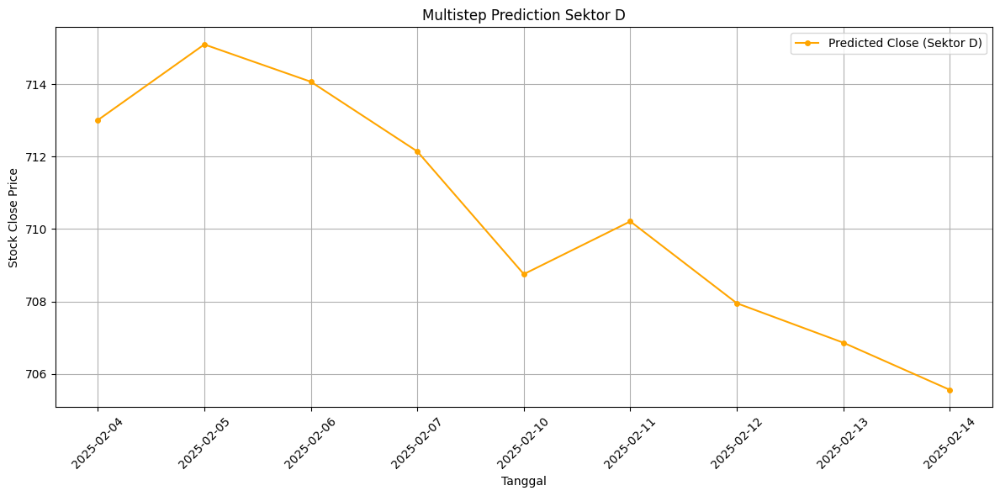

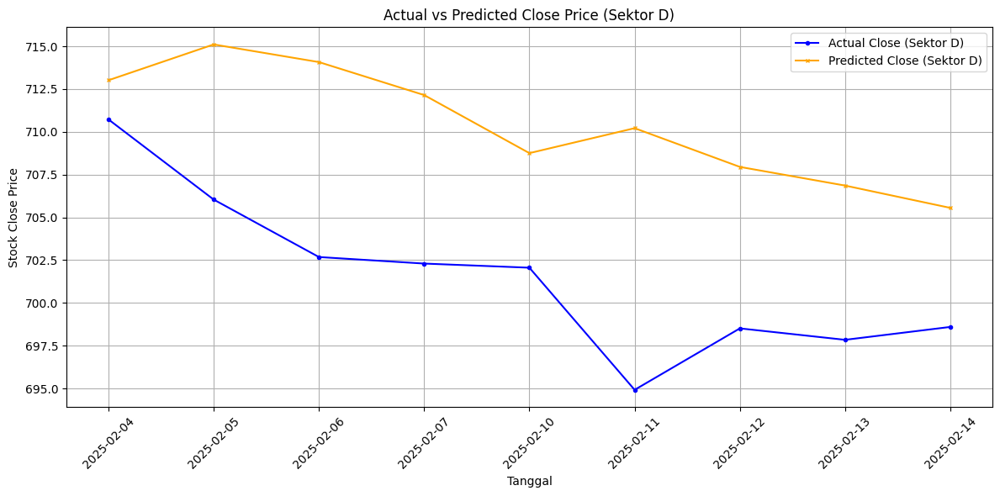

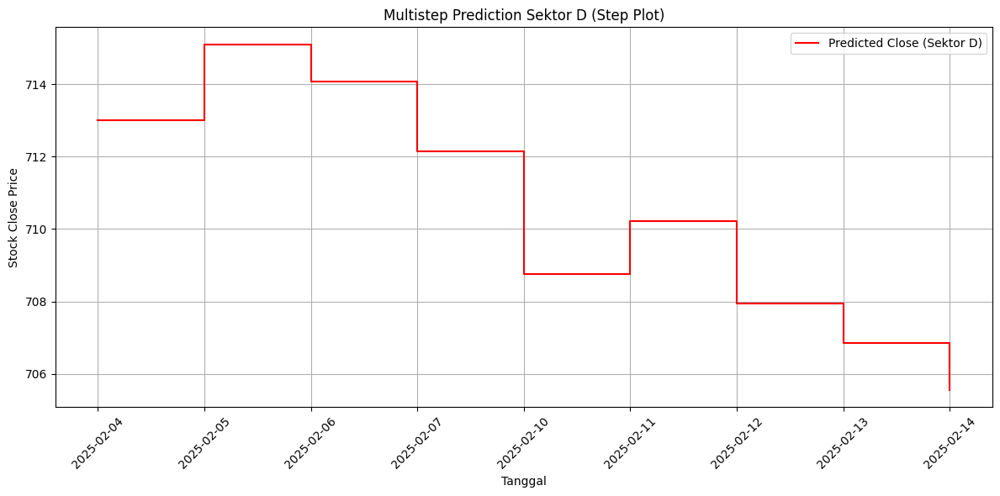

Head data prediksi Sektor D:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      713.013550       710.725
1  2025-02-05      715.105835       706.041
2  2025-02-06      714.075317       702.683
3  2025-02-07      712.147766       702.301
4  2025-02-10      708.754456       702.059
5  2025-02-11      710.212891       694.922
6  2025-02-12      707.949768       698.513
7  2025-02-13      706.858704       697.845
8  2025-02-14      705.554688       698.598
Evaluasi Model Sektor D:
MAE: 8.89
RMSE: 9.50
MAPE: 1.32%

PROCESSING SEKTOR E


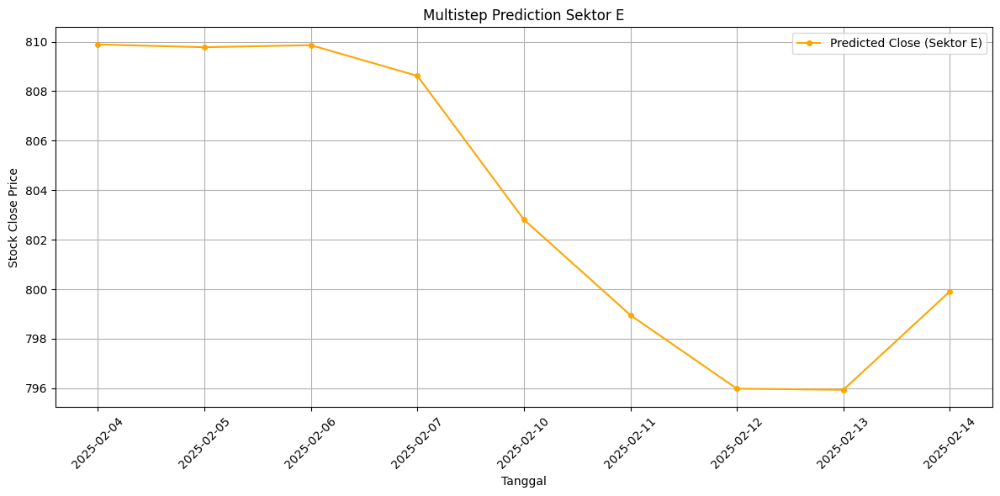

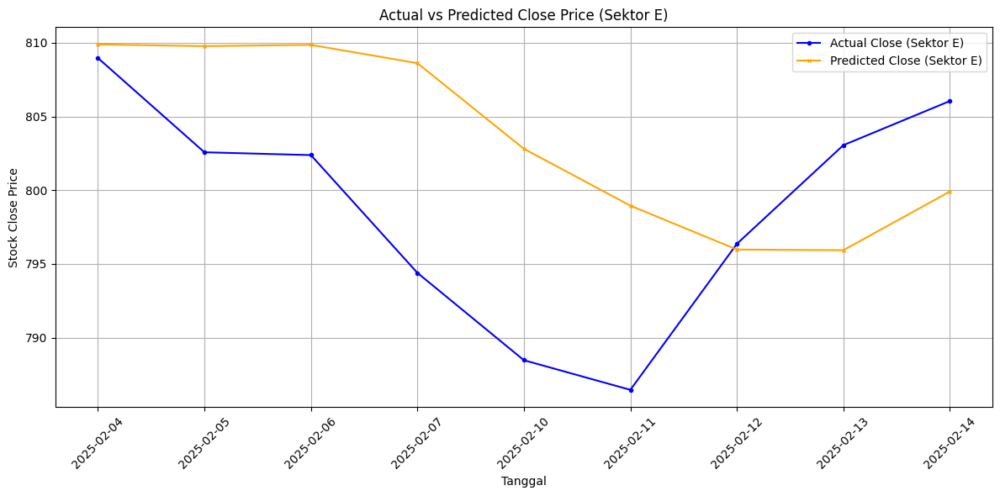

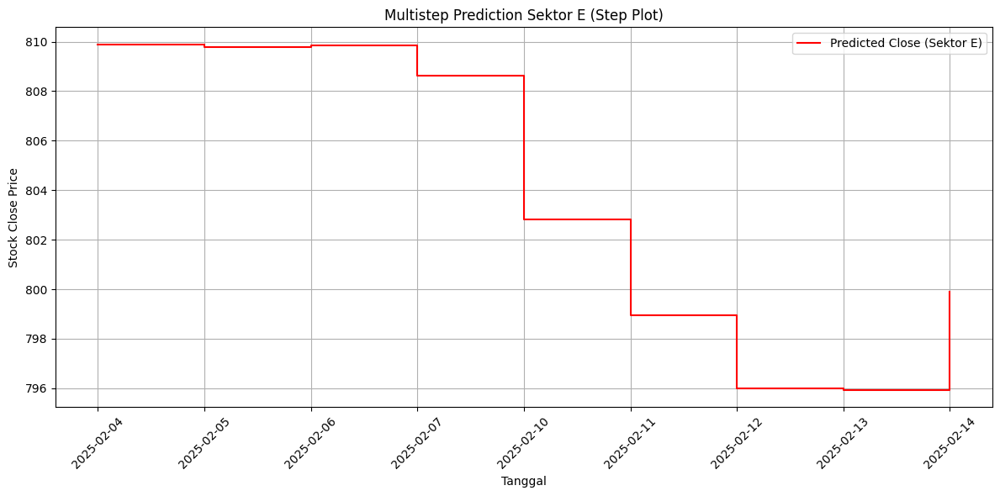

Head data prediksi Sektor E:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      809.888855       808.971
1  2025-02-05      809.777527       802.576
2  2025-02-06      809.860840       802.384
3  2025-02-07      808.619873       794.398
4  2025-02-10      802.813110       788.472
5  2025-02-11      798.954529       786.462
6  2025-02-12      795.980103       796.363
7  2025-02-13      795.933655       803.057
8  2025-02-14      799.909546       806.050
Evaluasi Model Sektor E:
MAE: 7.81
RMSE: 9.20
MAPE: 1.06%

PROCESSING SEKTOR F


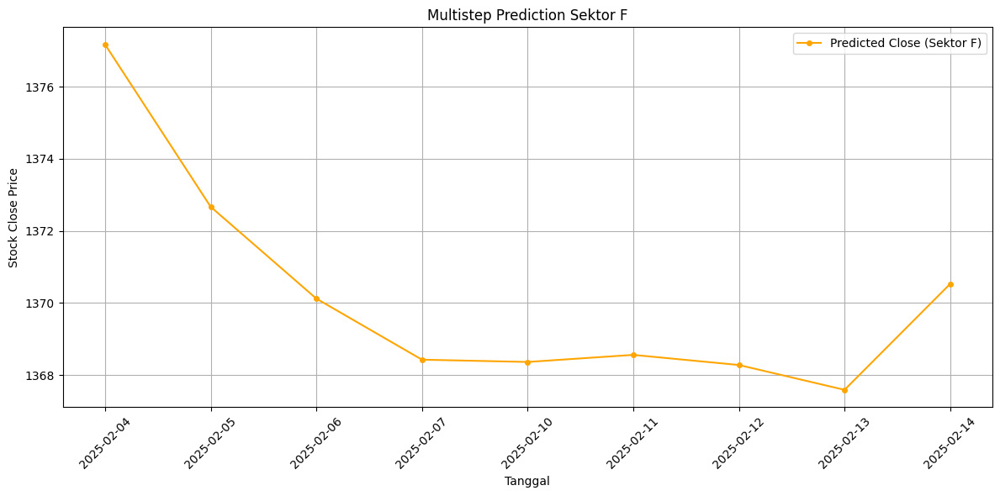

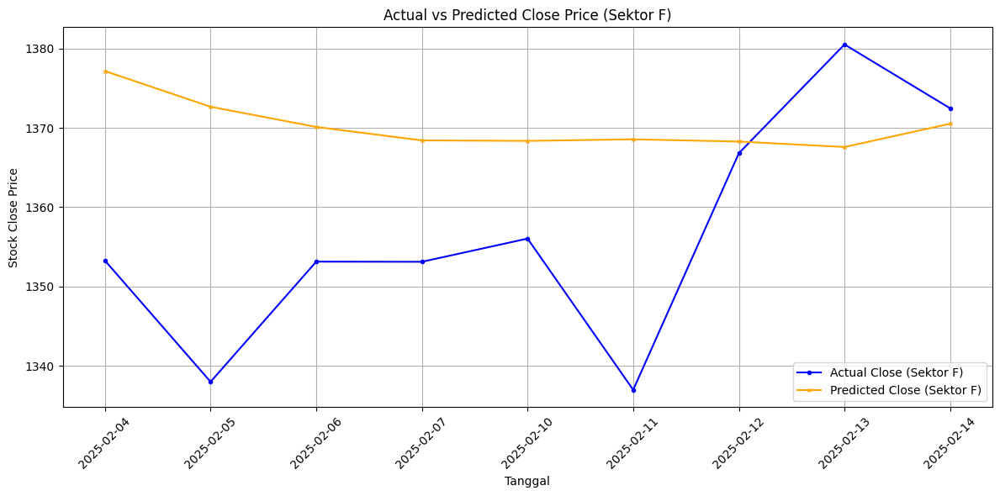

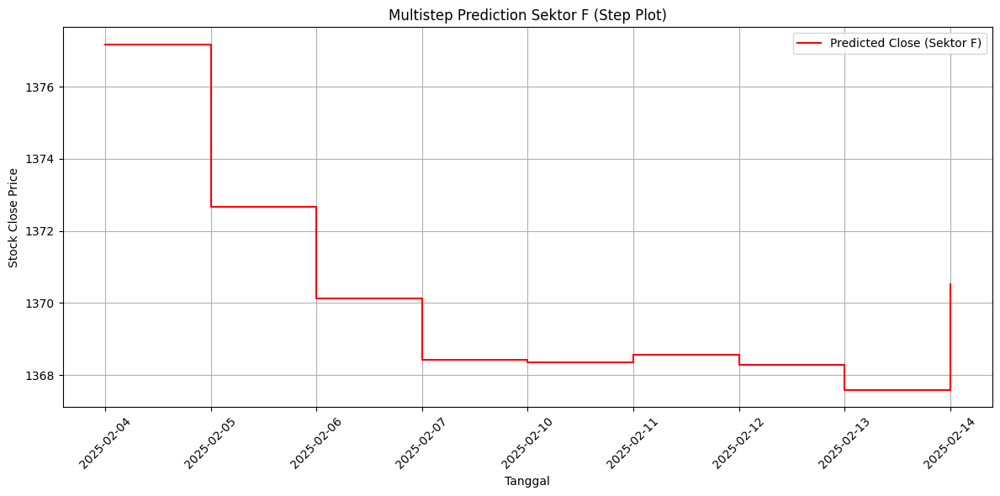

Head data prediksi Sektor F:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1377.168823      1353.266
1  2025-02-05     1372.666504      1337.978
2  2025-02-06     1370.121338      1353.134
3  2025-02-07     1368.426880      1353.114
4  2025-02-10     1368.363647      1356.040
5  2025-02-11     1368.559937      1336.965
6  2025-02-12     1368.279419      1366.806
7  2025-02-13     1367.590576      1380.525
8  2025-02-14     1370.528809      1372.470
Evaluasi Model Sektor F:
MAE: 16.80
RMSE: 20.06
MAPE: 1.22%

PROCESSING SEKTOR G


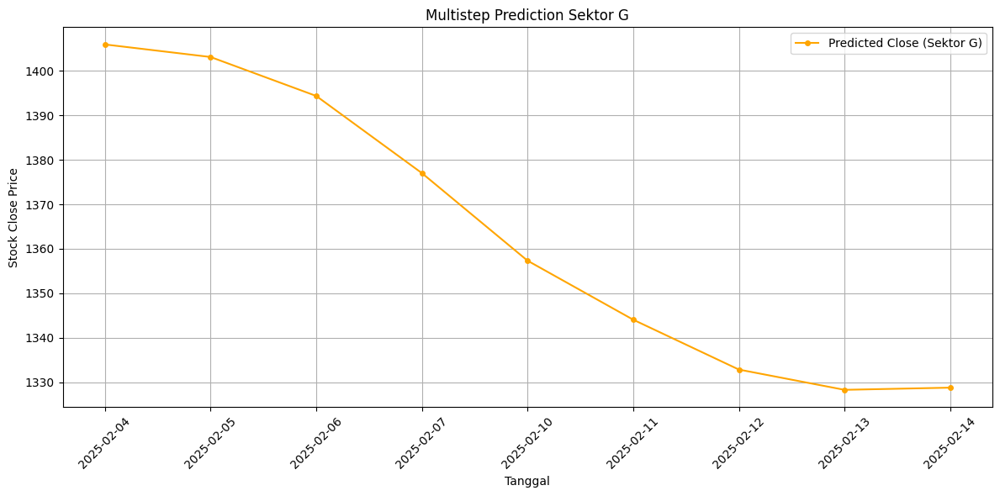

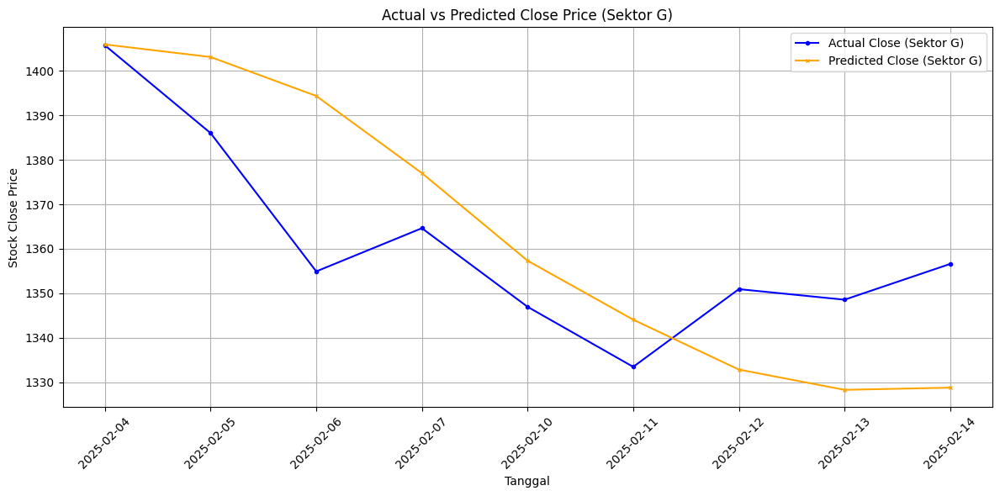

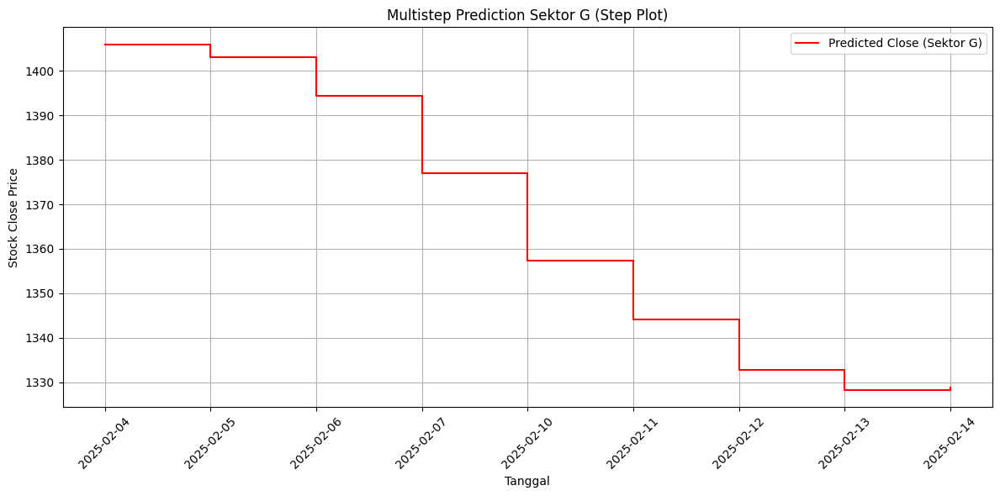

Head data prediksi Sektor G:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1405.905396      1405.702
1  2025-02-05     1403.085083      1385.990
2  2025-02-06     1394.335815      1354.928
3  2025-02-07     1377.006104      1364.633
4  2025-02-10     1357.337036      1346.979
5  2025-02-11     1344.083252      1333.492
6  2025-02-12     1332.881714      1350.947
7  2025-02-13     1328.327759      1348.573
8  2025-02-14     1328.817261      1356.603
Evaluasi Model Sektor G:
MAE: 17.35
RMSE: 20.35
MAPE: 2.24%

PROCESSING SEKTOR H


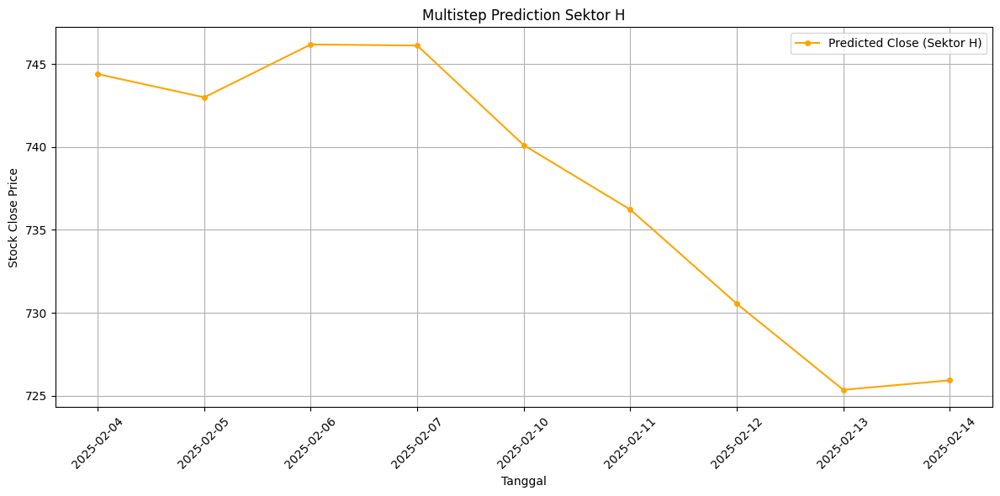

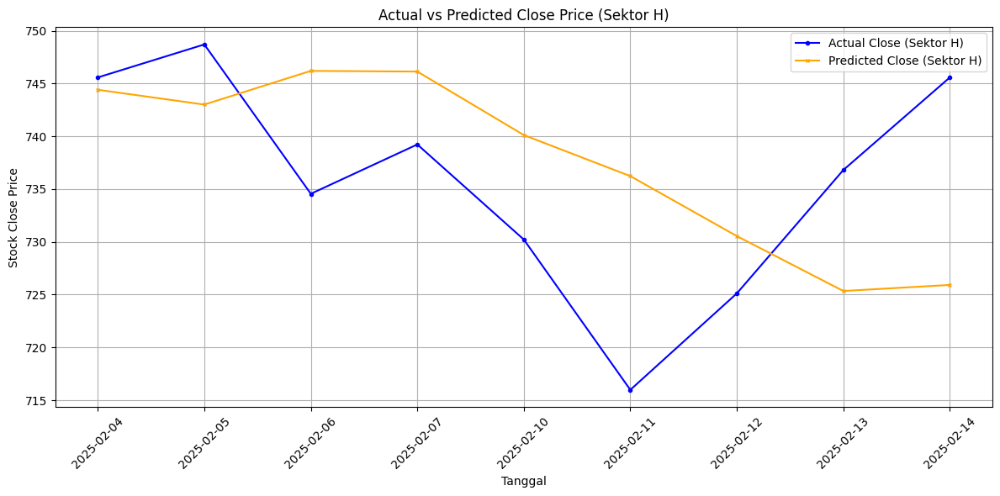

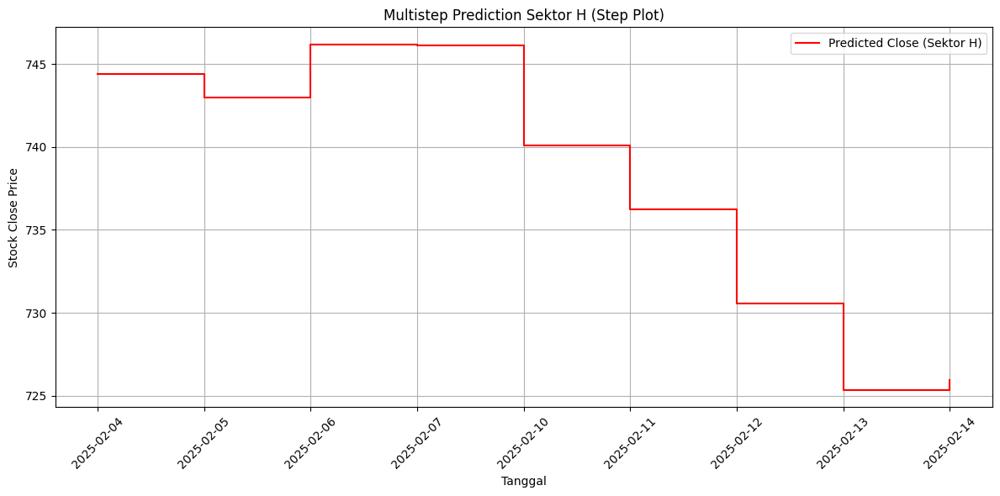

Head data prediksi Sektor H:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04      744.409424       745.577
1  2025-02-05      743.005188       748.702
2  2025-02-06      746.198364       734.554
3  2025-02-07      746.132812       739.227
4  2025-02-10      740.117188       730.220
5  2025-02-11      736.229187       715.981
6  2025-02-12      730.546326       725.116
7  2025-02-13      725.344849       736.806
8  2025-02-14      725.918884       745.577
Evaluasi Model Sektor H:
MAE: 10.23
RMSE: 11.89
MAPE: 1.41%

PROCESSING SEKTOR I


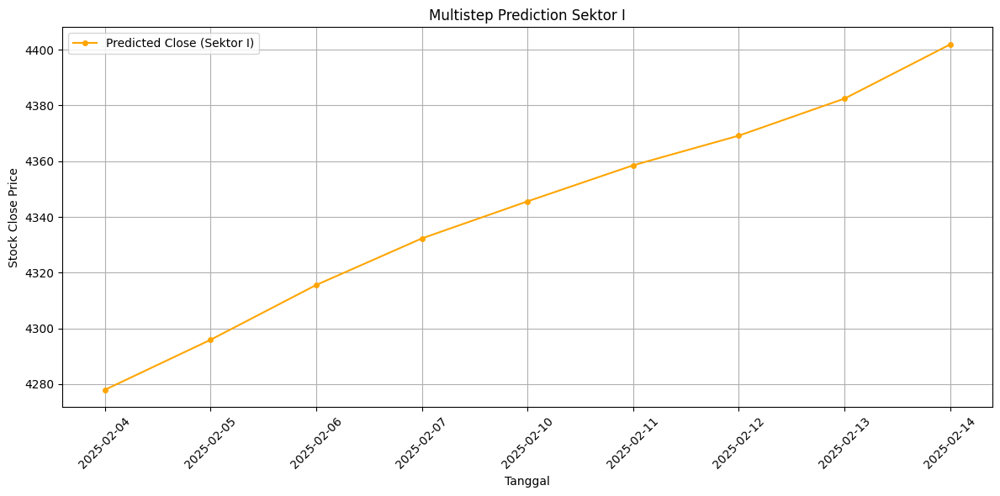

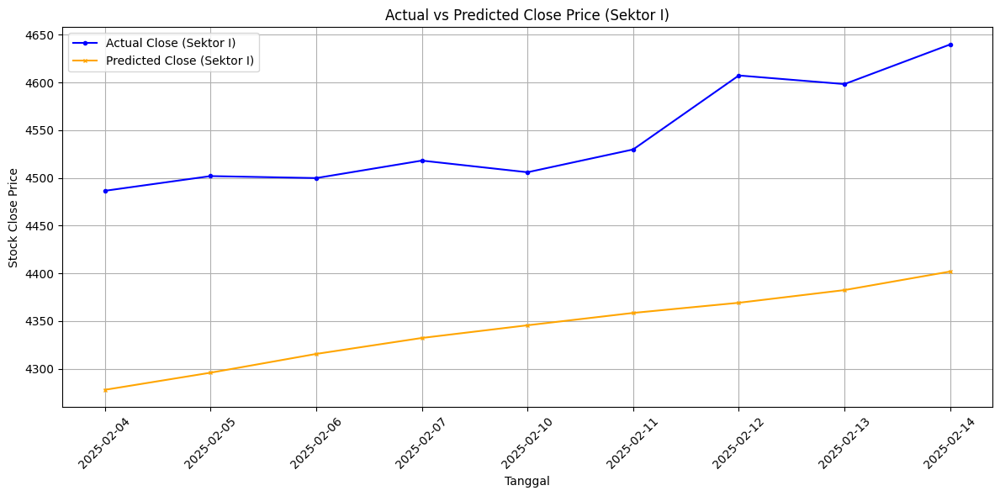

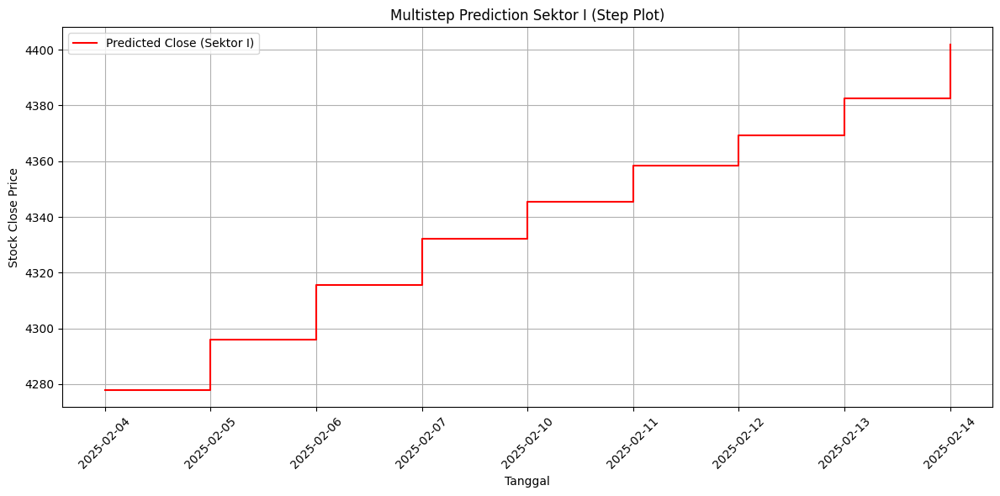

Head data prediksi Sektor I:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     4277.958984      4486.468
1  2025-02-05     4295.909180      4501.871
2  2025-02-06     4315.577148      4499.804
3  2025-02-07     4332.294434      4518.117
4  2025-02-10     4345.593262      4505.906
5  2025-02-11     4358.531738      4529.791
6  2025-02-12     4369.176270      4607.295
7  2025-02-13     4382.470215      4598.270
8  2025-02-14     4401.898926      4639.788
Evaluasi Model Sektor I:
MAE: 200.88
RMSE: 202.56
MAPE: 4.41%

PROCESSING SEKTOR J


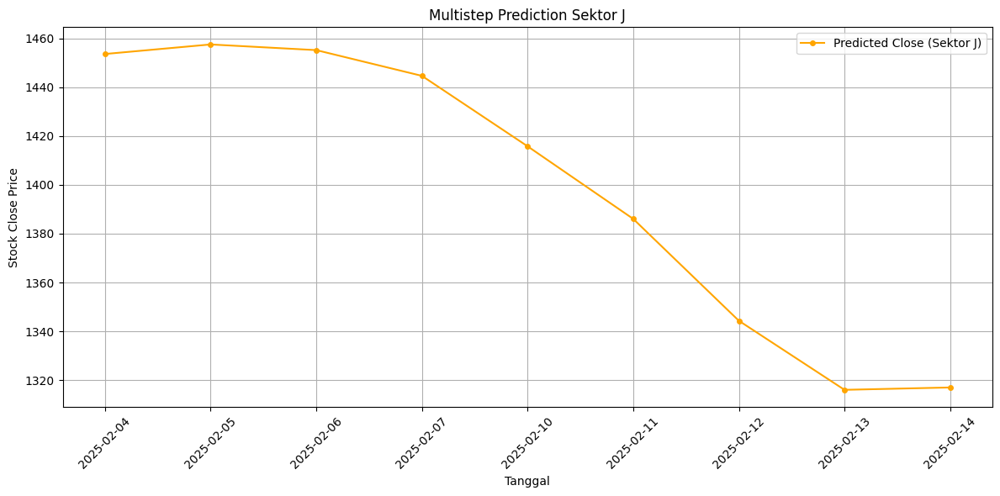

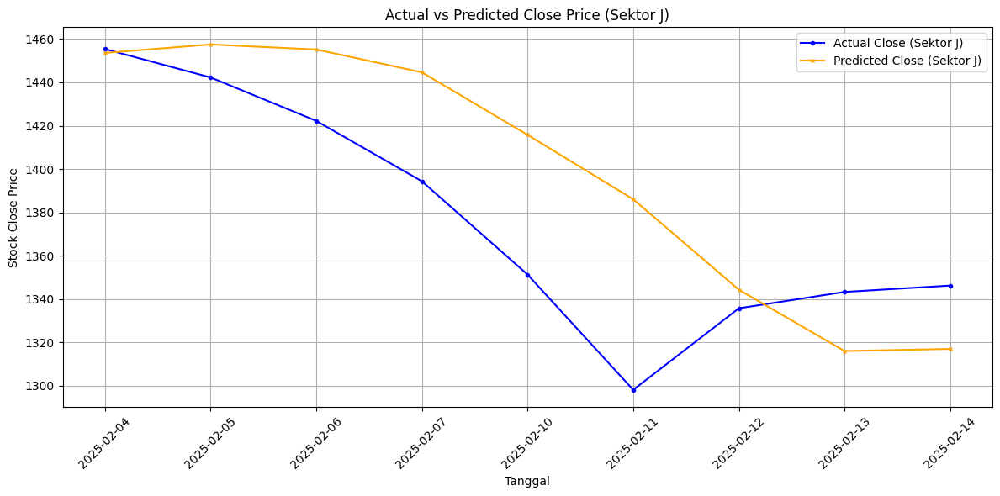

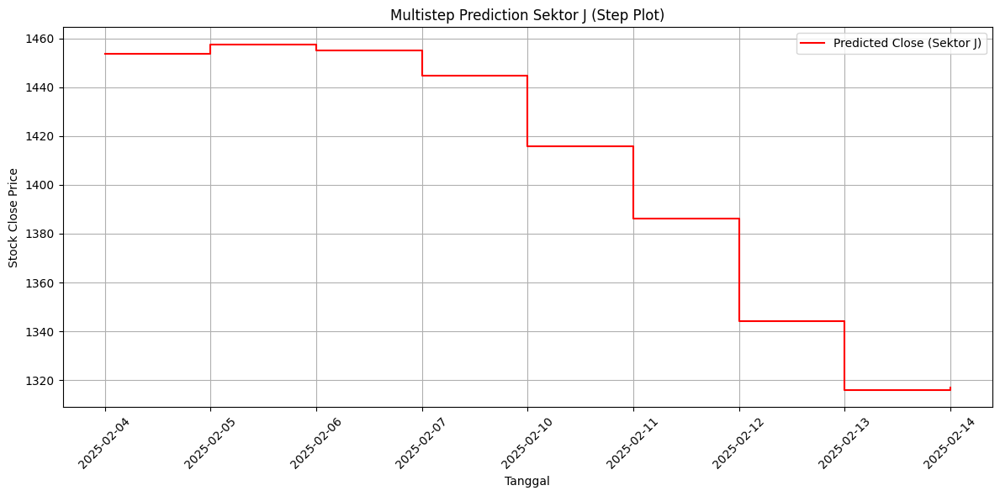

Head data prediksi Sektor J:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1453.572632      1455.366
1  2025-02-05     1457.479614      1442.265
2  2025-02-06     1455.160889      1422.231
3  2025-02-07     1444.622437      1394.348
4  2025-02-10     1415.783936      1351.312
5  2025-02-11     1386.050903      1298.132
6  2025-02-12     1344.325317      1335.760
7  2025-02-13     1316.033447      1343.301
8  2025-02-14     1317.001587      1346.242
Evaluasi Model Sektor J:
MAE: 35.30
RMSE: 43.98
MAPE: 4.74%

PROCESSING SEKTOR K


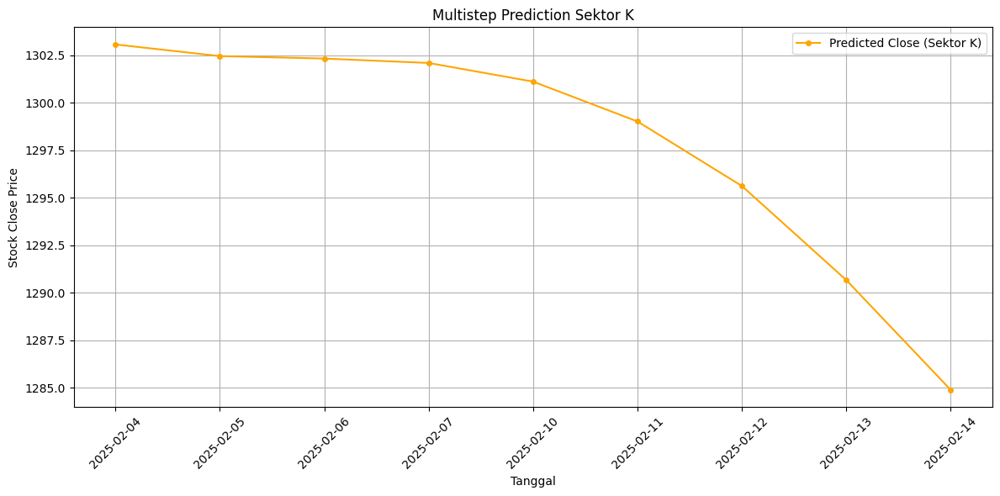

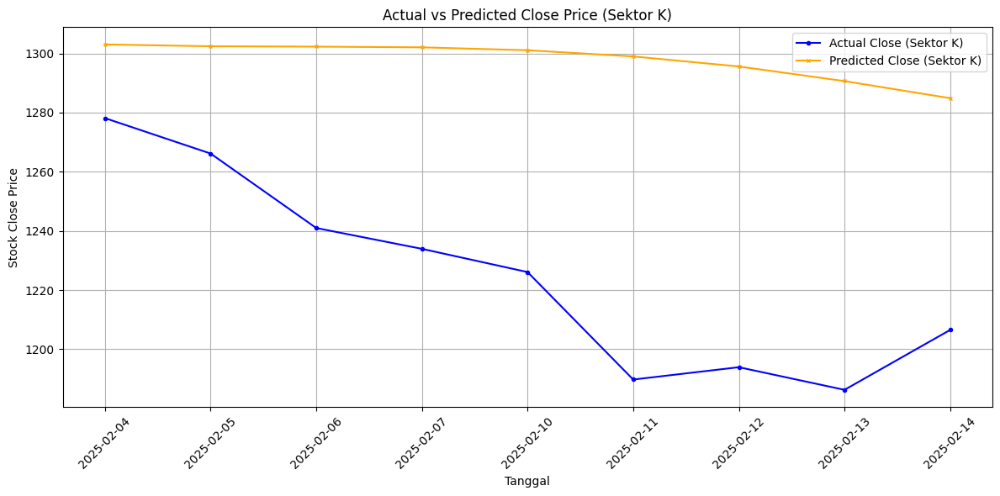

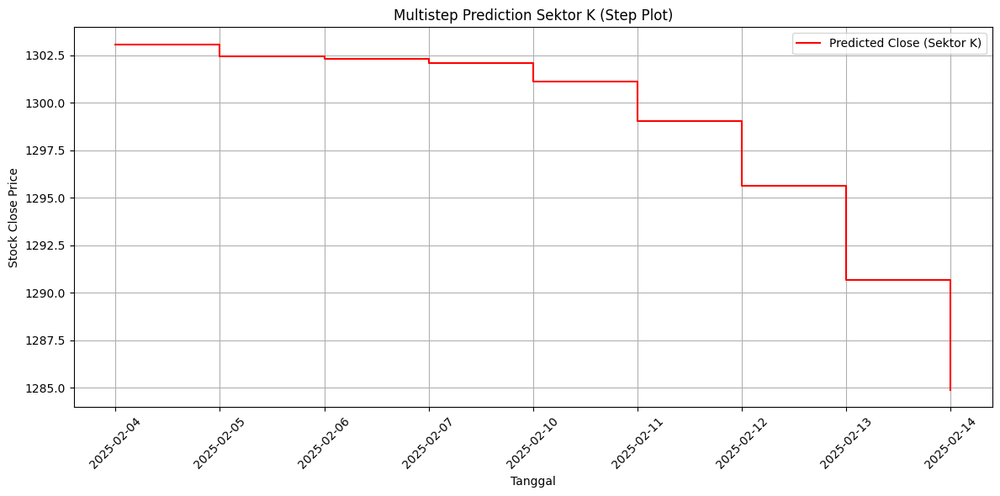

Head data prediksi Sektor K:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-04     1303.061646      1278.147
1  2025-02-05     1302.448242      1266.166
2  2025-02-06     1302.319458      1240.981
3  2025-02-07     1302.087402      1233.936
4  2025-02-10     1301.106567      1226.077
5  2025-02-11     1299.010376      1189.726
6  2025-02-12     1295.615601      1193.900
7  2025-02-13     1290.664917      1186.247
8  2025-02-14     1284.888550      1206.508
Evaluasi Model Sektor K:
MAE: 73.28
RMSE: 78.39
MAPE: 6.05%

Hasil Evaluasi Semua Sektor:
   Sektor         MAE        RMSE      MAPE
0       A   85.507911   99.626791  5.462313
1       B   31.324053   37.569178  3.320370
2       C   44.162217   45.998803  4.709875
3       D    8.887330    9.495542  1.322374
4       E    7.810937    9.196580  1.063617
5       F   16.795463   20.058365  1.216733
6       G   17.347217   20.347230  2.244274
7       H   10.234392   11.889910  1.412528
8       I  200.877760  202.555078  4.408658
9

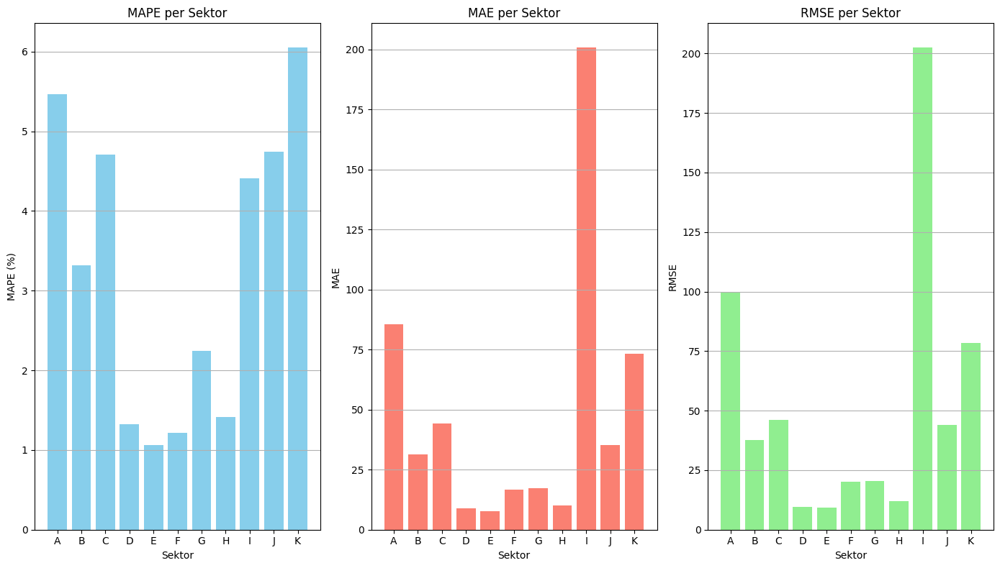

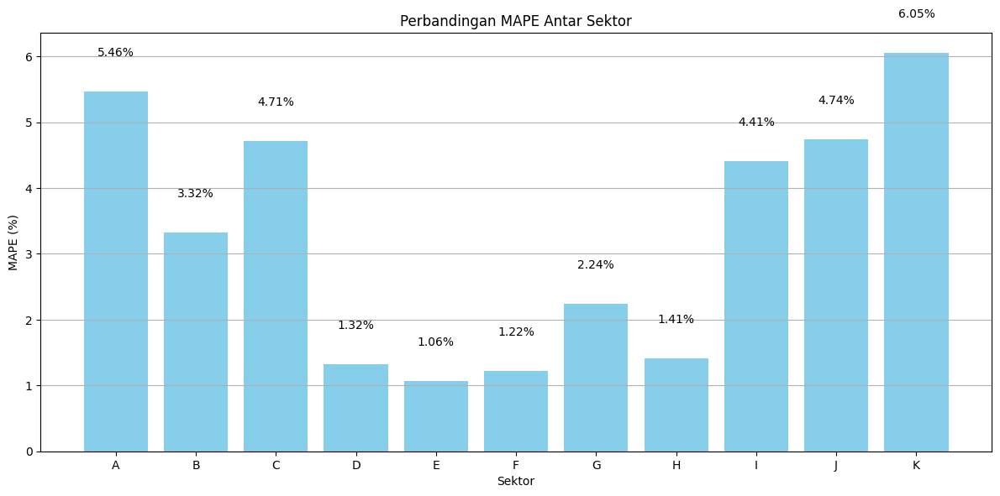

In [22]:
# CONVO
import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_conv.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()


PROCESSING SEKTOR A


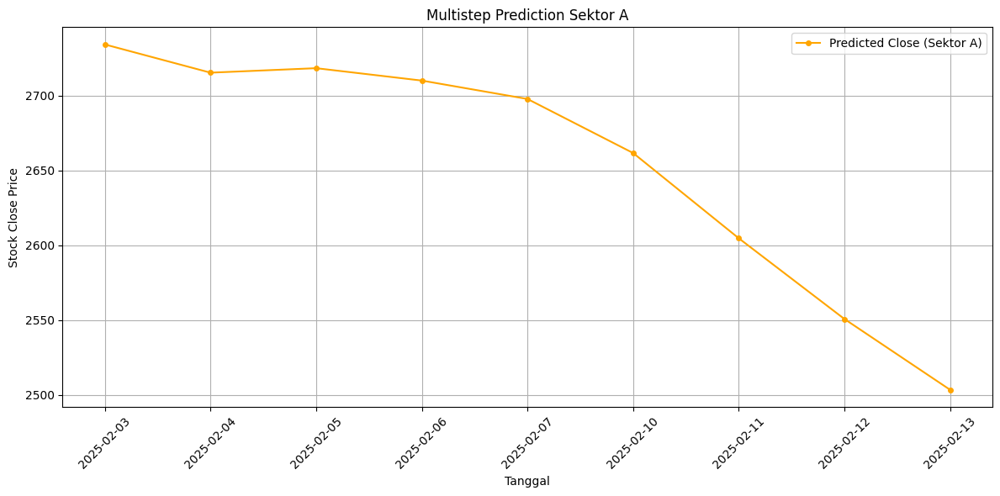

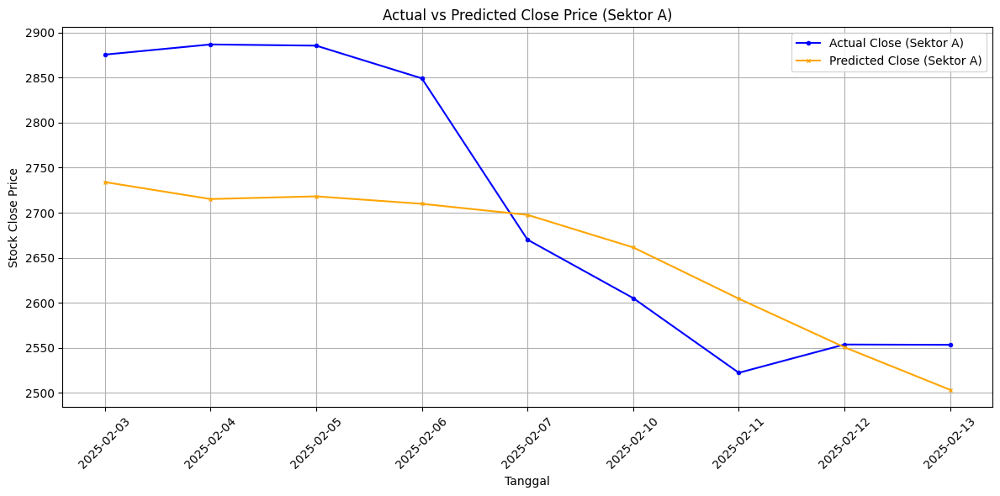

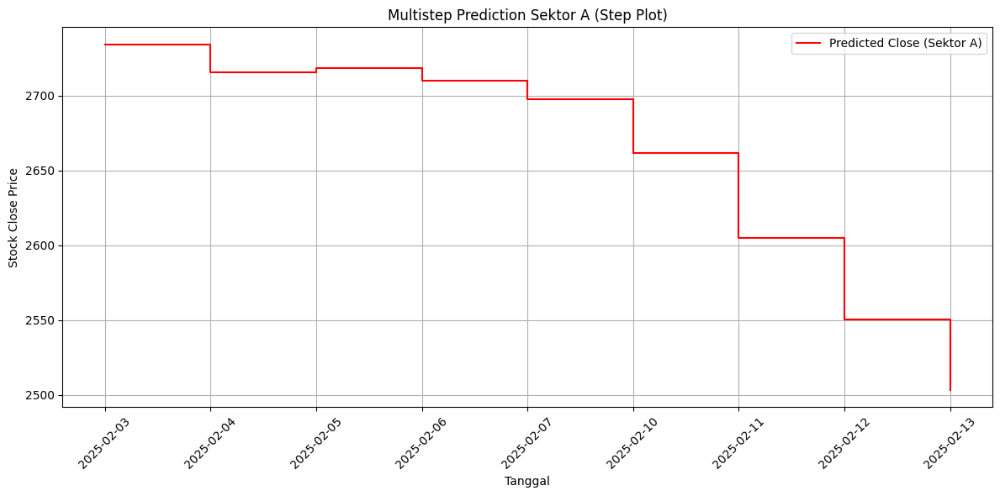

Head data prediksi Sektor A:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     2734.047852      2875.545
1  2025-02-04     2715.201172      2886.815
2  2025-02-05     2718.199219      2885.488
3  2025-02-06     2709.924561      2849.183
4  2025-02-07     2697.635742      2670.111
5  2025-02-10     2661.531494      2605.239
6  2025-02-11     2604.583008      2522.332
7  2025-02-12     2550.673096      2553.726
8  2025-02-13     2503.400635      2553.363
Evaluasi Model Sektor A:
MAE: 93.19
RMSE: 110.58
MAPE: 5.61%

PROCESSING SEKTOR B


<ipython-input-30-17790718100a>:128: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  all_metrics = pd.concat([all_metrics, pd.DataFrame({


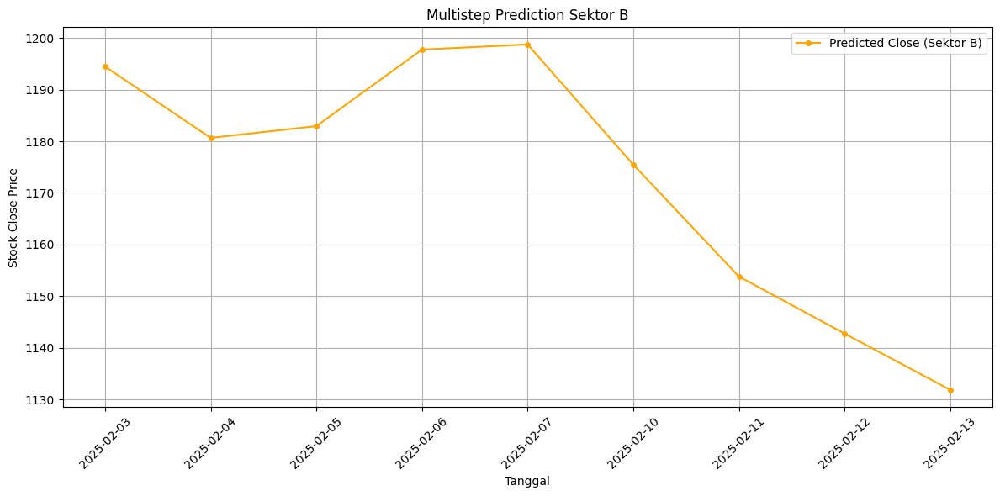

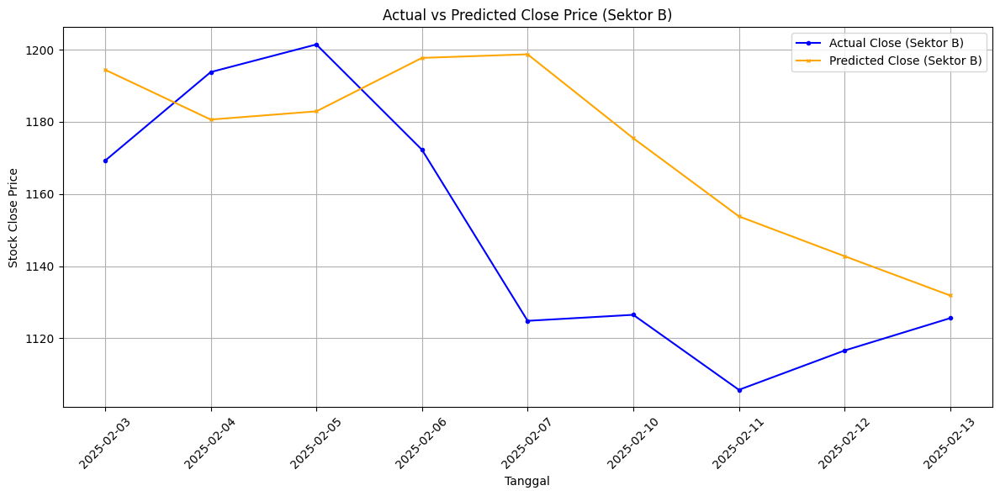

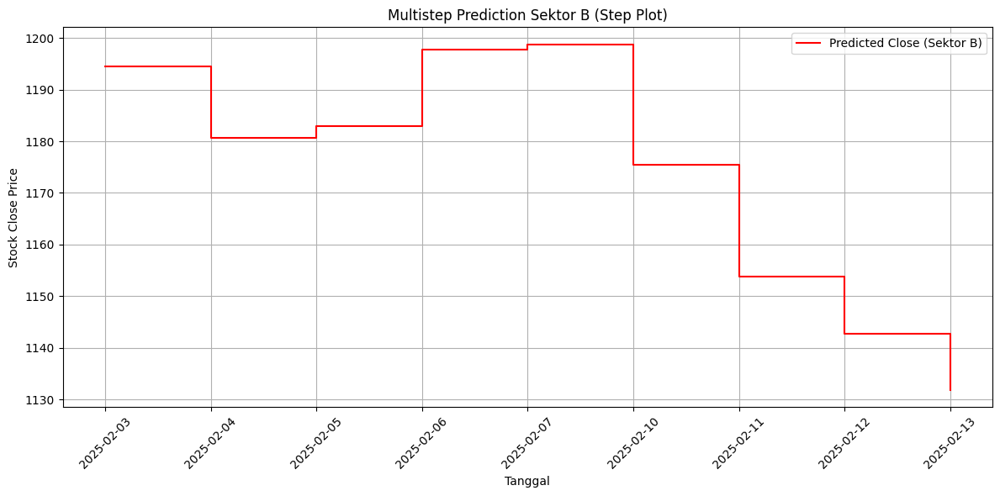

Head data prediksi Sektor B:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1194.475952      1169.232
1  2025-02-04     1180.648071      1193.817
2  2025-02-05     1182.929810      1201.485
3  2025-02-06     1197.755127      1172.273
4  2025-02-07     1198.751709      1124.812
5  2025-02-10     1175.475586      1126.481
6  2025-02-11     1153.795044      1105.669
7  2025-02-12     1142.748535      1116.570
8  2025-02-13     1131.841919      1125.552
Evaluasi Model Sektor B:
MAE: 31.78
RMSE: 37.58
MAPE: 3.52%

PROCESSING SEKTOR C


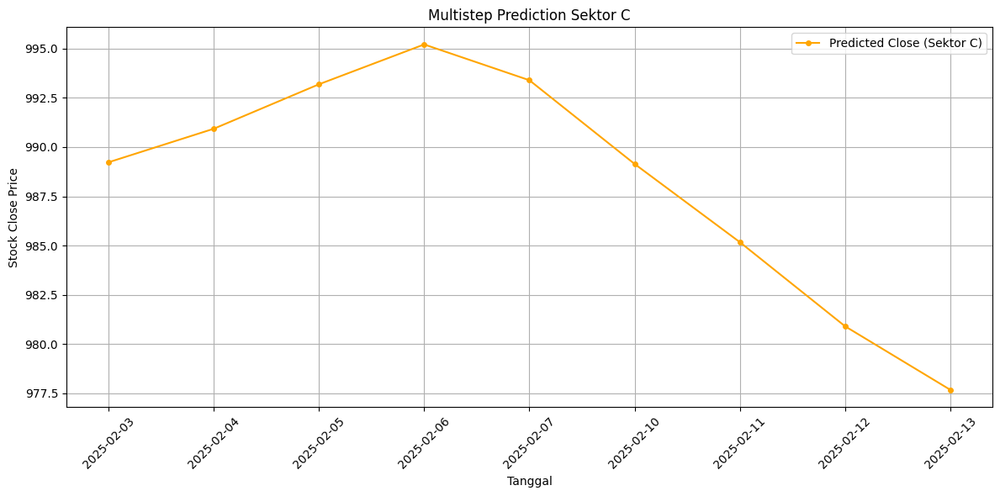

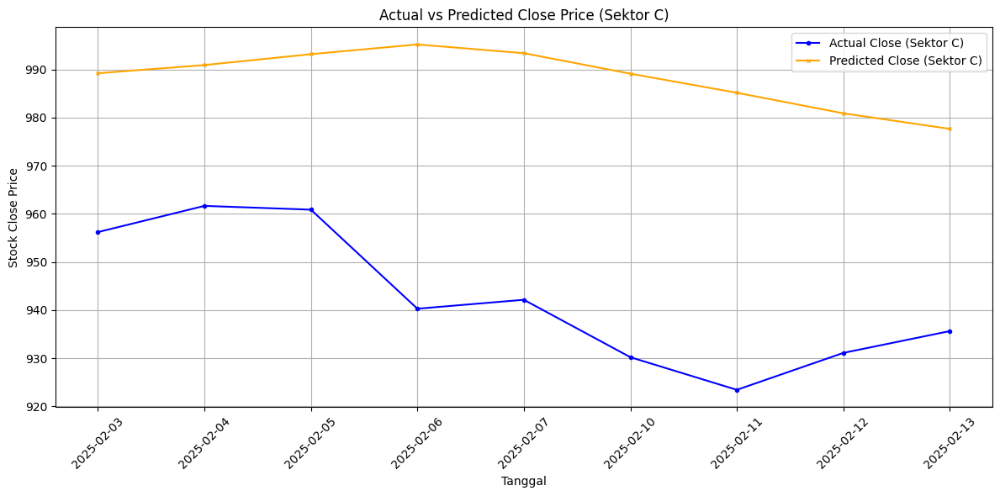

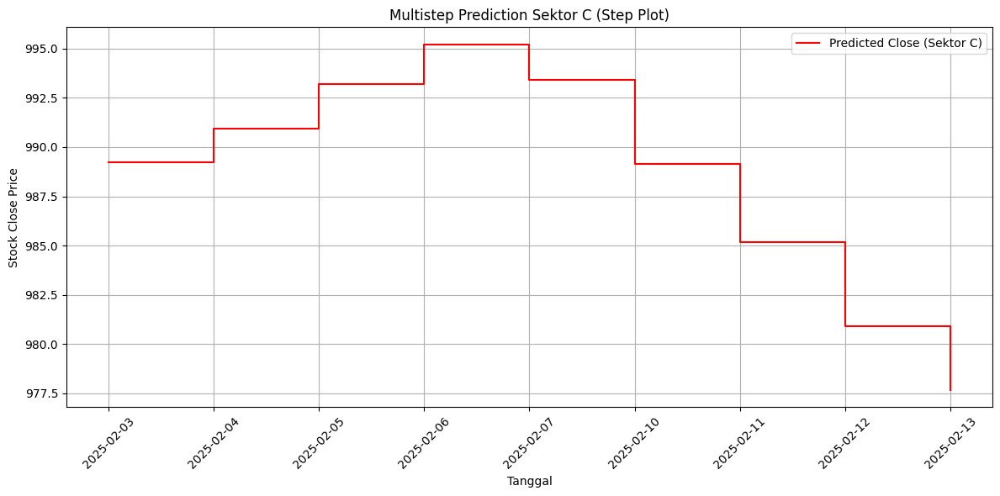

Head data prediksi Sektor C:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      989.226868       956.215
1  2025-02-04      990.929749       961.663
2  2025-02-05      993.188232       960.880
3  2025-02-06      995.211731       940.296
4  2025-02-07      993.394775       942.151
5  2025-02-10      989.142029       930.218
6  2025-02-11      985.171265       923.437
7  2025-02-12      980.899231       931.112
8  2025-02-13      977.671875       935.644
Evaluasi Model Sektor C:
MAE: 45.91
RMSE: 47.33
MAPE: 4.89%

PROCESSING SEKTOR D


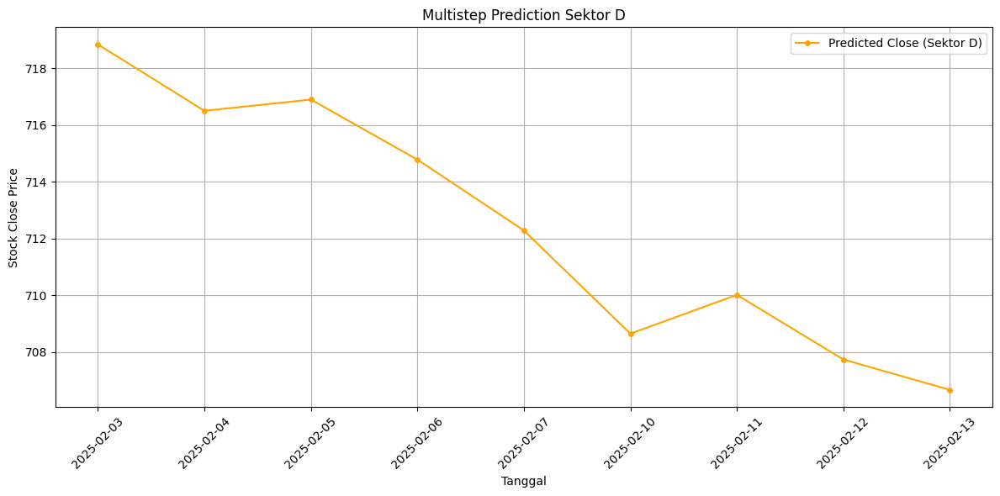

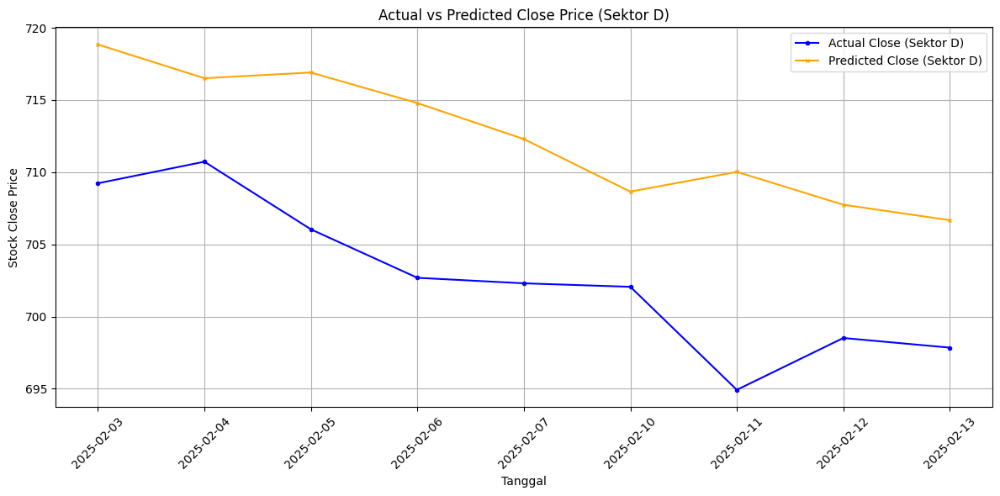

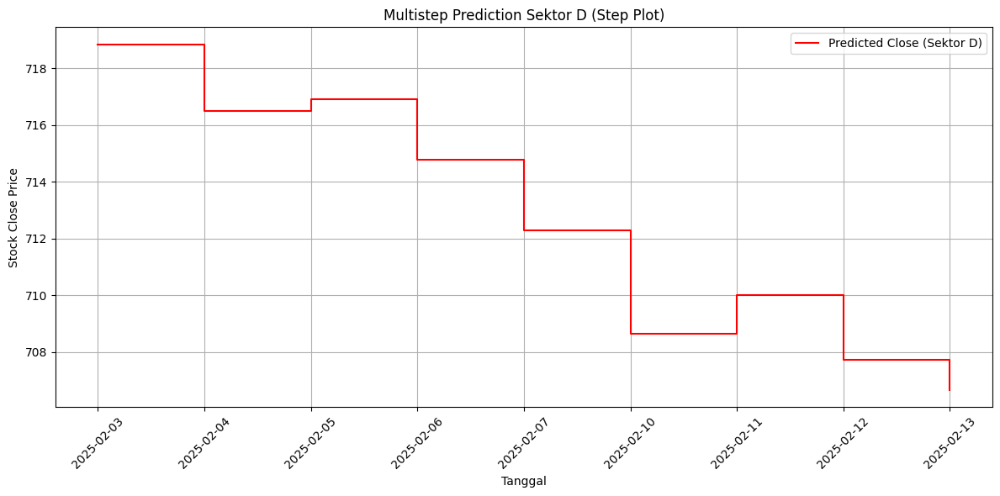

Head data prediksi Sektor D:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      718.847046       709.229
1  2025-02-04      716.508179       710.725
2  2025-02-05      716.904785       706.041
3  2025-02-06      714.788452       702.683
4  2025-02-07      712.290833       702.301
5  2025-02-10      708.653015       702.059
6  2025-02-11      710.020142       694.922
7  2025-02-12      707.743469       698.513
8  2025-02-13      706.673340       697.845
Evaluasi Model Sektor D:
MAE: 9.79
RMSE: 10.14
MAPE: 1.45%

PROCESSING SEKTOR E


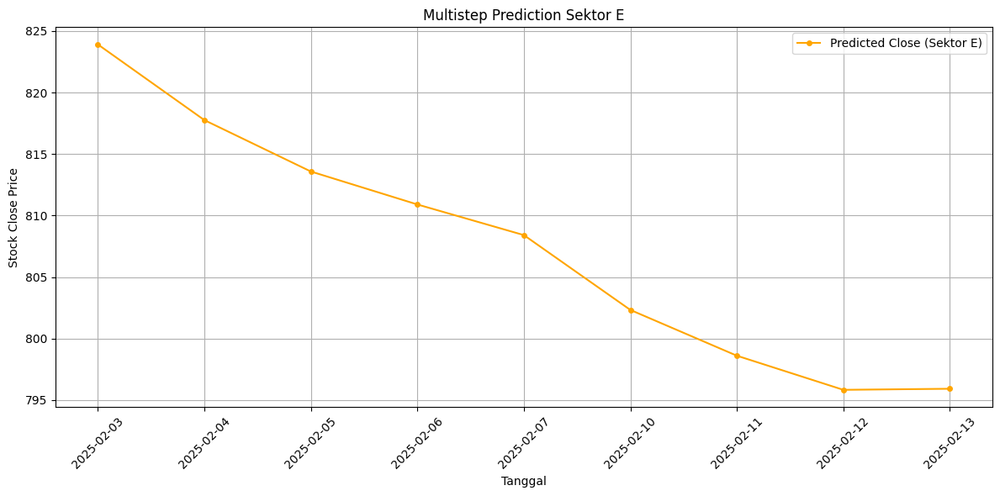

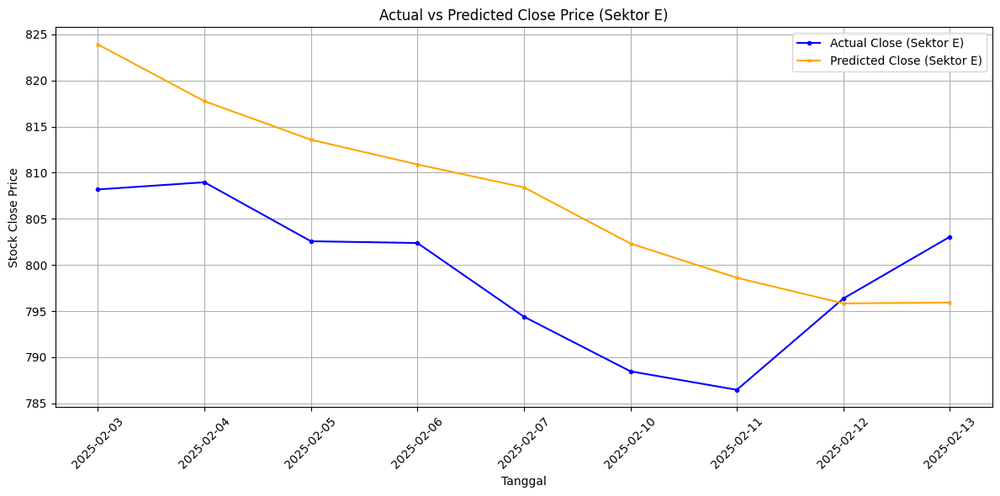

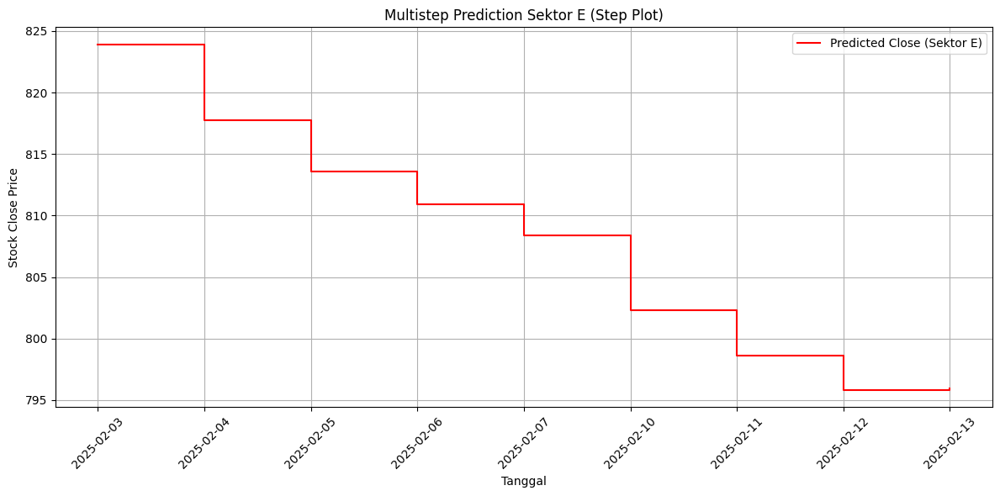

Head data prediksi Sektor E:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      823.912537       808.191
1  2025-02-04      817.762024       808.971
2  2025-02-05      813.584290       802.576
3  2025-02-06      810.904907       802.384
4  2025-02-07      808.415161       794.398
5  2025-02-10      802.332153       788.472
6  2025-02-11      798.611328       786.462
7  2025-02-12      795.837219       796.363
8  2025-02-13      795.924255       803.057
Evaluasi Model Sektor E:
MAE: 10.19
RMSE: 11.08
MAPE: 1.50%

PROCESSING SEKTOR F


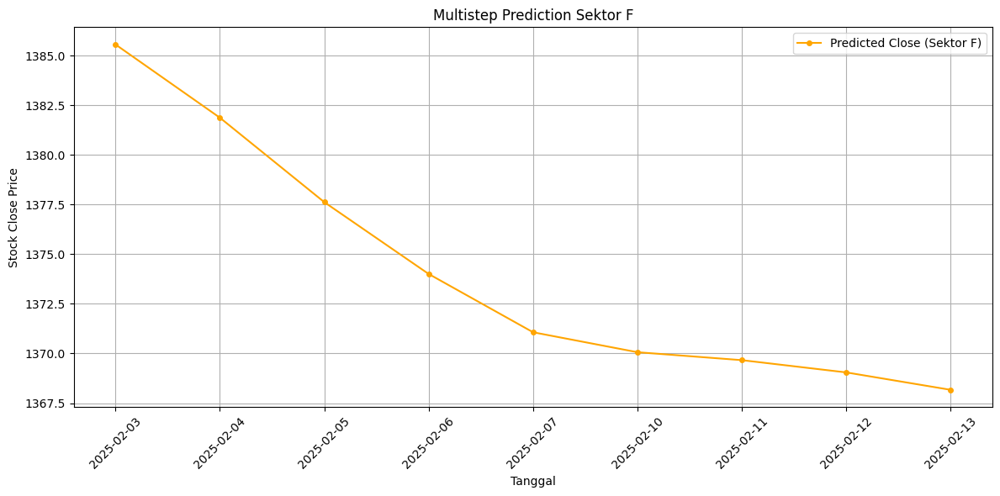

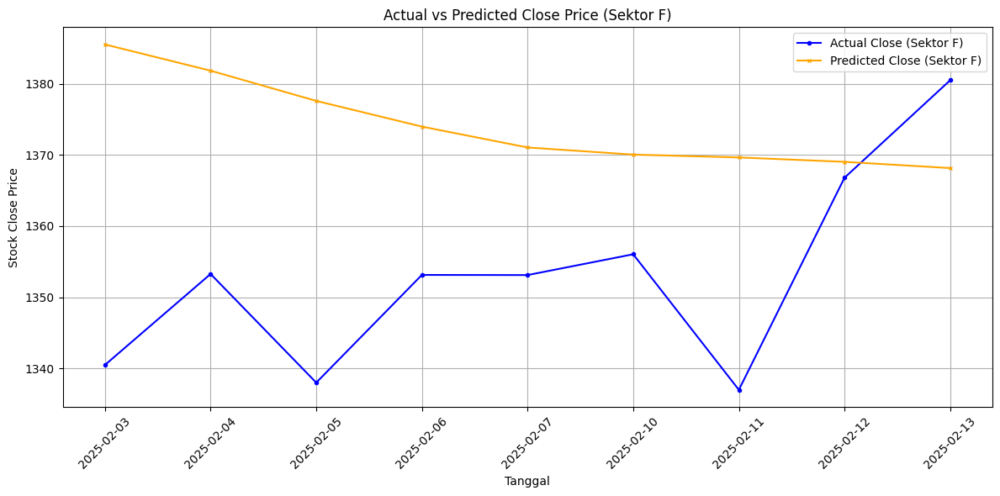

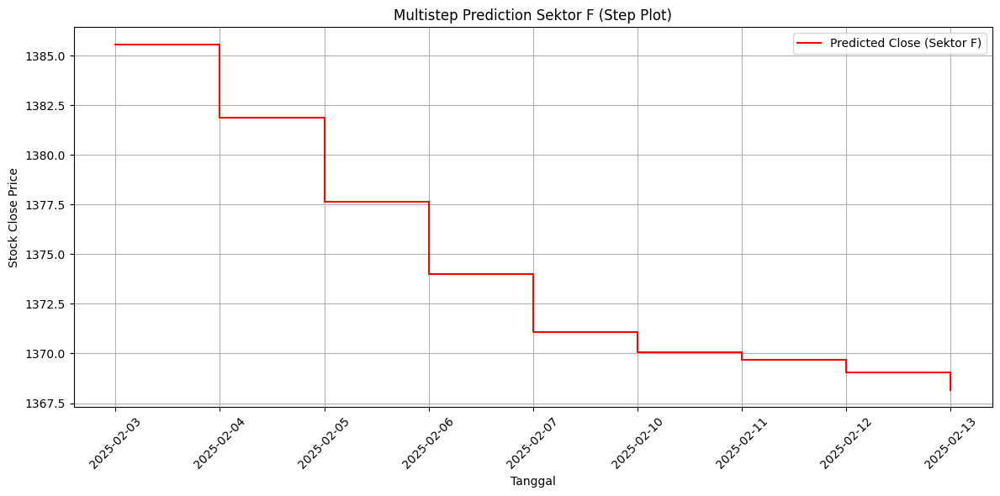

Head data prediksi Sektor F:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1385.562622      1340.464
1  2025-02-04     1381.873413      1353.266
2  2025-02-05     1377.621948      1337.978
3  2025-02-06     1374.003540      1353.134
4  2025-02-07     1371.068237      1353.114
5  2025-02-10     1370.063110      1356.040
6  2025-02-11     1369.663208      1336.965
7  2025-02-12     1369.045898      1366.806
8  2025-02-13     1368.168579      1380.525
Evaluasi Model Sektor F:
MAE: 23.72
RMSE: 27.09
MAPE: 1.67%

PROCESSING SEKTOR G


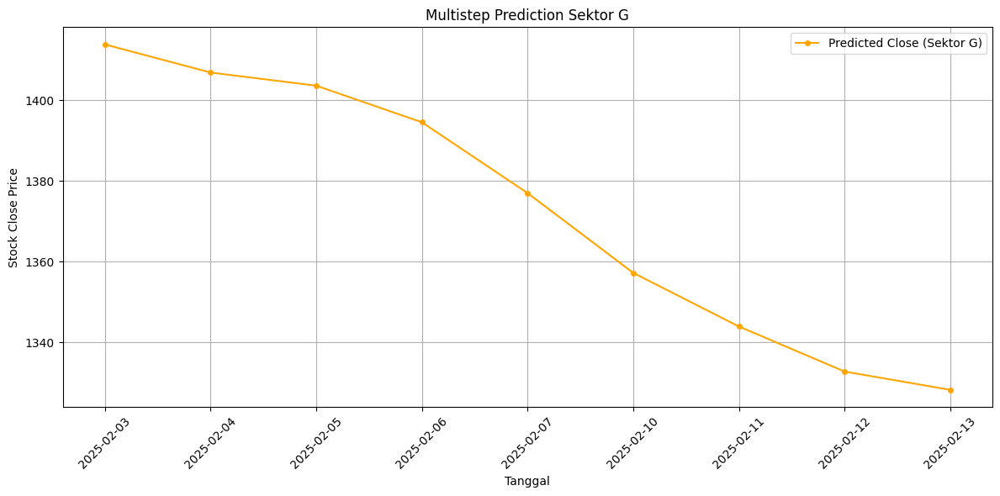

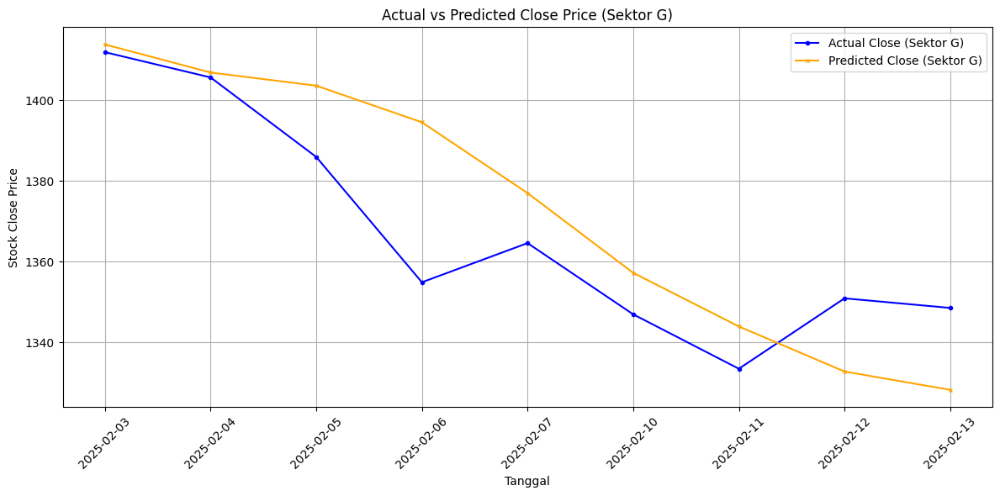

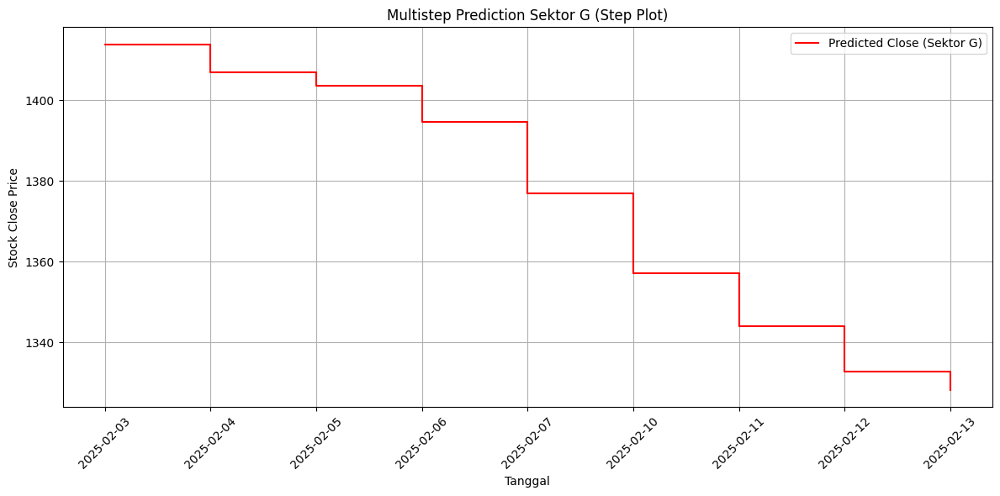

Head data prediksi Sektor G:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1413.878296      1411.965
1  2025-02-04     1406.920532      1405.702
2  2025-02-05     1403.659912      1385.990
3  2025-02-06     1394.588135      1354.928
4  2025-02-07     1377.040894      1364.633
5  2025-02-10     1357.260010      1346.979
6  2025-02-11     1343.975952      1333.492
7  2025-02-12     1332.802002      1350.947
8  2025-02-13     1328.263794      1348.573
Evaluasi Model Sektor G:
MAE: 14.68
RMSE: 18.26
MAPE: 2.49%

PROCESSING SEKTOR H


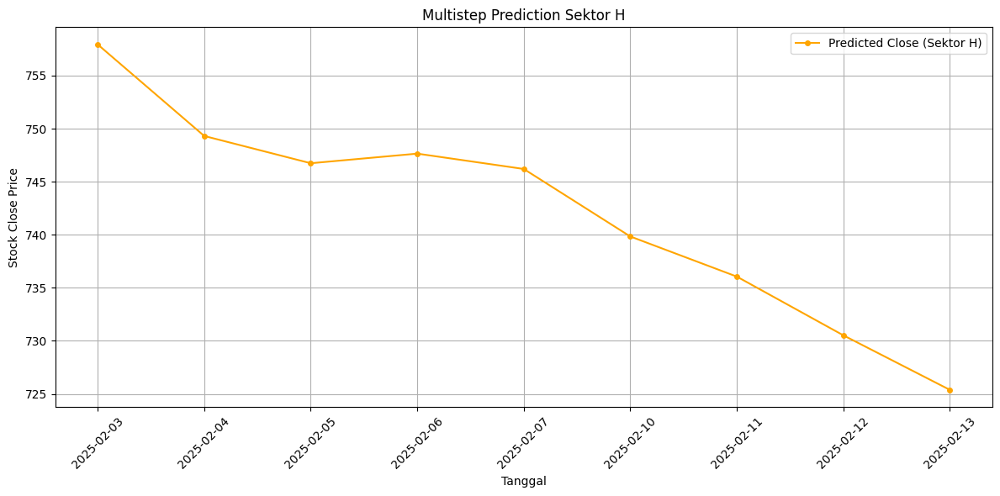

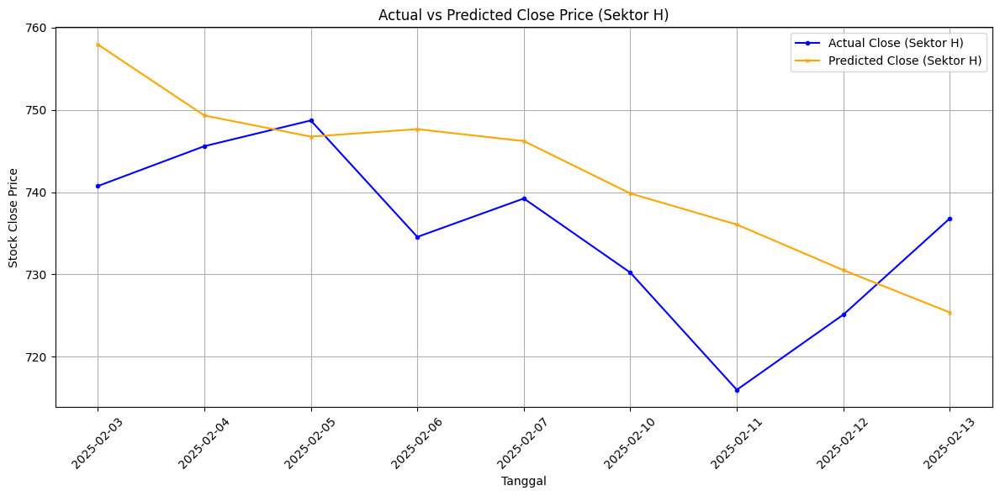

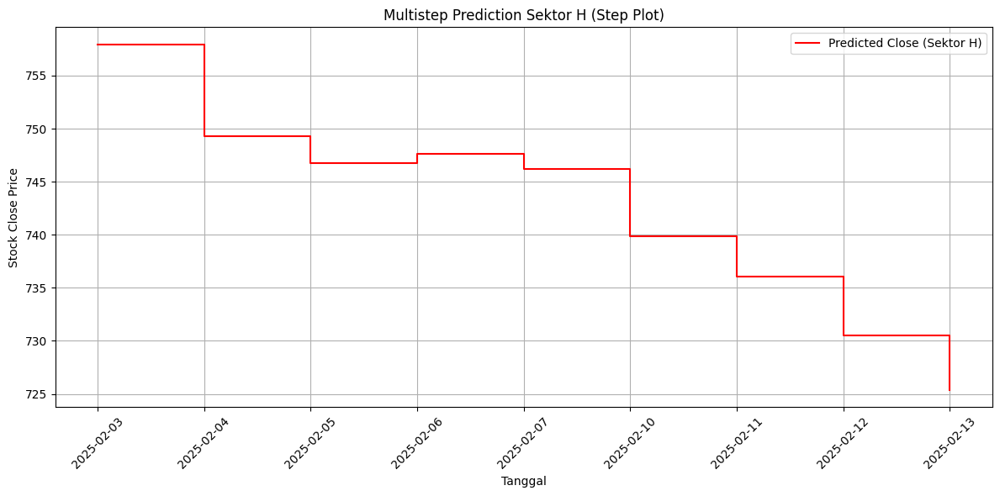

Head data prediksi Sektor H:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03      757.936096       740.733
1  2025-02-04      749.309998       745.577
2  2025-02-05      746.739929       748.702
3  2025-02-06      747.645752       734.554
4  2025-02-07      746.199585       739.227
5  2025-02-10      739.838379       730.220
6  2025-02-11      736.056335       715.981
7  2025-02-12      730.521973       725.116
8  2025-02-13      725.381653       736.806
Evaluasi Model Sektor H:
MAE: 9.94
RMSE: 11.49
MAPE: 1.67%

PROCESSING SEKTOR I


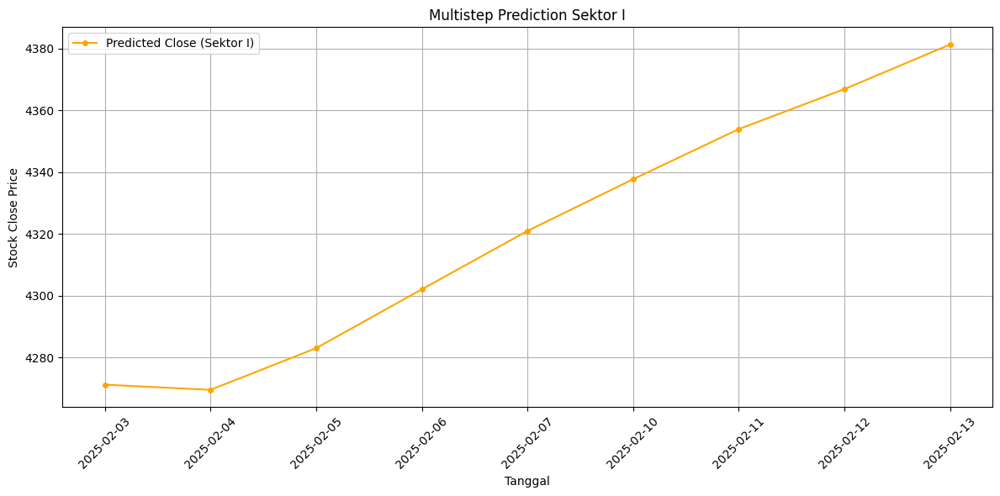

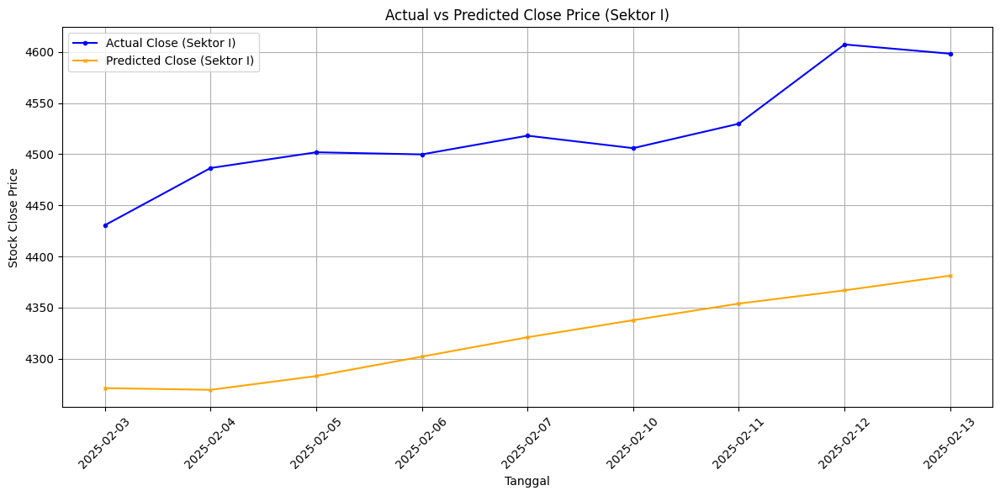

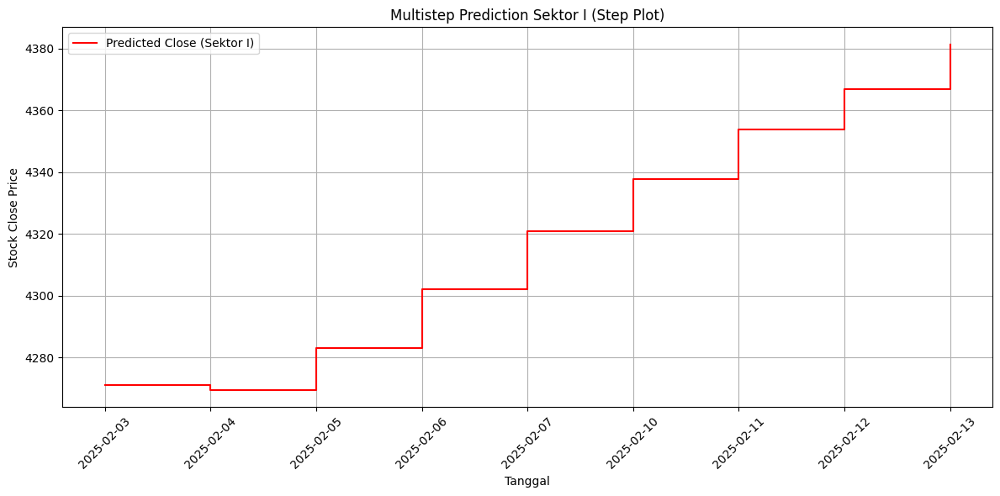

Head data prediksi Sektor I:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     4271.288086      4430.545
1  2025-02-04     4269.613770      4486.468
2  2025-02-05     4283.088867      4501.871
3  2025-02-06     4302.112793      4499.804
4  2025-02-07     4321.003906      4518.117
5  2025-02-10     4337.720703      4505.906
6  2025-02-11     4353.923340      4529.791
7  2025-02-12     4366.849609      4607.295
8  2025-02-13     4381.277344      4598.270
Evaluasi Model Sektor I:
MAE: 199.02
RMSE: 200.64
MAPE: 4.39%

PROCESSING SEKTOR J


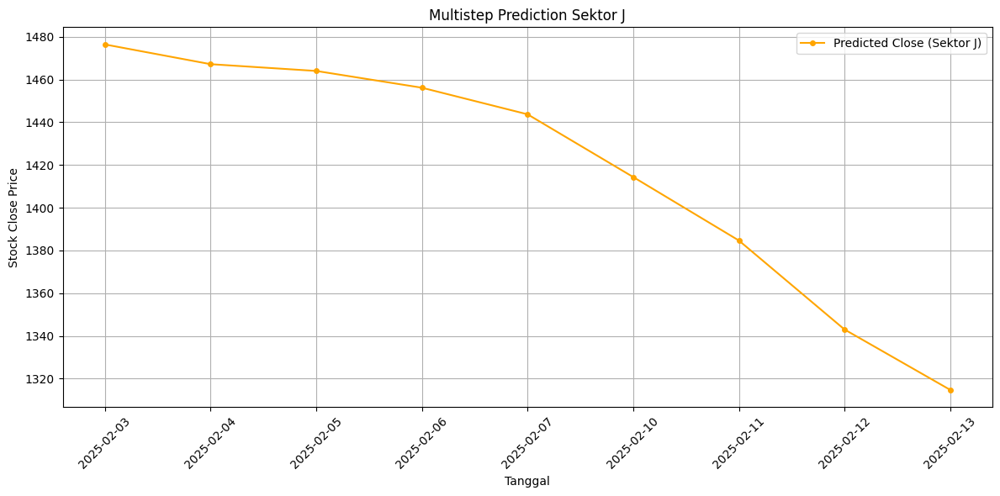

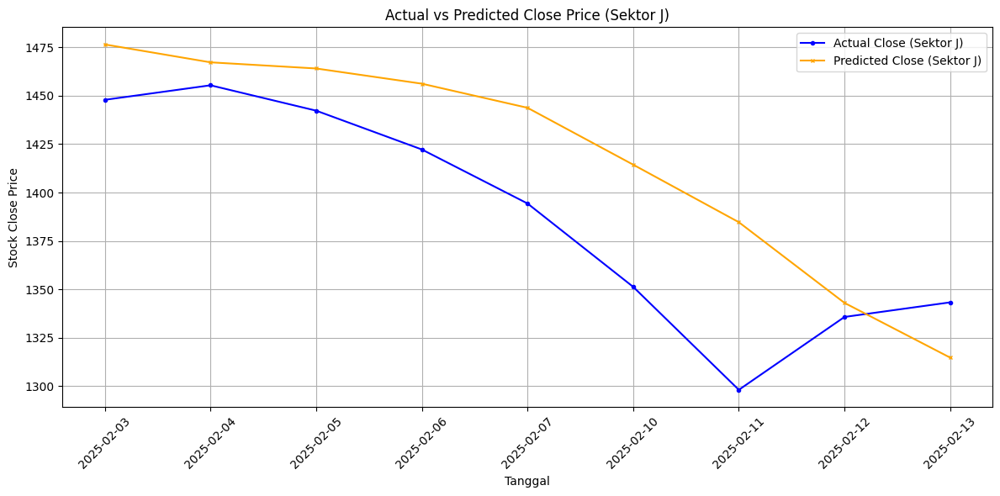

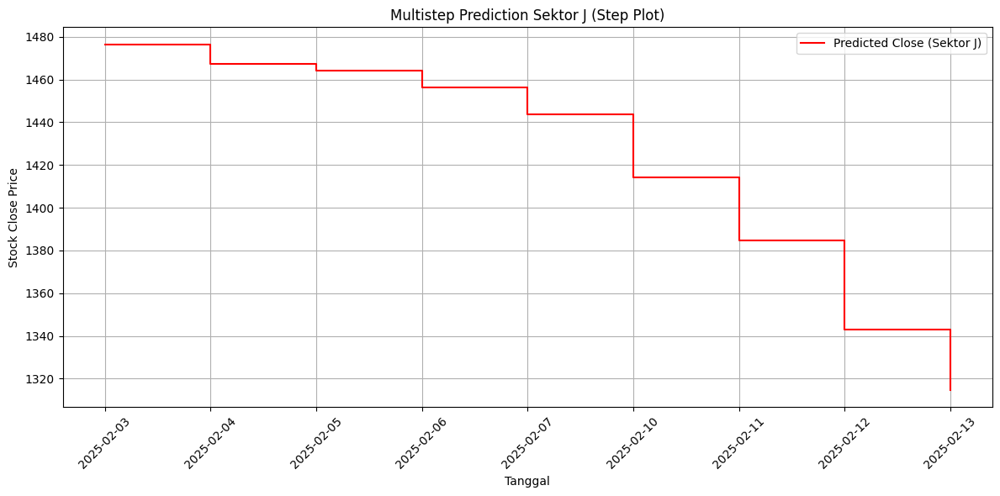

Head data prediksi Sektor J:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1476.449097      1447.861
1  2025-02-04     1467.217163      1455.366
2  2025-02-05     1464.044312      1442.265
3  2025-02-06     1456.194580      1422.231
4  2025-02-07     1443.748047      1394.348
5  2025-02-10     1414.388672      1351.312
6  2025-02-11     1384.679443      1298.132
7  2025-02-12     1343.022827      1335.760
8  2025-02-13     1314.764038      1343.301
Evaluasi Model Sektor J:
MAE: 36.78
RMSE: 43.92
MAPE: 4.93%

PROCESSING SEKTOR K


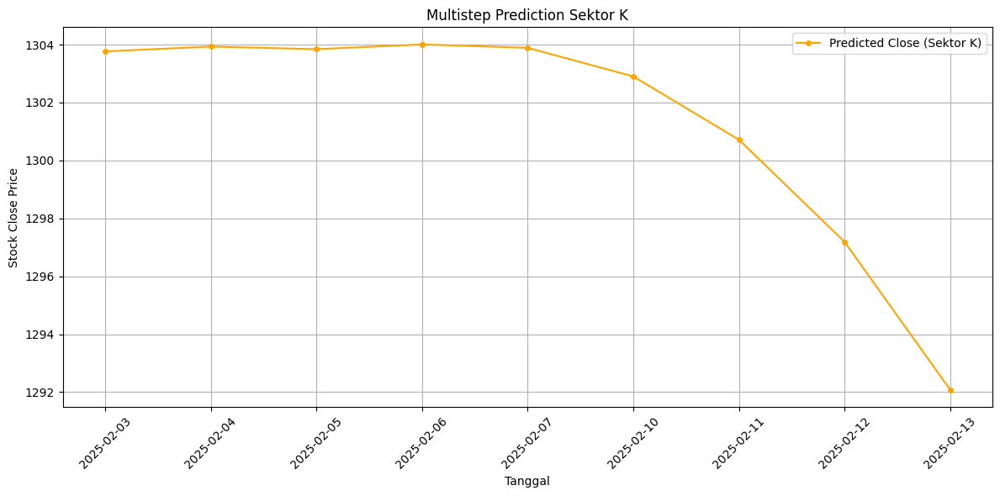

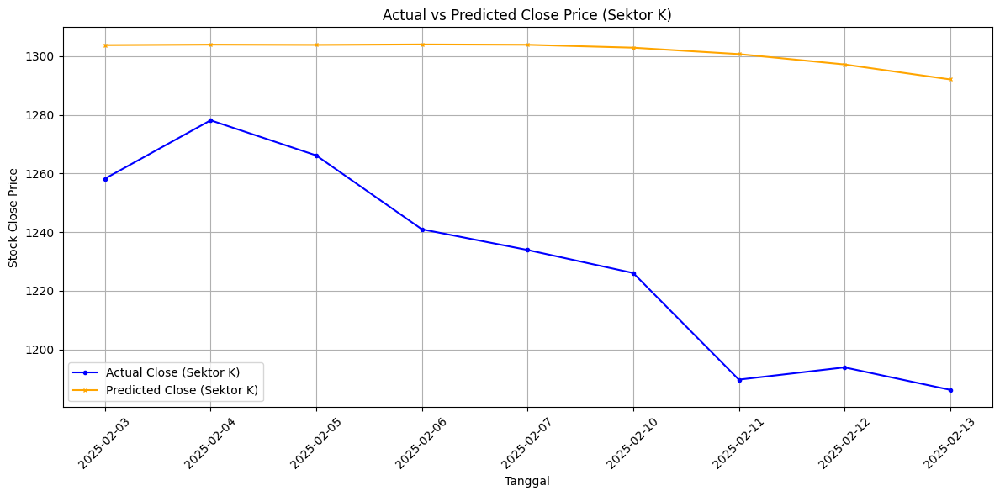

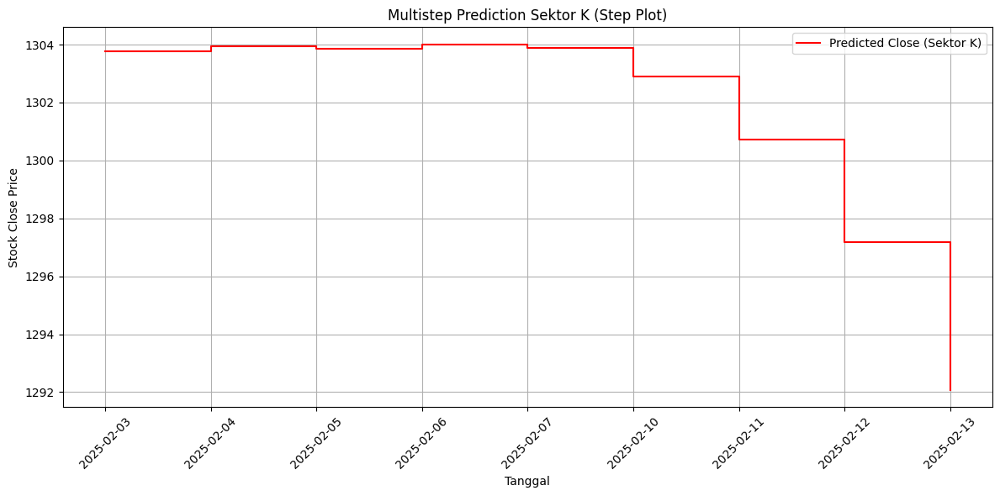

Head data prediksi Sektor K:
      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1303.764893      1258.244
1  2025-02-04     1303.931396      1278.147
2  2025-02-05     1303.841919      1266.166
3  2025-02-06     1304.005005      1240.981
4  2025-02-07     1303.889282      1233.936
5  2025-02-10     1302.901123      1226.077
6  2025-02-11     1300.716919      1189.726
7  2025-02-12     1297.187622      1193.900
8  2025-02-13     1292.080688      1186.247
Evaluasi Model Sektor K:
MAE: 70.99
RMSE: 76.82
MAPE: 5.84%

Hasil Evaluasi Semua Sektor:
   Sektor         MAE        RMSE      MAPE
0       A   93.193523  110.578500  5.609088
1       B   31.775443   37.583768  3.522650
2       C   45.913306   47.328733  4.892721
3       D    9.790140   10.137327  1.448392
4       E   10.191881   11.083423  1.496614
5       F   23.721266   27.091047  1.674448
6       G   14.676548   18.262197  2.491203
7       H    9.942948   11.494032  1.670825
8       I  199.020954  200.639271  4.390938
9

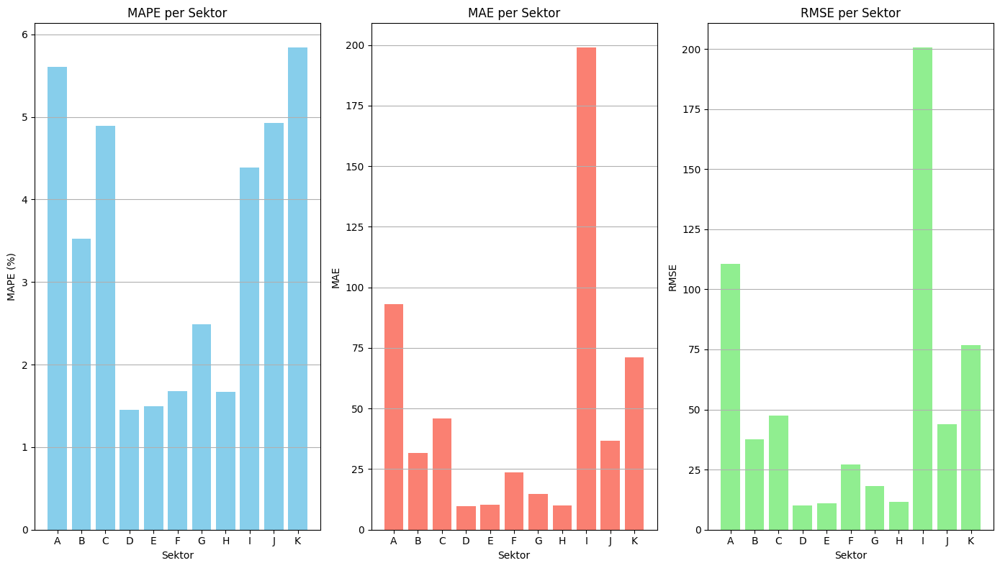

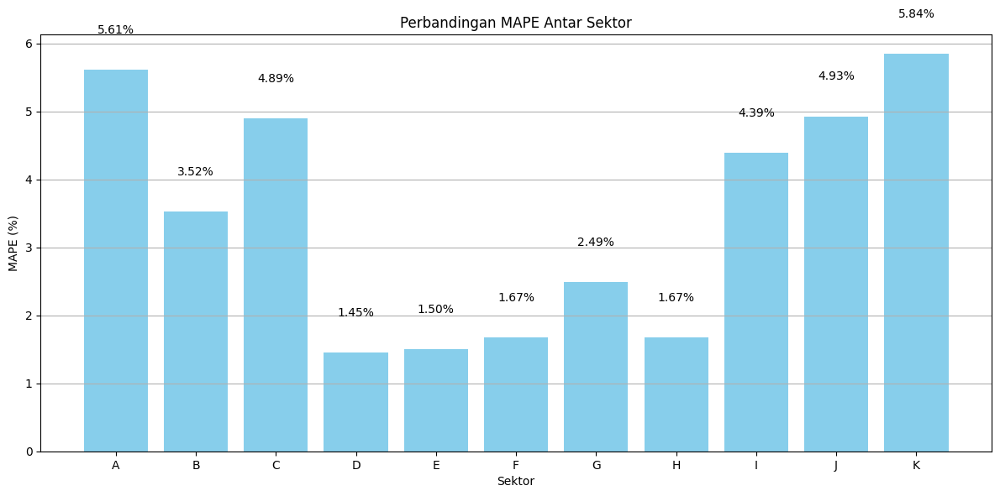

In [30]:
# BIDIRECT

import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Timestep yang digunakan dalam model
timestep = 10

# List sektor yang tersedia (A sampai K)
sectors = list('ABCDEFGHIJK')

# DataFrame untuk menyimpan hasil evaluasi semua sektor
all_metrics = pd.DataFrame(columns=['Sektor', 'MAE', 'RMSE', 'MAPE'])

# Loop untuk setiap sektor
for sector in sectors:
    try:
        print(f"\n{'='*50}")
        print(f"PROCESSING SEKTOR {sector}")
        print(f"{'='*50}")
        
        # 1. Load preprocessor untuk sektor
        preprocessor_path = f'/kaggle/working/preprocessor/preprocessor_{sector}.pkl'
        preprocessor = joblib.load(preprocessor_path)
        
        # 2. Load model terbaik untuk sektor
        model_path = f'/kaggle/working/best_model_STACN_{sector}_full_conv.keras'
        model = load_model(model_path)
        
        # 3. Ambil data untuk sektor ini
        df = df_stock[sector]
        
        # 4. Prepare data dengan preprocessor
        (X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=timestep, 
                                                               preprocessor=preprocessor, 
                                                               is_training=False)
        
        # 5. Prediksi autoregresif
        X_stock_ar = np.copy(X_stock)
        X_news_input = np.copy(X_news)
        predictions_scaled = []
        current_stock_seq = X_stock_ar[0].copy()
        
        for i in range(len(X_stock_ar)):
            input_stock = current_stock_seq[np.newaxis, ...]
            input_news = X_news_input[i][np.newaxis, ...]
            pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
            predictions_scaled.append(pred_scaled)
            if i + 1 < len(X_stock_ar):
                next_seq = X_stock_ar[i + 1].copy()
                next_seq[:-1] = current_stock_seq[1:]  # geser
                next_seq[-1] = X_stock_ar[i + 1][-1]
                next_seq[-1][3] = pred_scaled
                current_stock_seq = next_seq.copy()
        
        # 6. Inverse transform
        predictions_close = preprocessor.inverse_transform_target(np.array(predictions_scaled))
        
        # 7. Dapatkan tanggal dan data aktual
        dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values
        actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values
        
        # 8. Plot hasil
        # Plot 1: Dengan marker
        plt.figure(figsize=(12, 6))
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='o', markersize=4)
        plt.title(f'Multistep Prediction Sektor {sector}')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 2: Perbandingan aktual vs prediksi
        plt.figure(figsize=(12, 6))
        plt.plot(dates, actual_close, label=f'Actual Close (Sektor {sector})', 
                 color='blue', marker='o', markersize=3)
        plt.plot(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='orange', linestyle='-', marker='x', markersize=3)
        plt.title(f'Actual vs Predicted Close Price (Sektor {sector})')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # Plot 3: Step plot
        plt.figure(figsize=(12, 6))
        plt.step(dates, predictions_close, label=f'Predicted Close (Sektor {sector})', 
                 color='red', where='post', linewidth=1.5)
        plt.title(f'Multistep Prediction Sektor {sector} (Step Plot)')
        plt.xlabel('Tanggal')
        plt.ylabel('Stock Close Price')
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()
        
        # 9. Simpan nilai prediksi dalam DataFrame
        prediction_df = pd.DataFrame()
        prediction_df['Tanggal'] = dates
        prediction_df['Nilai_Prediksi'] = predictions_close
        prediction_df['Nilai_Aktual'] = actual_close
        print(f"Head data prediksi Sektor {sector}:")
        print(prediction_df)
        
        # 10. Hitung metrik evaluasi
        mae = mean_absolute_error(actual_close, predictions_close)
        rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
        mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100
        
        print(f"Evaluasi Model Sektor {sector}:")
        print(f"MAE: {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        
        # Tambahkan hasil evaluasi ke dataframe all_metrics
        all_metrics = pd.concat([all_metrics, pd.DataFrame({
            'Sektor': [sector],
            'MAE': [mae],
            'RMSE': [rmse],
            'MAPE': [mape]
        })], ignore_index=True)
        
        # Simpan hasil prediksi ke file CSV (opsional)
        prediction_df.to_csv(f'/kaggle/working/prediction_sektor_{sector}.csv', index=False)
        
    except Exception as e:
        print(f"Error pada sektor {sector}: {str(e)}")
        continue

# Tampilkan hasil evaluasi untuk semua sektor
print("\nHasil Evaluasi Semua Sektor:")
print(all_metrics)

# Plot perbandingan performa model pada semua sektor
plt.figure(figsize=(14, 8))

# Plot MAPE untuk setiap sektor
plt.subplot(1, 3, 1)
plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')
plt.title('MAPE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')

# Plot MAE untuk setiap sektor
plt.subplot(1, 3, 2)
plt.bar(all_metrics['Sektor'], all_metrics['MAE'], color='salmon')
plt.title('MAE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAE')
plt.grid(axis='y')

# Plot RMSE untuk setiap sektor
plt.subplot(1, 3, 3)
plt.bar(all_metrics['Sektor'], all_metrics['RMSE'], color='lightgreen')
plt.title('RMSE per Sektor')
plt.xlabel('Sektor')
plt.ylabel('RMSE')
plt.grid(axis='y')

plt.tight_layout()
plt.show()

# Plot perbandingan MAPE untuk semua sektor dalam satu grafik yang lebih detail
plt.figure(figsize=(12, 6))
bars = plt.bar(all_metrics['Sektor'], all_metrics['MAPE'], color='skyblue')

# Tambahkan nilai MAPE di atas setiap batang
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.5,
            f'{height:.2f}%', ha='center', va='bottom')

plt.title('Perbandingan MAPE Antar Sektor')
plt.xlabel('Sektor')
plt.ylabel('MAPE (%)')
plt.grid(axis='y')
plt.tight_layout()
plt.show()

### Sektor B

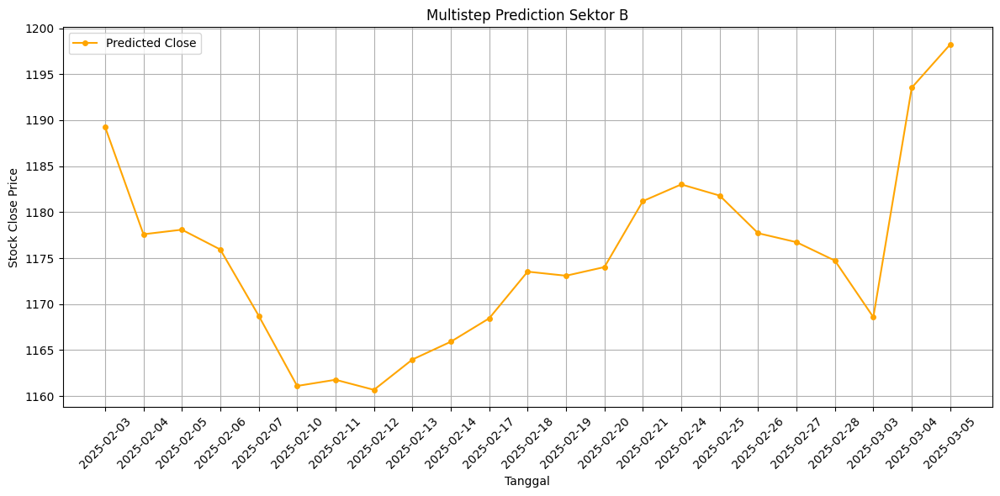

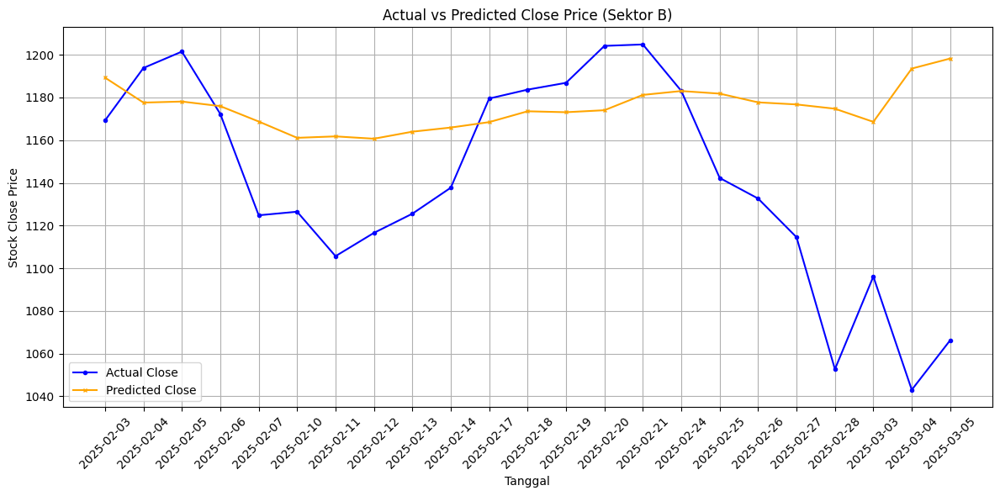

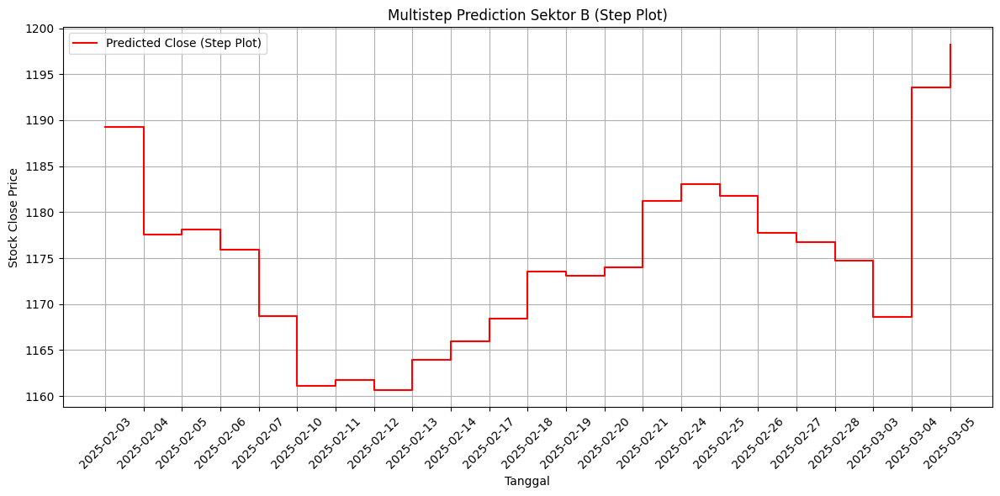

      Tanggal  Nilai_Prediksi  Nilai_Aktual
0  2025-02-03     1189.279053      1169.232
1  2025-02-04     1177.593872      1193.817
2  2025-02-05     1178.090088      1201.485
3  2025-02-06     1175.937256      1172.273
4  2025-02-07     1168.732300      1124.812
Evaluasi Model:
MAE: 44.40
RMSE: 59.44
MAPE: 4.16%


In [49]:
# Step 1: Siapkan preprocessor dan data lengkap
import joblib
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.models import load_model

timestep = 10
# Load preprocessor untuk sektor B
preprocessor_B = joblib.load('/kaggle/working/preprocessor/preprocessor_B.pkl')
# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['B']  # ambil data sektor B
# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_B.transform_data(df)
# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_B, is_training=False)

# Step 2: Load model terbaik
model_path = '/kaggle/working/best_model_STACN_B_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)
predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]
    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)
    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_B.inverse_transform_target(np.array(predictions_scaled))

# Step 6: Plot hasil - REVISI
# Dapatkan tanggal yang sesuai
dates = df['Tanggal'].iloc[timestep:timestep+len(predictions_close)].values

# Dapatkan data aktual untuk perbandingan
actual_close = df['close'].iloc[timestep:timestep+len(predictions_close)].values

# Plot 1: Dengan marker untuk menunjukkan sudut/titik data
plt.figure(figsize=(12, 6))
plt.plot(dates, predictions_close, label='Predicted Close', color='orange', 
         linestyle='-', marker='o', markersize=4)
plt.title('Multistep Prediction Sektor B')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot 2: Plot perbandingan aktual vs prediksi
plt.figure(figsize=(12, 6))
plt.plot(dates, actual_close, label='Actual Close', color='blue', marker='o', markersize=3)
plt.plot(dates, predictions_close, label='Predicted Close', color='orange', 
         linestyle='-', marker='x', markersize=3)
plt.title('Actual vs Predicted Close Price (Sektor B)')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot 3: Plot dengan gaya step untuk melihat perubahan yang jelas
plt.figure(figsize=(12, 6))
plt.step(dates, predictions_close, label='Predicted Close (Step Plot)', 
         color='red', where='post', linewidth=1.5)
plt.title('Multistep Prediction Sektor B (Step Plot)')
plt.xlabel('Tanggal')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Simpan nilai prediksi dalam DataFrame
prediction_df = pd.DataFrame()
prediction_df['Tanggal'] = dates
prediction_df['Nilai_Prediksi'] = predictions_close
prediction_df['Nilai_Aktual'] = actual_close
print(prediction_df.head())

# Hitung metrik evaluasi
from sklearn.metrics import mean_absolute_error, mean_squared_error
mae = mean_absolute_error(actual_close, predictions_close)
rmse = np.sqrt(mean_squared_error(actual_close, predictions_close))
mape = np.mean(np.abs((actual_close - predictions_close) / actual_close)) * 100

print(f"Evaluasi Model:")
print(f"MAE: {mae:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"MAPE: {mape:.2f}%")


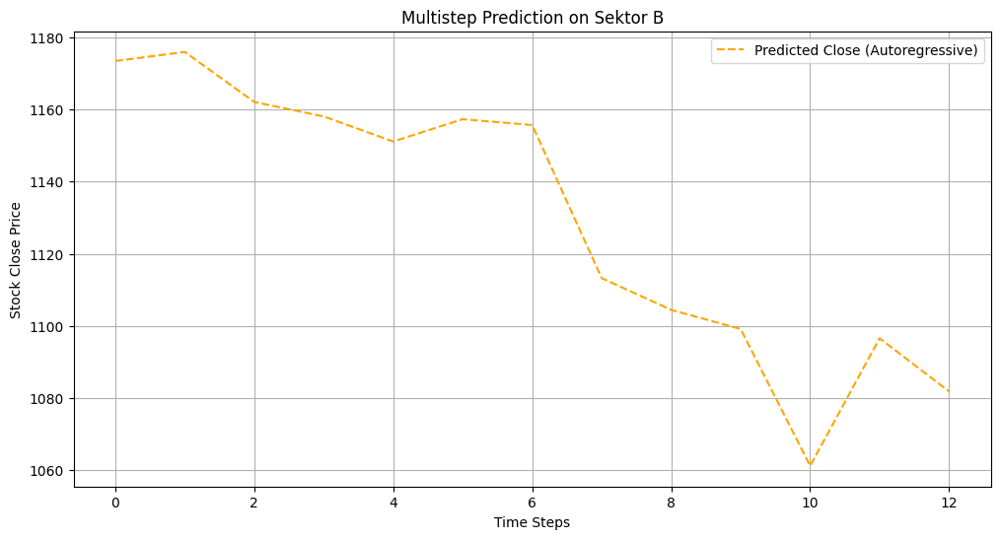

In [42]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor A
preprocessor_B = joblib.load('/kaggle/working/preprocessor/preprocessor_B.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['B']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_B.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_B, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_B_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_B.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_B.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor B')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor C

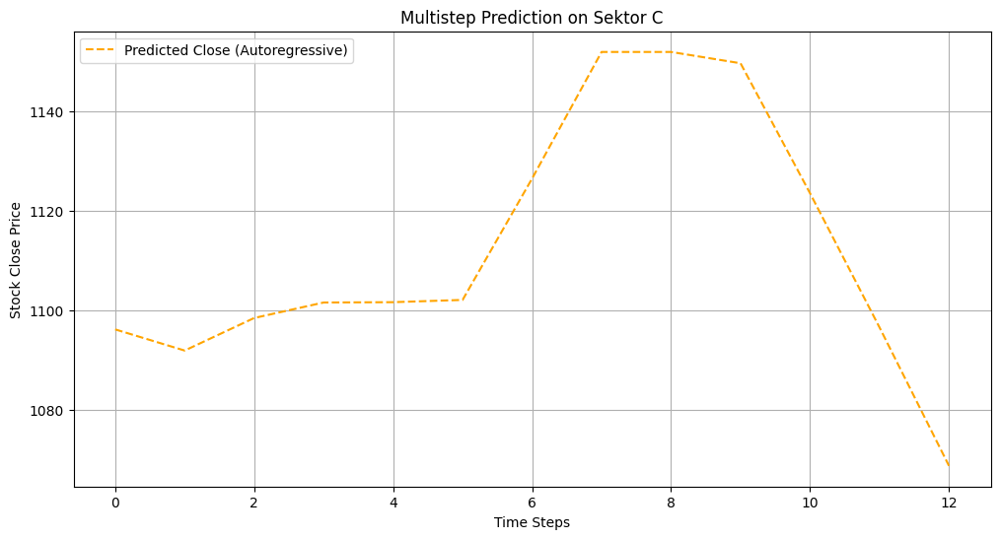

In [43]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor C
preprocessor_C = joblib.load('/kaggle/working/preprocessor/preprocessor_C.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['C']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_C.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_C, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_C_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_C.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_C.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor C')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor D

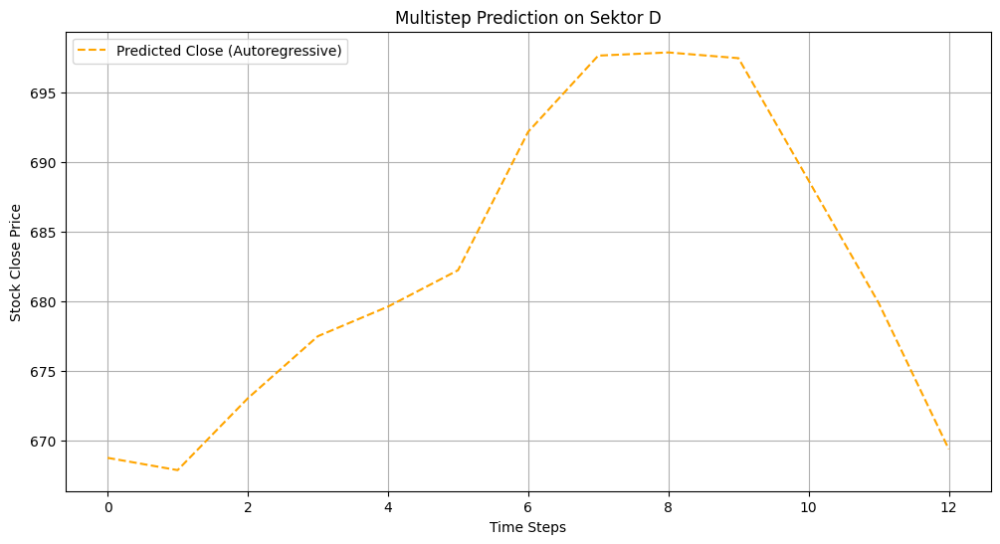

In [45]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor D
preprocessor_D = joblib.load('/kaggle/working/preprocessor/preprocessor_D.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['D']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_D.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_D, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_D_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_D.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_D.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor D')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor E

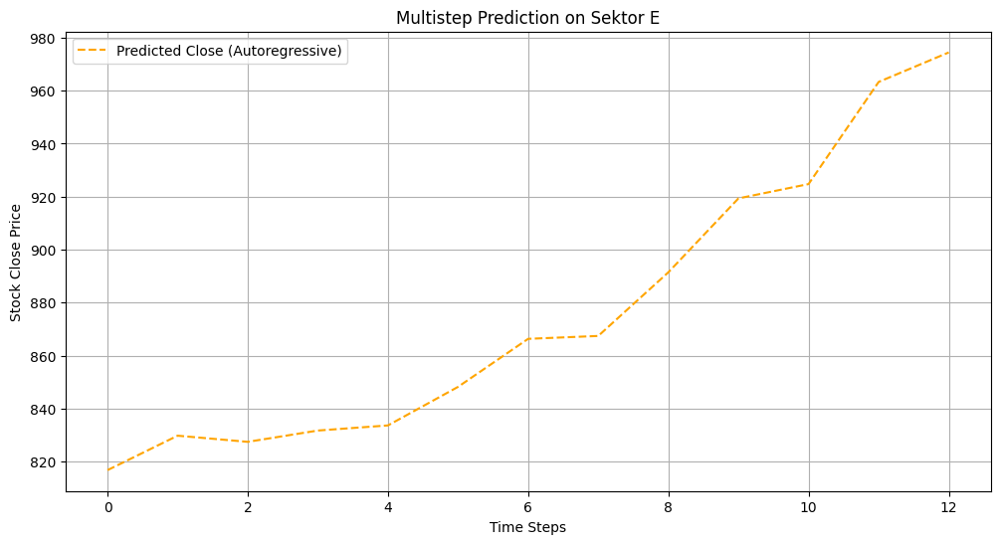

In [46]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor E
preprocessor_E = joblib.load('/kaggle/working/preprocessor/preprocessor_E.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['E']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_E.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_E, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_E_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_E.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_E.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor E')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor F

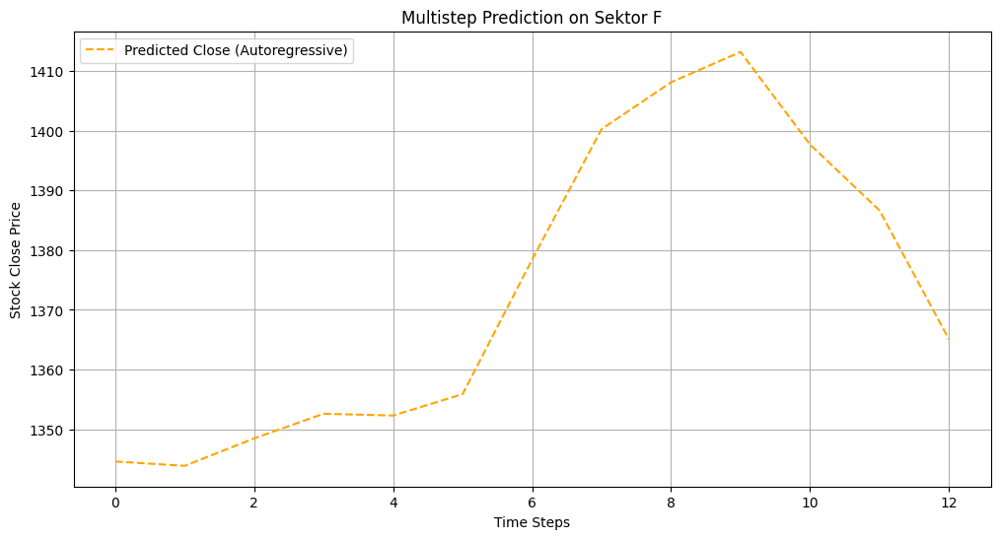

In [47]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor F
preprocessor_F = joblib.load('/kaggle/working/preprocessor/preprocessor_F.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['F']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_F.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_F, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_F_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_F.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_F.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor F')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor G

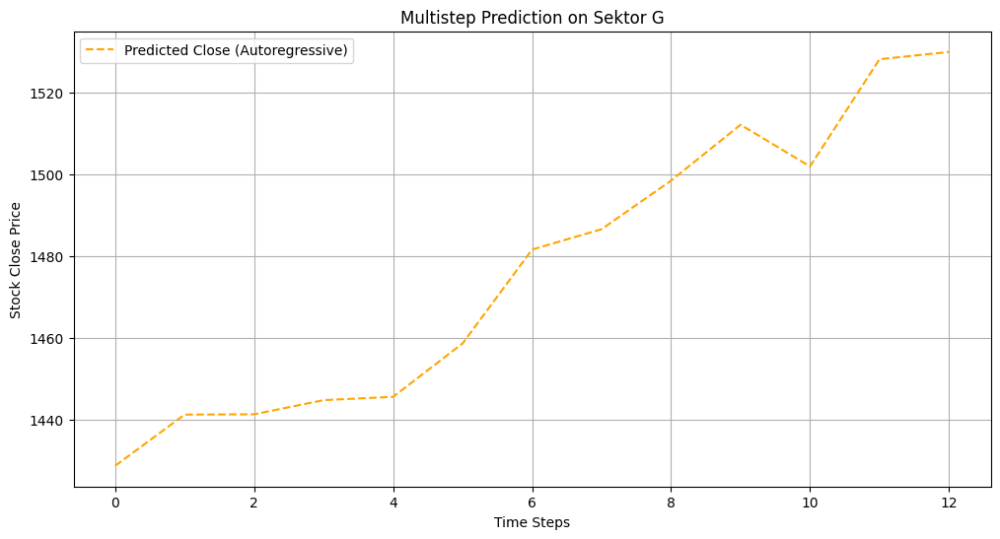

In [48]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor G
preprocessor_G = joblib.load('/kaggle/working/preprocessor/preprocessor_G.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['G']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_G.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_G, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_G_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Gunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_G.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_G.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor G')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor H

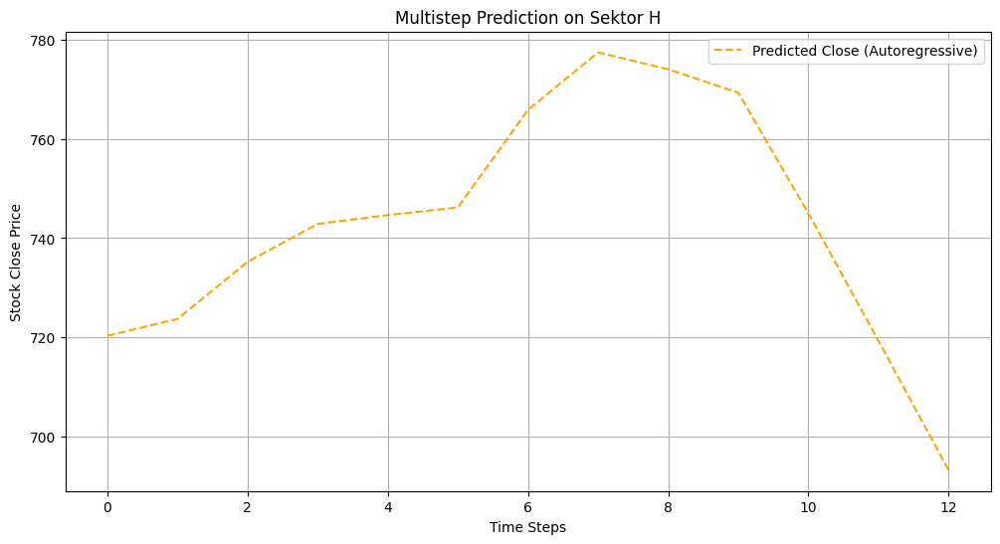

In [49]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor H
preprocessor_H = joblib.load('/kaggle/working/preprocessor/preprocessor_H.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['H']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_H.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_H, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_H_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Hunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_H.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_H.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor H')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor I

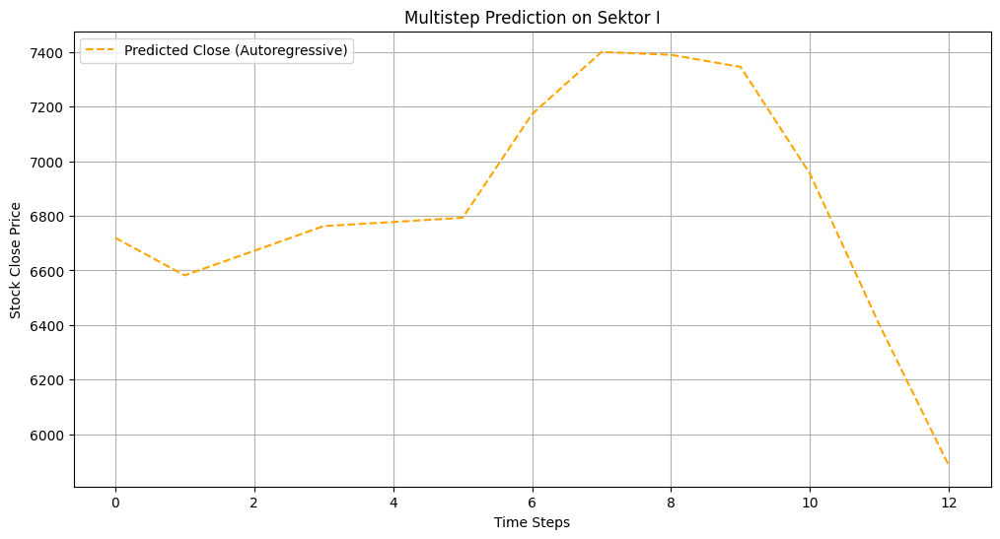

In [50]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor I
preprocessor_I = joblib.load('/kaggle/working/preprocessor/preprocessor_I.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['I']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_I.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_I, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_I_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Iunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Inverse transform
predictions_close = preprocessor_I.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_I.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor I')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor J

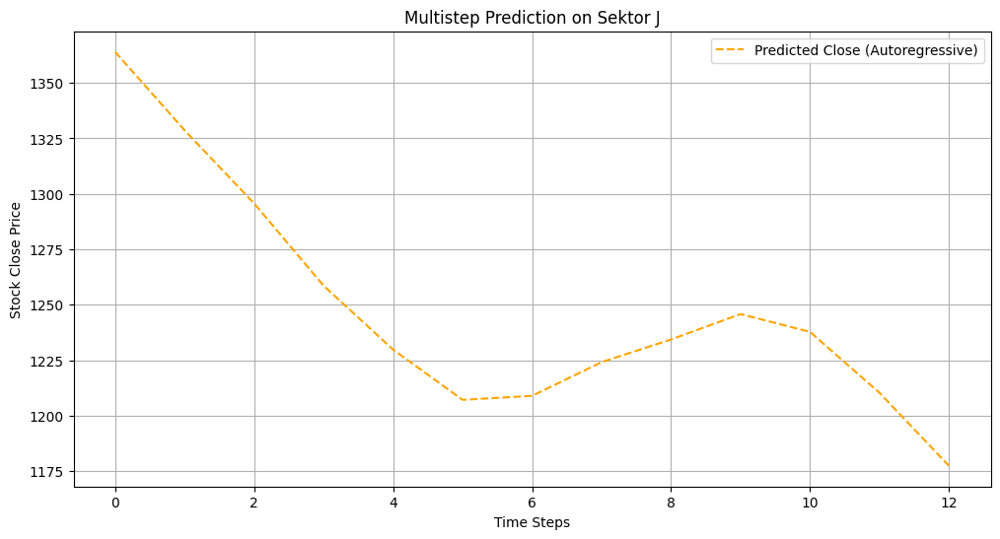

In [51]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor J
preprocessor_J = joblib.load('/kaggle/working/preprocessor/preprocessor_J.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['J']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_J.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_J, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_J_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Junakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Jnverse transform
predictions_close = preprocessor_J.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_J.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor J')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()


### Sektor K

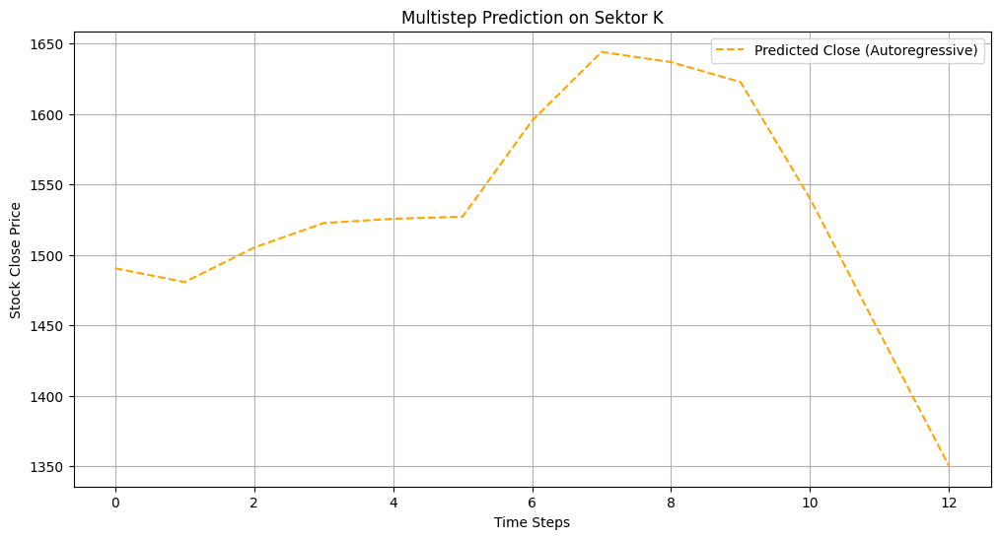

In [52]:
# Step 1: Siapkan preprocessor dan data lengkap

import joblib
timestep = 10

# Load preprocessor untuk sektor K
preprocessor_K = joblib.load('/kaggle/working/preprocessor/preprocessor_K.pkl')

# Lanjut: Transform data baru dengan preprocessor ini
df = df_stock['K']

# Transform data (tanpa fit ulang)
stock_data_scaled, target_scaled = preprocessor_K.transform_data(df)

# Atau langsung bentuk dataset untuk model:
(X_news, X_stock, y), _ = prepare_data_with_preprocessor(df, timestep=10, preprocessor=preprocessor_K, is_training=False)

# Step 2: Load model terbaik
from tensorflow.keras.models import load_model
model_path = '/kaggle/working/best_model_STACN_K_full_bi.keras'
model = load_model(model_path)

# Step 3: Tentukan split test (20% terakhir)
X_news_test = X_news
X_stock_test = X_stock
y_test = y

# Step 3: Kunakan seluruh data (no split)
X_news_test = X_news_all
X_stock_test = X_stock_all
y_test = y_all

# Step 4: Prediksi autoregresif
X_stock_ar = np.copy(X_stock_test)
X_news_input = np.copy(X_news_test)

predictions_scaled = []
current_stock_seq = X_stock_ar[0].copy()

for i in range(len(X_stock_ar)):
    input_stock = current_stock_seq[np.newaxis, ...]
    input_news = X_news_input[i][np.newaxis, ...]

    pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
    predictions_scaled.append(pred_scaled)

    if i + 1 < len(X_stock_ar):
        next_seq = X_stock_ar[i + 1].copy()
        next_seq[:-1] = current_stock_seq[1:]  # geser
        next_seq[-1] = X_stock_ar[i + 1][-1]
        next_seq[-1][3] = pred_scaled
        current_stock_seq = next_seq.copy()

# Step 5: Knverse transform
predictions_close = preprocessor_K.inverse_transform_target(np.array(predictions_scaled))
y_test_actual = preprocessor_K.inverse_transform_target(y_test)


# Step 6: Plot hasil
plt.figure(figsize=(12, 6))
plt.plot(predictions_close, label='Predicted Close (Autoregressive)', color='orange', linestyle='--')
plt.title('Multistep Prediction on Sektor K')
plt.xlabel('Time Steps')
plt.ylabel('Stock Close Price')
plt.legend()
plt.grid(True)
plt.show()



🔄 Processing sektor: A


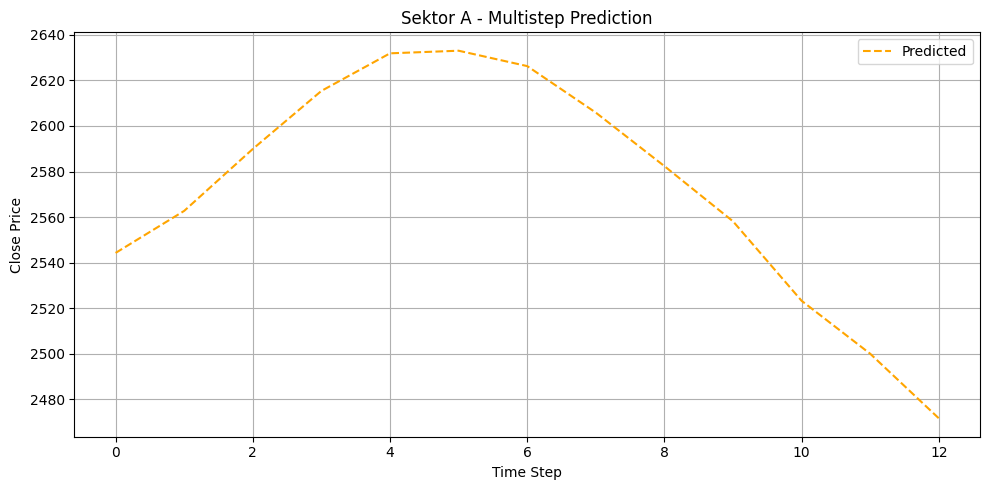


🔄 Processing sektor: B


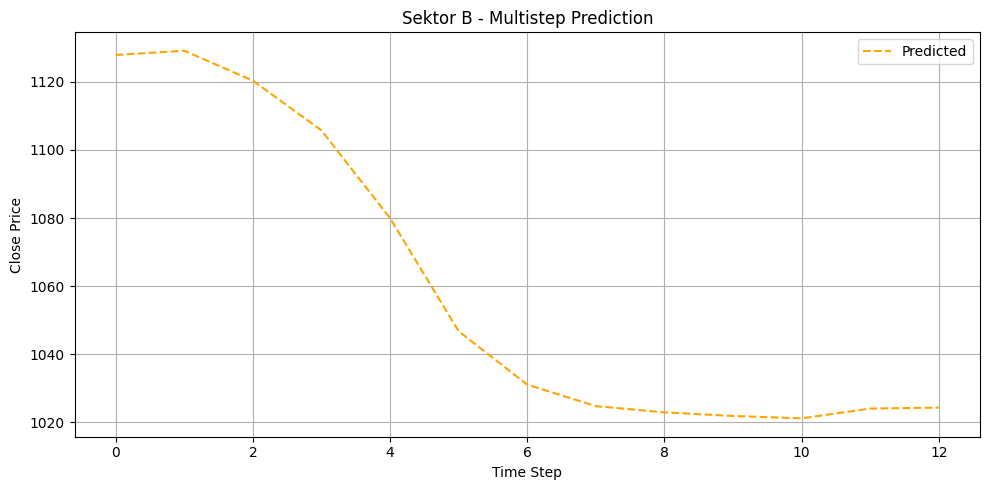


🔄 Processing sektor: C


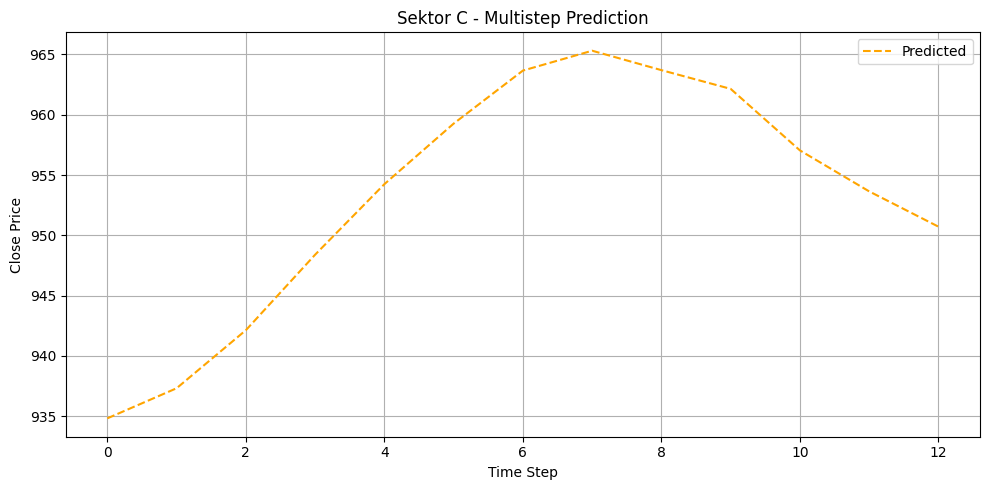


🔄 Processing sektor: D


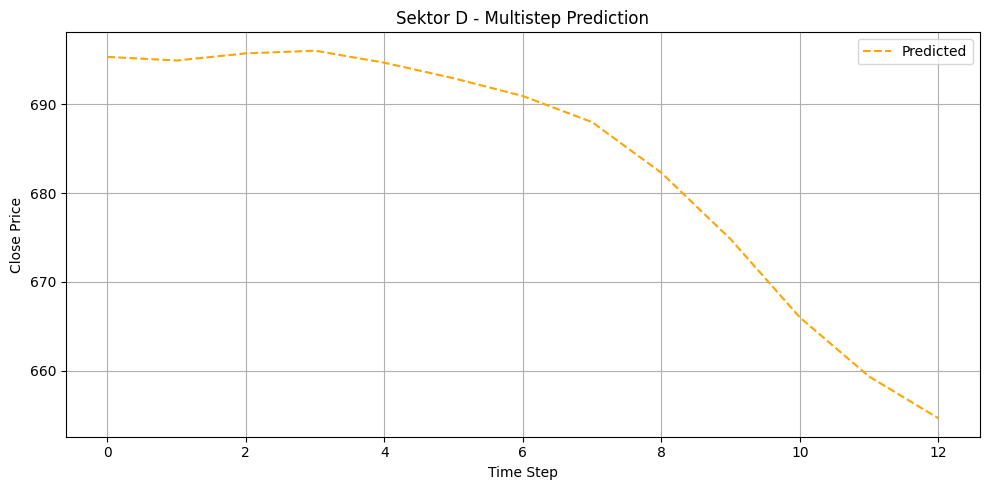


🔄 Processing sektor: E


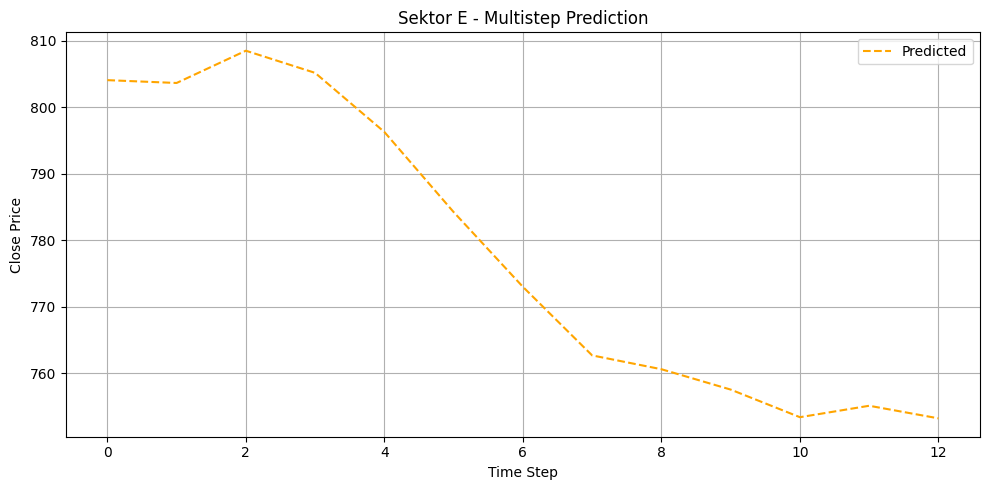


🔄 Processing sektor: F


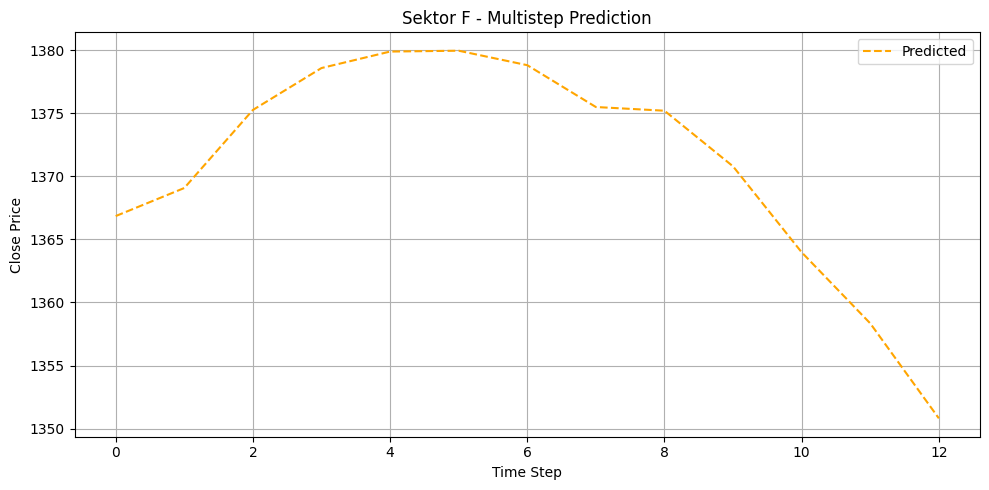


🔄 Processing sektor: G


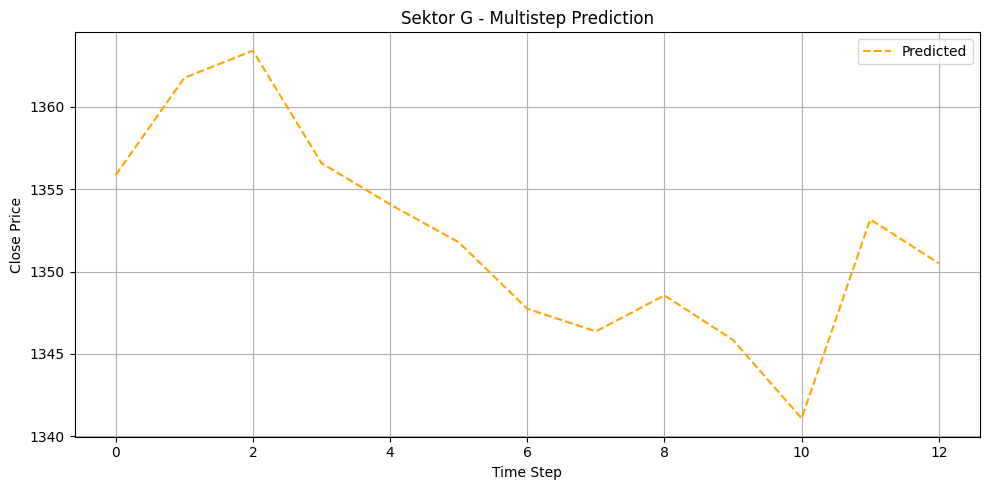


🔄 Processing sektor: H


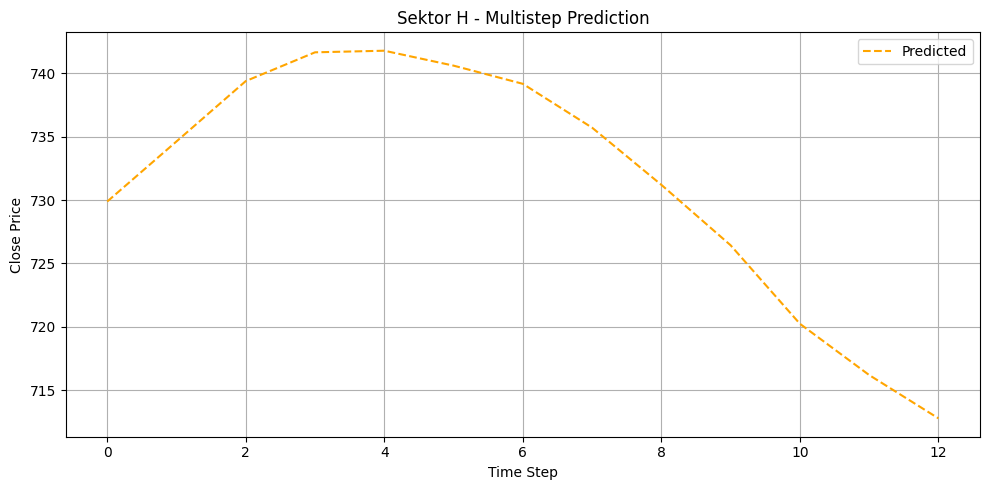


🔄 Processing sektor: I


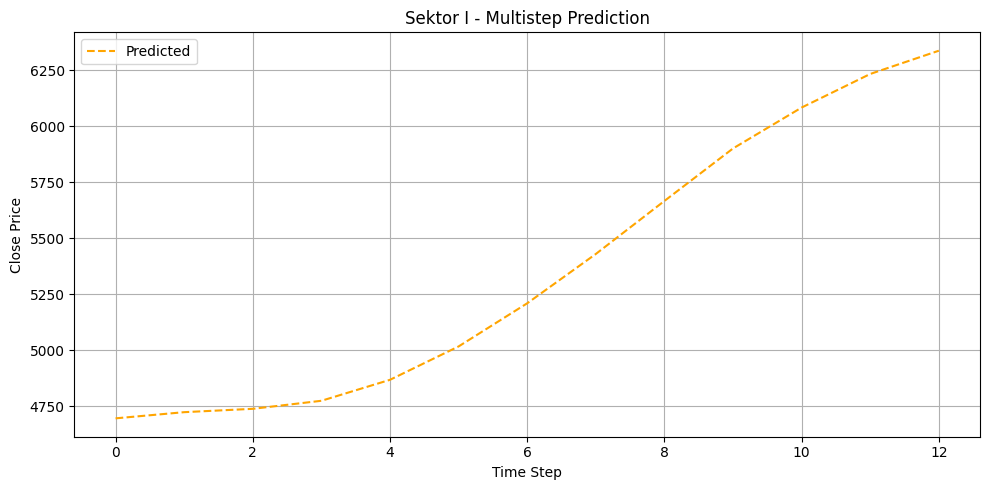


🔄 Processing sektor: J


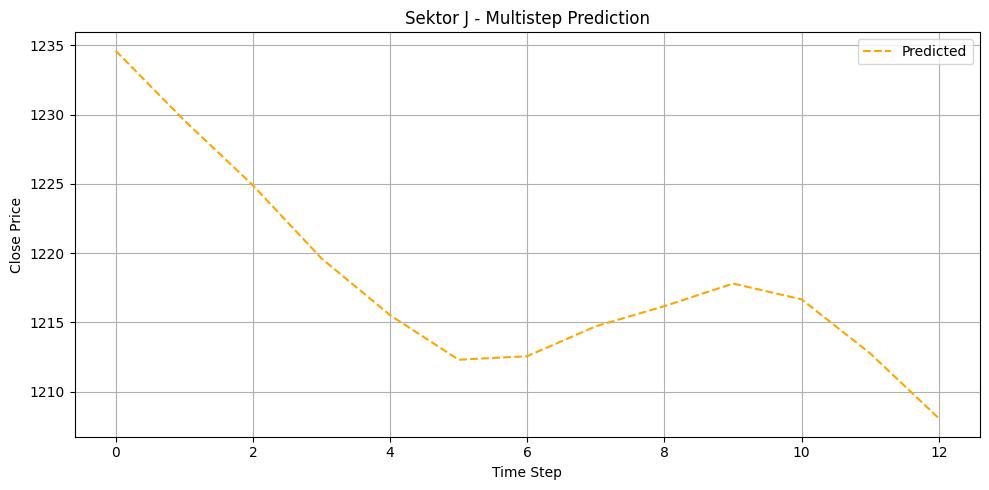

In [25]:
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np

timestep = 10
autoregressive_results = {}

for key in df_stock.keys():
    print(f"\n🔄 Processing sektor: {key}")
    
    # Step 1: Siapkan preprocessor & data
    df = df_stock[key]
    preprocessor = DataPreprocessor()
    (X_news_all, X_stock_all, y_all), preprocessor = prepare_data_with_preprocessor(
        df, timestep=timestep, is_training=True
    )
    
    # Step 2: Load model
    model_path = f'/kaggle/working/best_model_STACN_{key}_full_bi.keras'
    model = load_model(model_path)

    # Step 3: Gunakan seluruh data tanpa split
    X_news_test = X_news_all
    X_stock_test = X_stock_all
    y_test = y_all

    # Step 4: Autoregressive prediction
    X_stock_ar = np.copy(X_stock_test)
    X_news_input = np.copy(X_news_test)

    predictions_scaled = []
    current_stock_seq = X_stock_ar[0].copy()

    for i in range(len(X_stock_ar)):
        input_stock = current_stock_seq[np.newaxis, ...]
        input_news = X_news_input[i][np.newaxis, ...]

        pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
        predictions_scaled.append(pred_scaled)

        if i + 1 < len(X_stock_ar):
            next_seq = X_stock_ar[i + 1].copy()
            next_seq[:-1] = current_stock_seq[1:]
            next_seq[-1] = X_stock_ar[i + 1][-1]
            next_seq[-1][3] = pred_scaled 
            current_stock_seq = next_seq.copy()

    # Step 5: Inverse transform
    predictions_scaled = np.array(predictions_scaled)
    predictions_close = preprocessor.inverse_transform_target(predictions_scaled)
    y_test_actual = preprocessor.inverse_transform_target(y_test)

    # Step 6: Simpan hasil
    autoregressive_results[key] = {
        'predicted': predictions_close,
        'actual': y_test_actual,
    }

    # Step 7: Plot
    plt.figure(figsize=(10, 5))
    #plt.plot(y_test_actual, label='Actual', color='green')
    plt.plot(predictions_close, label='Predicted', color='orange', linestyle='--')
    plt.title(f'Sektor {key} - Multistep Prediction')
    plt.xlabel('Time Step')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# MULTISTEP TESTING


🔄 Processing sektor: A


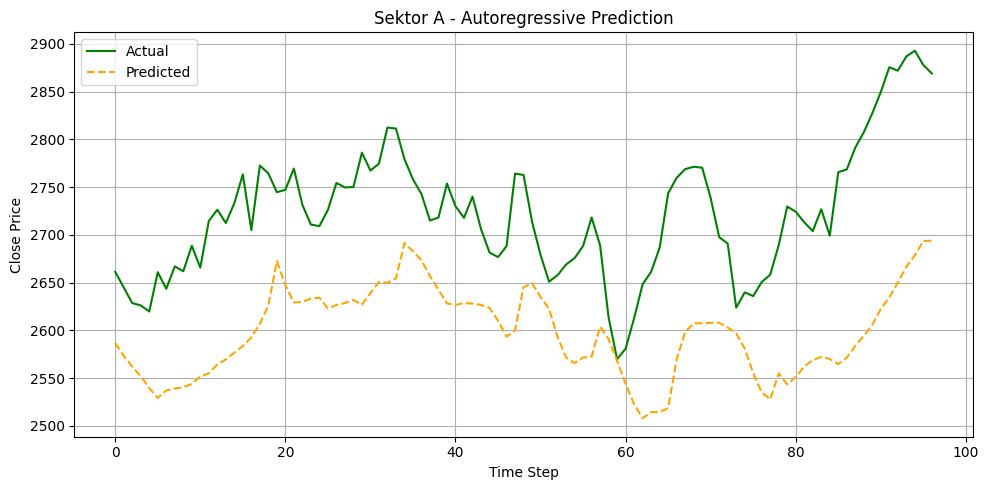


🔄 Processing sektor: B


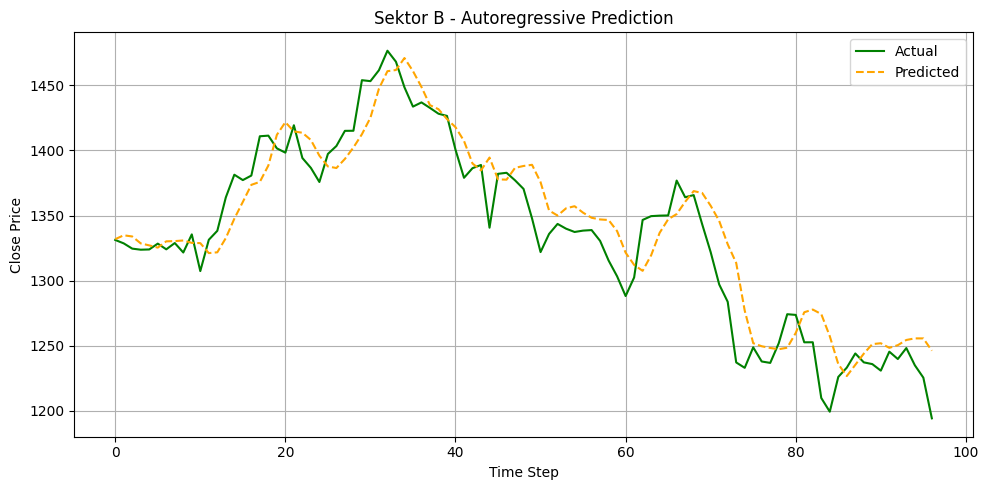


🔄 Processing sektor: C


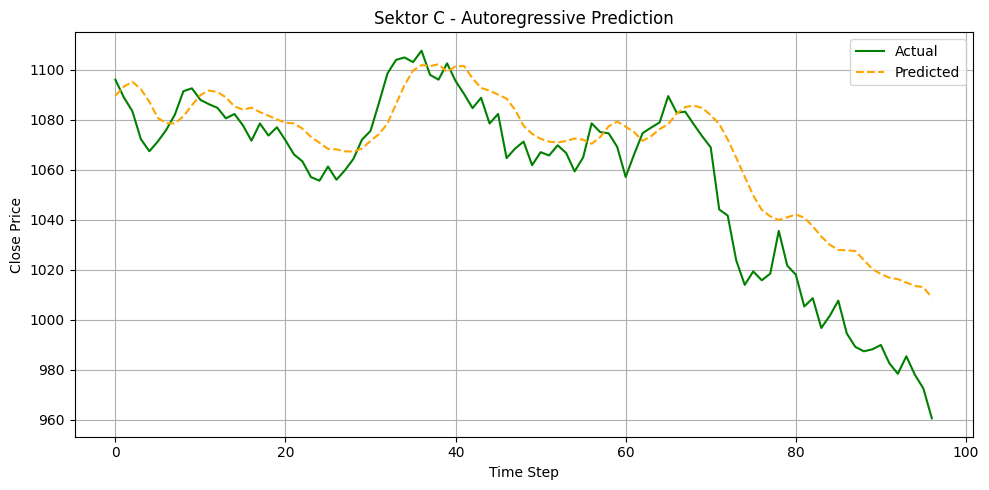


🔄 Processing sektor: D


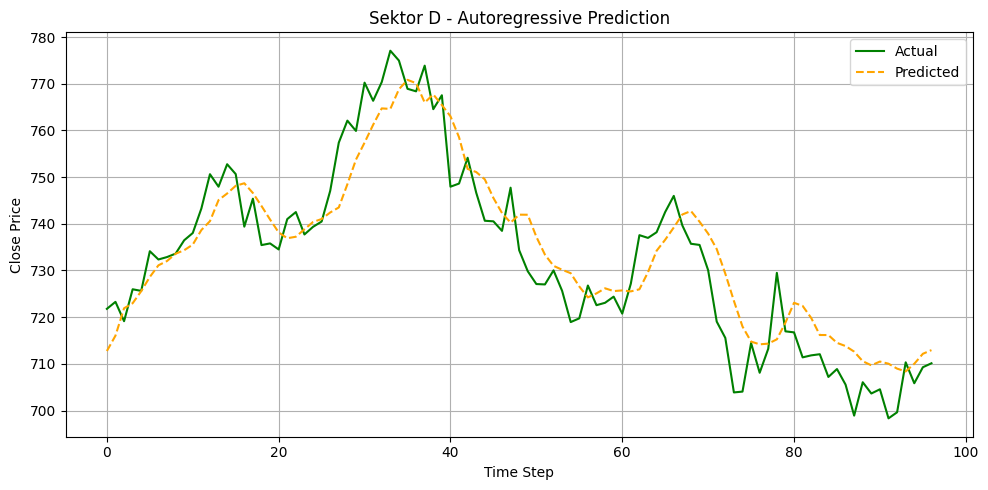


🔄 Processing sektor: E


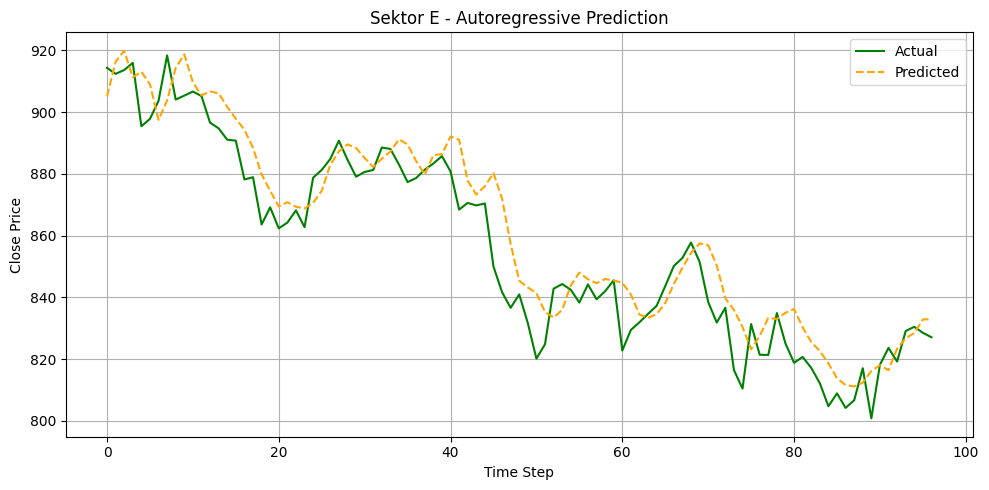


🔄 Processing sektor: F


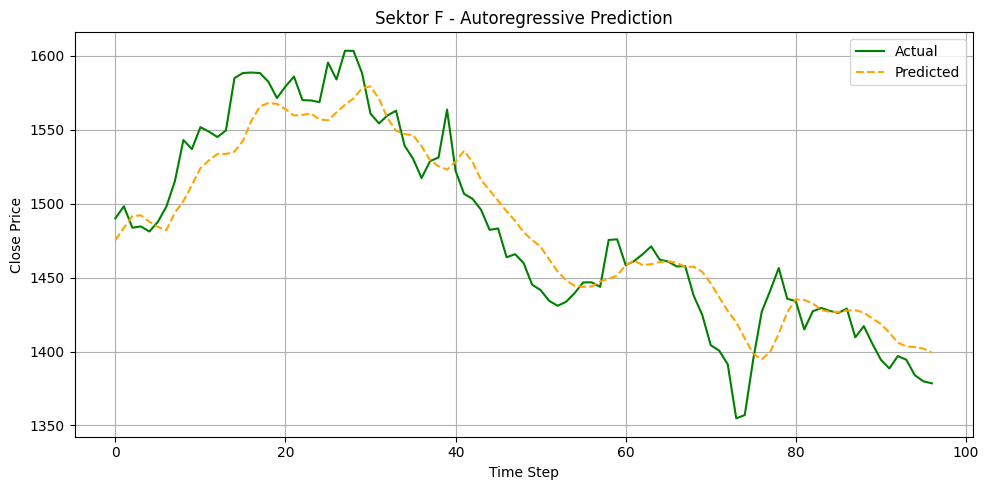


🔄 Processing sektor: G


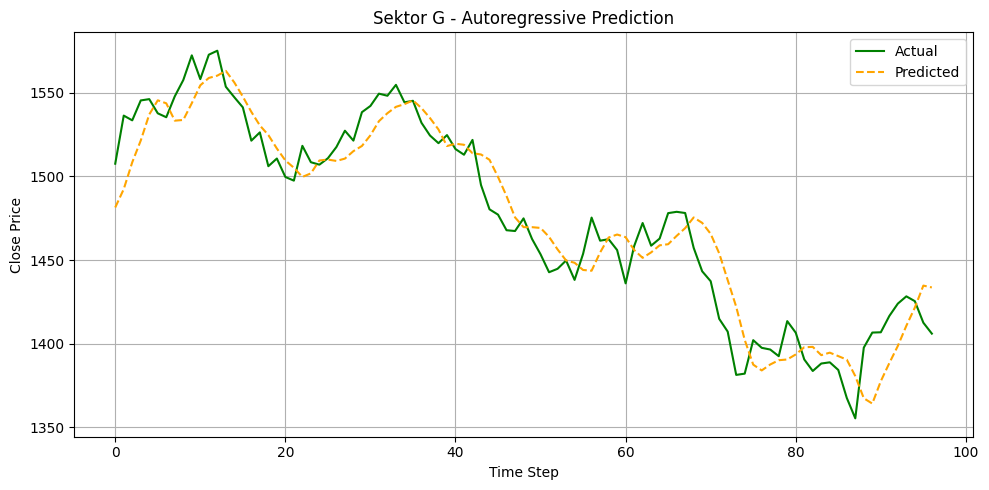


🔄 Processing sektor: H


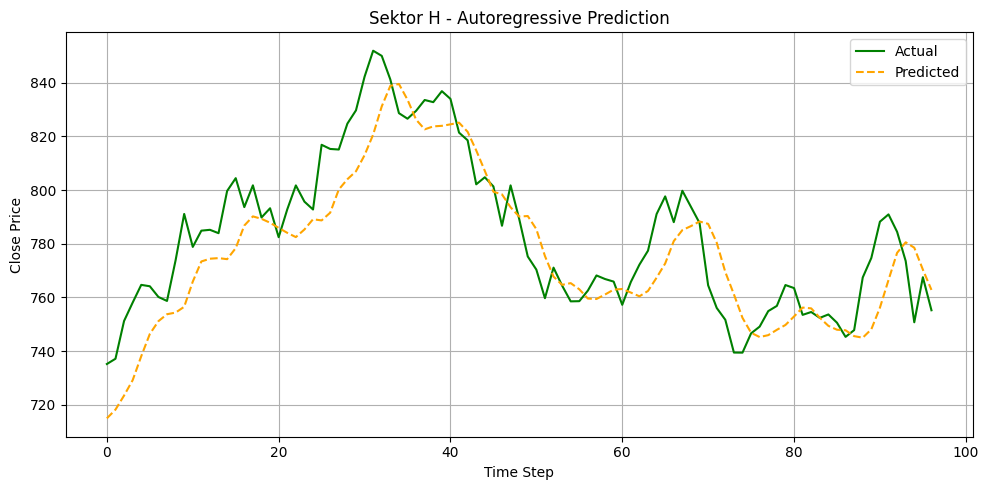


🔄 Processing sektor: I


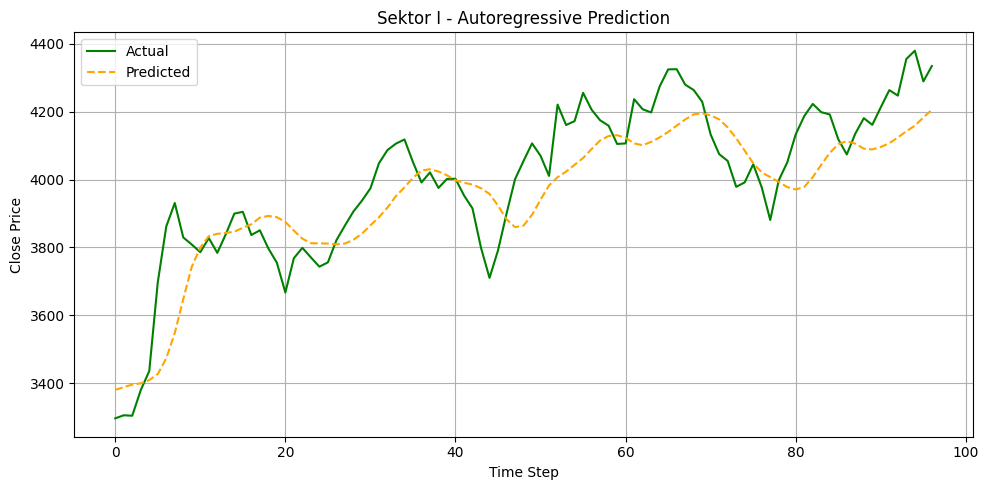


🔄 Processing sektor: J


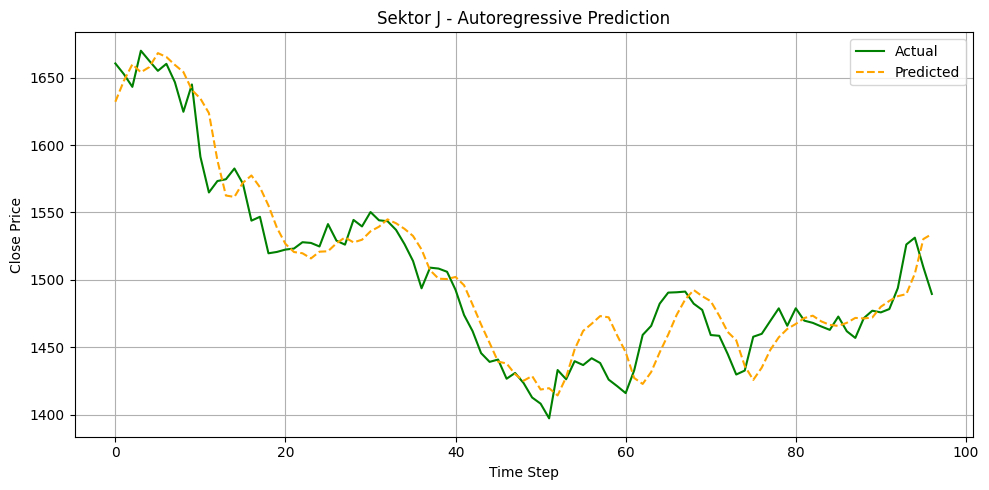


🔄 Processing sektor: K


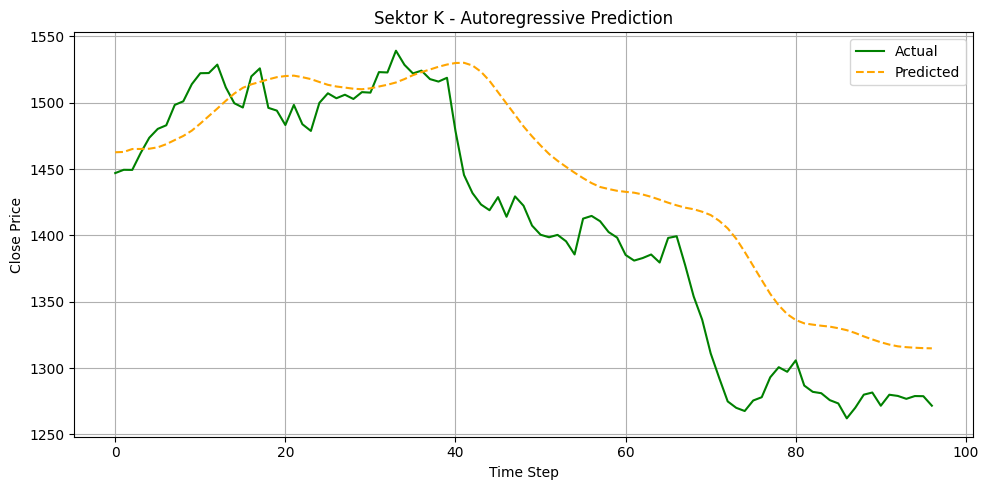

In [12]:
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np

timestep = 10
autoregressive_results = {}

for key in data.keys():
    print(f"\n🔄 Processing sektor: {key}")
    
    # Step 1: Siapkan preprocessor & data
    df = data[key]
    preprocessor = DataPreprocessor()
    (X_news_all, X_stock_all, y_all), preprocessor = prepare_data_with_preprocessor(
        df, timestep=timestep, is_training=True
    )
    
    # Step 2: Load model
    model_path = f'/kaggle/working/best_model_STACN_{key}_full_conv.keras'
    model = load_model(model_path)
    
    # Step 3: Split 80-20
    split_index = int(len(X_news_all) * 0.90)
    X_news_test = X_news_all[split_index:]
    X_stock_test = X_stock_all[split_index:]
    y_test = y_all[split_index:]
    
    # Step 4: Autoregressive prediction
    X_stock_ar = np.copy(X_stock_test)
    X_news_input = np.copy(X_news_test)

    predictions_scaled = []
    current_stock_seq = X_stock_ar[0].copy()

    for i in range(len(X_stock_ar)):
        input_stock = current_stock_seq[np.newaxis, ...]
        input_news = X_news_input[i][np.newaxis, ...]

        pred_scaled = model.predict([input_news, input_stock], verbose=0)[0][0]
        predictions_scaled.append(pred_scaled)

        if i + 1 < len(X_stock_ar):
            next_seq = X_stock_ar[i + 1].copy()
            next_seq[:-1] = current_stock_seq[1:]
            next_seq[-1] = X_stock_ar[i + 1][-1]
            next_seq[-1][3] = pred_scaled 
            current_stock_seq = next_seq.copy()

    # Step 5: Inverse transform
    predictions_scaled = np.array(predictions_scaled)
    predictions_close = preprocessor.inverse_transform_target(predictions_scaled)
    y_test_actual = preprocessor.inverse_transform_target(y_test)

    # Step 6: Simpan hasil
    autoregressive_results[key] = {
        'predicted': predictions_close,
        'actual': y_test_actual,
    }

    # Step 7: Plot
    plt.figure(figsize=(10, 5))
    plt.plot(y_test_actual, label='Actual', color='green')
    plt.plot(predictions_close, label='Predicted', color='orange', linestyle='--')
    plt.title(f'Sektor {key} - Autoregressive Prediction')
    plt.xlabel('Time Step')
    plt.ylabel('Close Price')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# TESTING UNISTEP


Processing dataset: A with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_A_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
Evaluation Metrics for full_bi:
mae_test    : 44.1648
rmse_test   : 53.1721
mse_test    : 2827.2755
r2_test     : 0.9367
mape_test   : 1.7047

Processing dataset: A with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_A_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 52ms/step
Evaluation Metrics for full_conv:
mae_test    : 74.4361
rmse_test   : 86.8095
mse_test    : 7535.8845
r2_test     : 0.8314
mape_test   : 2.8448

Processing dataset: A with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_A_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 74ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 69.0726
rmse_test   : 81.0416
mse_test    : 6567.7475
r2_test     : 0.8530
mape_test   : 2.6325

Processing dataset: A with ablation mode: no_attention_con

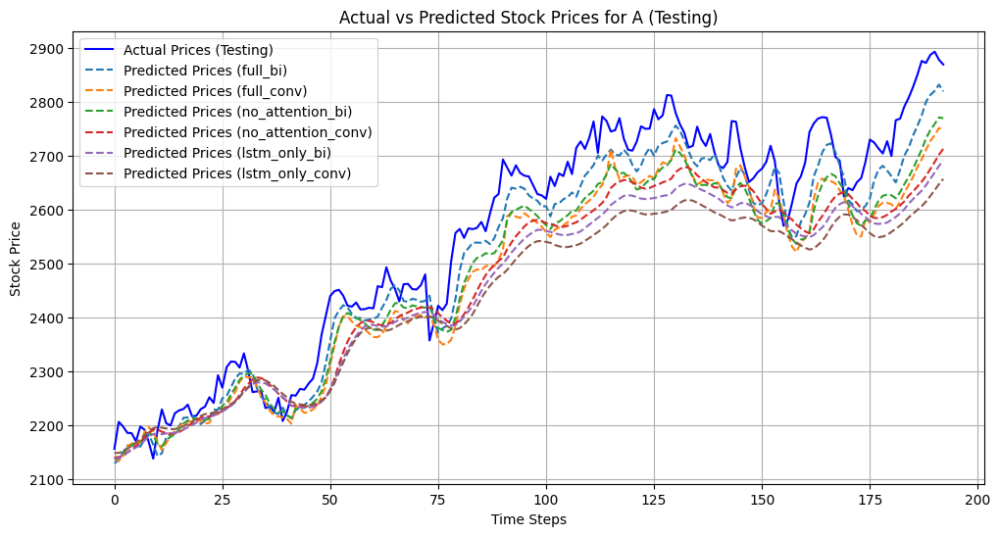

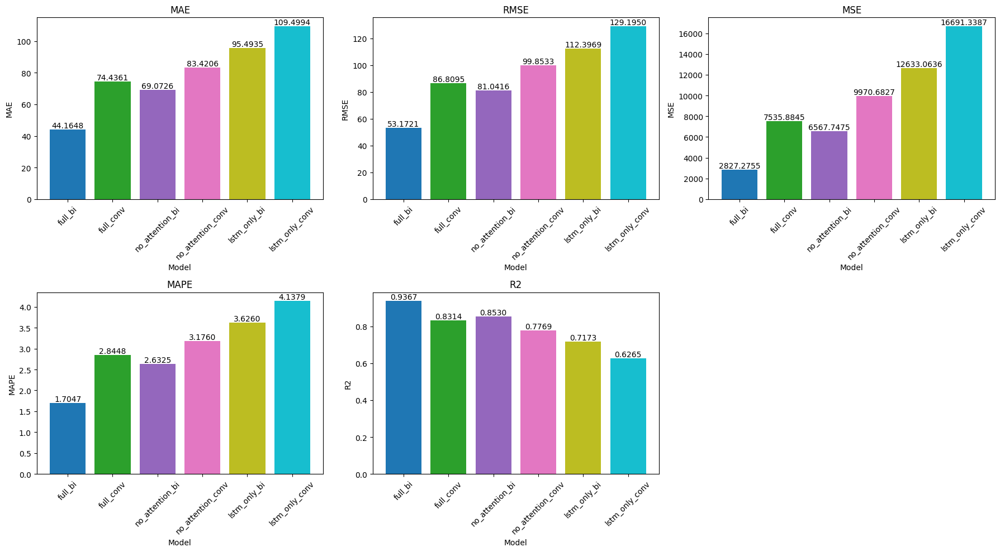

In [38]:
# TESTING A

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "A"
model_paths = {
    'full_bi'	   : ('/kaggle/working/best_model_STACN_A_full_bi.keras', True), 
    'full_conv'	   : ('/kaggle/working/best_model_STACN_A_full_conv.keras', True),
    'no_attention_bi'  : ('/kaggle/working/best_model_STACN_A_no_attention_bi.keras', True),
    'no_attention_conv': ('/kaggle/working/best_model_STACN_A_no_attention_conv.keras', True),
    'lstm_only_bi'	   : ('/kaggle/working/best_model_STACN_A_lstm_only_bi.keras', True),
    'lstm_only_conv'   : ('/kaggle/working/best_model_STACN_A_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: B with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_B_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step
Evaluation Metrics for full_bi:
mae_test    : 13.4366
rmse_test   : 18.2333
mse_test    : 332.4521
r2_test     : 0.8974
mape_test   : 0.9994

Processing dataset: B with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_B_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step
Evaluation Metrics for full_conv:
mae_test    : 13.8837
rmse_test   : 19.0116
mse_test    : 361.4414
r2_test     : 0.8884
mape_test   : 1.0384

Processing dataset: B with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_B_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 73ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 15.9581
rmse_test   : 20.4810
mse_test    : 419.4710
r2_test     : 0.8705
mape_test   : 1.1818

Processing dataset: B with ablation mode: no_attention_conv
M

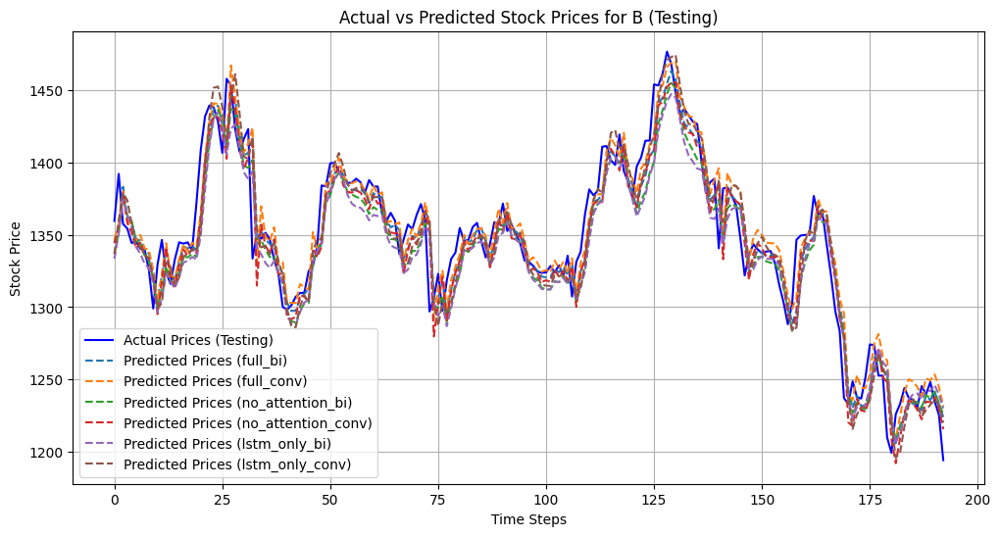

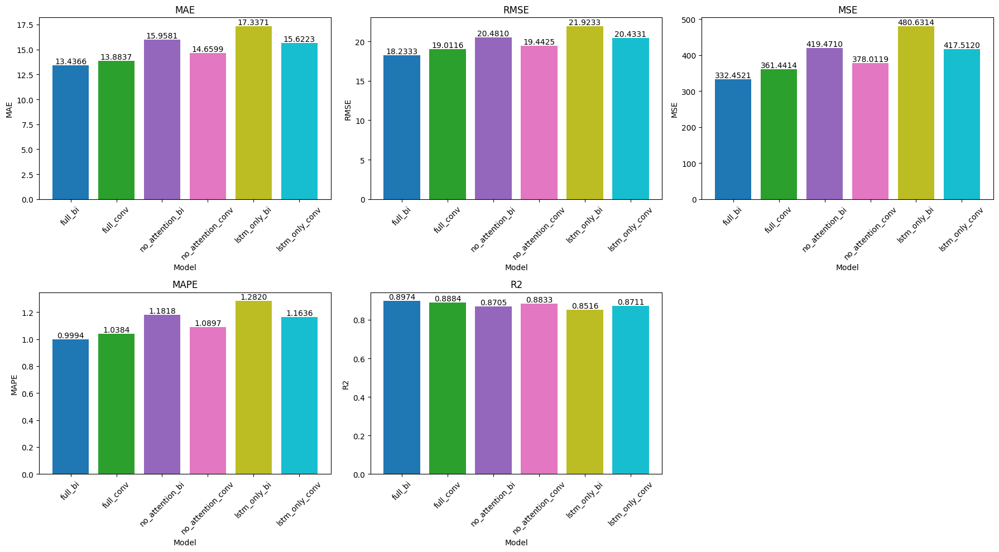

In [39]:
# TESTING B

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "B"
model_paths = {
    'full_bi'	   : ('/kaggle/working/best_model_STACN_B_full_bi.keras', True), 
    'full_conv'	   : ('/kaggle/working/best_model_STACN_B_full_conv.keras', True),
    'no_attention_bi'  : ('/kaggle/working/best_model_STACN_B_no_attention_bi.keras', True),
    'no_attention_conv': ('/kaggle/working/best_model_STACN_B_no_attention_conv.keras', True),
    'lstm_only_bi'	   : ('/kaggle/working/best_model_STACN_B_lstm_only_bi.keras', True),
    'lstm_only_conv'   : ('/kaggle/working/best_model_STACN_B_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: C with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_C_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 83ms/step
Evaluation Metrics for full_bi:
mae_test    : 12.2674
rmse_test   : 15.8473
mse_test    : 251.1369
r2_test     : 0.8996
mape_test   : 1.2029

Processing dataset: C with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_C_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step
Evaluation Metrics for full_conv:
mae_test    : 13.1968
rmse_test   : 18.0265
mse_test    : 324.9546
r2_test     : 0.8701
mape_test   : 1.3213

Processing dataset: C with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_C_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 72ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 13.2222
rmse_test   : 18.0196
mse_test    : 324.7045
r2_test     : 0.8702
mape_test   : 1.2891

Processing dataset: C with ablation mode: no_attention_conv
M

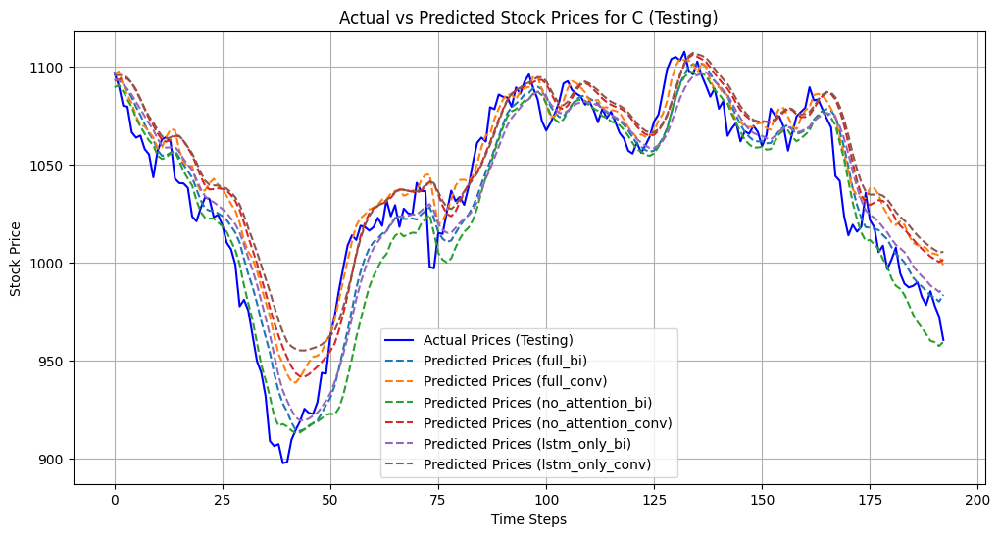

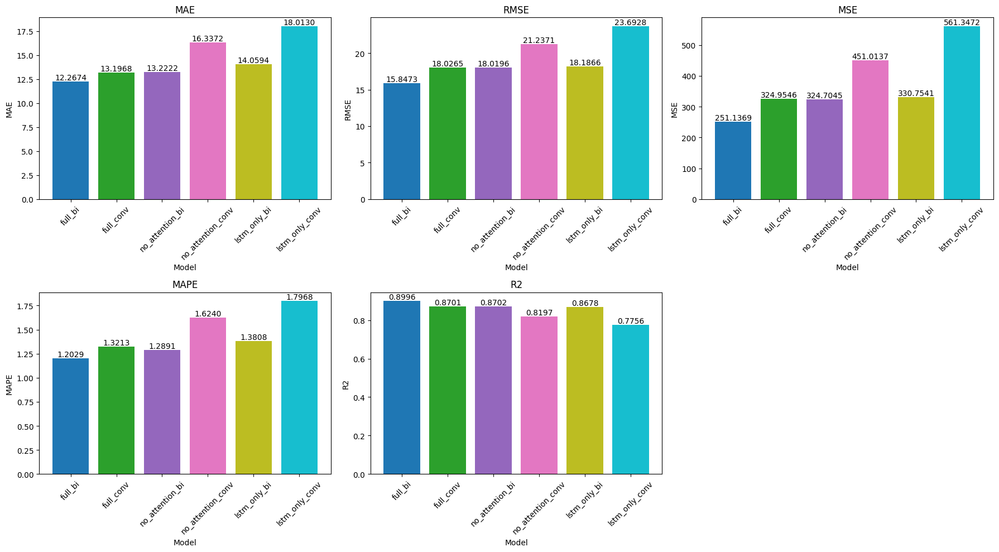

In [40]:
# TESTING C

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "C"
model_paths = {
    'full_bi'	   : ('/kaggle/working/best_model_STACN_C_full_bi.keras', True), 
    'full_conv'	   : ('/kaggle/working/best_model_STACN_C_full_conv.keras', True),
    'no_attention_bi'  : ('/kaggle/working/best_model_STACN_C_no_attention_bi.keras', True),
    'no_attention_conv': ('/kaggle/working/best_model_STACN_C_no_attention_conv.keras', True),
    'lstm_only_bi'	   : ('/kaggle/working/best_model_STACN_C_lstm_only_bi.keras', True),
    'lstm_only_conv'   : ('/kaggle/working/best_model_STACN_C_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: D with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_D_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step
Evaluation Metrics for full_bi:
mae_test    : 5.4235
rmse_test   : 7.2224
mse_test    : 52.1632
r2_test     : 0.8977
mape_test   : 0.7560

Processing dataset: D with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_D_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step
Evaluation Metrics for full_conv:
mae_test    : 4.7792
rmse_test   : 6.2461
mse_test    : 39.0136
r2_test     : 0.9235
mape_test   : 0.6689

Processing dataset: D with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_D_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 75ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 6.1986
rmse_test   : 8.1498
mse_test    : 66.4189
r2_test     : 0.8697
mape_test   : 0.8628

Processing dataset: D with ablation mode: no_attention_conv
Model /kag

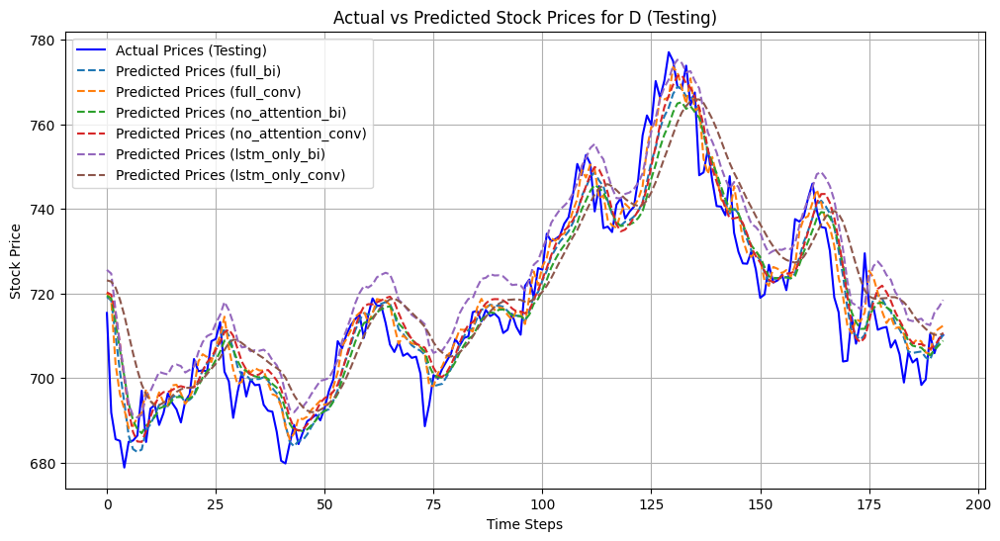

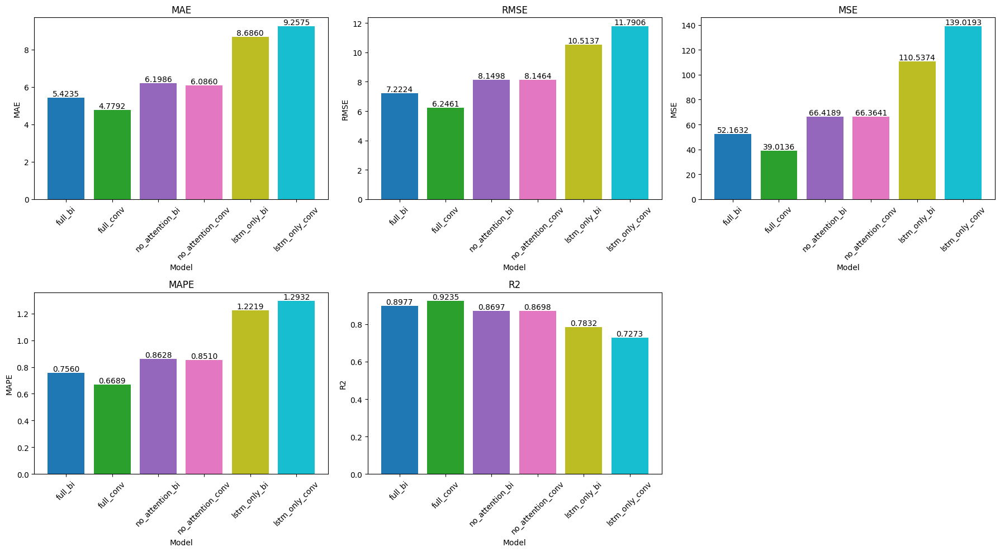

In [41]:
# TESTING D

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "D"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: E with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_E_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step
Evaluation Metrics for full_bi:
mae_test    : 7.1871
rmse_test   : 9.6536
mse_test    : 93.1917
r2_test     : 0.9768
mape_test   : 0.8913

Processing dataset: E with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_E_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 135ms/step
Evaluation Metrics for full_conv:
mae_test    : 7.3585
rmse_test   : 10.0183
mse_test    : 100.3654
r2_test     : 0.9751
mape_test   : 0.9081

Processing dataset: E with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_E_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 75ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 7.4184
rmse_test   : 9.5744
mse_test    : 91.6693
r2_test     : 0.9772
mape_test   : 0.9207

Processing dataset: E with ablation mode: no_attention_conv
Model /

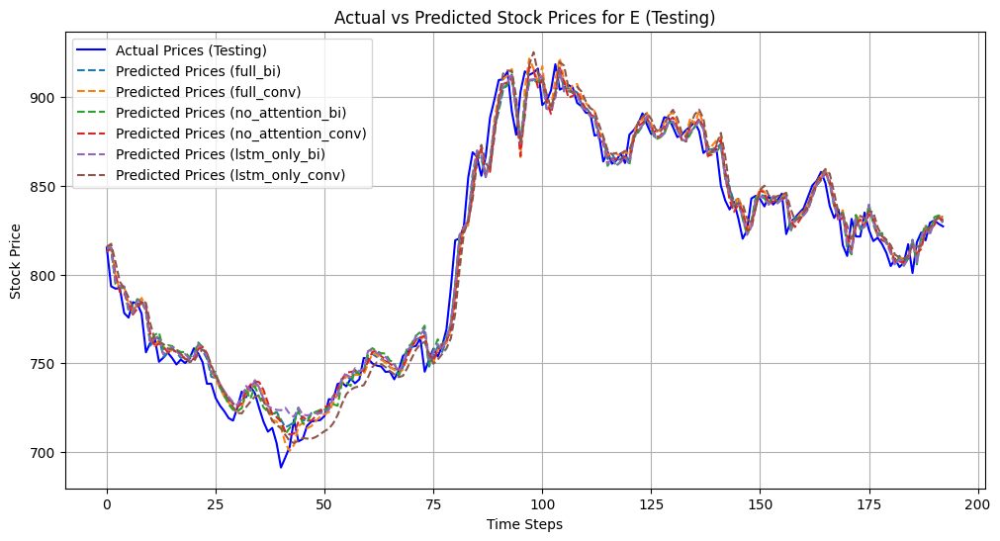

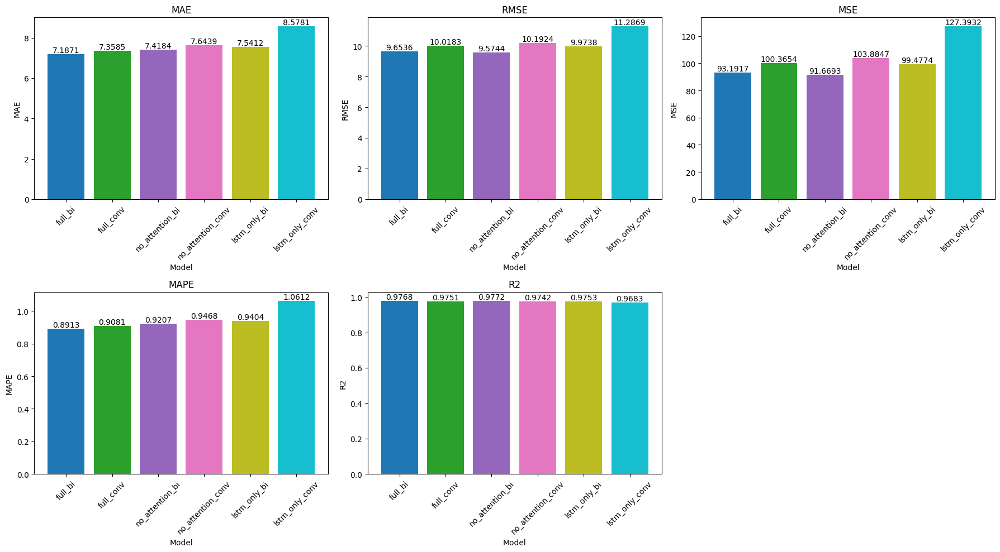

In [42]:
# TESTING E

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "E"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: F with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_F_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step
Evaluation Metrics for full_bi:
mae_test    : 12.9823
rmse_test   : 17.1202
mse_test    : 293.1017
r2_test     : 0.9244
mape_test   : 0.8978

Processing dataset: F with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_F_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step
Evaluation Metrics for full_conv:
mae_test    : 13.0548
rmse_test   : 17.1190
mse_test    : 293.0604
r2_test     : 0.9244
mape_test   : 0.9041

Processing dataset: F with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_F_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 77ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 13.3271
rmse_test   : 16.8459
mse_test    : 283.7858
r2_test     : 0.9268
mape_test   : 0.9192

Processing dataset: F with ablation mode: no_attention_conv
M

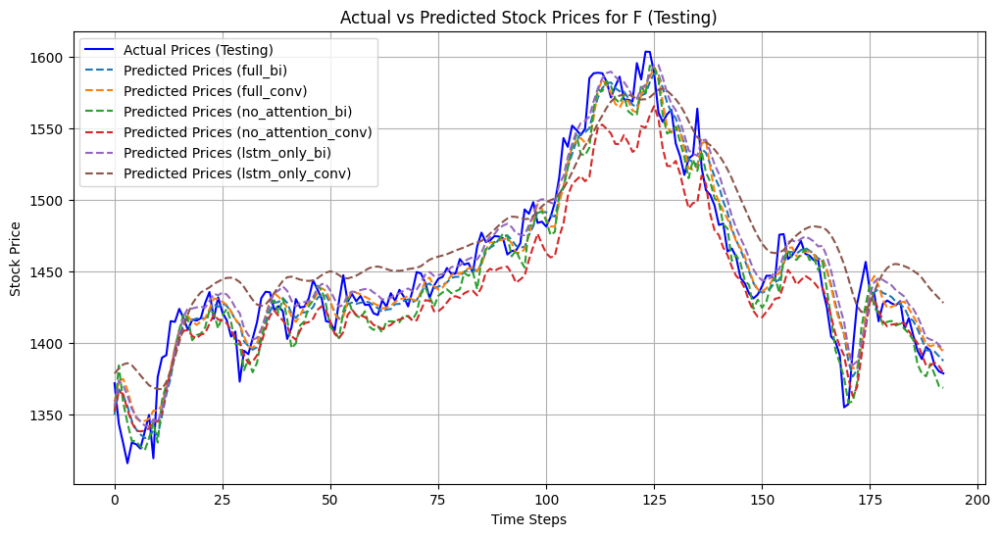

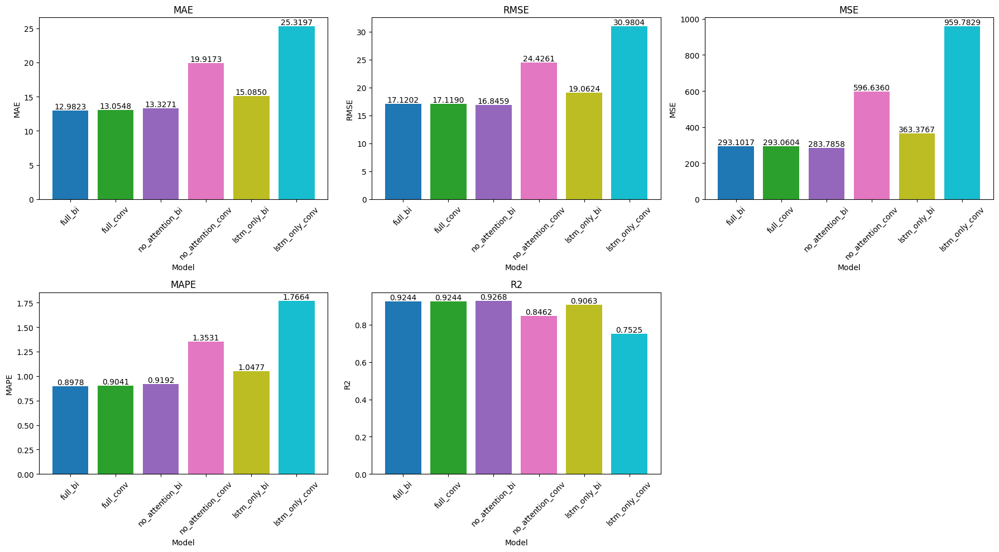

In [43]:
# TESTING F

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "F"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: G with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_G_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 88ms/step
Evaluation Metrics for full_bi:
mae_test    : 10.7417
rmse_test   : 13.7307
mse_test    : 188.5335
r2_test     : 0.9555
mape_test   : 0.7512

Processing dataset: G with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_G_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step
Evaluation Metrics for full_conv:
mae_test    : 10.8841
rmse_test   : 13.4789
mse_test    : 181.6805
r2_test     : 0.9571
mape_test   : 0.7605

Processing dataset: G with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_G_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 11.9110
rmse_test   : 15.1120
mse_test    : 228.3713
r2_test     : 0.9461
mape_test   : 0.8319

Processing dataset: G with ablation mode: no_attention_conv
M

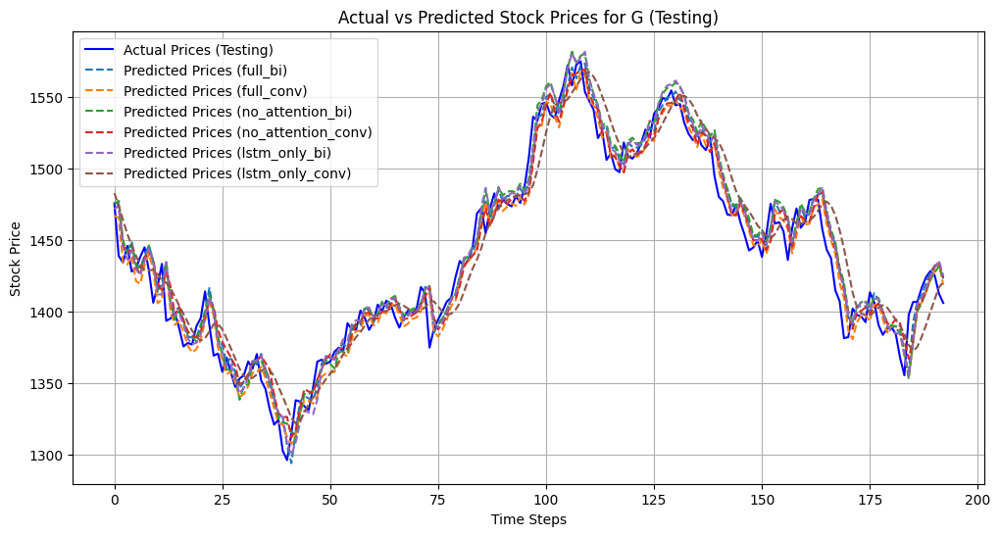

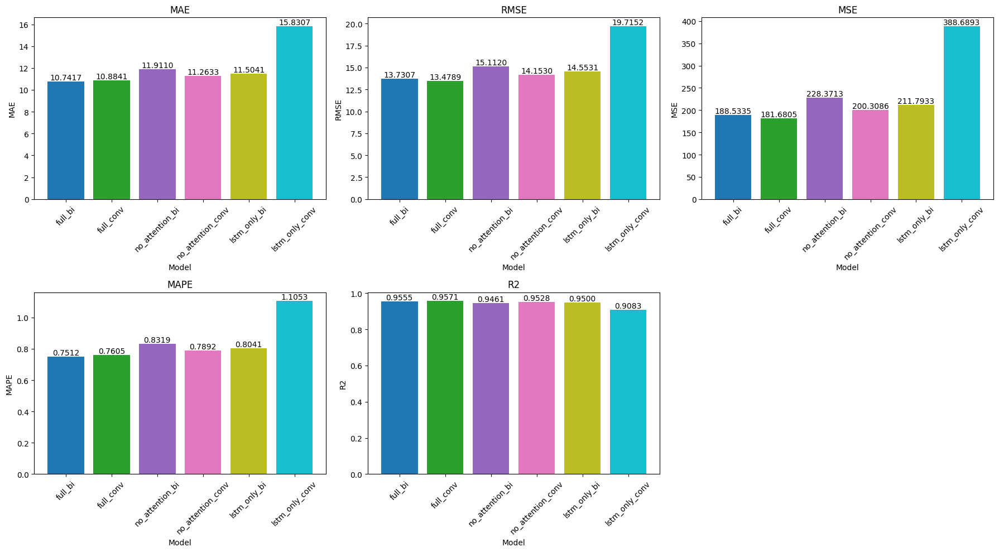

In [44]:
# TESTING G

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "G"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: H with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_H_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step
Evaluation Metrics for full_bi:
mae_test    : 11.8112
rmse_test   : 14.6615
mse_test    : 214.9594
r2_test     : 0.9666
mape_test   : 1.6554

Processing dataset: H with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_H_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step
Evaluation Metrics for full_conv:
mae_test    : 11.7629
rmse_test   : 15.0275
mse_test    : 225.8248
r2_test     : 0.9649
mape_test   : 1.7427

Processing dataset: H with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_H_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 74ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 20.5147
rmse_test   : 24.8793
mse_test    : 618.9782
r2_test     : 0.9037
mape_test   : 2.8598

Processing dataset: H with ablation mode: no_attention_conv
M

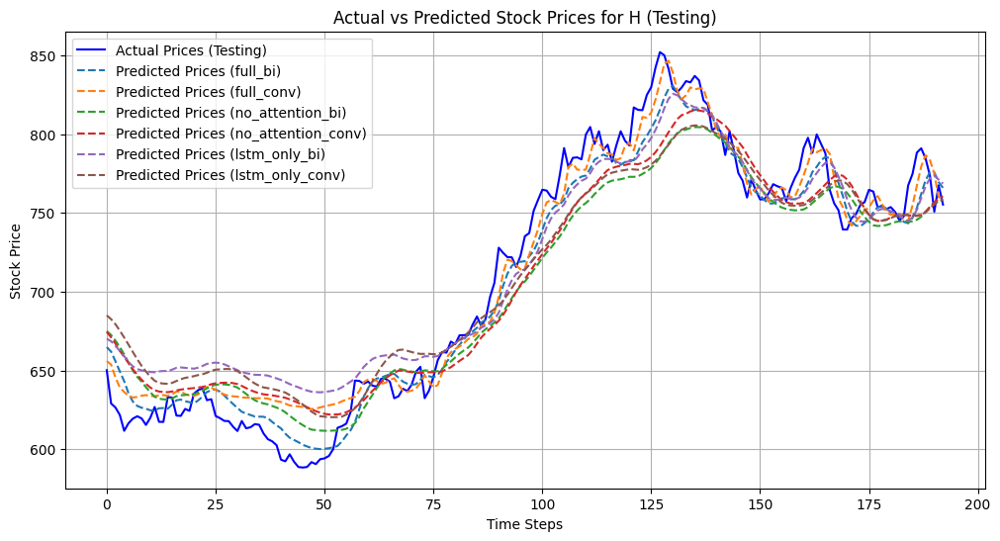

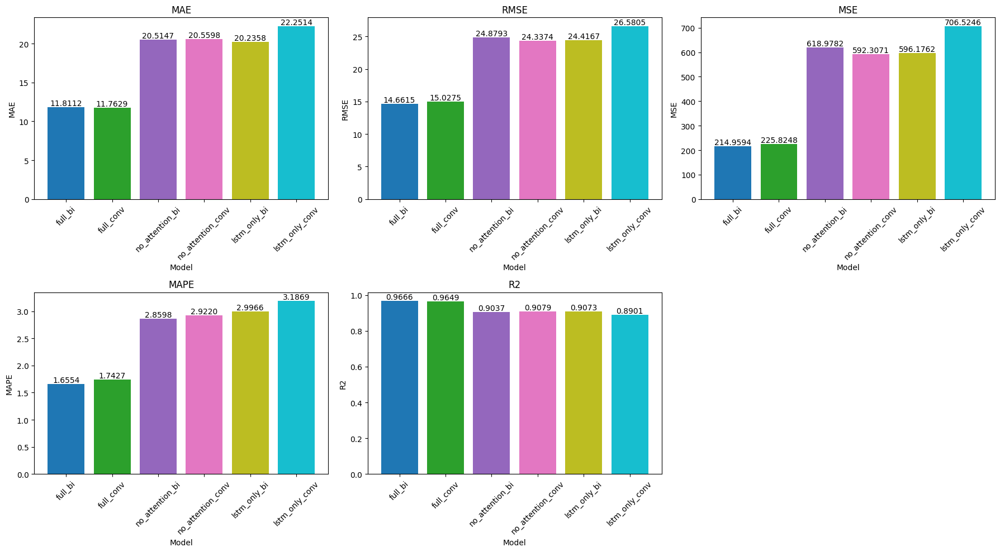

In [45]:
# TESTING H

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "H"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: I with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_I_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 84ms/step
Evaluation Metrics for full_bi:
mae_test    : 87.3700
rmse_test   : 117.3791
mse_test    : 13777.8518
r2_test     : 0.9095
mape_test   : 2.3440

Processing dataset: I with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_I_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step
Evaluation Metrics for full_conv:
mae_test    : 92.6632
rmse_test   : 113.7537
mse_test    : 12939.9066
r2_test     : 0.9150
mape_test   : 2.5744

Processing dataset: I with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_I_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 82ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 95.7935
rmse_test   : 124.1393
mse_test    : 15410.5541
r2_test     : 0.8988
mape_test   : 2.6128

Processing dataset: I with ablation mode: no_attenti

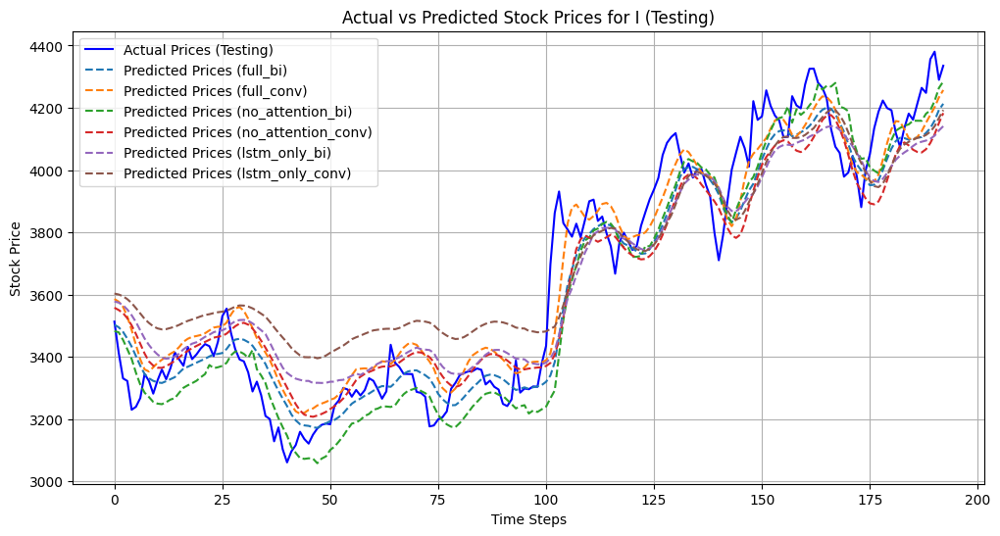

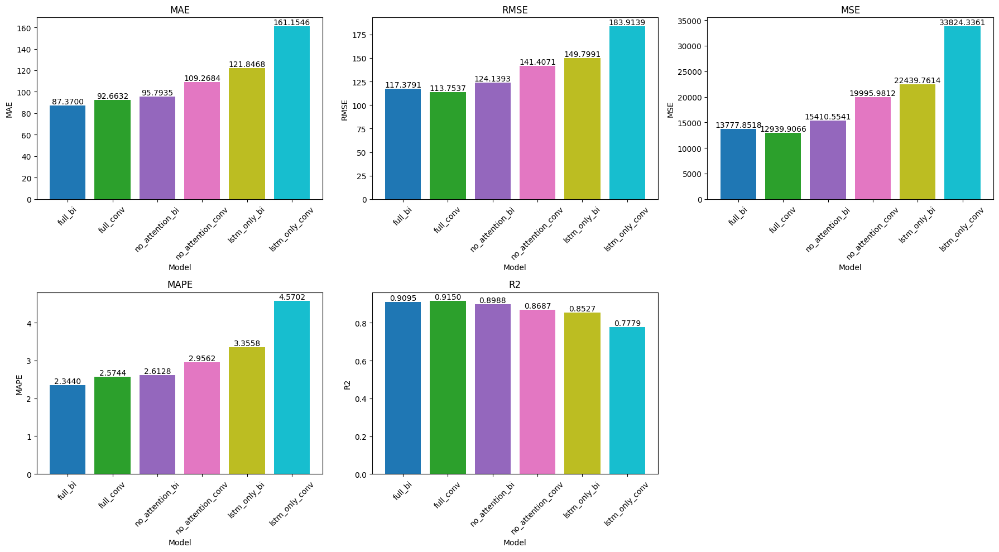

In [46]:
# TESTING I

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "I"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: J with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_J_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 176ms/step
Evaluation Metrics for full_bi:
mae_test    : 44.0363
rmse_test   : 50.5179
mse_test    : 2552.0598
r2_test     : 0.4486
mape_test   : 2.8382

Processing dataset: J with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_J_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 55ms/step
Evaluation Metrics for full_conv:
mae_test    : 13.0860
rmse_test   : 16.6982
mse_test    : 278.8299
r2_test     : 0.9398
mape_test   : 0.8552

Processing dataset: J with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_J_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 79ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 50.4147
rmse_test   : 58.4485
mse_test    : 3416.2254
r2_test     : 0.2618
mape_test   : 3.2224

Processing dataset: J with ablation mode: no_attention_con

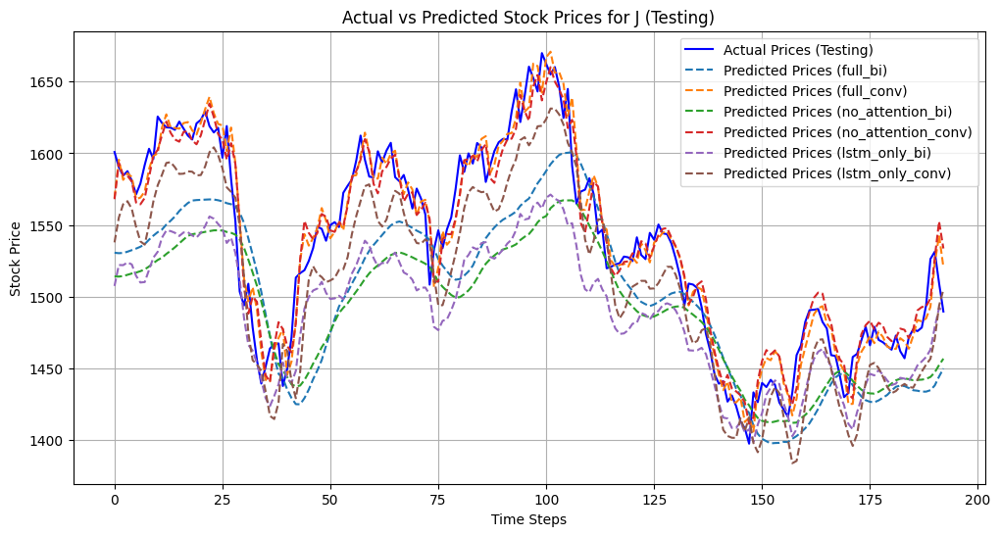

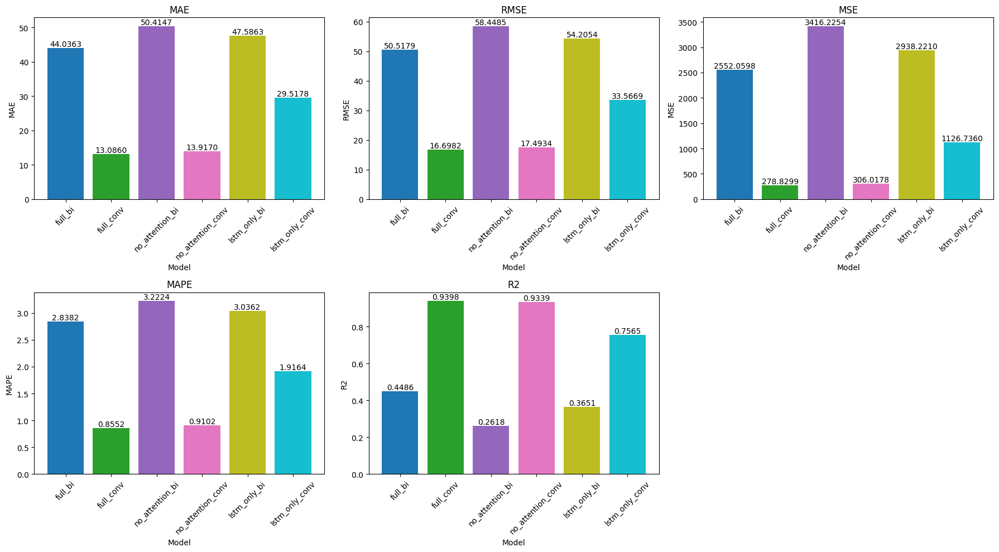

In [52]:
# TESTING J

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "J"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])


Processing dataset: K with ablation mode: full_bi
Model /kaggle/working/best_model_STACN_K_full_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 77ms/step
Evaluation Metrics for full_bi:
mae_test    : 22.0680
rmse_test   : 28.5384
mse_test    : 814.4421
r2_test     : 0.8987
mape_test   : 1.6249

Processing dataset: K with ablation mode: full_conv
Model /kaggle/working/best_model_STACN_K_full_conv.keras is conventional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step
Evaluation Metrics for full_conv:
mae_test    : 34.9059
rmse_test   : 43.9930
mse_test    : 1935.3863
r2_test     : 0.7592
mape_test   : 2.6021

Processing dataset: K with ablation mode: no_attention_bi
Model /kaggle/working/best_model_STACN_K_no_attention_bi.keras is bidirectional.
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 72ms/step
Evaluation Metrics for no_attention_bi:
mae_test    : 29.3962
rmse_test   : 36.6975
mse_test    : 1346.7066
r2_test     : 0.8324
mape_test   : 2.1999

Processing dataset: K with ablation mode: no_attention_conv

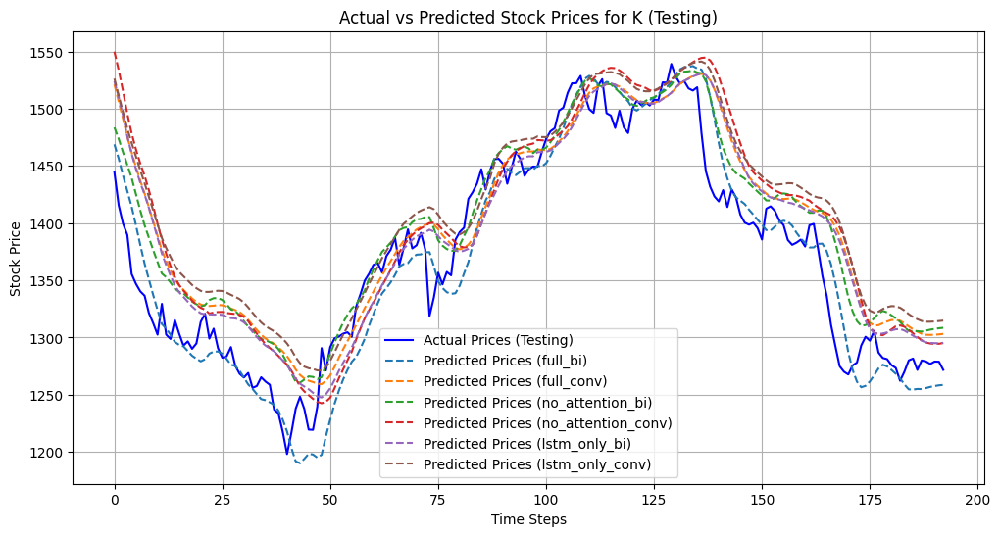

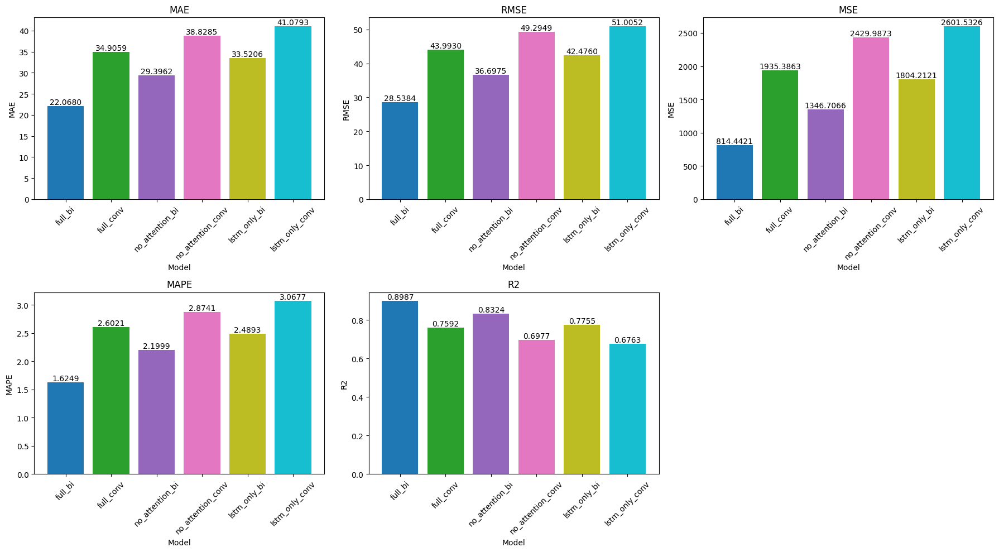

In [53]:
# TESTING K

all_results = {}

# Jalankan evaluasi dan tambahkan hasilnya ke dictionary
key = "K"
model_paths = {
    'full_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_full_bi.keras', True), 
    'full_conv'	   : (f'/kaggle/working/best_model_STACN_{key}_full_conv.keras', True),
    'no_attention_bi'  : (f'/kaggle/working/best_model_STACN_{key}_no_attention_bi.keras', True),
    'no_attention_conv': (f'/kaggle/working/best_model_STACN_{key}_no_attention_conv.keras', True),
    'lstm_only_bi'	   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_bi.keras', True),
    'lstm_only_conv'   : (f'/kaggle/working/best_model_STACN_{key}_lstm_only_conv.keras', True)
}

all_results[key] = evaluate_only(data[key], key, model_paths)
plot_metrics(all_results[key])

In [3]:
import shutil
import os

# Folder sumber dan tujuan
source_folder = "/kaggle/input/data-k"
destination_folder = "/kaggle/working/"

# Pastikan folder tujuan ada, jika tidak, buat
os.makedirs(destination_folder, exist_ok=True)

# Salin semua file dari source ke destination
for filename in os.listdir(source_folder):
    source_path = os.path.join(source_folder, filename)
    destination_path = os.path.join(destination_folder, filename)
    
    if os.path.isfile(source_path):  # Pastikan ini adalah file, bukan folder
        shutil.copy(source_path, destination_path)
        print(f"Copied: {filename}")

print("All files copied successfully!")


Copied: best_model_STACN_K_full_conv.keras
Copied: best_model_STACN_K_lstm_only_bi.keras
Copied: best_model_STACN_K_no_attention_conv.keras
Copied: best_model_STACN_K_full_bi.keras
Copied: best_model_STACN_K_no_attention_bi.keras
Copied: best_model_STACN_K_lstm_only_conv.keras
All files copied successfully!
